In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
%matplotlib inline

import sys
import os
import pickle
import json

from IPython.display import set_matplotlib_formats
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
from penquins import Kowalski
from sklearn.model_selection import train_test_split

sys.path.append('..')
from env_config import DATA_PATH, PROJECT_PATH
from features import add_colors
from ml import get_embedding, run_experiments
from report import make_report, make_reports, print_summary_table, plot_results_as_function
from plotting import plot_light_curve, plot_embedding

In [3]:
%matplotlib inline
set_matplotlib_formats('retina')
plt.rcParams['figure.dpi'] = 100
plt.rcParams['savefig.dpi'] = 300
sns.set_style('ticks', {'axes.grid': False})
pd.set_option('mode.chained_assignment', None)

/tmp/ipykernel_1145292/2821350300.py:2: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  set_matplotlib_formats('retina')


# Read data

In [4]:
# Read ZTF x SDSS subset with available features
ztf_x_sdss_features = {}
for filter in ['g', 'r']:
    with open(os.path.join(DATA_PATH, 'ZTF_x_SDSS/ztf_20210401_x_specObj-dr18__singles_filter_{}__features'.format(filter)), 'rb') as file:
        ztf_x_sdss_features[filter] = pickle.load(file)

In [5]:
# Read ZTF x SDSS lightcurve subset with available features
ztf_x_sdss_lc = {}
for filter in ['g', 'r']:
    with open(os.path.join(DATA_PATH, 'ZTF_x_SDSS/ztf_20210401_x_specObj-dr18__singles_filter_{}__features_lc-reduced'.format(filter)), 'rb') as file:
        ztf_x_sdss_lc[filter] = pickle.load(file)

In [6]:
# Add number of observation to the dataframes
for filter in ['g', 'r']:
    n_obs = [len(lc['mjd']) for lc in ztf_x_sdss_lc[filter]]
    ztf_x_sdss_features[filter]['n_obs'] = n_obs

In [7]:
# Read SDSS x ZTF subset with available features
sdss_x_ztf_features = {}
file_path = 'ZTF_x_SDSS/specObj-dr18_x_ztf_20210401__singles_filter_{}__features'
for filter in ['g', 'r']:
    fp = file_path.format(filter)
    with open(os.path.join(DATA_PATH, fp), 'rb') as file:
        sdss_x_ztf_features[filter] = pickle.load(file)

In [8]:
# # Read ZTF x SDSS astromer features
# file_path = 'ZTF_x_SDSS/ztf_20210401_x_specObj-dr18__singles_filter_g__features_astromer_retrained-encoder.npy'
# ztf_x_sdss_astromer = np.load(os.path.join(DATA_PATH, file_path))

# # Add it to the main dataframe
# columns = FEATURES_DICT['astromer_all']
# ztf_x_sdss_features['g'] = pd.concat(
#     [ztf_x_sdss_features['g'], pd.DataFrame(ztf_x_sdss_astromer, columns=columns)], axis=1
# )

In [8]:
# Get PS and WISE colors
for filter in ['g', 'r']:
    ztf_x_sdss_features[filter], features_dict = add_colors(ztf_x_sdss_features[filter])

# Astromer top features

## Run models

In [ ]:
data_compositions = [
    ['astromer_all'],
]

results = {}
classifiers = {}
for data_labels in tqdm(data_compositions):
    joined_label = ' x '.join(data_labels)
    results[joined_label], classifiers[joined_label] = run_experiments(
        data_labels, ztf_x_sdss_features['g'], sdss_x_ztf_features['g'], features_dict
    )

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

## Results

features: astromer_all
              precision    recall  f1-score   support

      GALAXY     0.8190    0.9608    0.8842     54278
         QSO     0.9033    0.7469    0.8177     20993
        STAR     0.9131    0.7432    0.8194     30966

    accuracy                         0.8551    106237
   macro avg     0.8785    0.8169    0.8404    106237
weighted avg     0.8631    0.8551    0.8522    106237



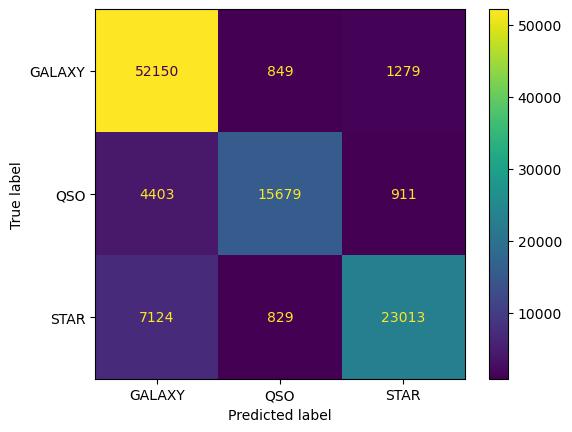

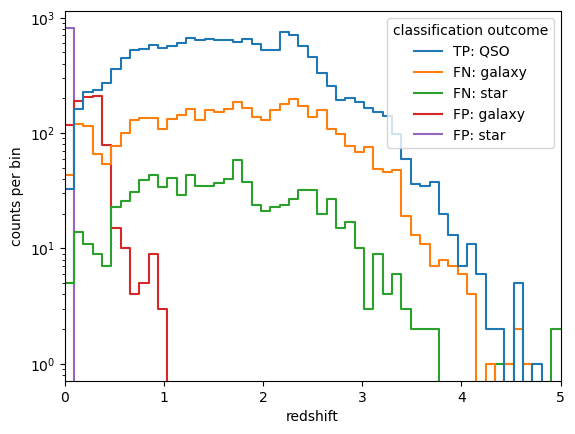

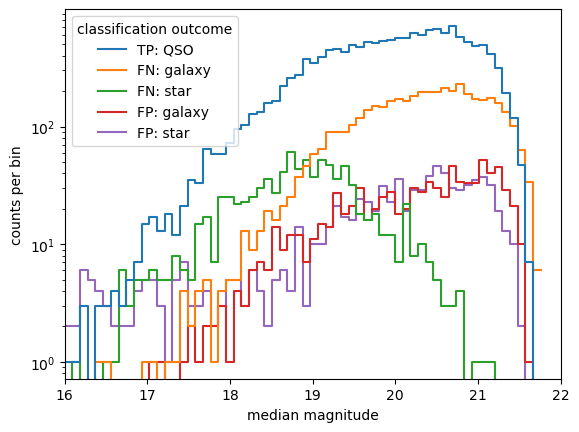

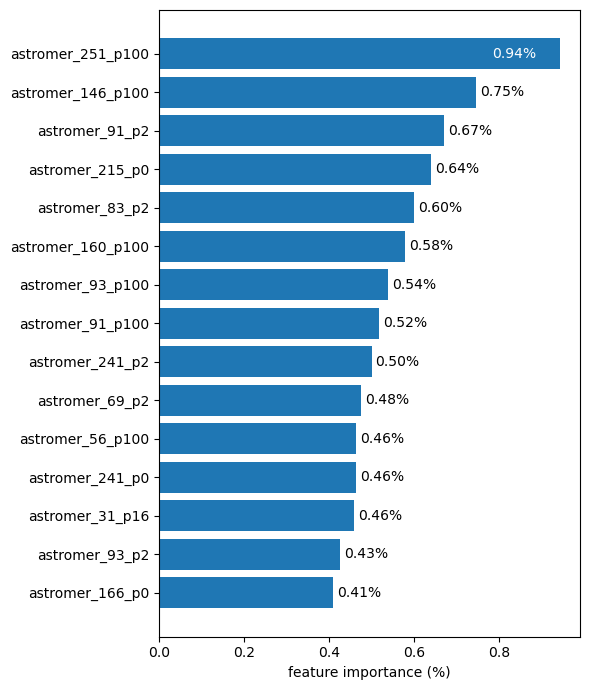

--------------------


In [ ]:
# Original astromer
data_label = 'astromer_all'
make_reports(results[data_label], classifiers[data_label], feature_sets)

features: astromer_all
              precision    recall  f1-score   support

      GALAXY     0.8379    0.9594    0.8946     54278
         QSO     0.9069    0.7861    0.8422     20993
        STAR     0.9212    0.7702    0.8390     30966

    accuracy                         0.8700    106237
   macro avg     0.8887    0.8386    0.8586    106237
weighted avg     0.8758    0.8700    0.8680    106237



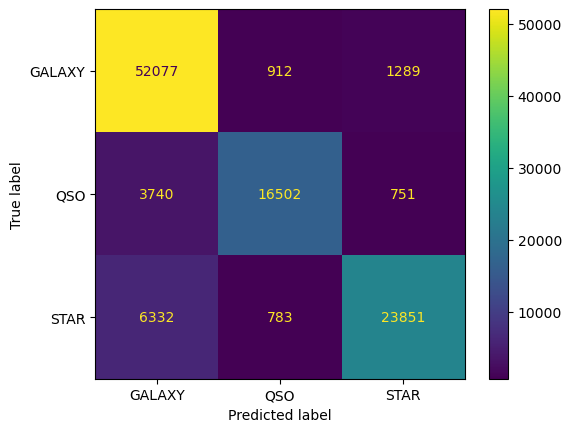

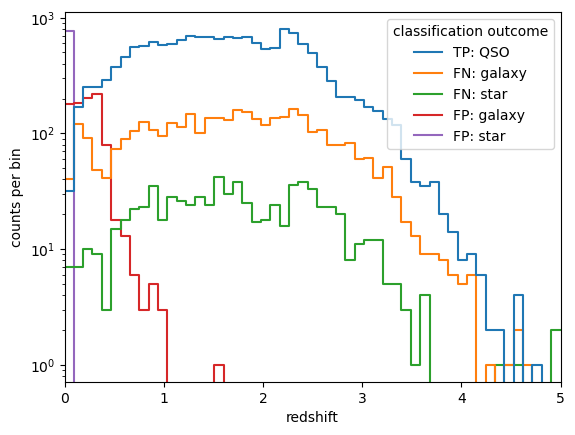

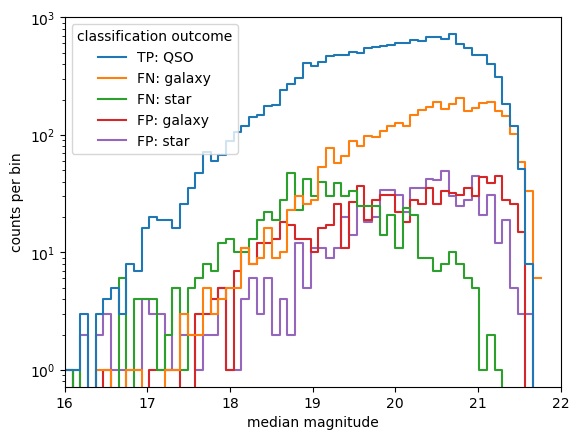

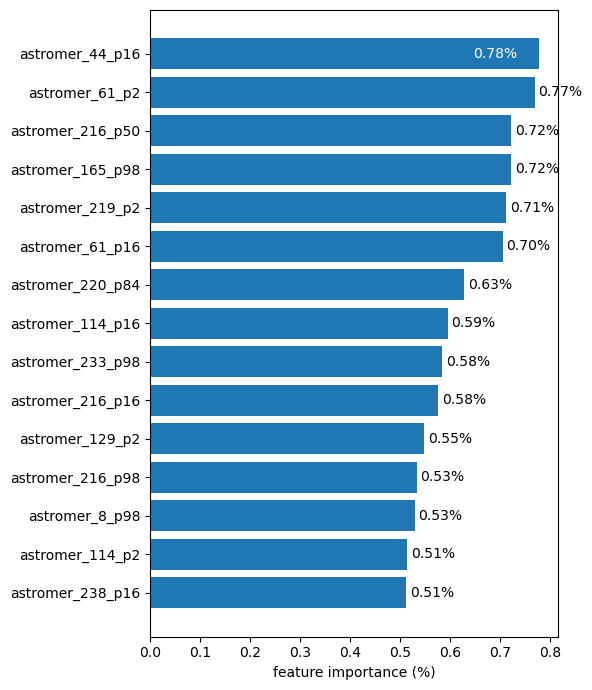

--------------------


In [ ]:
# Retrained encoder
data_label = 'astromer_all'
make_reports(results[data_label], classifiers[data_label], feature_sets)

## Save ranking

In [ ]:
# Sort features
model = classifiers['astromer_all']['astromer_all']
features = features_dict['astromer_all']

importances = model.feature_importances_
indices = np.argsort(importances)[::-1]
features_sorted = np.array(features)[indices]
importances_sorted = np.array(importances)[indices]

In [ ]:
# Retrained
for i, t in enumerate(list(zip(features_sorted, importances_sorted))):
    print('{}: {}'.format(i+1, t))

1: ('astromer_44_p16', 0.007773130101188833)
2: ('astromer_61_p2', 0.00768842362054071)
3: ('astromer_216_p50', 0.007224148109379408)
4: ('astromer_165_p98', 0.007222692138670605)
5: ('astromer_219_p2', 0.0071162653489196285)
6: ('astromer_61_p16', 0.007048532844872955)
7: ('astromer_220_p84', 0.006284839101677592)
8: ('astromer_114_p16', 0.00594756560761119)
9: ('astromer_233_p98', 0.0058315714626723855)
10: ('astromer_216_p16', 0.005761895025412275)
11: ('astromer_129_p2', 0.005481864218695525)
12: ('astromer_216_p98', 0.005330265817714647)
13: ('astromer_8_p98', 0.005286588607825162)
14: ('astromer_114_p2', 0.005143524176548815)
15: ('astromer_238_p16', 0.005115036611295422)
16: ('astromer_238_p2', 0.004852240498430753)
17: ('astromer_44_p2', 0.0048449763849891005)
18: ('astromer_220_p16', 0.004774433424616463)
19: ('astromer_242_p2', 0.004640235406044972)
20: ('astromer_12_p98', 0.004611921812395652)
21: ('astromer_61_p50', 0.004429792263793677)
22: ('astromer_175_p98', 0.004420033

In [ ]:
# Original
for i, t in enumerate(list(zip(features_sorted, importances_sorted))):
    print('{}: {}'.format(i+1, t))

1: ('astromer_251_p100', 0.0094296665170139)
2: ('astromer_146_p100', 0.007464646852113827)
3: ('astromer_91_p2', 0.006700370745174025)
4: ('astromer_215_p0', 0.00639709025396463)
5: ('astromer_83_p2', 0.006007429301280039)
6: ('astromer_160_p100', 0.00579167167472484)
7: ('astromer_93_p100', 0.005394545269319042)
8: ('astromer_91_p100', 0.0051684994731169085)
9: ('astromer_241_p2', 0.005001746225583859)
10: ('astromer_69_p2', 0.004758063316476139)
11: ('astromer_56_p100', 0.004643856680002611)
12: ('astromer_241_p0', 0.004639800556576864)
13: ('astromer_31_p16', 0.0045988438530412245)
14: ('astromer_93_p2', 0.004259317507990085)
15: ('astromer_166_p0', 0.004097577528934403)
16: ('astromer_91_p0', 0.0040954533382493025)
17: ('astromer_69_p0', 0.004068118829244738)
18: ('astromer_187_p2', 0.0037441449994209002)
19: ('astromer_89_p100', 0.0037422017773441614)
20: ('astromer_186_p2', 0.003671459340292478)
21: ('astromer_221_p2', 0.0036483976322193583)
22: ('astromer_215_p2', 0.00364198143

In [ ]:
results = pd.DataFrame({'feature': features_sorted, 'importance': importances_sorted})
results.to_csv(os.path.join(PROJECT_PATH, 'outputs/feature_importance/astromer_RF.csv'), index=False)

## Merge the top

In [ ]:
from ml import get_summary_table
from env_config import PROJECT_PATH

for min_features in [1, 2, 4, 8, 16, 32, 64, 128, 256, 512, 1024]:
    data_compositions = [['ZTF', 'astromer']]

    feature_sets['astromer'] = pd.read_csv(os.path.join(PROJECT_PATH, 'outputs/feature_importance/RF_astromer.csv')).loc[:min_features, 'feature'].values
    
    results = {}
    classifiers = {}
    for data_labels in data_compositions:
        joined_label = ' x '.join(data_labels)
        results[joined_label], classifiers[joined_label] = run_experiments(
            data_labels, ztf_x_sdss_features['g'], sdss_x_ztf_features['g'], features_dict
        )

    f1_ztf = get_summary_table(results['ZTF x astromer']).loc[0, 'QSO f1']
    f1_astr = get_summary_table(results['ZTF x astromer']).loc[1, 'QSO f1']
    f1_all = get_summary_table(results['ZTF x astromer']).loc[2, 'QSO f1']
    print('min features: {}, f1 ztf: {:.4f}, f1 astr: {:.4f}, f1 all: {:.4f}'.format(
        min_features, f1_ztf, f1_astr, f1_all))

  0%|          | 0/3 [00:00<?, ?it/s]

min features: 1, f1 ztf: 0.8398, f1 astr: 0.3476, f1 all: 0.8423


  0%|          | 0/3 [00:00<?, ?it/s]

min features: 2, f1 ztf: 0.8398, f1 astr: 0.3690, f1 all: 0.8418


  0%|          | 0/3 [00:00<?, ?it/s]

min features: 4, f1 ztf: 0.8398, f1 astr: 0.4726, f1 all: 0.8428


  0%|          | 0/3 [00:00<?, ?it/s]

min features: 8, f1 ztf: 0.8398, f1 astr: 0.6410, f1 all: 0.8431


  0%|          | 0/3 [00:00<?, ?it/s]

min features: 16, f1 ztf: 0.8398, f1 astr: 0.6681, f1 all: 0.8418


  0%|          | 0/3 [00:00<?, ?it/s]

min features: 32, f1 ztf: 0.8398, f1 astr: 0.7503, f1 all: 0.8524


  0%|          | 0/3 [00:00<?, ?it/s]

min features: 64, f1 ztf: 0.8398, f1 astr: 0.7804, f1 all: 0.8576


  0%|          | 0/3 [00:00<?, ?it/s]

min features: 128, f1 ztf: 0.8398, f1 astr: 0.8013, f1 all: 0.8614


  0%|          | 0/3 [00:00<?, ?it/s]

min features: 256, f1 ztf: 0.8398, f1 astr: 0.8121, f1 all: 0.8629


  0%|          | 0/3 [00:00<?, ?it/s]

min features: 512, f1 ztf: 0.8398, f1 astr: 0.8146, f1 all: 0.8607


  0%|          | 0/3 [00:00<?, ?it/s]

min features: 1024, f1 ztf: 0.8398, f1 astr: 0.8155, f1 all: 0.8575


# Run experiments

In [9]:
filters = ['g', 'r']

feature_compositions = [
    ['ZTF'],
    ['ZTF', 'AstrmClf', 'PS'],
    ['ZTF', 'AstrmClf', 'PS', 'WISE'],
    ['ZTF', 'AstrmClf', 'PS', 'WISE', 'GAIA'],
]

for filter in filters:
    for feature_labels in tqdm(feature_compositions):
        data_labels = [label for label in feature_labels if label != 'AstrmClf']
        data_label = '_'.join(data_labels)
        if data_label[:3] != 'ZTF':
            data_label = 'ZTF_' + data_label

        # Run the expeirments for given data composition and almost all feature combinations
        results, classifiers = run_experiments(
            feature_labels, ztf_x_sdss_features[filter], sdss_x_ztf_features[filter], features_dict,
            filter=filter,
        )

        # Save results
        file_name = '{}-band__{}__RF'.format(filter, data_label)
        file_path = os.path.join(PROJECT_PATH, 'outputs', 'preds', file_name + '.csv')
        results.to_csv(file_path, index=False)
        print('Results saved to: {}'.format(file_path))

        # Create dict like structure for features
        feature_importances = {}

        # Iterate classifiers
        for key, classifier in classifiers.items():
            feature_labels = key.split(' + ')
            feature_importances[key] = {
                'features': np.concatenate([features_dict[feature_label] for feature_label in feature_labels]).tolist(),
                'importances': classifier.feature_importances_.tolist(),
            }

        # Save feature importances
        file_path = os.path.join(PROJECT_PATH, 'outputs', 'feature_importance', file_name + '.json')
        out_file = open(file_path, 'w')
        json.dump(feature_importances, out_file, indent=4)
        out_file.close()
        print('Feature importances saved to: {}'.format(file_path))

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Results saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/preds/g-band__ZTF__RF.csv
Feature importances saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/feature_importance/g-band__ZTF__RF.json


  0%|          | 0/7 [00:00<?, ?it/s]

Results saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/preds/g-band__ZTF_PS__RF.csv
Feature importances saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/feature_importance/g-band__ZTF_PS__RF.json


  0%|          | 0/11 [00:00<?, ?it/s]

Results saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/preds/g-band__ZTF_PS_WISE__RF.csv
Feature importances saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/feature_importance/g-band__ZTF_PS_WISE__RF.json


  0%|          | 0/16 [00:00<?, ?it/s]

Results saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/preds/g-band__ZTF_PS_WISE_GAIA__RF.csv
Feature importances saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/feature_importance/g-band__ZTF_PS_WISE_GAIA__RF.json


  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Results saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/preds/r-band__ZTF__RF.csv
Feature importances saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/feature_importance/r-band__ZTF__RF.json


  0%|          | 0/7 [00:00<?, ?it/s]

Results saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/preds/r-band__ZTF_PS__RF.csv
Feature importances saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/feature_importance/r-band__ZTF_PS__RF.json


  0%|          | 0/11 [00:00<?, ?it/s]

Results saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/preds/r-band__ZTF_PS_WISE__RF.csv
Feature importances saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/feature_importance/r-band__ZTF_PS_WISE__RF.json


  0%|          | 0/16 [00:00<?, ?it/s]

Results saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/preds/r-band__ZTF_PS_WISE_GAIA__RF.csv
Feature importances saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/feature_importance/r-band__ZTF_PS_WISE_GAIA__RF.json


# Load results

In [10]:
# Define filters
filters = ['g', 'r']

# Define data compositions
data_compositions = [
    ['ZTF'],
    ['ZTF', 'PS'],
    ['ZTF', 'PS', 'WISE'],
    ['ZTF', 'PS', 'WISE', 'GAIA'],
]

# Resulting data structures
results_dict = {}
feature_importance_dict = {}

for filter in filters:
    results_dict[filter] = {}
    feature_importance_dict[filter] = {}

    for data_composition in data_compositions:
        data_label = '_'.join(data_composition)

        # Read predictions
        file_name = '{}-band__{}__RF'.format(filter, data_label)
        file_path = os.path.join(PROJECT_PATH, 'outputs', 'preds', file_name + '.csv')
        results_dict[filter][data_label] = pd.read_csv(file_path)
        print('Loaded results: {}'.format(file_path))

        # Read feature importances
        file_path = os.path.join(PROJECT_PATH, 'outputs', 'feature_importance', file_name + '.json')
        with open(file_path) as file:
            feature_importance_dict[filter][data_label] = json.load(file)
        print('Loaded feature importances: {}'.format(file_path))

        # Check if Astromer present and add as well
        file_name = 'outputs/preds/{}-band__{}__astromer_FC-1024-512-256__val.csv'.format(filter, data_label)
        file_path = os.path.join(PROJECT_PATH, file_name)
        if os.path.exists(file_path):
            df_preds = pd.read_csv(file_path)
            results_dict[filter][data_label]['y_pred Astrm'] = df_preds['y_pred']
            print('Loaded Astromer: {}'.format(file_path))

Loaded results: /home/sjnakoneczny/workspace/ztf-agn/outputs/preds/g-band__ZTF__RF.csv
Loaded feature importances: /home/sjnakoneczny/workspace/ztf-agn/outputs/feature_importance/g-band__ZTF__RF.json
Loaded results: /home/sjnakoneczny/workspace/ztf-agn/outputs/preds/g-band__ZTF_PS__RF.csv
Loaded feature importances: /home/sjnakoneczny/workspace/ztf-agn/outputs/feature_importance/g-band__ZTF_PS__RF.json
Loaded Astromer: /home/sjnakoneczny/workspace/ztf-agn/outputs/preds/g-band__ZTF_PS__astromer_FC-1024-512-256__val.csv
Loaded results: /home/sjnakoneczny/workspace/ztf-agn/outputs/preds/g-band__ZTF_PS_WISE__RF.csv
Loaded feature importances: /home/sjnakoneczny/workspace/ztf-agn/outputs/feature_importance/g-band__ZTF_PS_WISE__RF.json
Loaded Astromer: /home/sjnakoneczny/workspace/ztf-agn/outputs/preds/g-band__ZTF_PS_WISE__astromer_FC-1024-512-256__val.csv
Loaded results: /home/sjnakoneczny/workspace/ztf-agn/outputs/preds/g-band__ZTF_PS_WISE_GAIA__RF.csv
Loaded feature importances: /home/sjn

## Astromer

In [14]:
filter = 'g'
features_subset = ['ZTF', 'PS']

# Take subset of available surveys cross-match
max_features = np.concatenate([FEATURE_SETS[label] for label in features_subset])
ztf_x_sdss_features_subset = ztf_x_sdss_features[filter].dropna(subset=max_features)
indices = ztf_x_sdss_features_subset.index
ztf_x_sdss_features_subset = ztf_x_sdss_features_subset.reset_index(drop=True)
sdss_x_ztf_features_subset = sdss_x_ztf_features[filter].loc[indices].reset_index(drop=True)

_, ztf_val, _, sdss_val = train_test_split(
    ztf_x_sdss_features_subset, sdss_x_ztf_features_subset, test_size=0.33, random_state=42
)

results_df = pd.DataFrame()
results_df['y_true'] = sdss_val['CLASS'].to_numpy()
results_df['n_obs'] = ztf_val['n_obs'].to_numpy()
results_df['mag_median'] = ztf_val['median'].to_numpy()
results_df['redshift'] = sdss_val['Z'].to_numpy()

In [15]:
# r band
# to_process = [
#     ('Astromer 1024', 'r-band__ZTF_PS__astromer_FC-1024-512-256.csv'),
# ]

# g band
to_process = [
    # ('CNN', 'ZTF_PS__CNN-16-32-64-64_FC-1024-512-256.csv'),   
    
    # ('Astromer 2048', 'astromer_FC-2048-1024-512-256.csv'),
    # ('Astromer 1024', 'ZTF_PS__astromer_FC-1024-512-256.csv'),
    # ('Astromer 1024 (old)', 'astromer_FC-1024-512-256.csv'),
    # ('Astromer 1024 (True)', 'astromer_FC-1024-512-256_True.csv'),
    # ('A + LSTM', 'ZTF_PS__astromer_LSTM-256-256.csv'),
    # ('A + LSTM + FC', 'ZTF_PS__astromer_LSTM-512_FC-1024-512-256.csv'),

    # ('min', 'ZTF_PS__astromer-min_FC-1024-512-256.csv'),
    # ('max', 'ZTF_PS__astromer-max_FC-1024-512-256.csv'),
    # ('sum-max', 'ZTF_PS__astromer-sum-max_FC-1024-512-256.csv'),

    ('sampling', 'ZTF_PS__astromer_FC-1024-512-256__sampling.csv'),
    ('astrm + PS', 'ZTF_PS__astromer_FC-1024-512-256__features-PS.csv'),
    ('PS', 'ZTF_PS__FC-512-256-128__features-PS.csv'),

    # ('non shuffle', 'g-band__ZTF_PS__astromer_FC-1024-512-256__non-shuffle__val.csv'),
]

for label, file_name in to_process:
    results = pd.read_csv(os.path.join(PROJECT_PATH, 'outputs/preds/{}'.format(file_name)))
    # results[['GALAXY', 'QSO', 'STAR']] = results[['GALAXY', 'QSO', 'STAR']].apply(lambda l: 1 / (1 + np.exp(-l)))
    results_df['y_pred {}'.format(label)] = results['y_pred']

results_dict = {'ZTF x PS': results_df}

# Results

## Paper plots

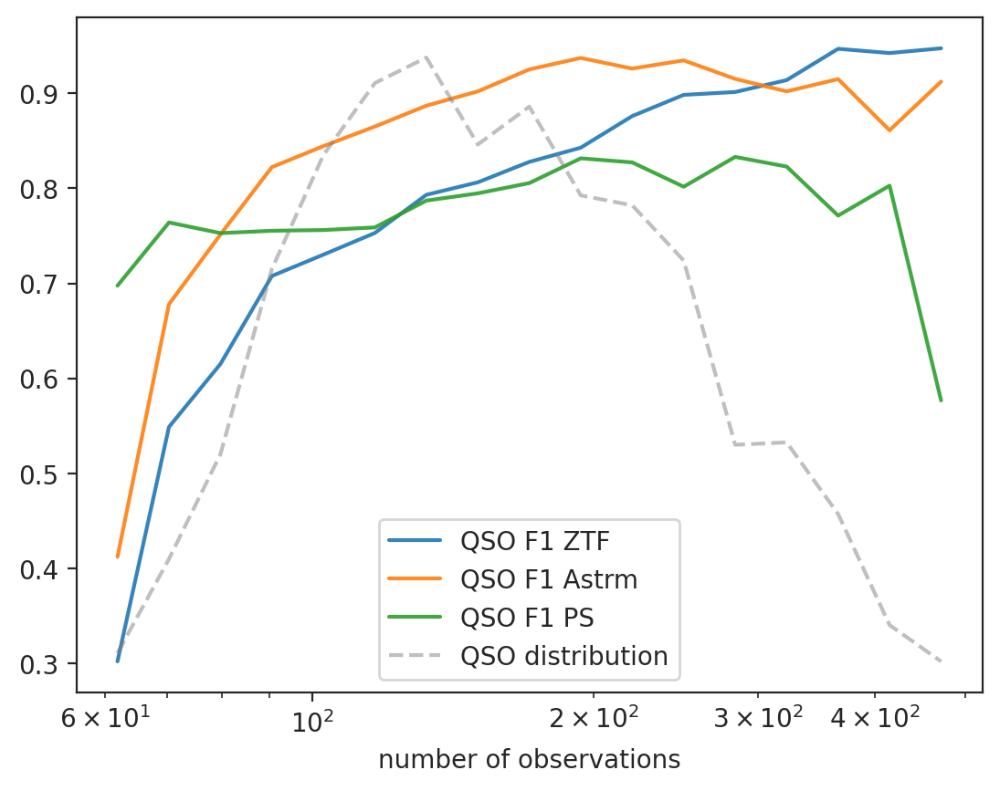

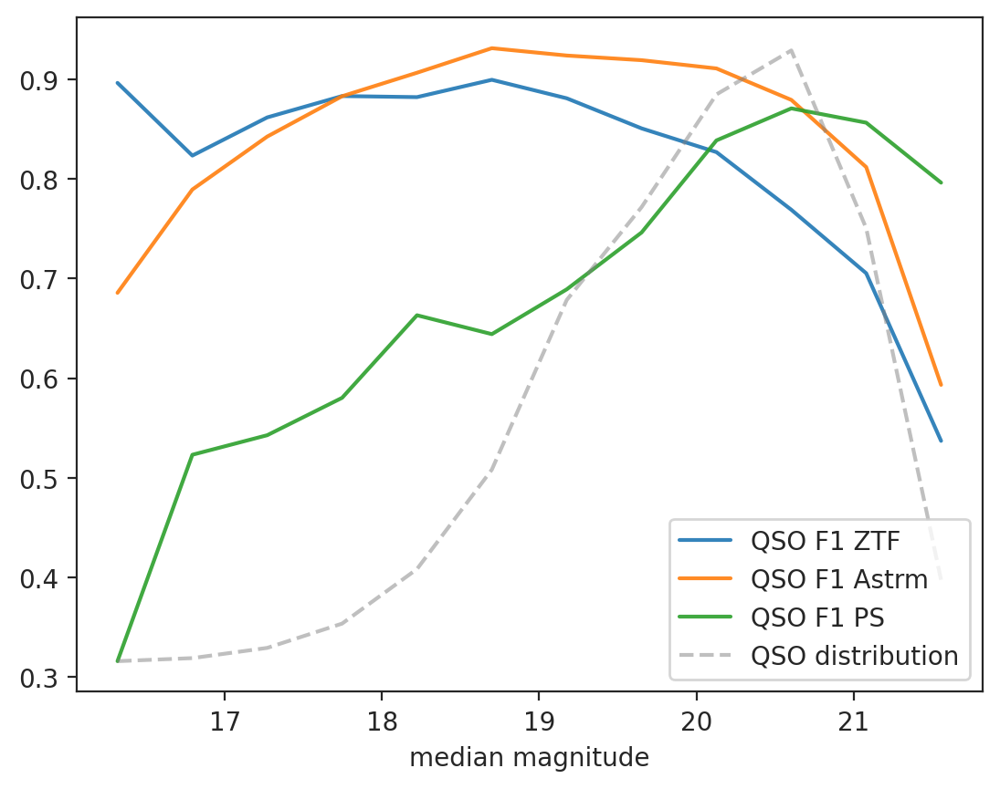

/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib/python3.9/site-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib/python3.9/site-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib/python3.9/site-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib

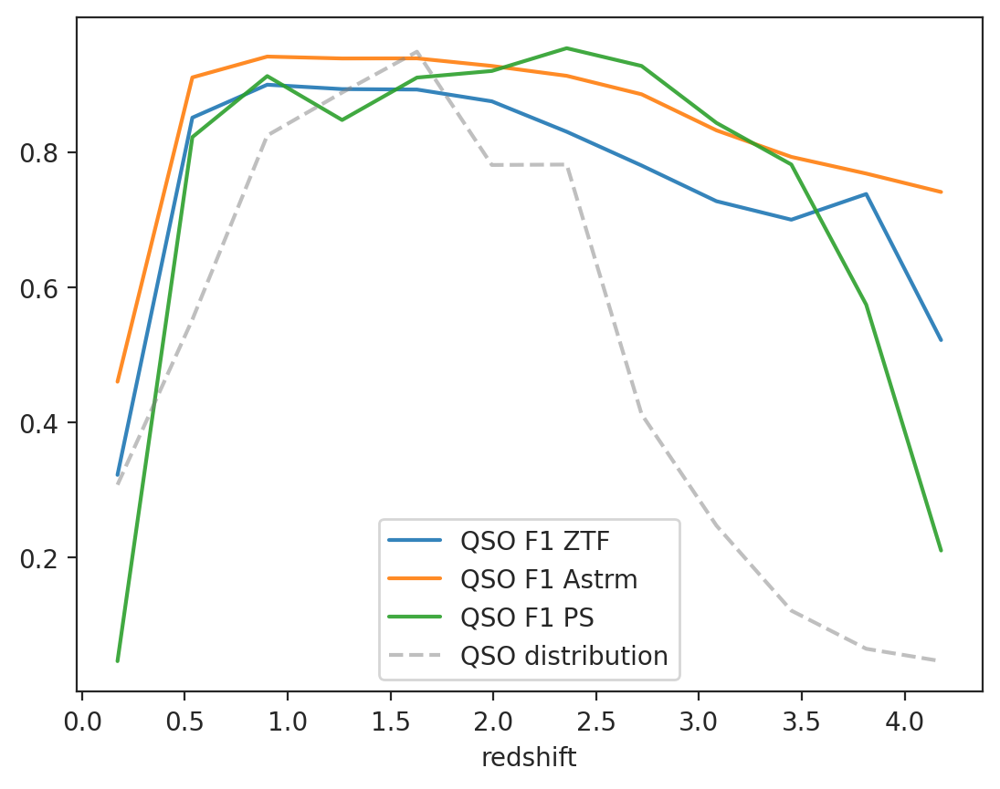

In [14]:
# Plot accuracy, precision, recall
for x in ['n_obs', 'mag_median', 'redshift']:
    plot_results_as_function(results_dict['g']['ZTF_PS'], x, labels=['y_pred ZTF', 'y_pred Astrm', 'y_pred PS'])

/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib/python3.9/site-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib/python3.9/site-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib/python3.9/site-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib

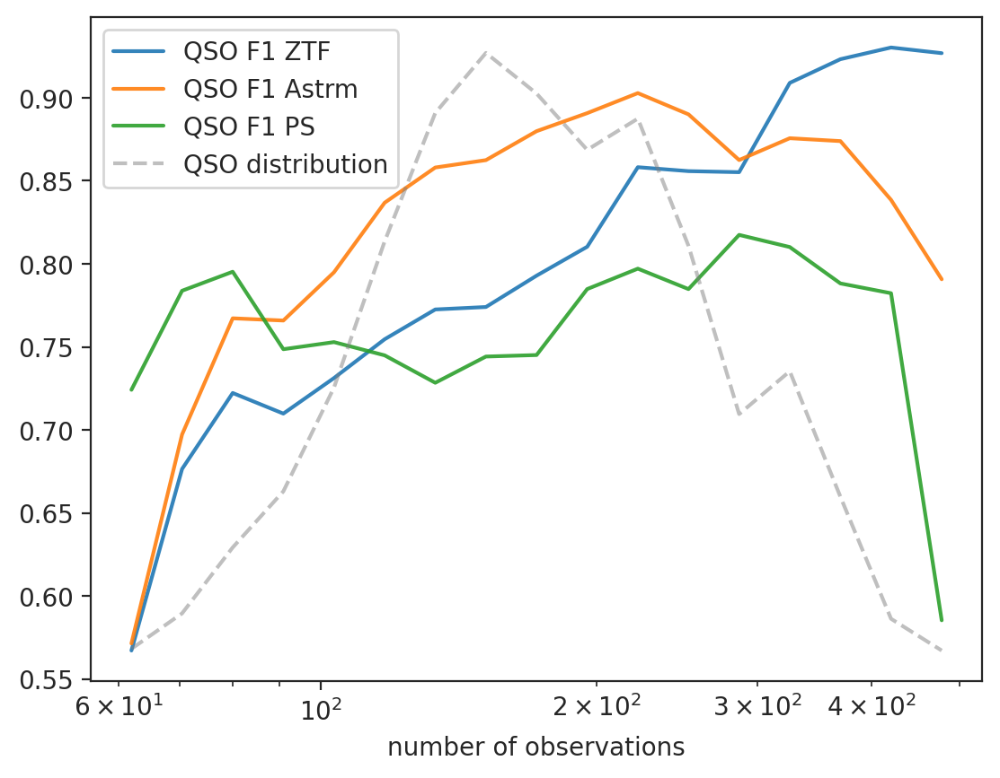

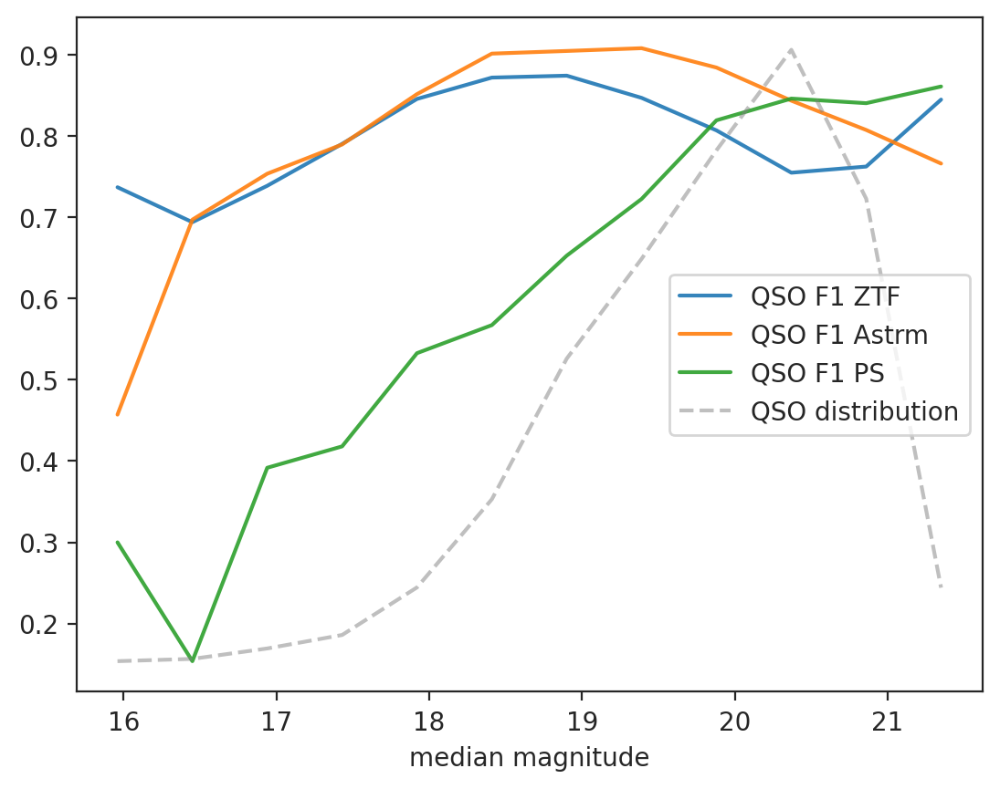

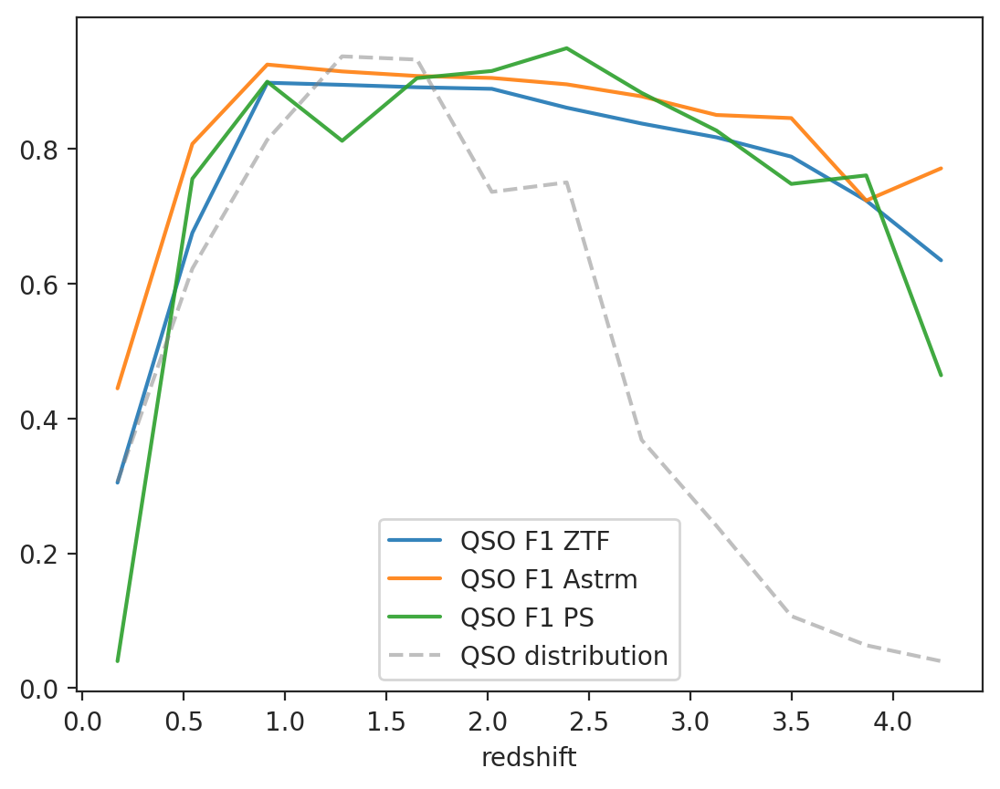

In [15]:
# Plot accuracy, precision, recall
for x in ['n_obs', 'mag_median', 'redshift']:
    plot_results_as_function(results_dict['r']['ZTF_PS'], x, labels=['y_pred ZTF', 'y_pred Astrm', 'y_pred PS'])

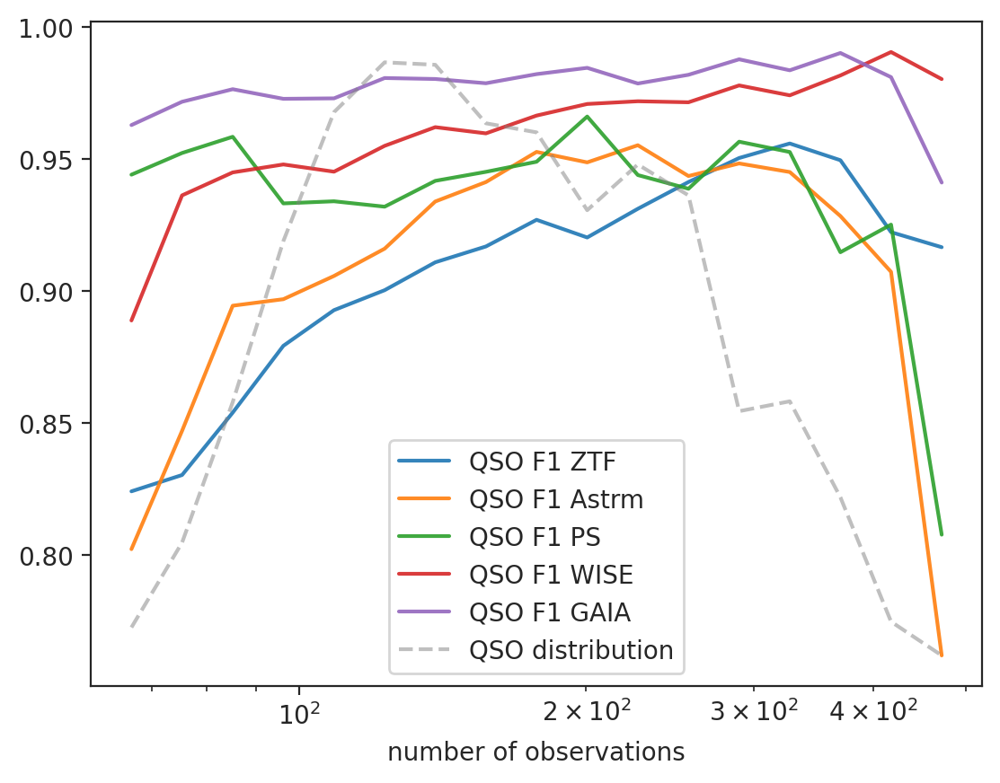

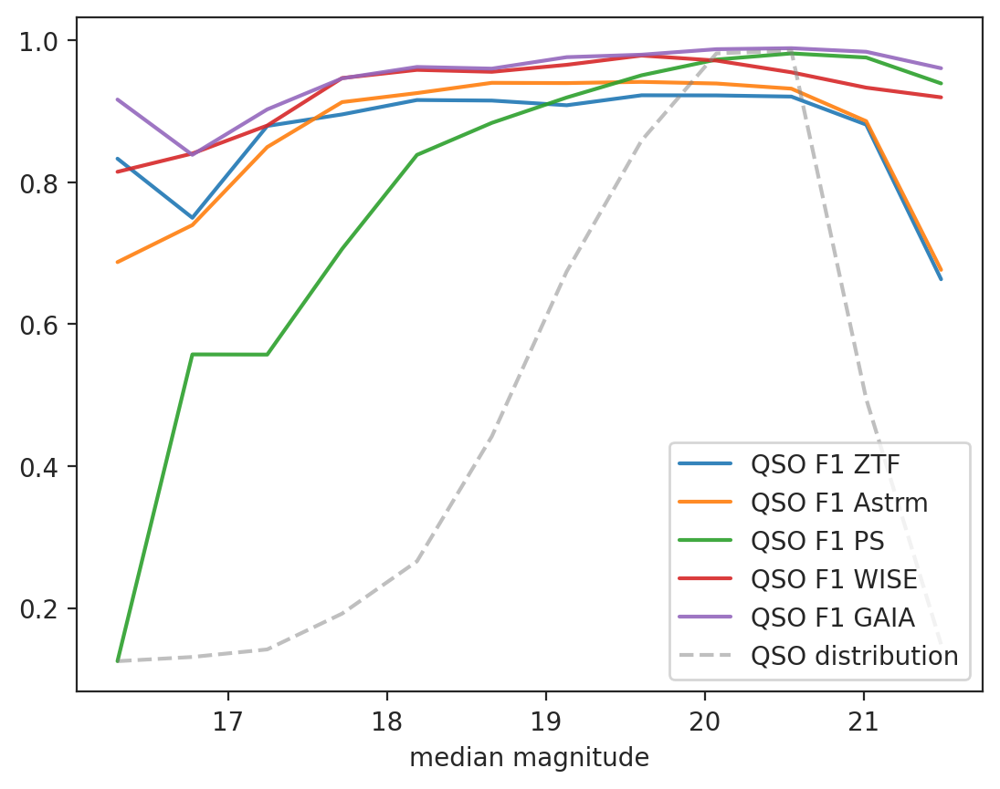

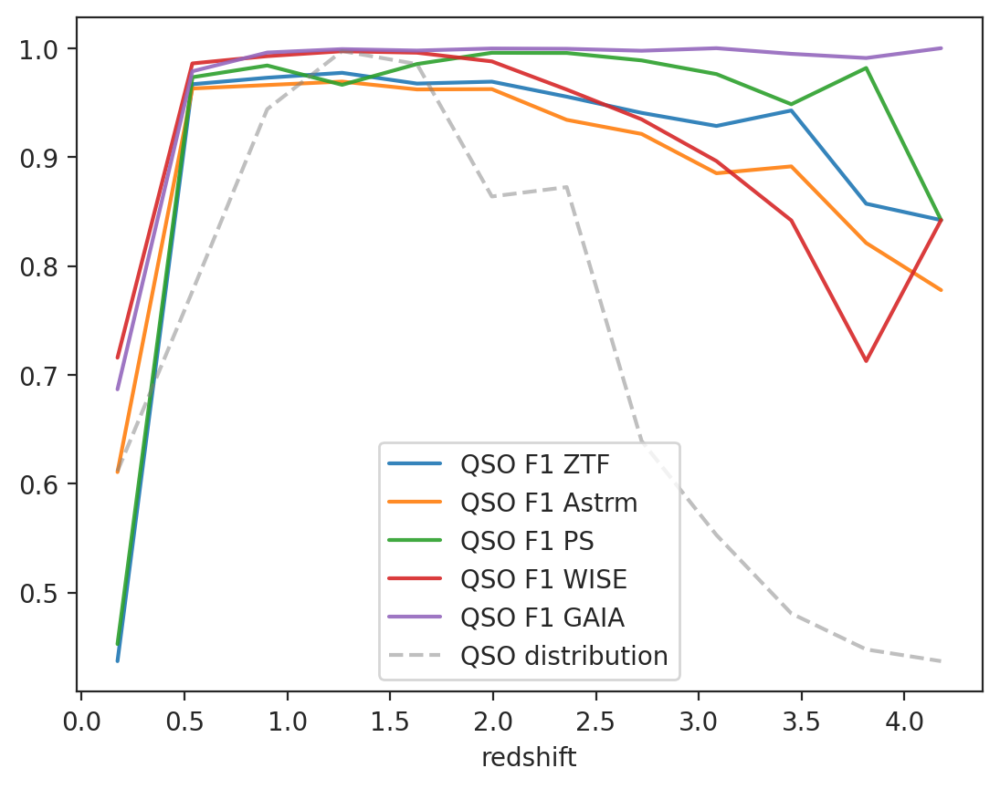

In [16]:
# Plot accuracy, precision, recall
for x in ['n_obs', 'mag_median', 'redshift']:
    plot_results_as_function(results_dict['g']['ZTF_PS_WISE_GAIA'], x, labels=['y_pred ZTF', 'y_pred Astrm', 'y_pred PS', 'y_pred WISE', 'y_pred GAIA'])

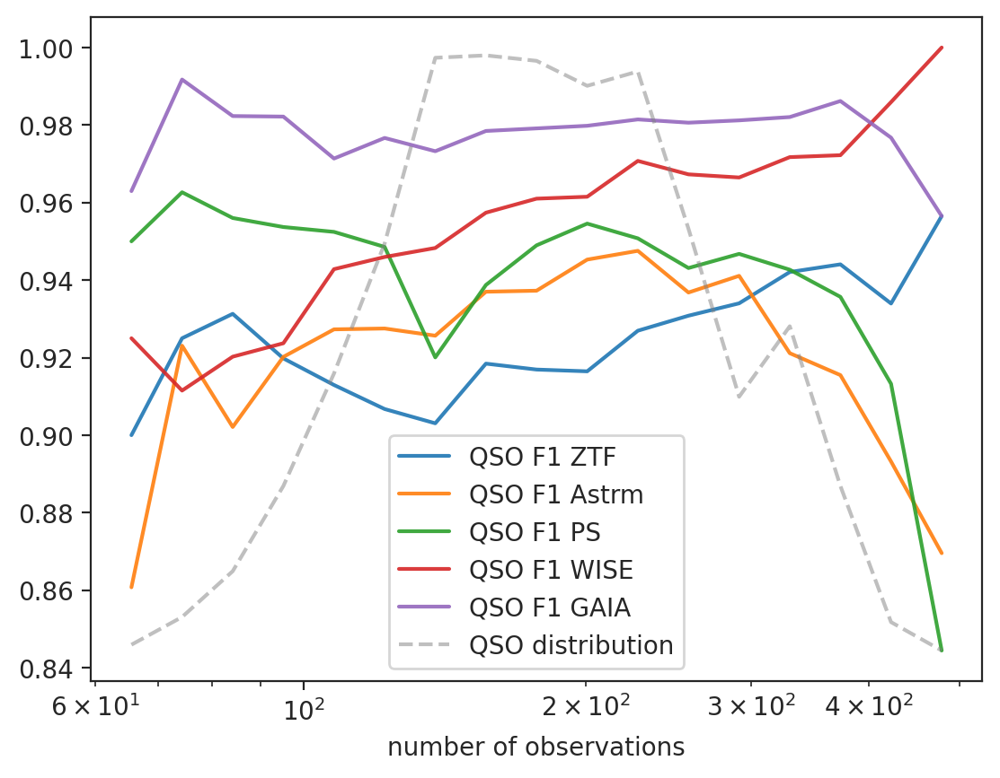

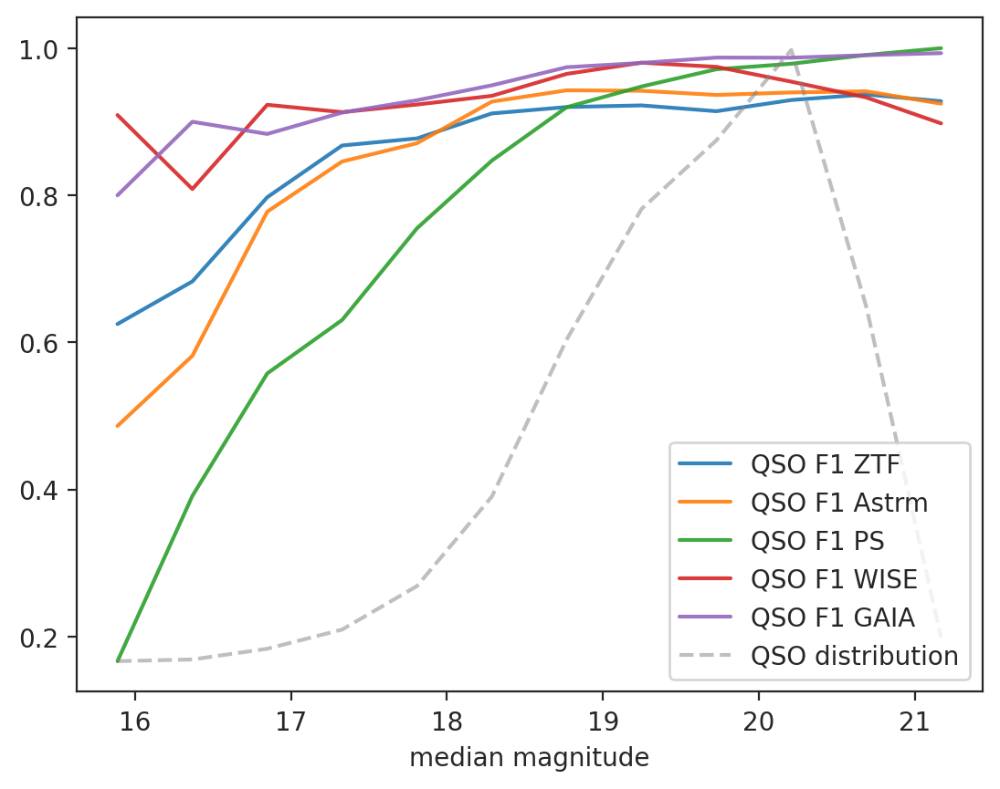

/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib/python3.9/site-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib/python3.9/site-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib/python3.9/site-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/sjnakoneczny/tools/anaconda3/envs/py39-ztf/lib

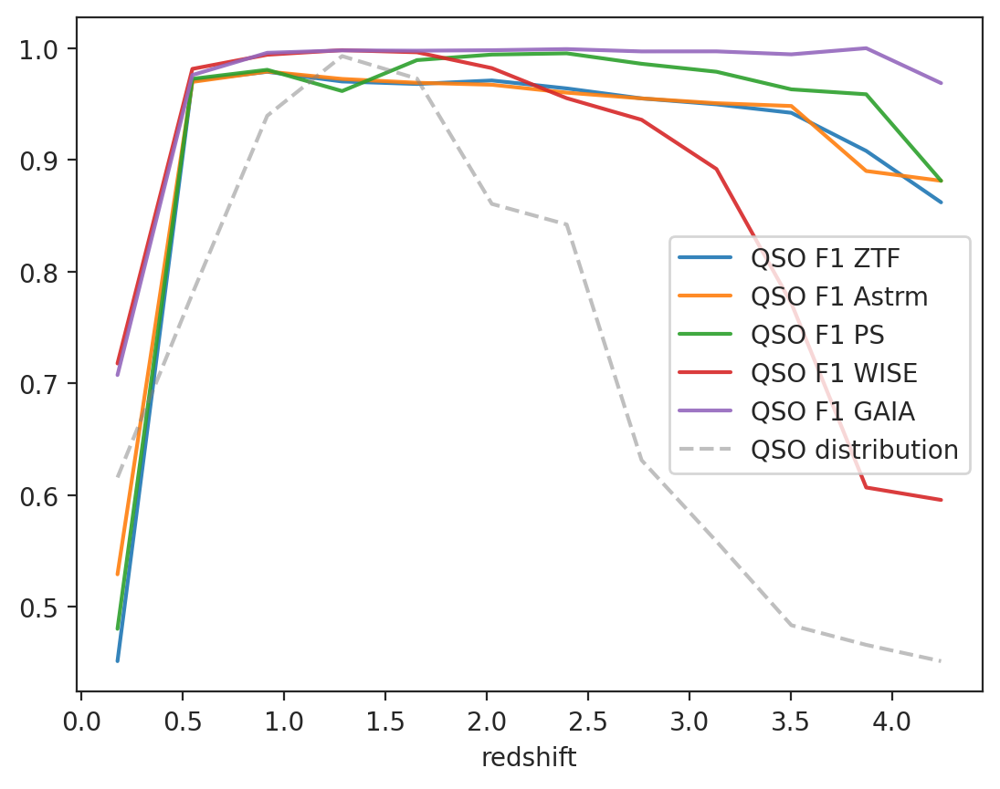

In [17]:
# Plot accuracy, precision, recall
for x in ['n_obs', 'mag_median', 'redshift']:
    plot_results_as_function(results_dict['r']['ZTF_PS_WISE_GAIA'], x, labels=['y_pred ZTF', 'y_pred Astrm', 'y_pred PS', 'y_pred WISE', 'y_pred GAIA'])

## Tables

In [18]:
# g band
print_summary_table(results_dict['g'])

  0%|          | 0/4 [00:00<?, ?it/s]

,data,features,QSO precision,QSO recall,QSO f1,QSO support,QSO support (%),QSO recall global,QSO f1 global,accuracy,support,support (%)
0,ZTF,ZTF,0.86,0.75,0.80,18142.00,100.00,0.75,0.80,0.89,99192.00,100.00
1,ZTF_PS,ZTF,0.85,0.76,0.81,17962.00,99.01,0.75,0.80,0.89,98690.00,99.49
2,ZTF_PS,AstrmClf,0.89,0.85,0.87,17962.00,99.01,0.85,0.87,0.90,98690.00,99.49
3,ZTF_PS,PS,0.79,0.78,0.79,17962.00,99.01,0.78,0.79,0.90,98690.00,99.49
4,ZTF_PS,ZTF + AstrmClf,0.93,0.87,0.90,17962.00,99.01,0.86,0.89,0.93,98690.00,99.49
5,ZTF_PS,ZTF + PS,0.92,0.93,0.92,17962.00,99.01,0.92,0.92,0.96,98690.00,99.49
6,ZTF_PS,AstrmClf + PS,0.94,0.93,0.94,17962.00,99.01,0.92,0.93,0.96,98690.00,99.49
7,ZTF_PS,ZTF + AstrmClf + PS,0.95,0.94,0.94,17962.00,99.01,0.93,0.94,0.97,98690.00,99.49
8,ZTF_PS,Astrm,0.92,0.85,0.88,17962.00,99.01,0.84,0.88,0.91,98690.00,99.49
9,ZTF_PS_WISE,ZTF,0.86,0.80,0.83,16126.00,88.89,0.71,0.78,0.91,86803.00,87.51


\begin{tabular}{llrrrrrrrrrr}
\toprule
            data &                          features &  QSO precision &  QSO recall &  QSO f1 &  QSO support &  QSO support (%) &  QSO recall global &  QSO f1 global &  accuracy &  support &  support (%) \\
\midrule
             ZTF &                               ZTF &           0.86 &        0.75 &    0.80 &     18142.00 &           100.00 &               0.75 &           0.80 &      0.89 & 99192.00 &       100.00 \\
          ZTF_PS &                               ZTF &           0.85 &        0.76 &    0.81 &     17962.00 &            99.01 &               0.75 &           0.80 &      0.89 & 98690.00 &        99.49 \\
          ZTF_PS &                          AstrmClf &           0.89 &        0.85 &    0.87 &     17962.00 &            99.01 &               0.85 &           0.87 &      0.90 & 98690.00 &        99.49 \\
          ZTF_PS &                                PS &           0.79 &        0.78 &    0.79 &     17962.00 &            99

/home/sjnakoneczny/workspace/ztf-agn/report.py:21: FutureWarning: In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.
  print(df.to_latex(escape=False, na_rep='', float_format='%.2f', index=False))


In [19]:
# r band
print_summary_table(results_dict['r'])

  0%|          | 0/4 [00:00<?, ?it/s]

,data,features,QSO precision,QSO recall,QSO f1,QSO support,QSO support (%),QSO recall global,QSO f1 global,accuracy,support,support (%)
0,ZTF,ZTF,0.84,0.76,0.80,20029.00,100.00,0.76,0.80,0.90,125797.00,100.00
1,ZTF_PS,ZTF,0.84,0.77,0.80,19910.00,99.41,0.77,0.80,0.90,123939.00,98.52
2,ZTF_PS,AstrmClf,0.88,0.83,0.85,19910.00,99.41,0.82,0.85,0.89,123939.00,98.52
3,ZTF_PS,PS,0.78,0.75,0.77,19910.00,99.41,0.75,0.76,0.90,123939.00,98.52
4,ZTF_PS,ZTF + AstrmClf,0.91,0.85,0.88,19910.00,99.41,0.85,0.88,0.93,123939.00,98.52
5,ZTF_PS,ZTF + PS,0.92,0.90,0.91,19910.00,99.41,0.90,0.91,0.96,123939.00,98.52
6,ZTF_PS,AstrmClf + PS,0.94,0.90,0.92,19910.00,99.41,0.90,0.92,0.96,123939.00,98.52
7,ZTF_PS,ZTF + AstrmClf + PS,0.95,0.92,0.93,19910.00,99.41,0.91,0.93,0.97,123939.00,98.52
8,ZTF_PS,Astrm,0.92,0.81,0.86,19910.00,99.41,0.80,0.86,0.90,123939.00,98.52
9,ZTF_PS_WISE,ZTF,0.86,0.80,0.83,17721.00,88.48,0.71,0.78,0.93,109340.00,86.92


\begin{tabular}{llrrrrrrrrrr}
\toprule
            data &                          features &  QSO precision &  QSO recall &  QSO f1 &  QSO support &  QSO support (%) &  QSO recall global &  QSO f1 global &  accuracy &   support &  support (%) \\
\midrule
             ZTF &                               ZTF &           0.84 &        0.76 &    0.80 &     20029.00 &           100.00 &               0.76 &           0.80 &      0.90 & 125797.00 &       100.00 \\
          ZTF_PS &                               ZTF &           0.84 &        0.77 &    0.80 &     19910.00 &            99.41 &               0.77 &           0.80 &      0.90 & 123939.00 &        98.52 \\
          ZTF_PS &                          AstrmClf &           0.88 &        0.83 &    0.85 &     19910.00 &            99.41 &               0.82 &           0.85 &      0.89 & 123939.00 &        98.52 \\
          ZTF_PS &                                PS &           0.78 &        0.75 &    0.77 &     19910.00 &          

/home/sjnakoneczny/workspace/ztf-agn/report.py:21: FutureWarning: In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.
  print(df.to_latex(escape=False, na_rep='', float_format='%.2f', index=False))


## ZTF

features: ZTF
              precision    recall  f1-score   support

      GALAXY     0.9071    0.9411    0.9238     52574
         QSO     0.8567    0.7511    0.8004     18142
        STAR     0.8749    0.8831    0.8790     28476

    accuracy                         0.8897     99192
   macro avg     0.8796    0.8584    0.8677     99192
weighted avg     0.8887    0.8897    0.8884     99192



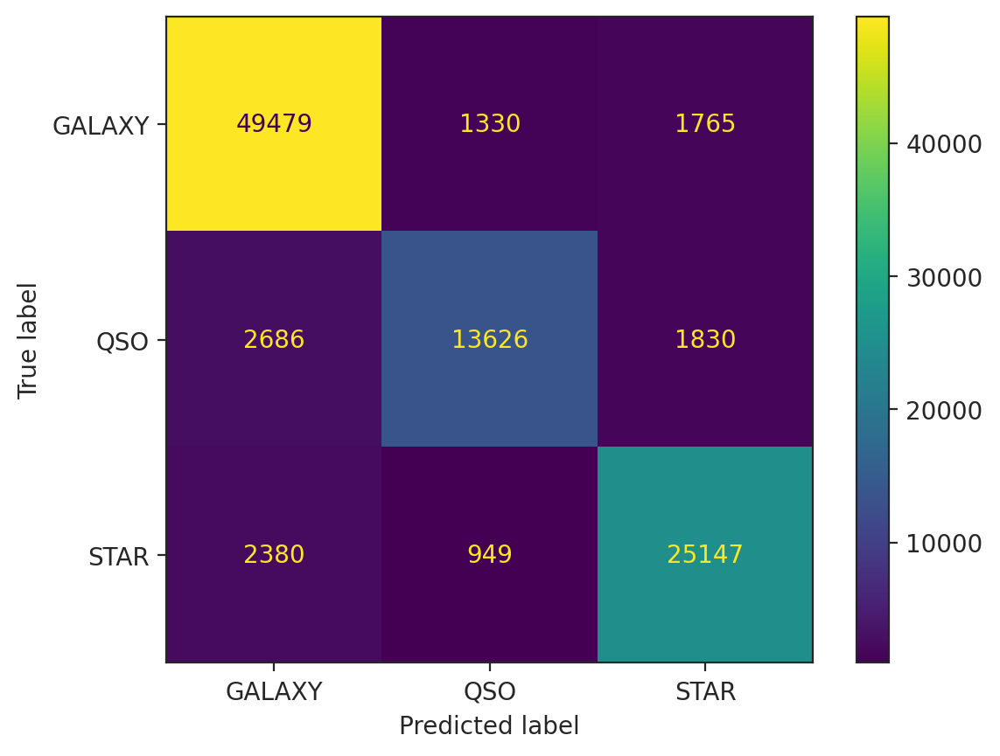

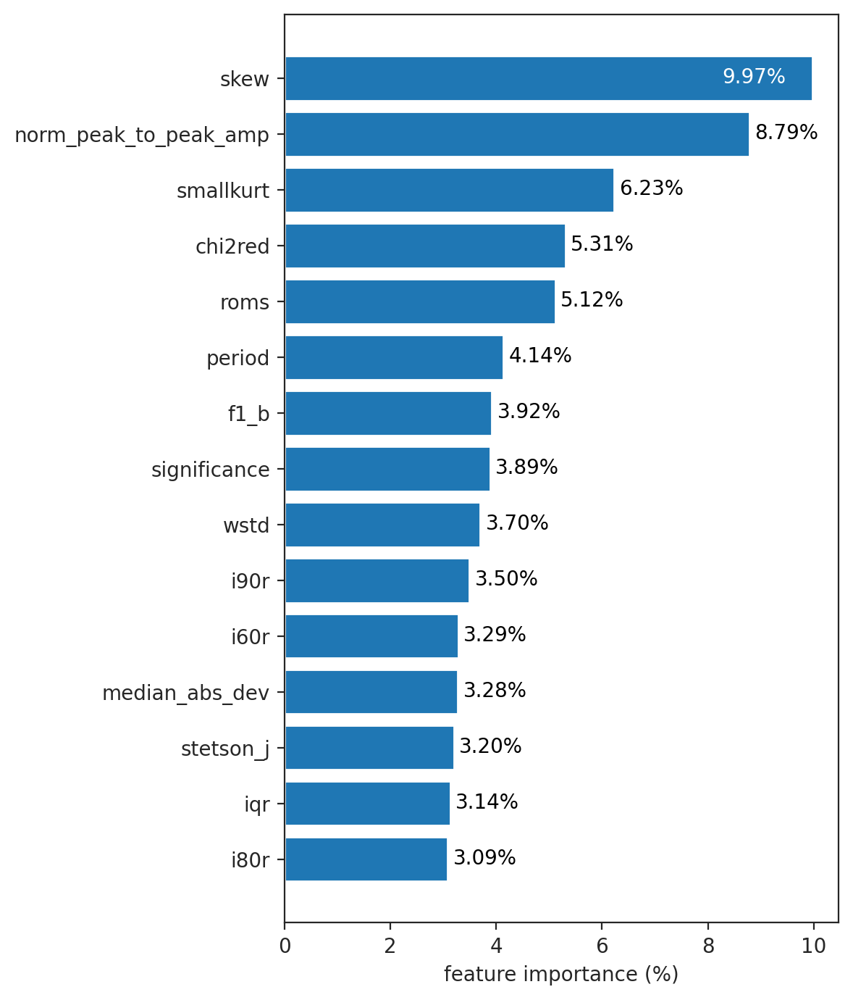

--------------------


In [25]:
data_label = 'ZTF'
filter = 'g'
make_reports(results_dict, feature_importance_dict, filter=filter, data_label=data_label)

features: ZTF
              precision    recall  f1-score   support

      GALAXY     0.9198    0.9513    0.9353     74073
         QSO     0.8373    0.7605    0.7970     20029
        STAR     0.8830    0.8634    0.8731     31695

    accuracy                         0.8988    125797
   macro avg     0.8800    0.8584    0.8685    125797
weighted avg     0.8974    0.8988    0.8976    125797



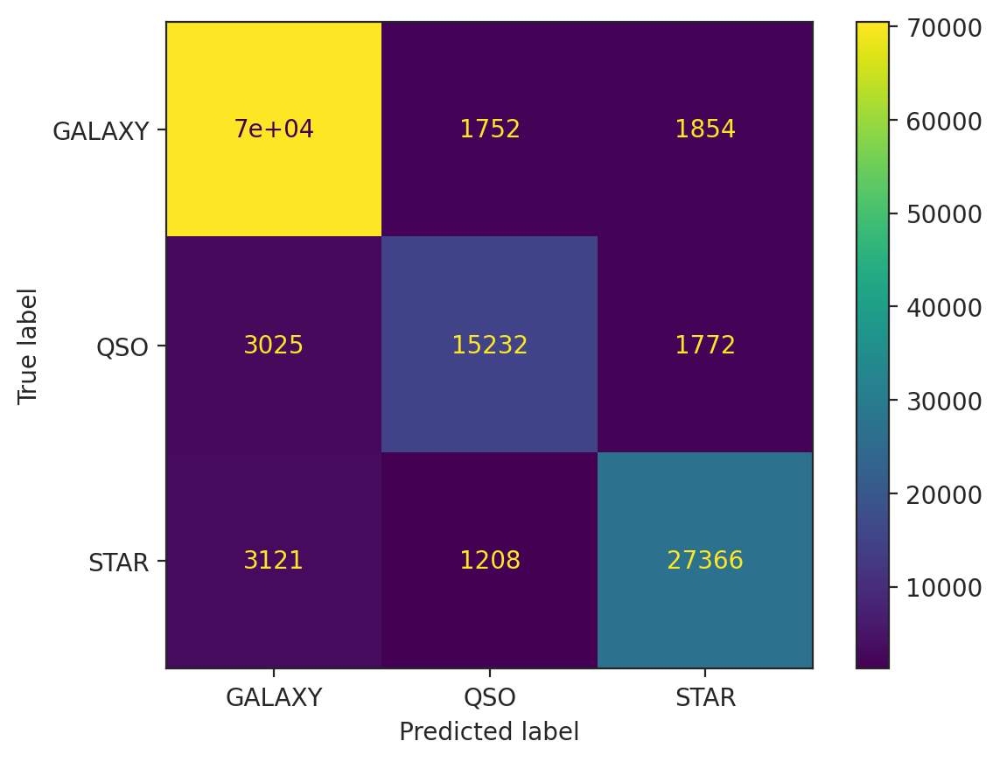

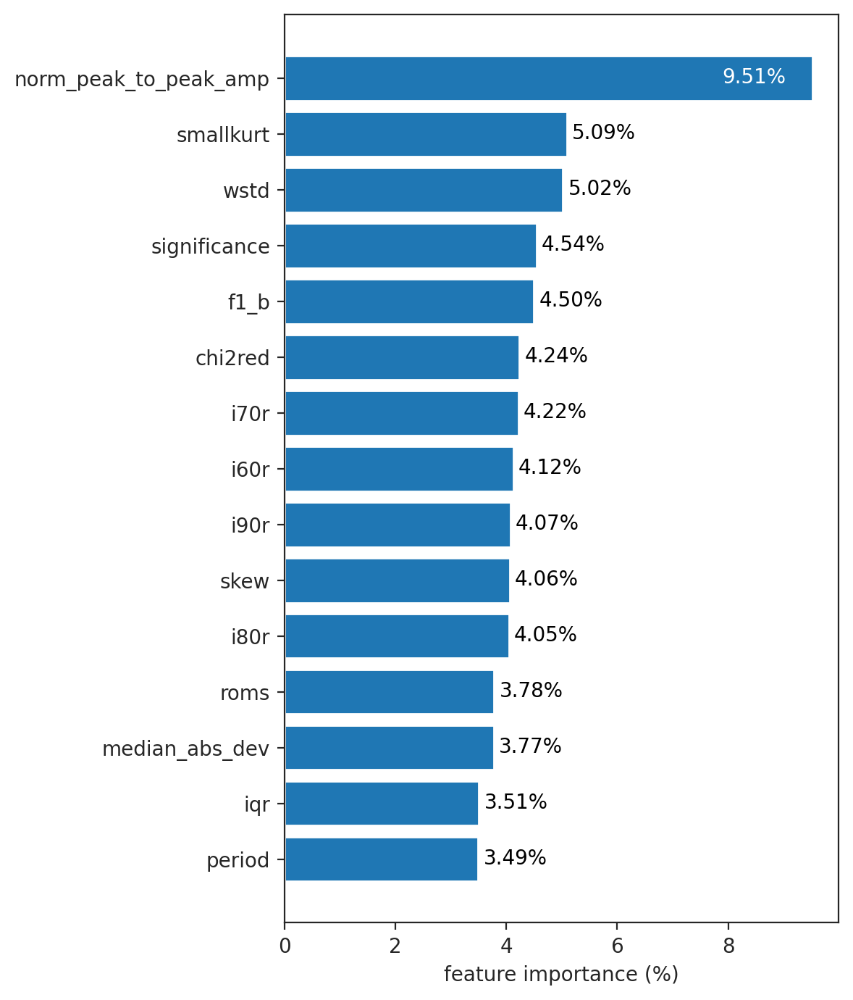

--------------------


In [26]:
data_label = 'ZTF'
filter = 'r'
make_reports(results_dict[filter][data_label], feature_importance_dict[filter][data_label])

## ZTF x PS

features: ZTF
              precision    recall  f1-score   support

      GALAXY     0.9102    0.9414    0.9255     52251
         QSO     0.8545    0.7618    0.8055     17962
        STAR     0.8761    0.8810    0.8785     28477

    accuracy                         0.8913     98690
   macro avg     0.8803    0.8614    0.8699     98690
weighted avg     0.8902    0.8913    0.8901     98690



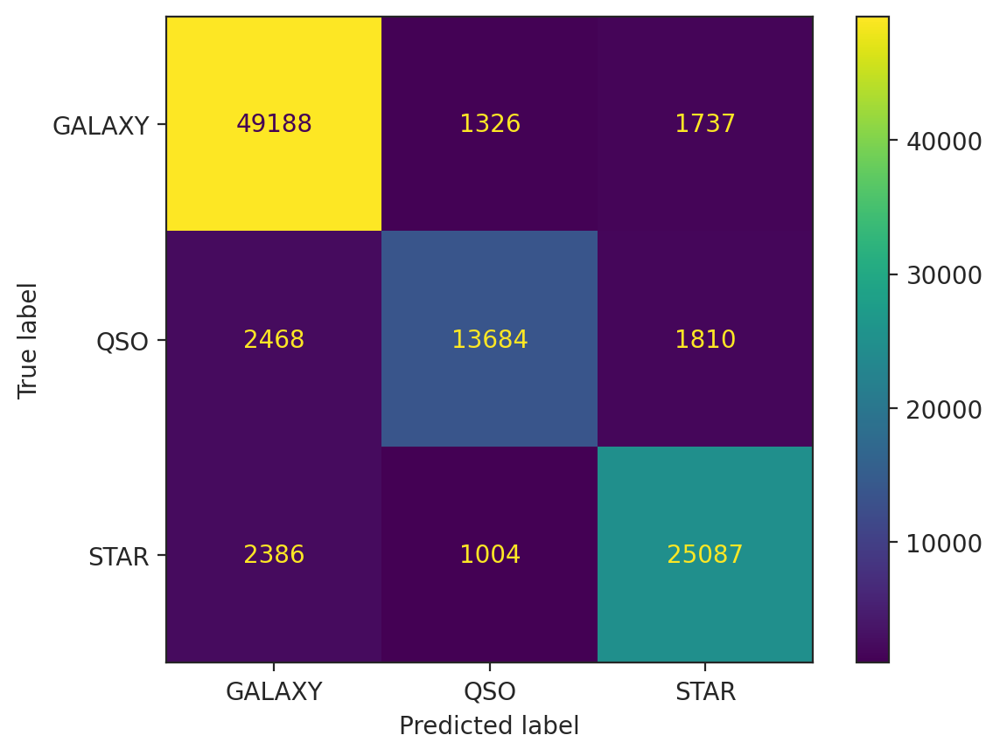

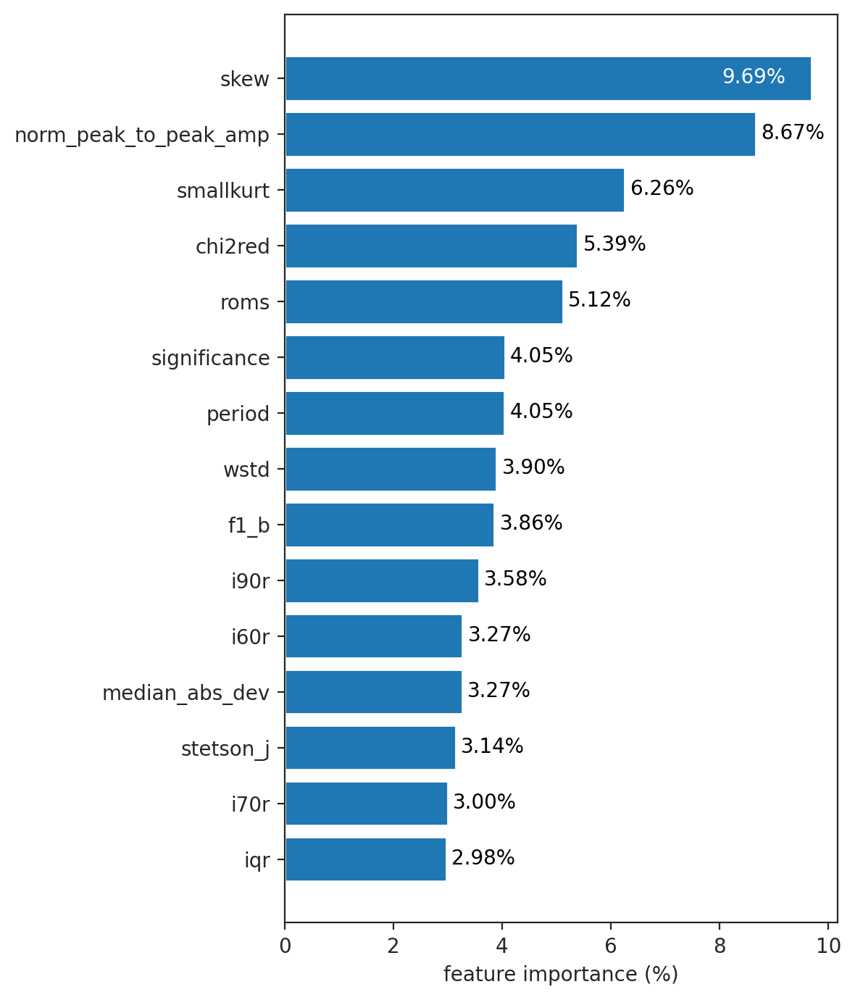

--------------------
features: AstrmClf
              precision    recall  f1-score   support

      GALAXY     0.9160    0.9398    0.9277     52251
         QSO     0.8903    0.8542    0.8719     17962
        STAR     0.8848    0.8654    0.8750     28477

    accuracy                         0.9027     98690
   macro avg     0.8971    0.8865    0.8915     98690
weighted avg     0.9023    0.9027    0.9024     98690



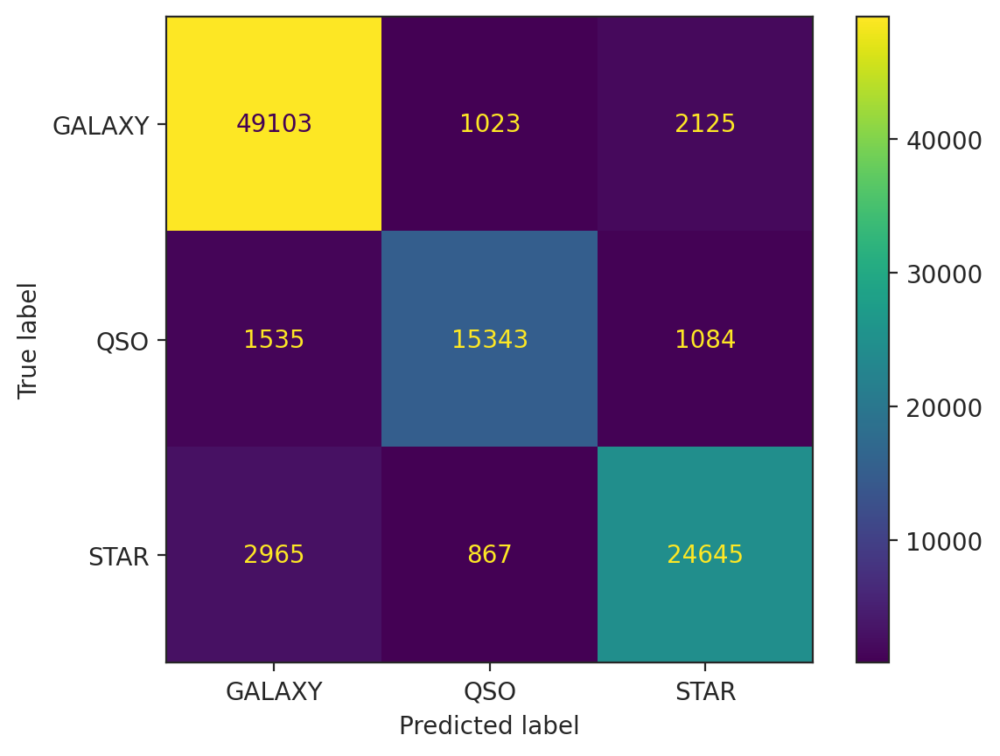

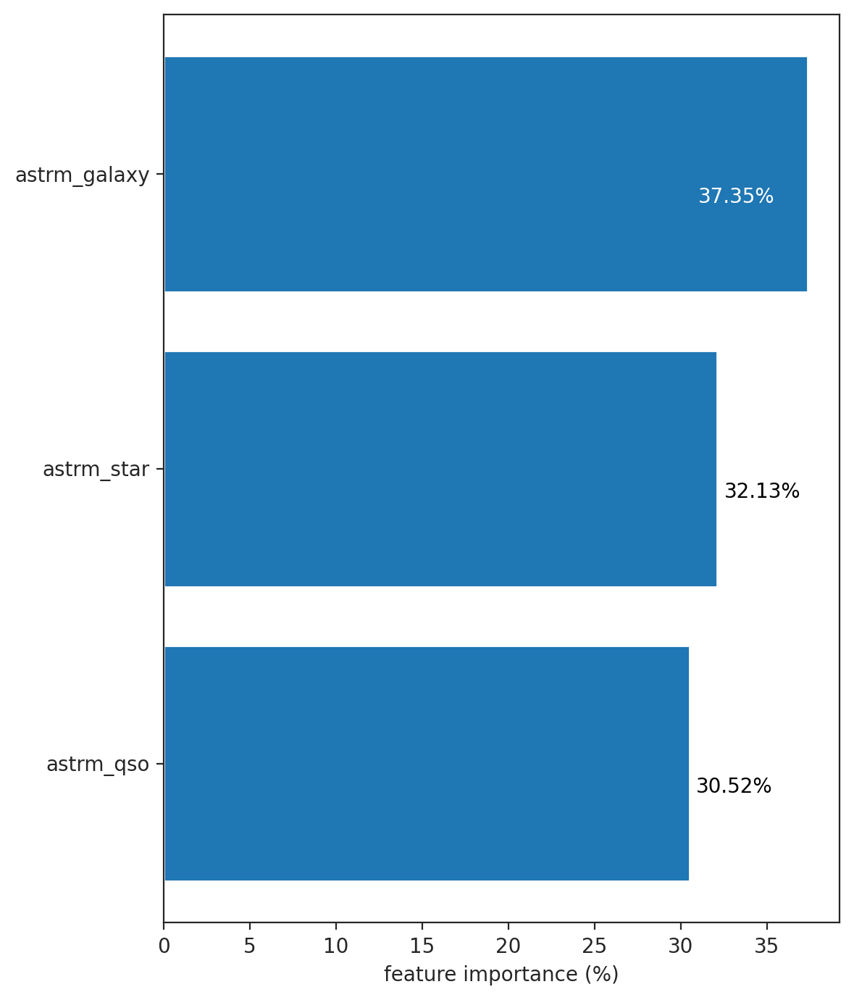

--------------------
features: PS
              precision    recall  f1-score   support

      GALAXY     0.9227    0.9374    0.9300     52251
         QSO     0.7944    0.7848    0.7896     17962
        STAR     0.9191    0.8994    0.9091     28477

    accuracy                         0.8987     98690
   macro avg     0.8788    0.8738    0.8762     98690
weighted avg     0.8983    0.8987    0.8984     98690



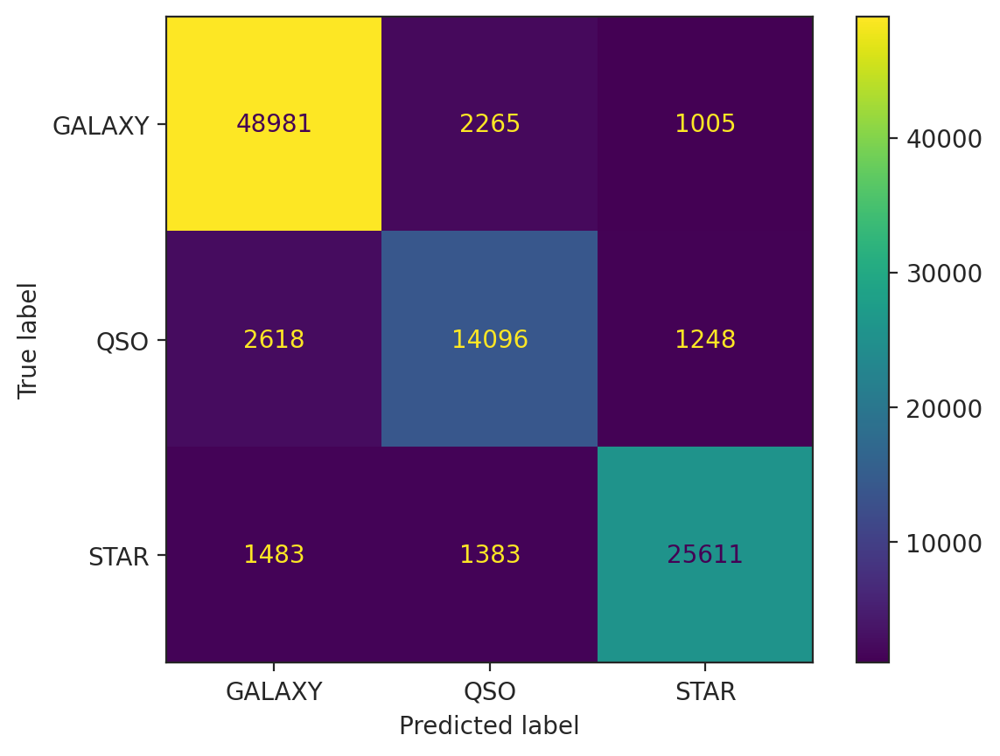

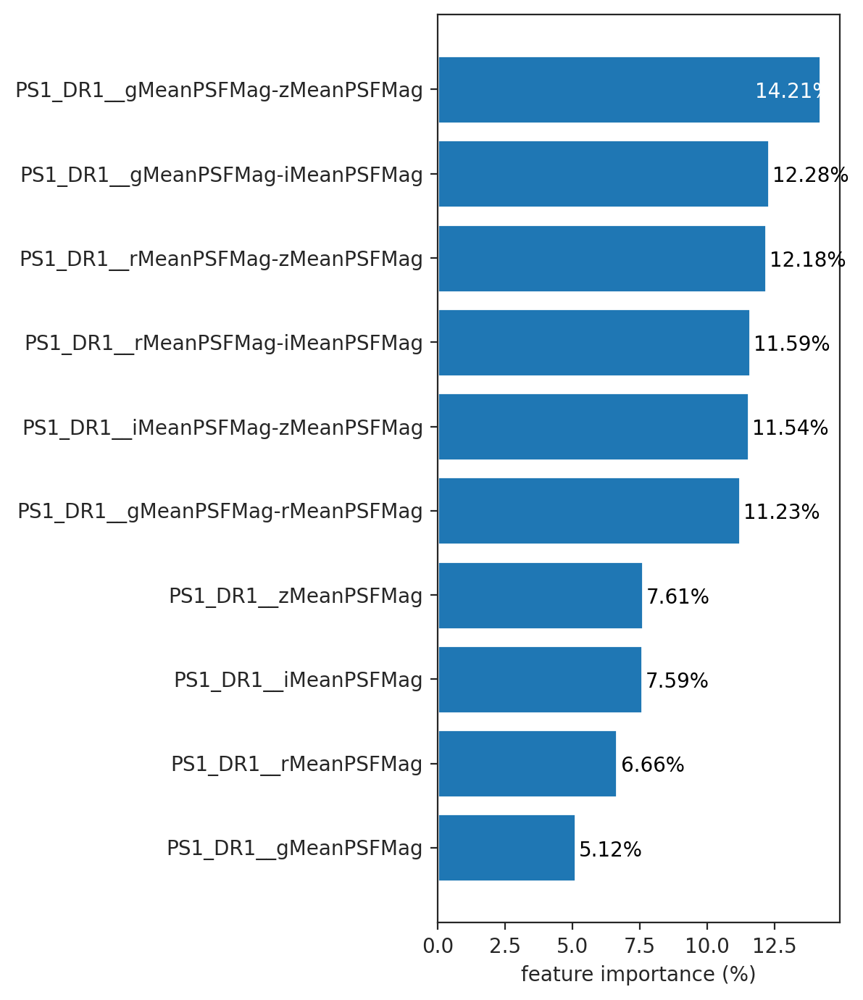

--------------------
features: ZTF + AstrmClf
              precision    recall  f1-score   support

      GALAXY     0.9378    0.9632    0.9503     52251
         QSO     0.9286    0.8653    0.8958     17962
        STAR     0.9146    0.9085    0.9115     28477

    accuracy                         0.9296     98690
   macro avg     0.9270    0.9123    0.9192     98690
weighted avg     0.9294    0.9296    0.9292     98690



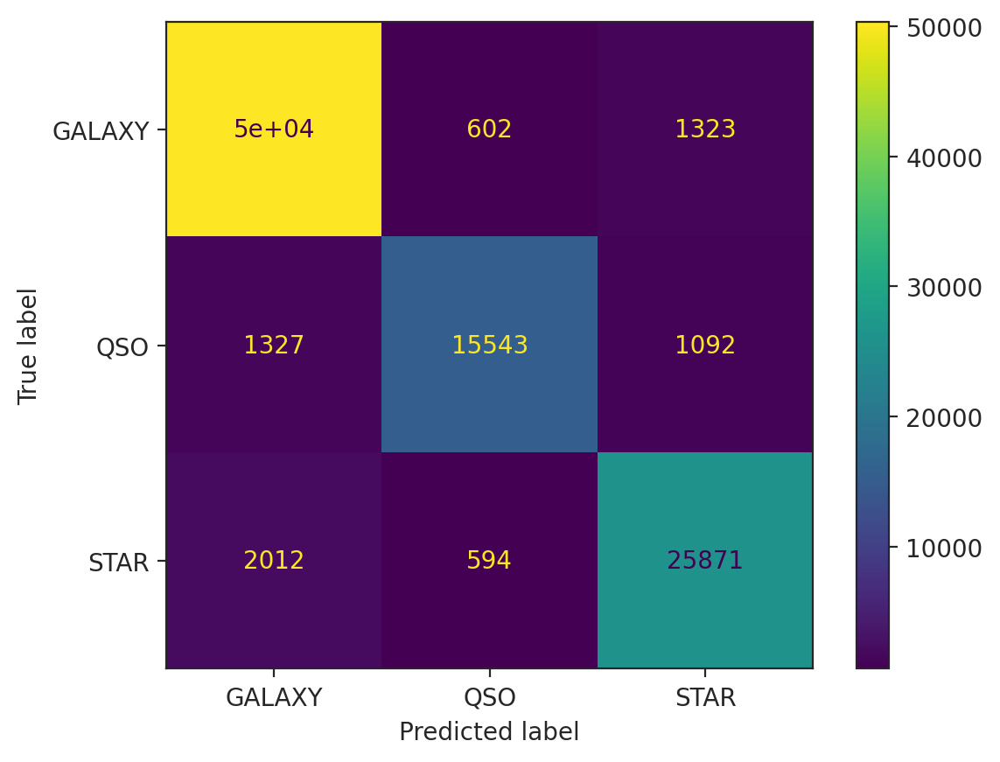

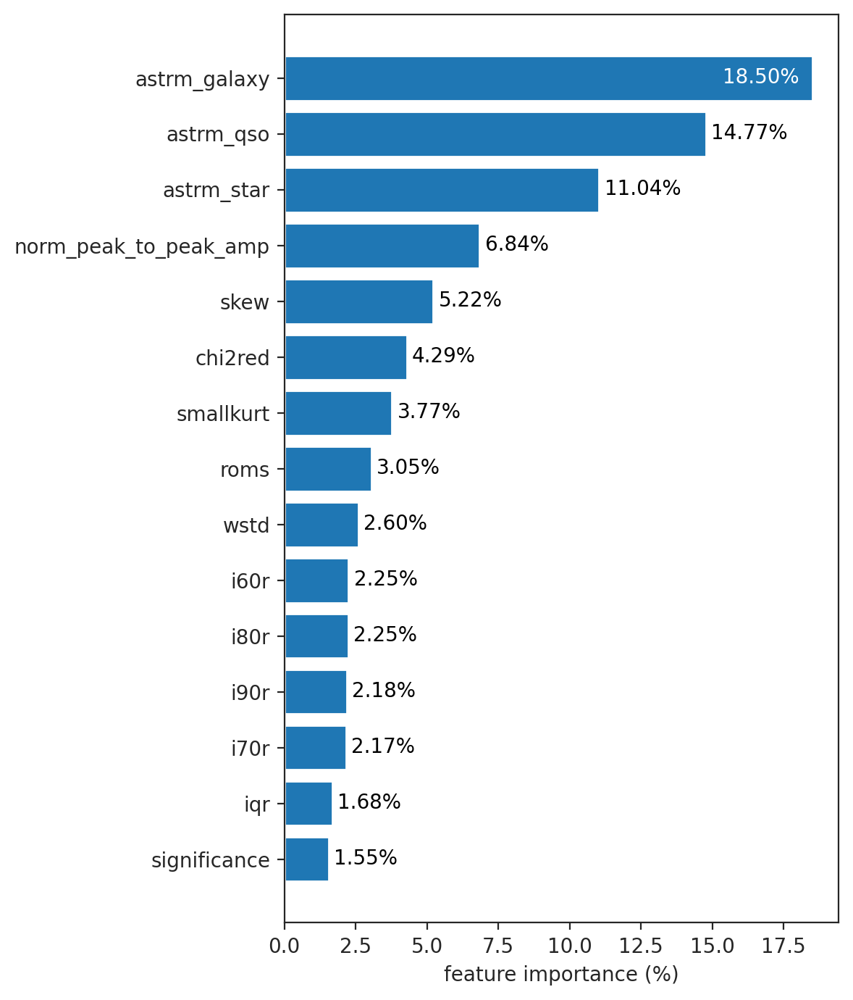

--------------------
features: ZTF + PS
              precision    recall  f1-score   support

      GALAXY     0.9692    0.9778    0.9735     52251
         QSO     0.9154    0.9252    0.9203     17962
        STAR     0.9610    0.9388    0.9498     28477

    accuracy                         0.9570     98690
   macro avg     0.9485    0.9473    0.9478     98690
weighted avg     0.9570    0.9570    0.9569     98690



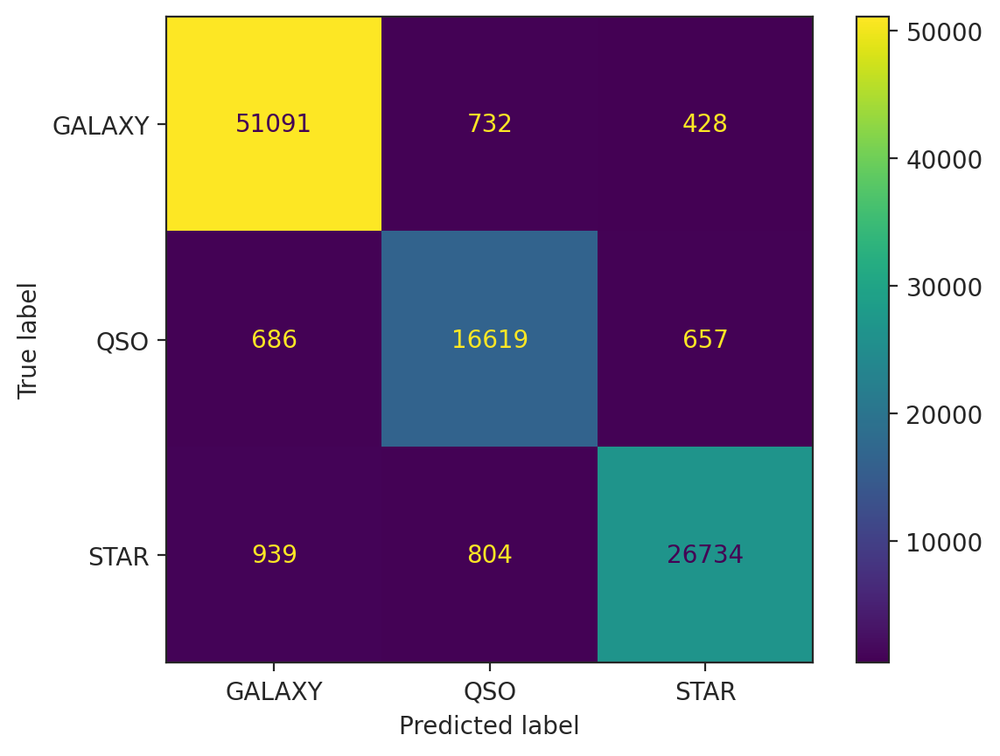

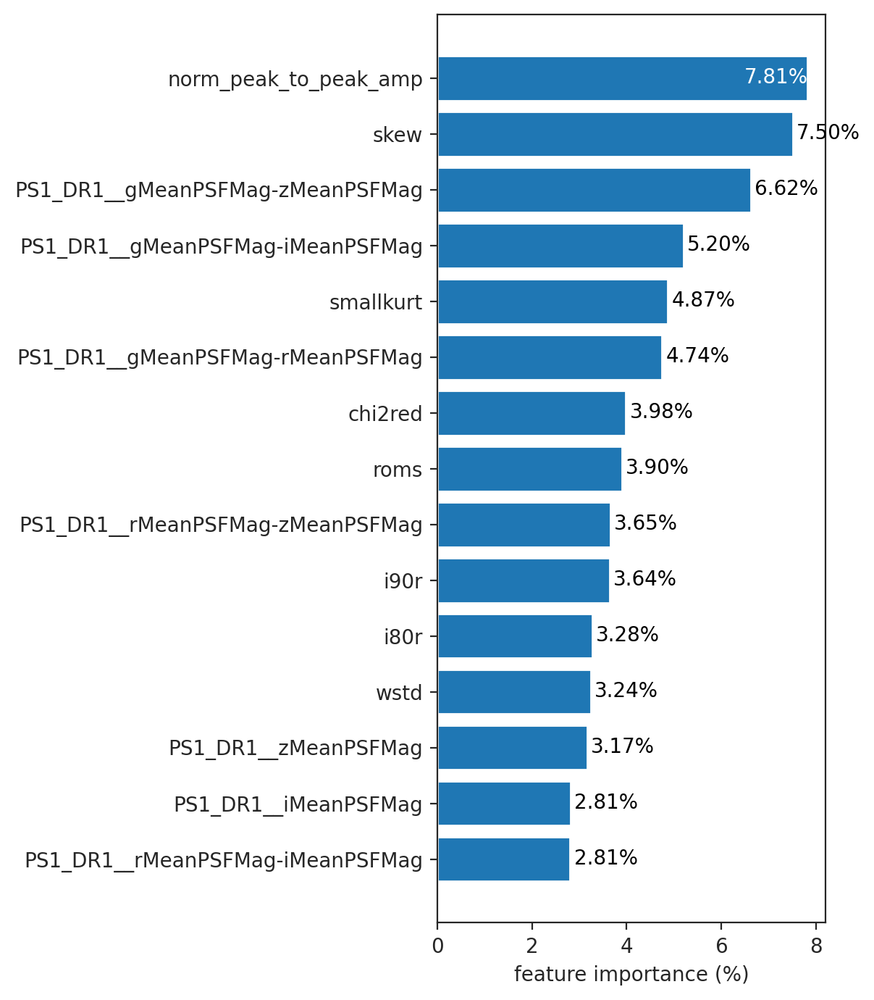

--------------------
features: AstrmClf + PS
              precision    recall  f1-score   support

      GALAXY     0.9697    0.9791    0.9744     52251
         QSO     0.9428    0.9307    0.9367     17962
        STAR     0.9578    0.9483    0.9530     28477

    accuracy                         0.9614     98690
   macro avg     0.9567    0.9527    0.9547     98690
weighted avg     0.9613    0.9614    0.9614     98690



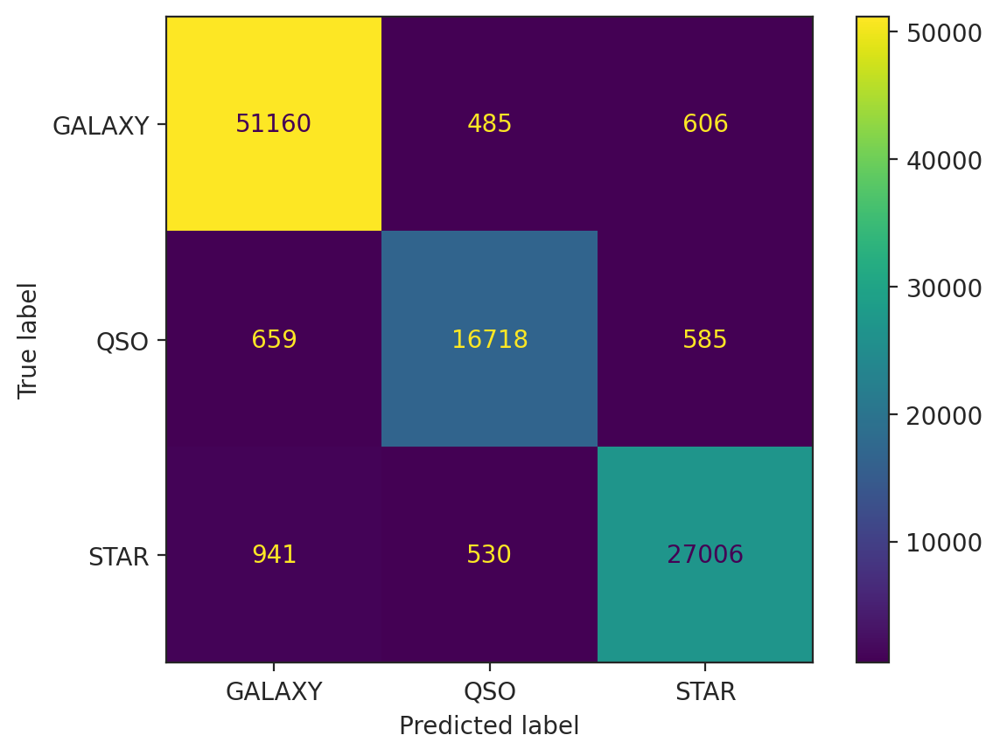

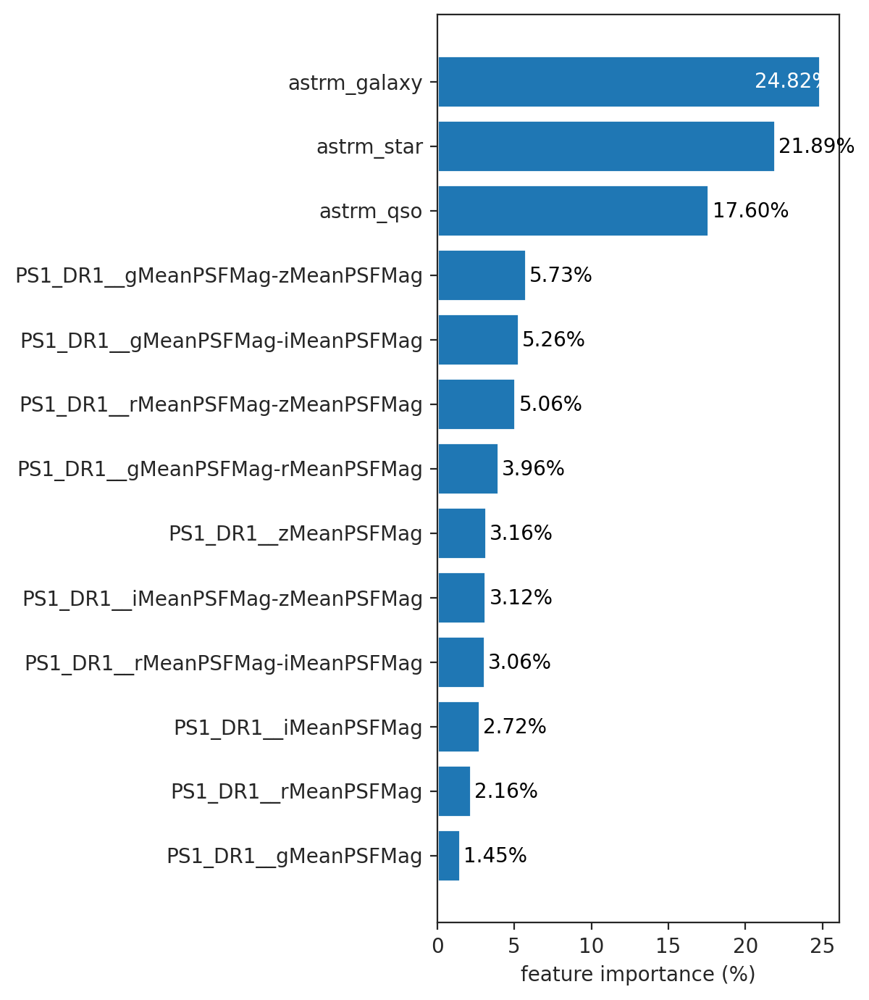

--------------------
features: ZTF + AstrmClf + PS
              precision    recall  f1-score   support

      GALAXY     0.9760    0.9814    0.9787     52251
         QSO     0.9471    0.9373    0.9422     17962
        STAR     0.9579    0.9543    0.9561     28477

    accuracy                         0.9656     98690
   macro avg     0.9603    0.9577    0.9590     98690
weighted avg     0.9655    0.9656    0.9655     98690



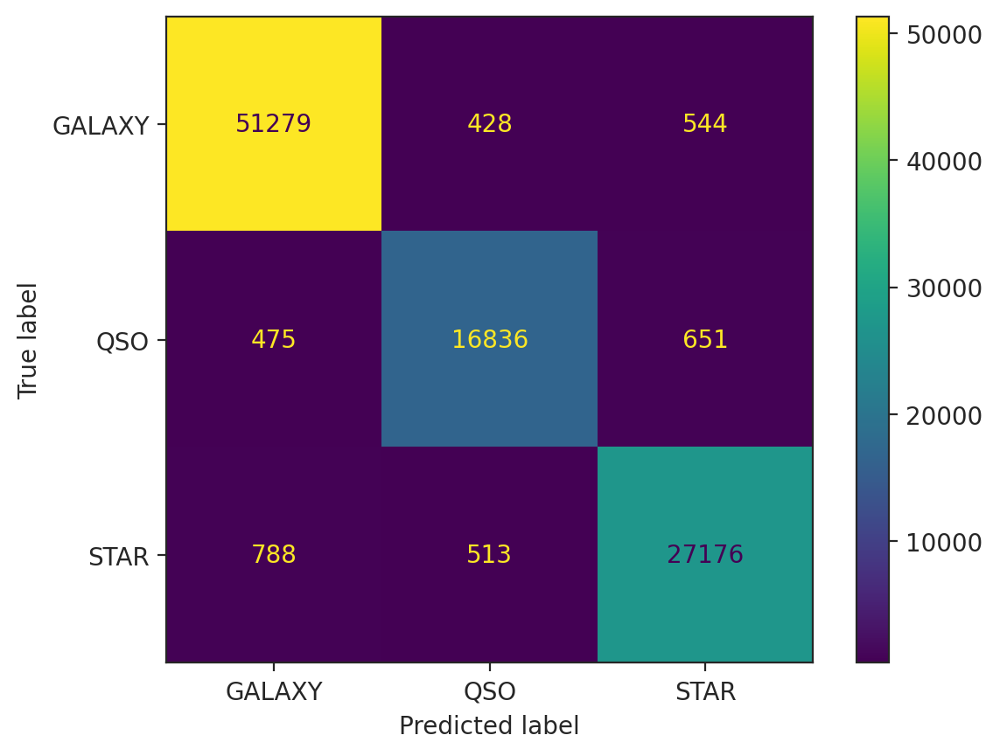

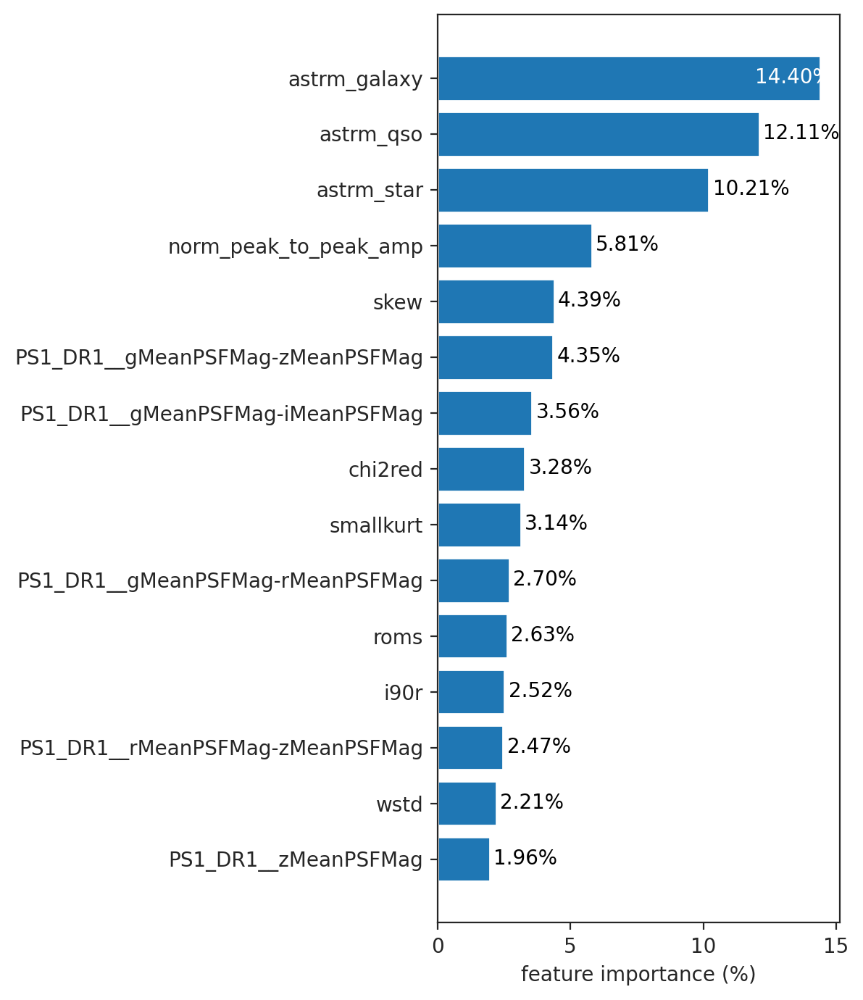

--------------------
features: Astrm


KeyError: 'Astrm'

In [27]:
data_label = 'ZTF_PS'
filter = 'g'
make_reports(results_dict[filter][data_label], feature_importance_dict[filter][data_label])

features: ZTF


              precision    recall  f1-score   support

      GALAXY     0.9252    0.9506    0.9377     72649
         QSO     0.8378    0.7740    0.8046     19910
        STAR     0.8834    0.8698    0.8765     31380

    accuracy                         0.9018    123939
   macro avg     0.8821    0.8648    0.8730    123939
weighted avg     0.9006    0.9018    0.9009    123939



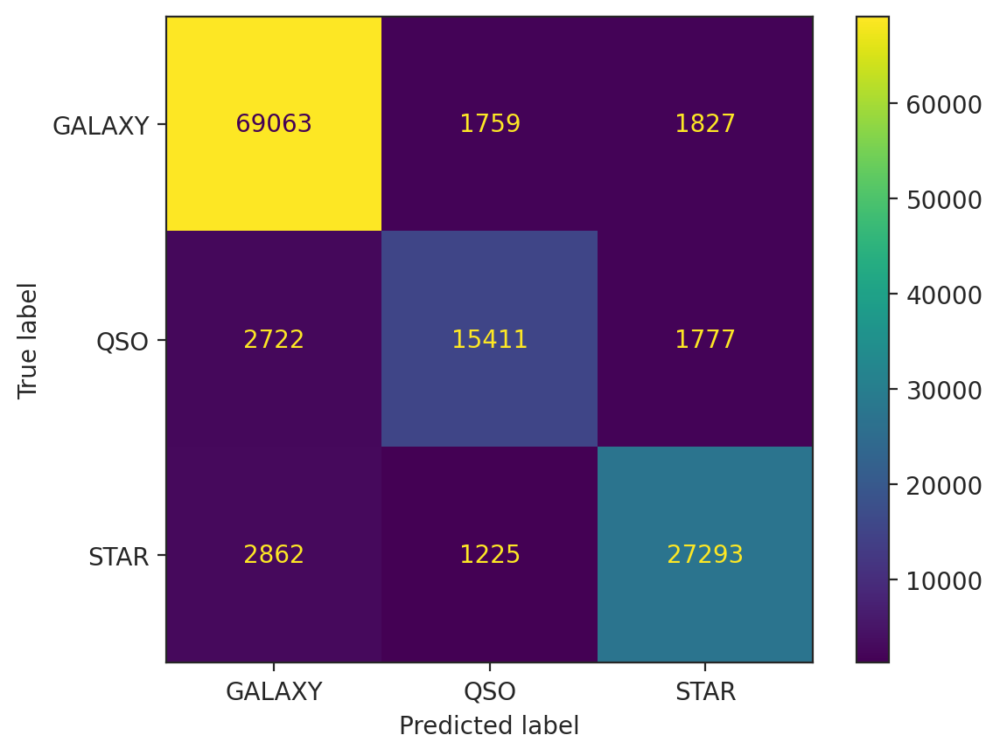

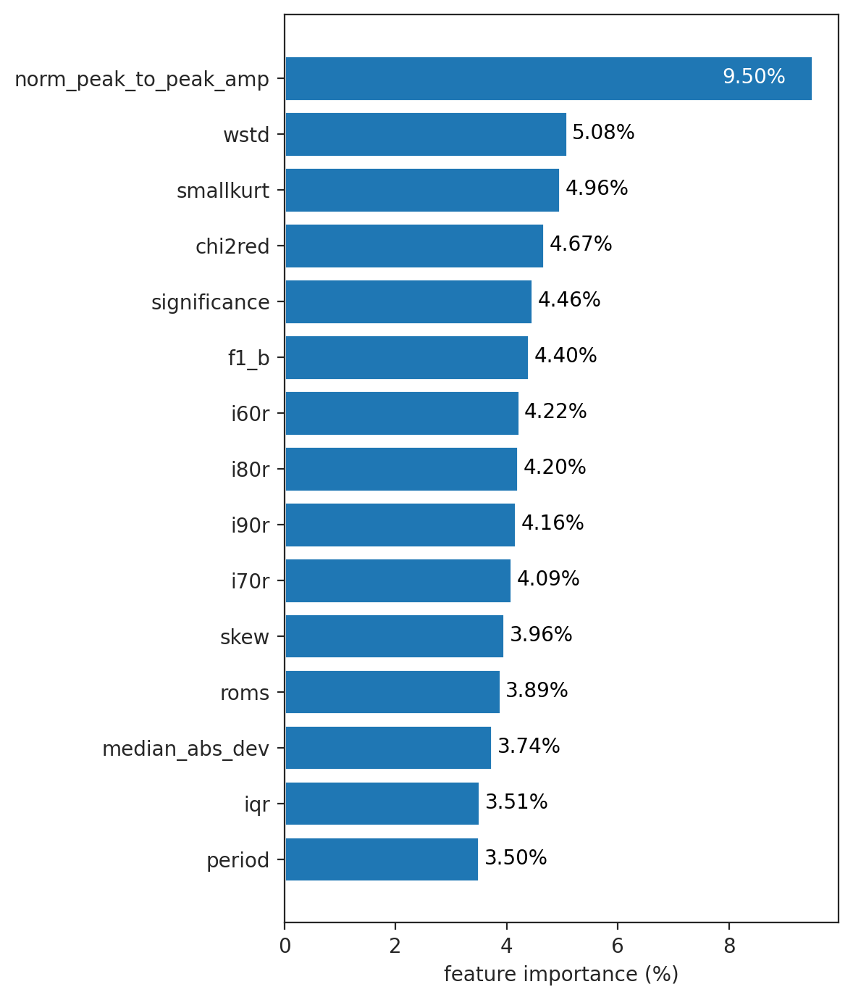

--------------------
features: AstrmClf
              precision    recall  f1-score   support

      GALAXY     0.9063    0.9424    0.9240     72649
         QSO     0.8771    0.8265    0.8511     19910
        STAR     0.8649    0.8169    0.8402     31380

    accuracy                         0.8920    123939
   macro avg     0.8828    0.8619    0.8718    123939
weighted avg     0.8912    0.8920    0.8911    123939



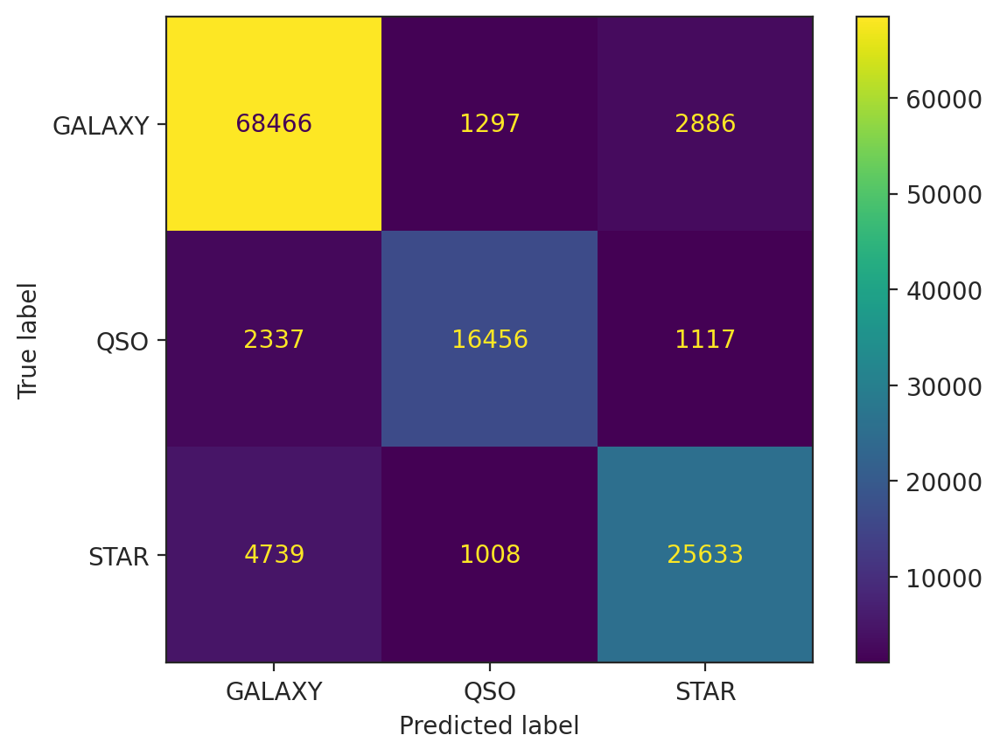

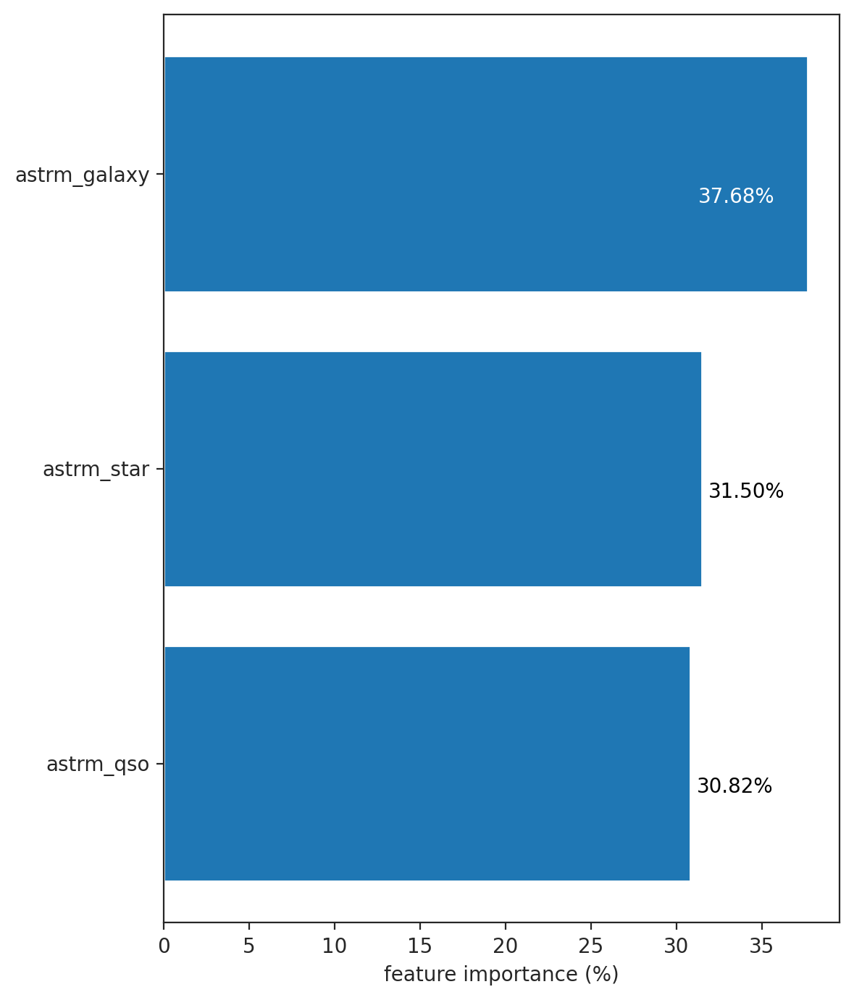

--------------------
features: PS
              precision    recall  f1-score   support

      GALAXY     0.9278    0.9433    0.9355     72649
         QSO     0.7823    0.7513    0.7665     19910
        STAR     0.9052    0.8930    0.8991     31380

    accuracy                         0.8997    123939
   macro avg     0.8718    0.8625    0.8670    123939
weighted avg     0.8987    0.8997    0.8991    123939



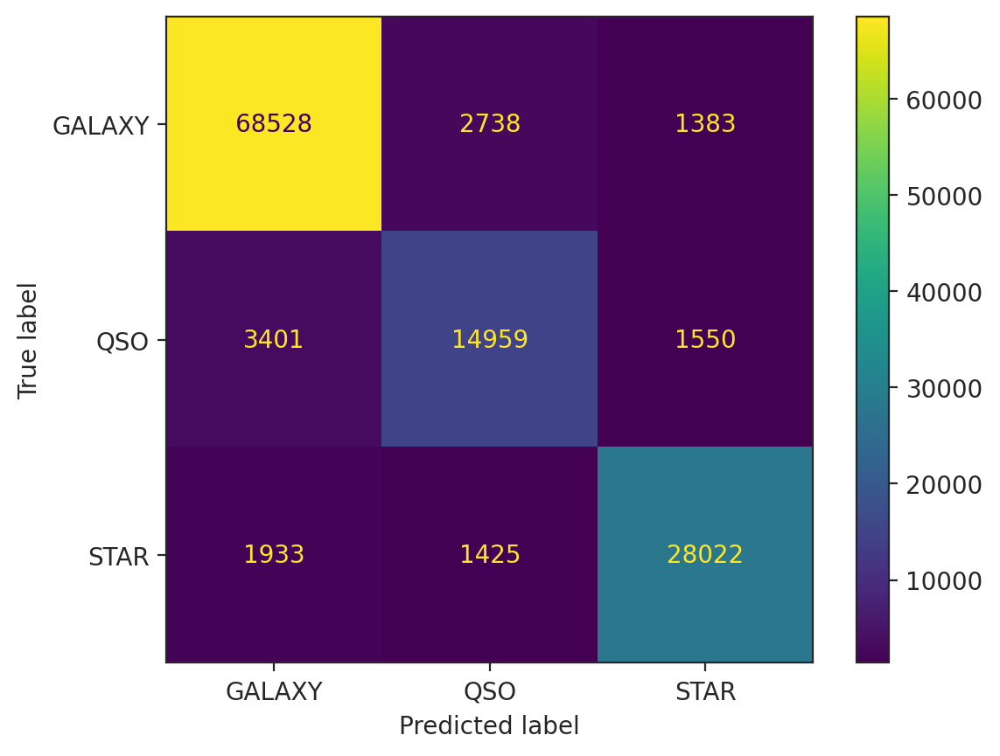

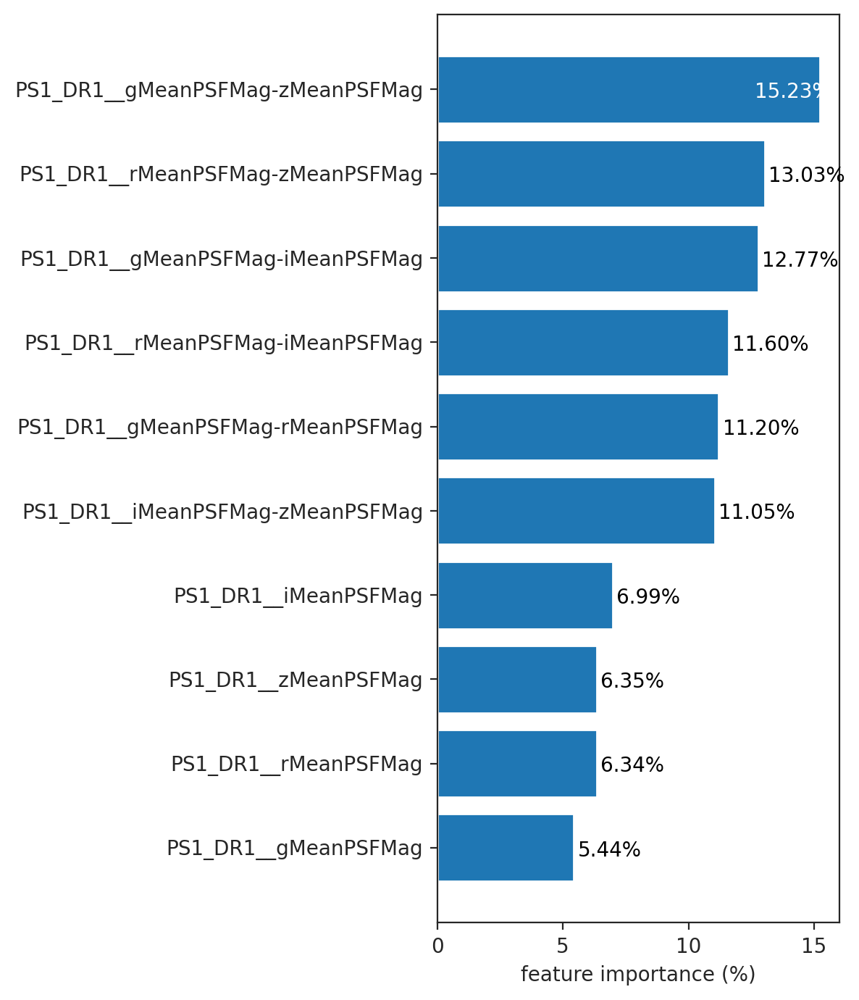

--------------------
features: ZTF + AstrmClf
              precision    recall  f1-score   support

      GALAXY     0.9445    0.9640    0.9541     72649
         QSO     0.9100    0.8542    0.8812     19910
        STAR     0.9039    0.8958    0.8998     31380

    accuracy                         0.9291    123939
   macro avg     0.9195    0.9047    0.9117    123939
weighted avg     0.9287    0.9291    0.9287    123939



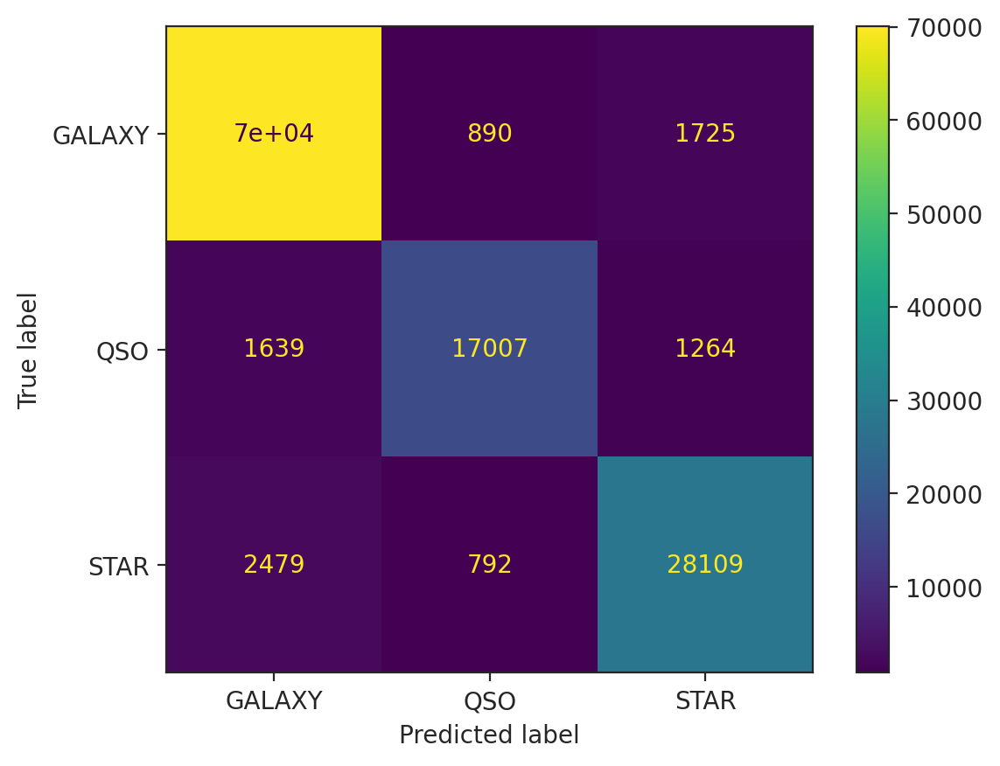

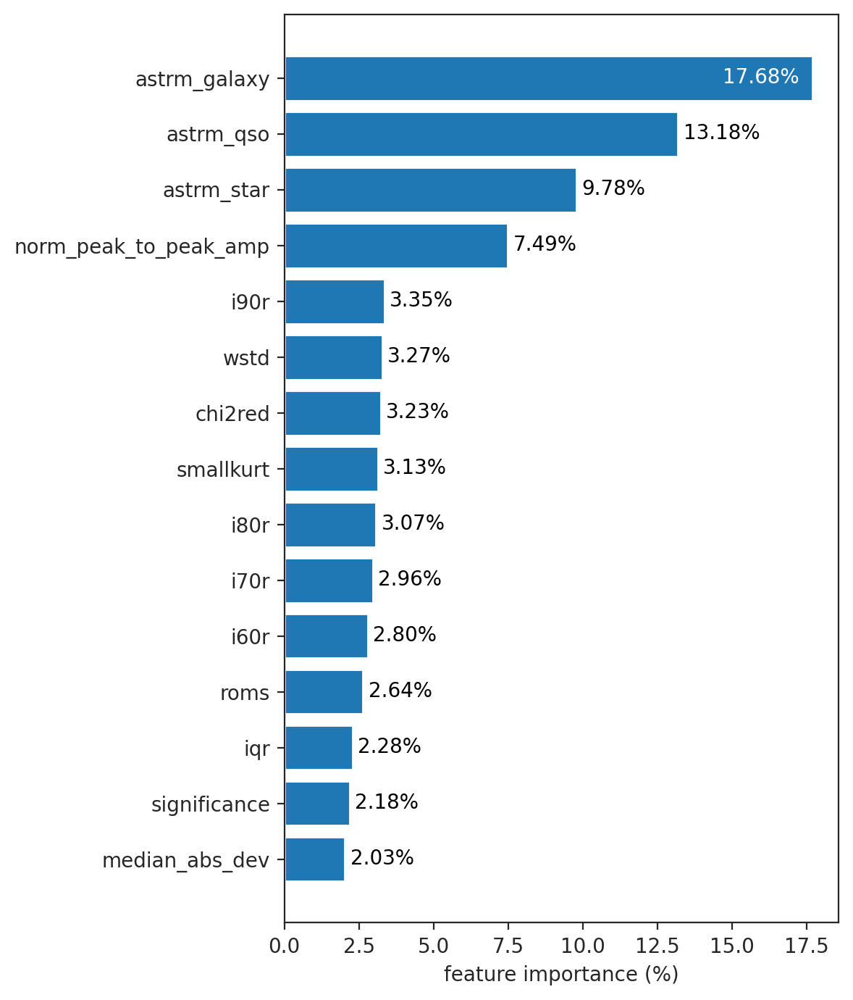

--------------------
features: ZTF + PS
              precision    recall  f1-score   support

      GALAXY     0.9720    0.9831    0.9775     72649
         QSO     0.9157    0.9047    0.9102     19910
        STAR     0.9577    0.9395    0.9486     31380

    accuracy                         0.9595    123939
   macro avg     0.9485    0.9425    0.9454    123939
weighted avg     0.9593    0.9595    0.9594    123939



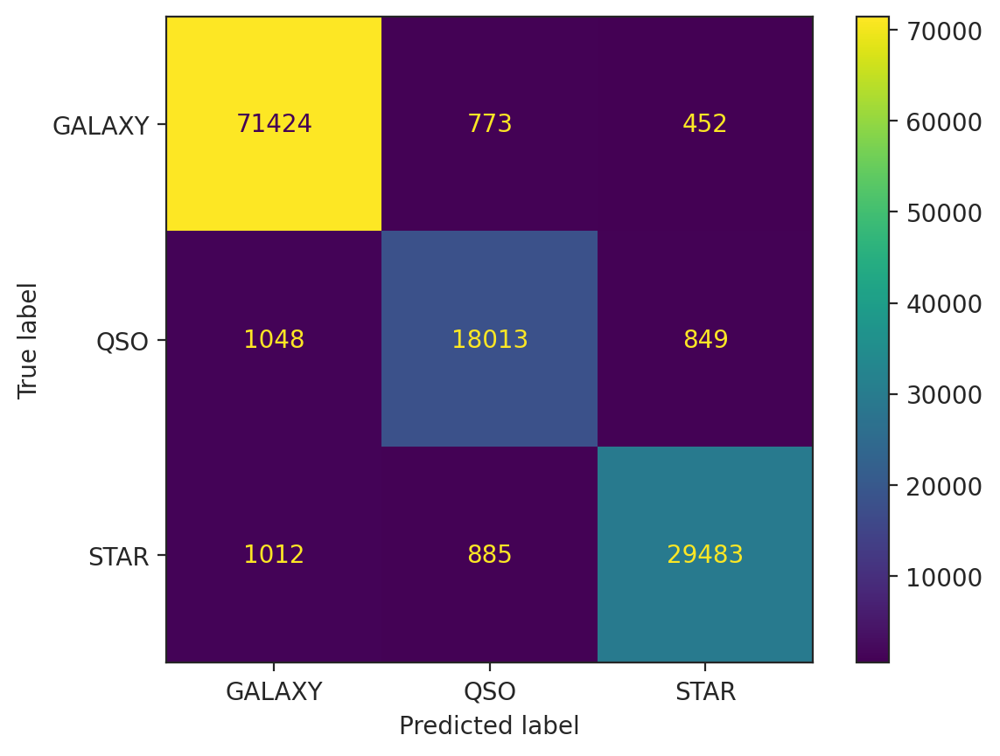

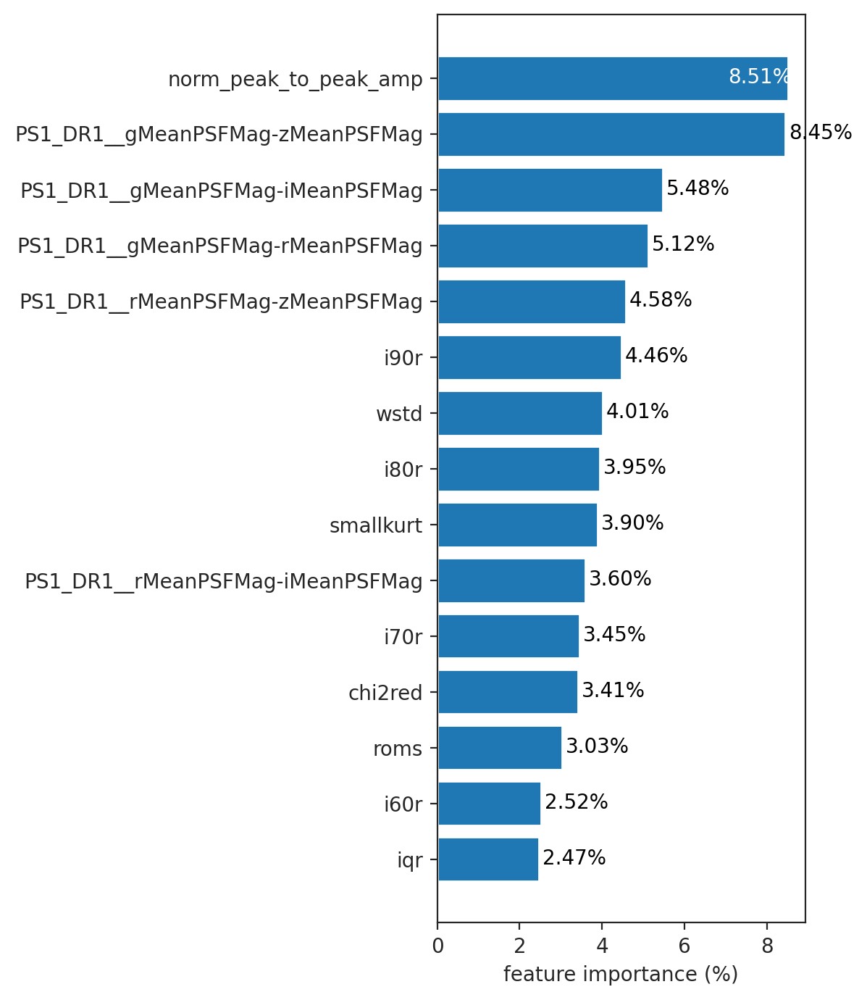

--------------------
features: AstrmClf + PS
              precision    recall  f1-score   support

      GALAXY     0.9663    0.9821    0.9742     72649
         QSO     0.9386    0.9009    0.9193     19910
        STAR     0.9546    0.9429    0.9487     31380

    accuracy                         0.9591    123939
   macro avg     0.9532    0.9419    0.9474    123939
weighted avg     0.9589    0.9591    0.9589    123939



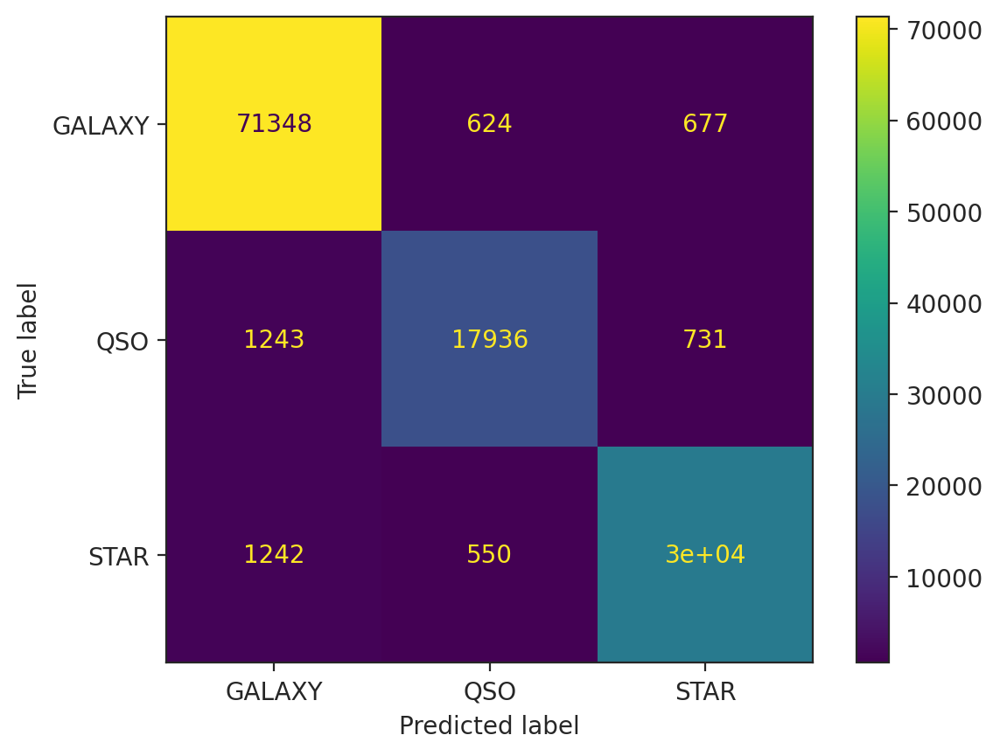

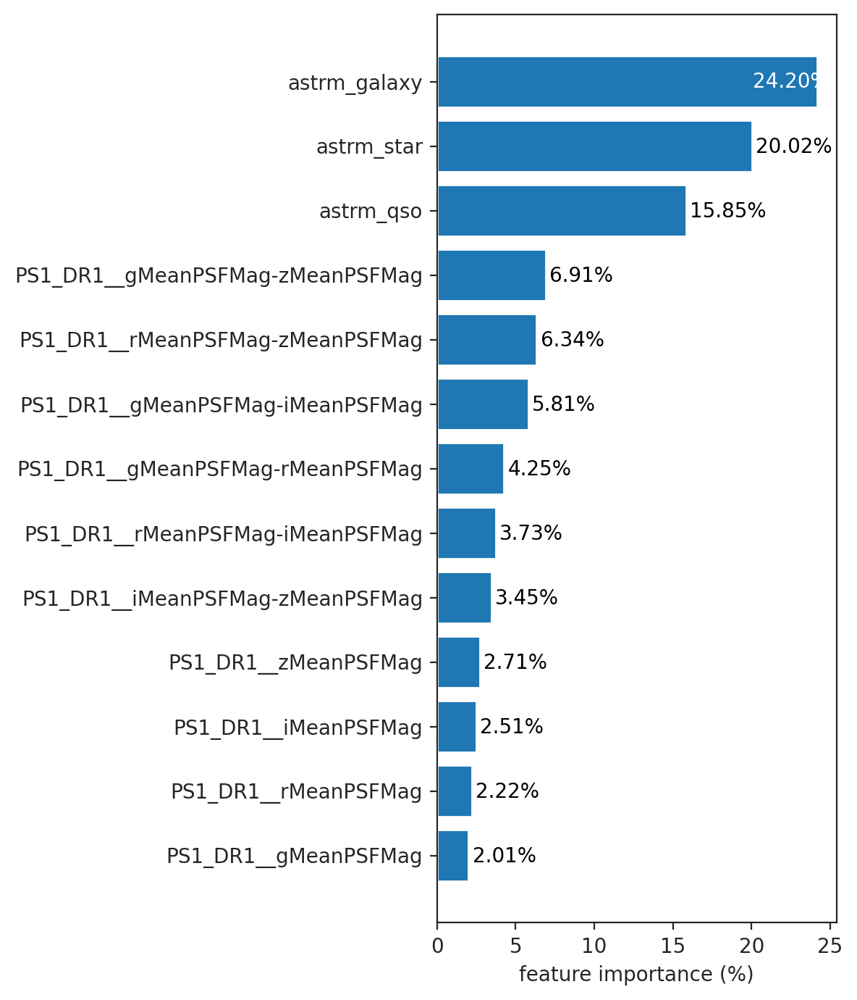

--------------------
features: ZTF + AstrmClf + PS
              precision    recall  f1-score   support

      GALAXY     0.9753    0.9856    0.9804     72649
         QSO     0.9455    0.9151    0.9300     19910
        STAR     0.9554    0.9515    0.9534     31380

    accuracy                         0.9656    123939
   macro avg     0.9587    0.9507    0.9546    123939
weighted avg     0.9655    0.9656    0.9655    123939



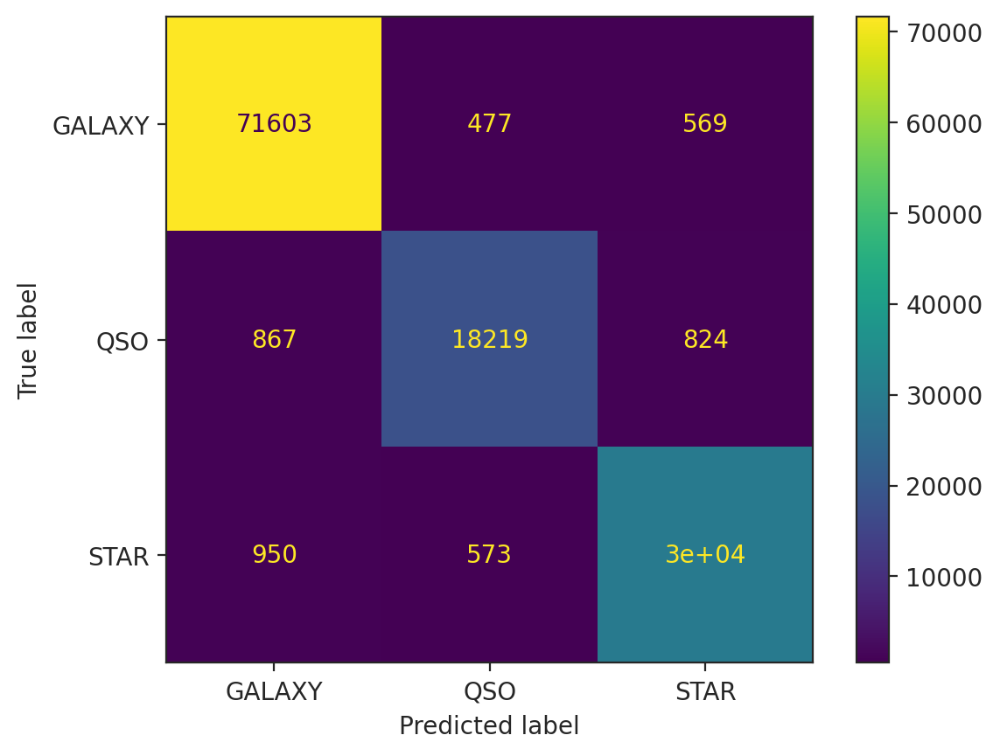

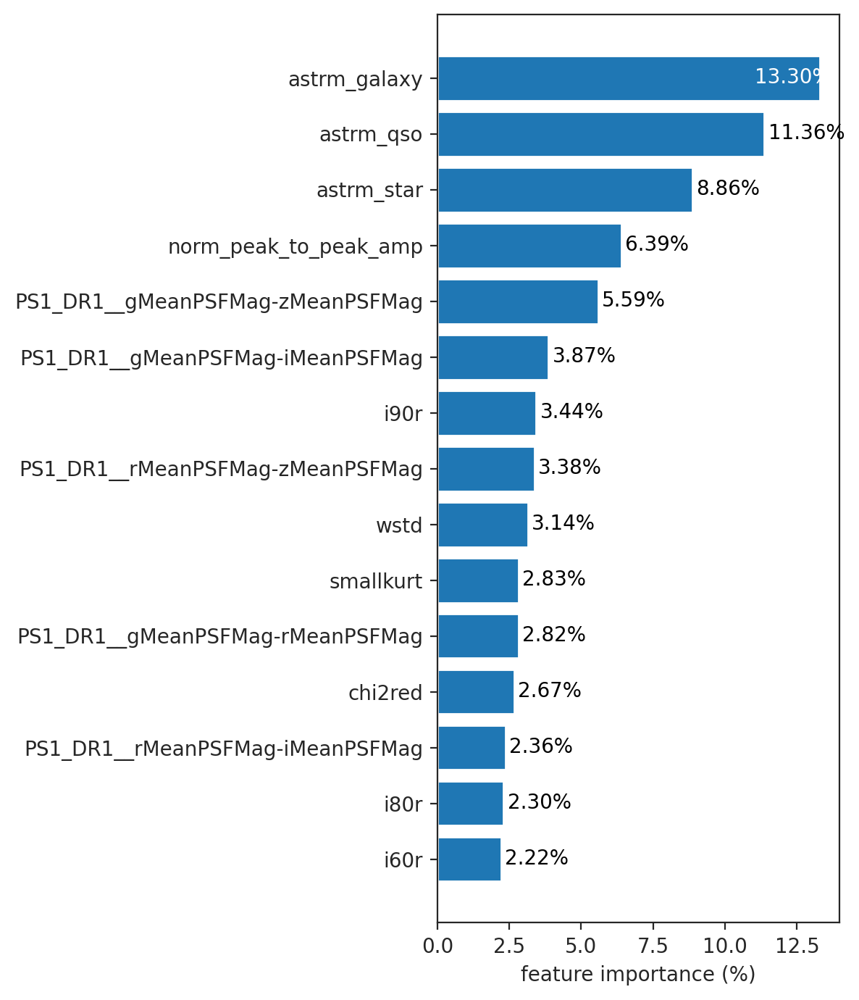

--------------------
features: Astrm


KeyError: 'Astrm'

In [28]:
data_label = 'ZTF_PS'
filter = 'r'
make_reports(results_dict[filter][data_label], feature_importance_dict[filter][data_label])

features: ZTF
              precision    recall  f1-score   support

      GALAXY     0.9301    0.9521    0.9410     75141
         QSO     0.8559    0.8213    0.8383     23078
        STAR     0.8977    0.8754    0.8864     33909

    accuracy                         0.9096    132128
   macro avg     0.8946    0.8830    0.8886    132128
weighted avg     0.9089    0.9096    0.9091    132128



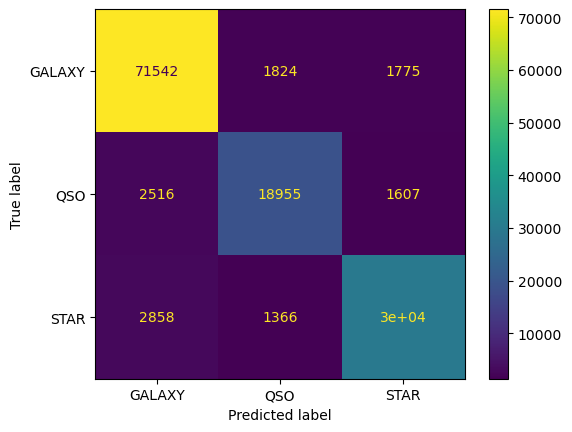

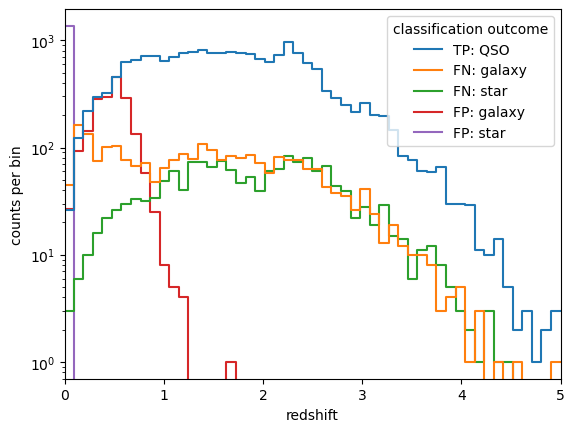

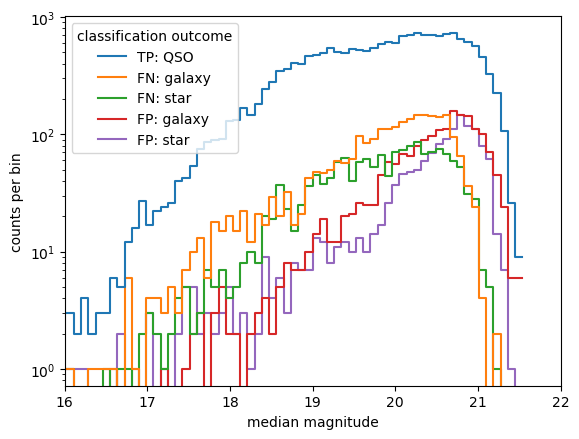

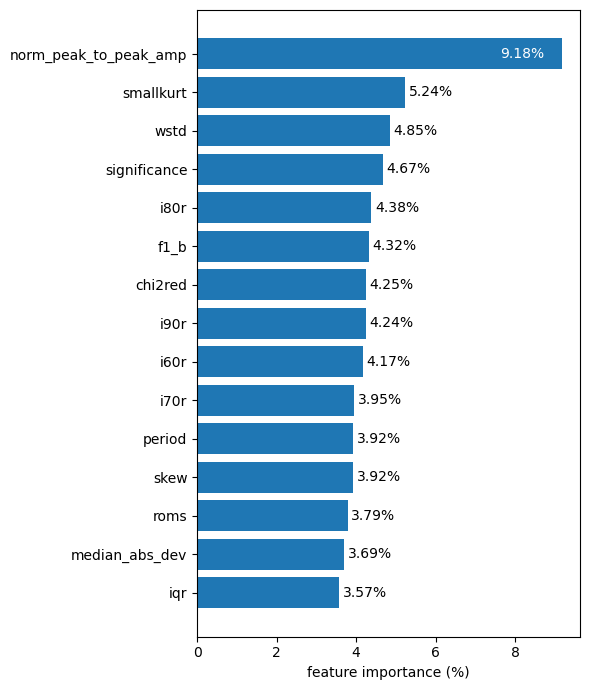

--------------------
features: PS
              precision    recall  f1-score   support

      GALAXY     0.9343    0.9444    0.9393     75141
         QSO     0.8105    0.8057    0.8081     23078
        STAR     0.9168    0.8986    0.9076     33909

    accuracy                         0.9084    132128
   macro avg     0.8872    0.8829    0.8850    132128
weighted avg     0.9082    0.9084    0.9082    132128



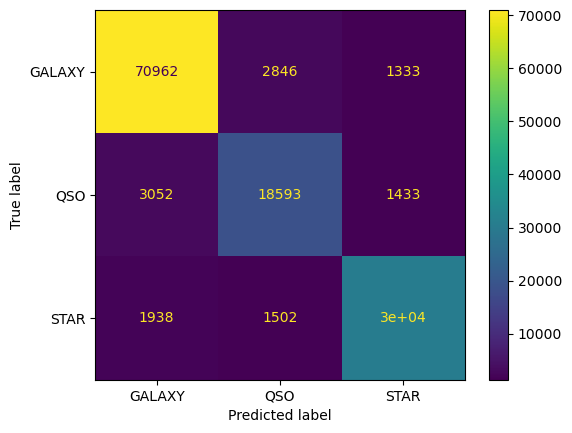

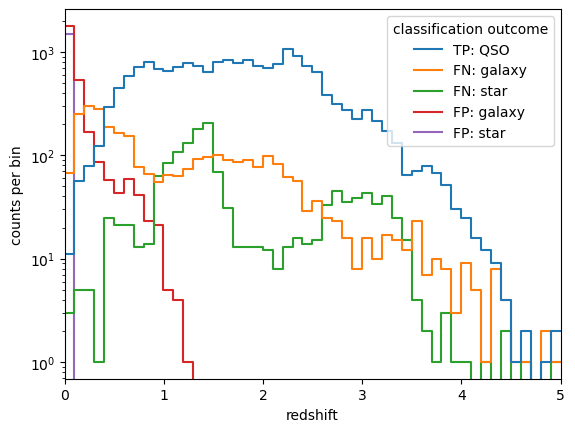

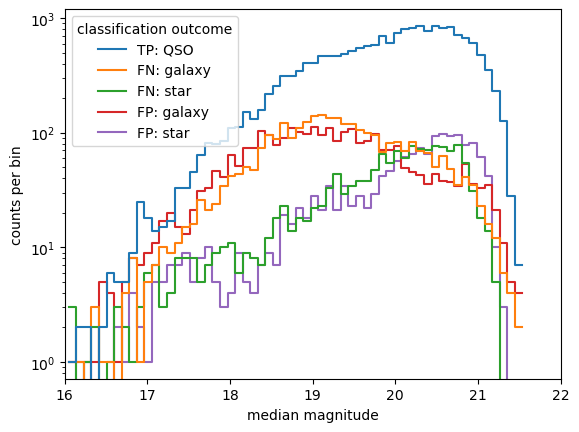

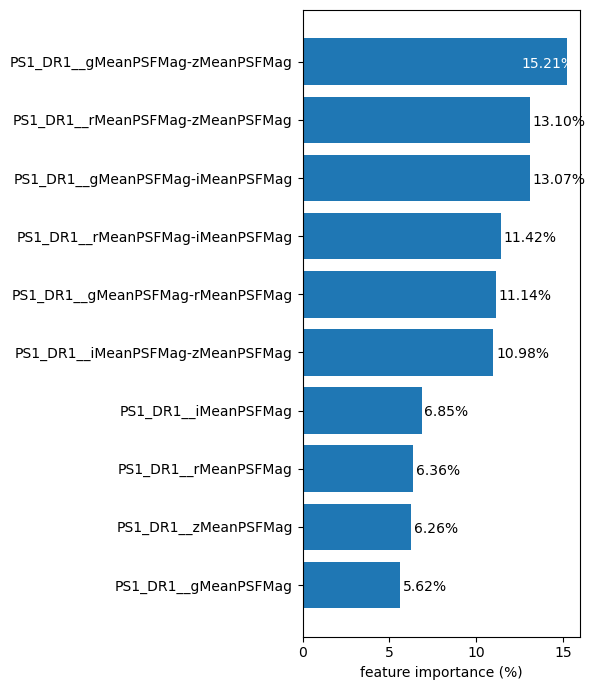

--------------------
features: ZTF + PS
              precision    recall  f1-score   support

      GALAXY     0.9729    0.9840    0.9784     75141
         QSO     0.9269    0.9235    0.9252     23078
        STAR     0.9630    0.9411    0.9519     33909

    accuracy                         0.9624    132128
   macro avg     0.9542    0.9495    0.9518    132128
weighted avg     0.9623    0.9624    0.9623    132128



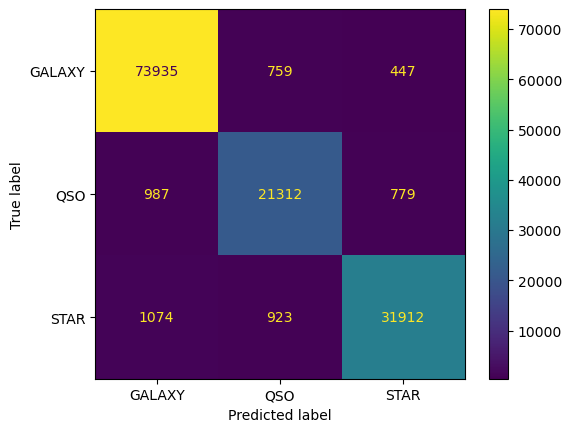

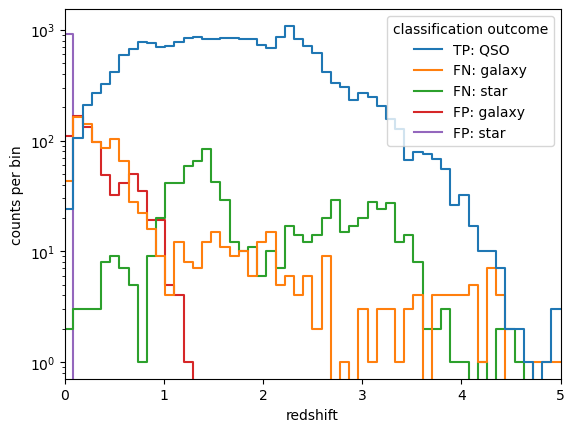

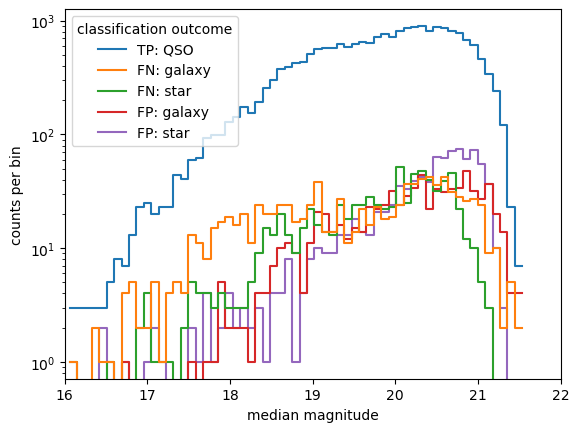

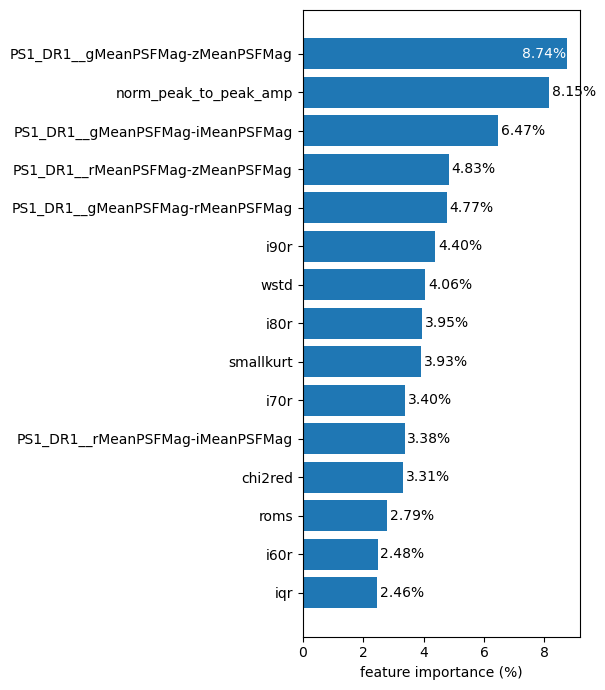

--------------------


In [13]:
# r band
data_label = 'ZTF x PS'
make_reports(results[data_label], classifiers[data_label], feature_sets)

features: ZTF
              precision    recall  f1-score   support

      GALAXY     0.9173    0.9423    0.9296     53955
         QSO     0.8748    0.8205    0.8467     20849
        STAR     0.8943    0.8892    0.8918     30905

    accuracy                         0.9027    105709
   macro avg     0.8955    0.8840    0.8894    105709
weighted avg     0.9022    0.9027    0.9022    105709



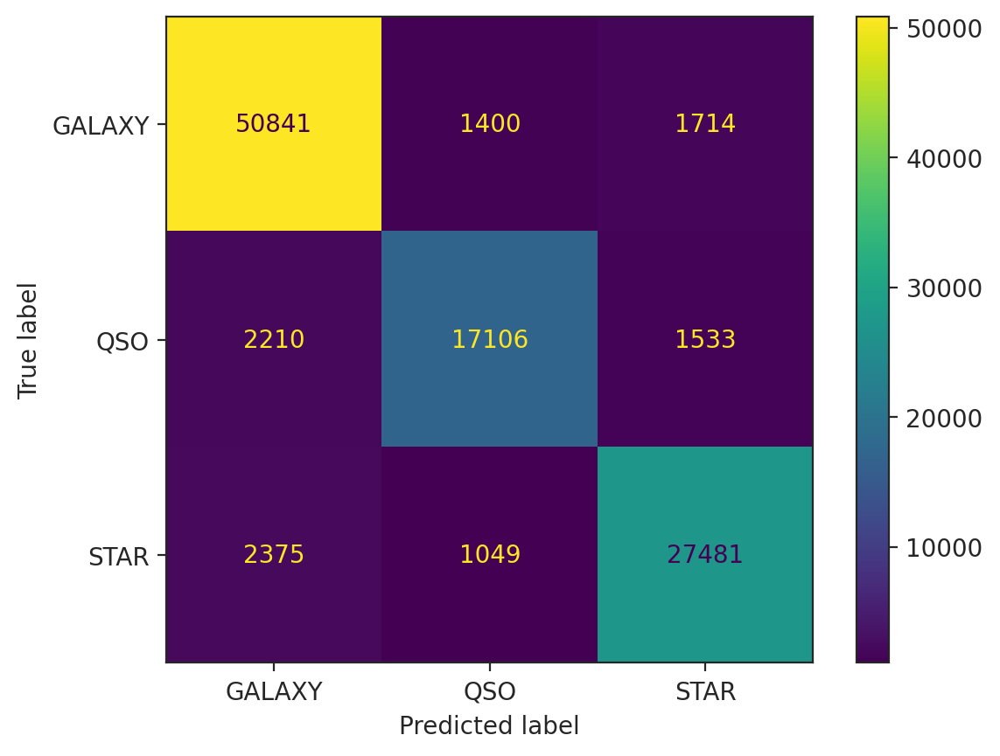

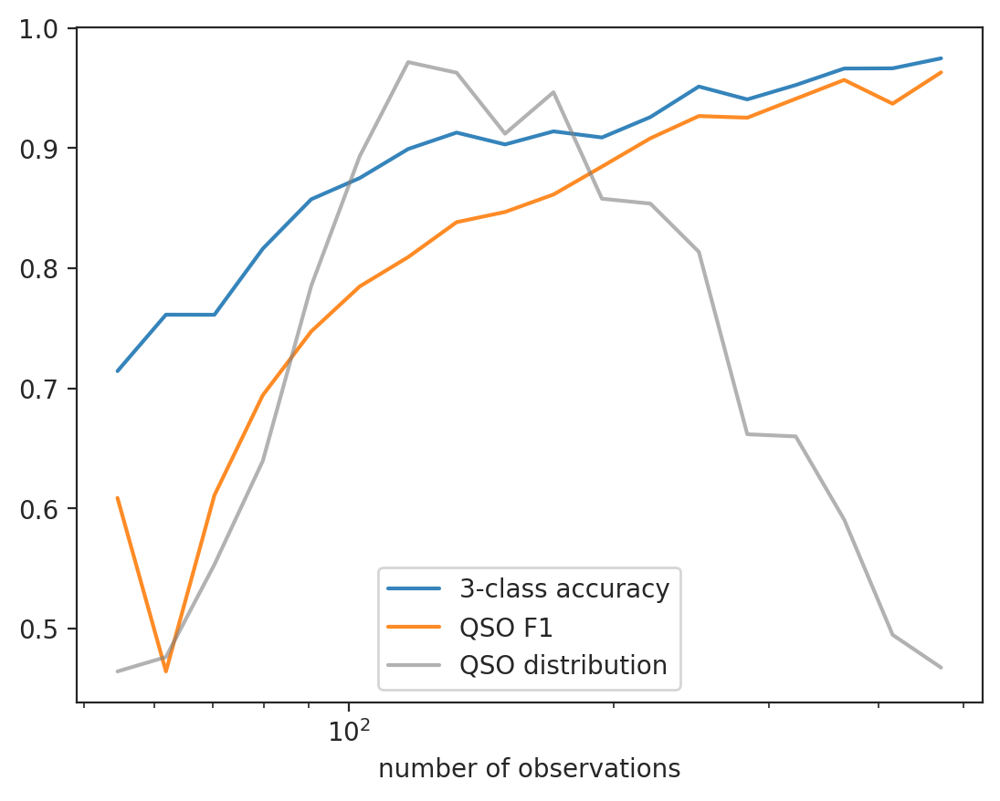

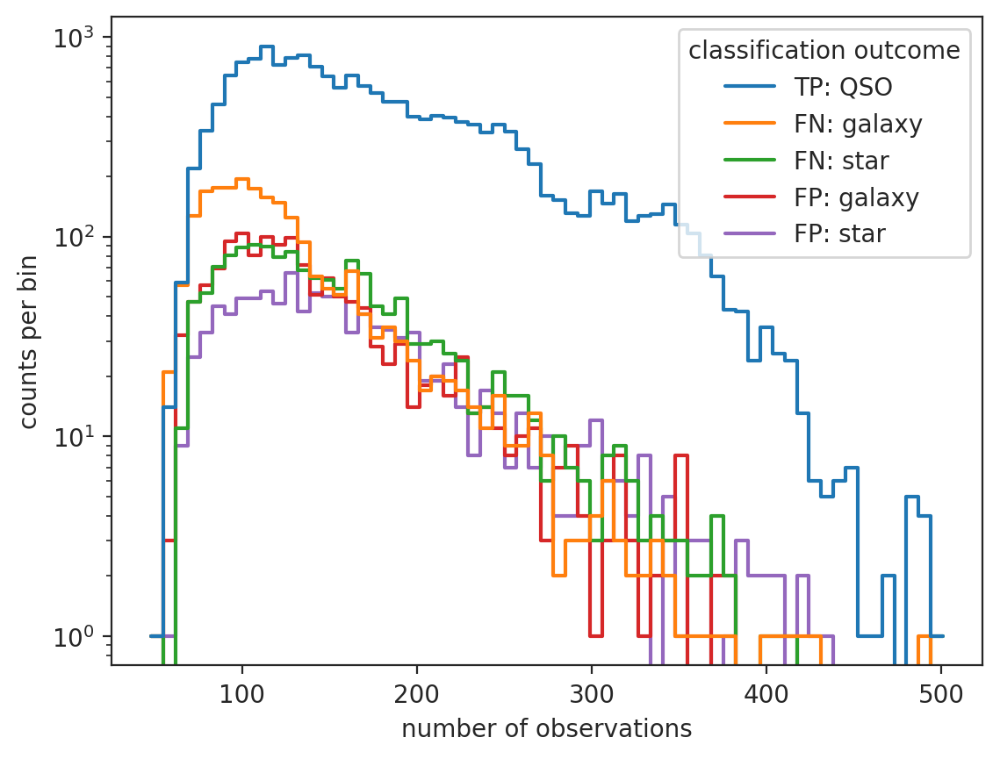

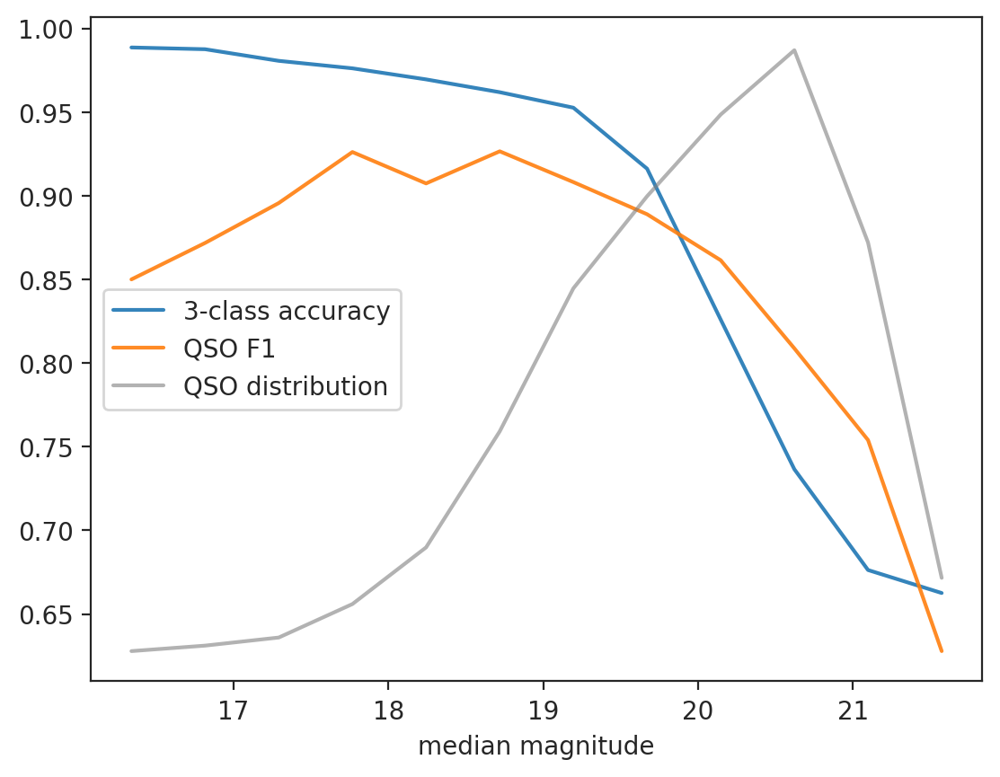

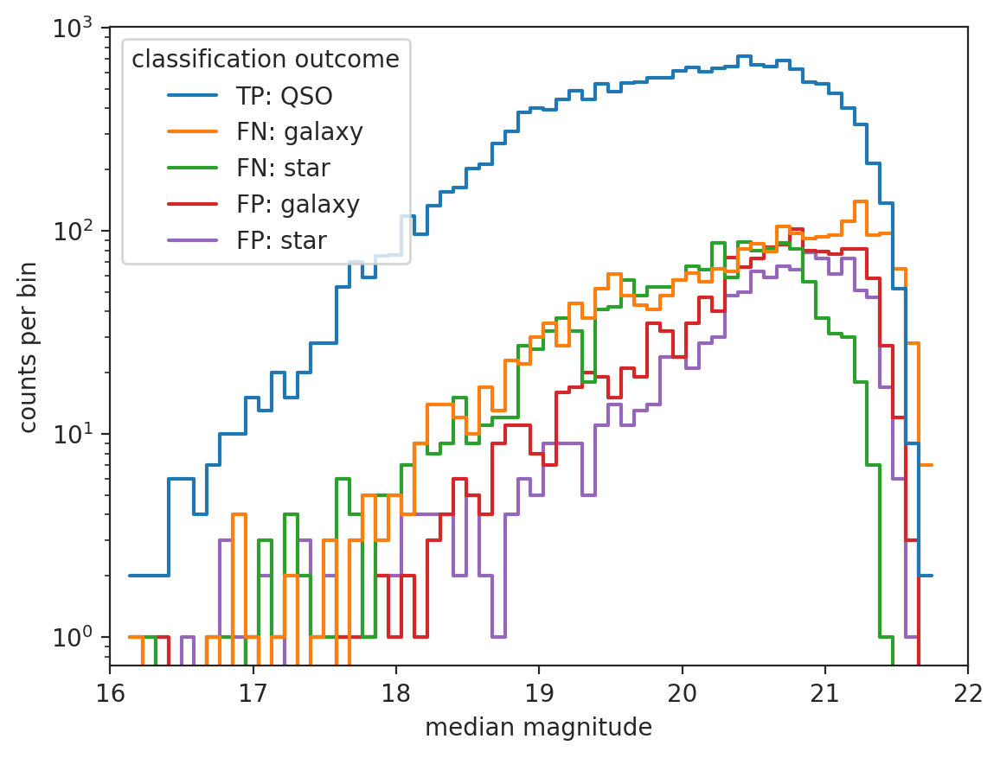

/home/sjnakoneczny/tools/anaconda3/envs/py39-lofar-dr2/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/sjnakoneczny/tools/anaconda3/envs/py39-lofar-dr2/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


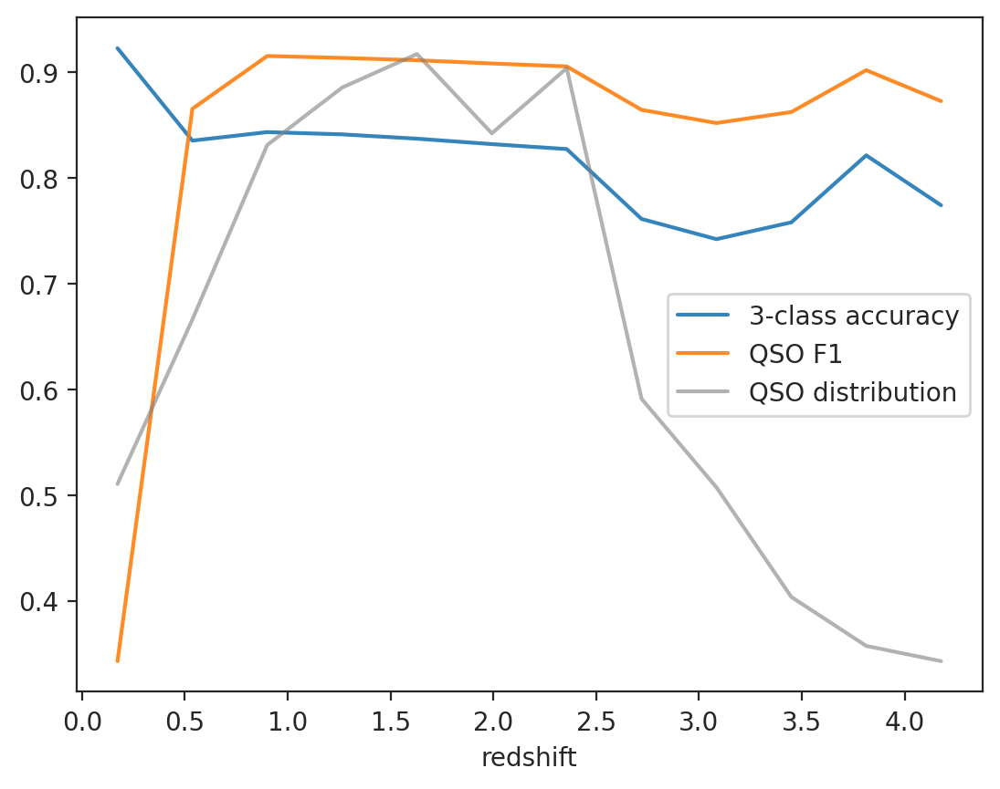

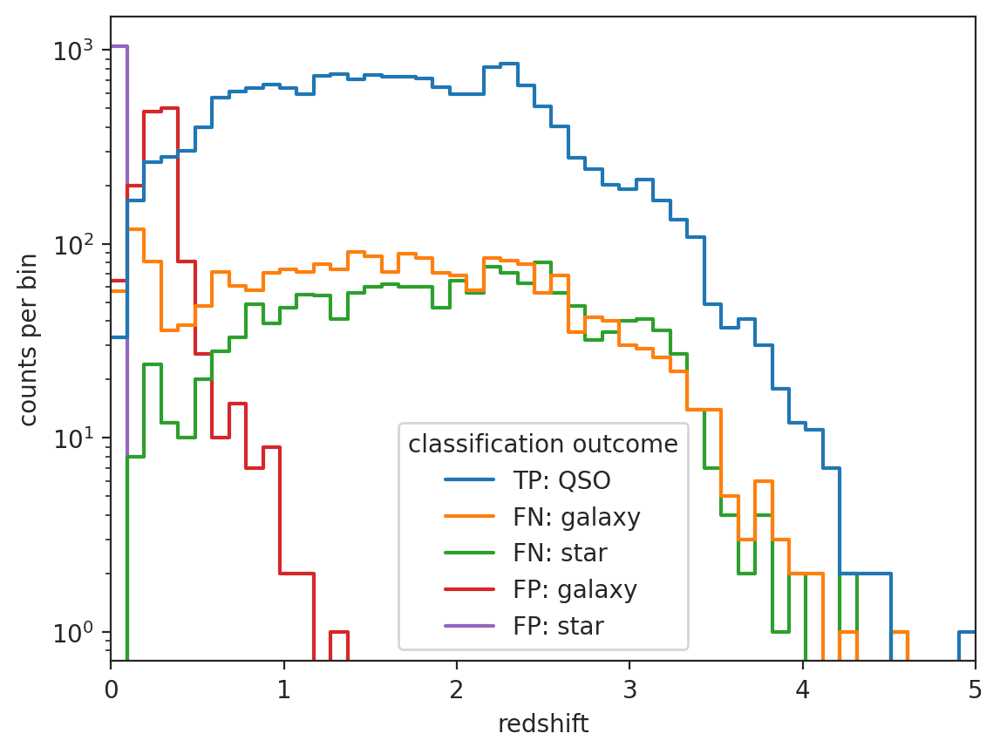

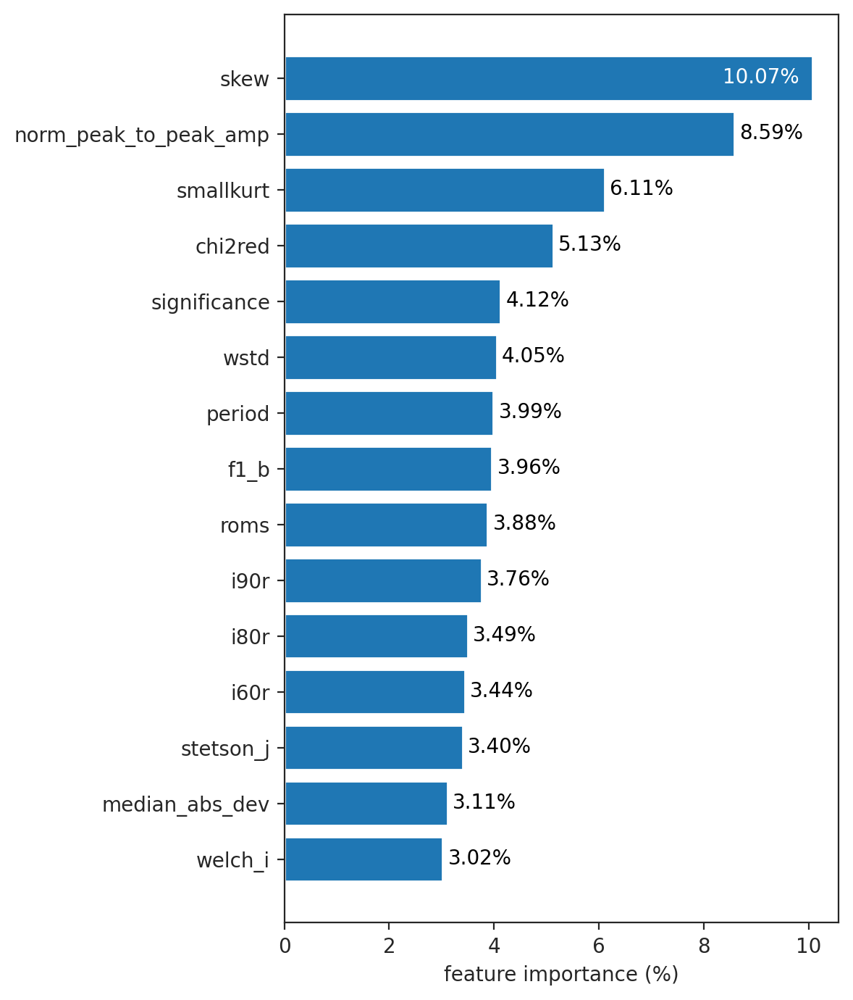

--------------------
features: astrm_clf
              precision    recall  f1-score   support

      GALAXY     0.9285    0.9466    0.9375     53955
         QSO     0.9118    0.8881    0.8998     20849
        STAR     0.9018    0.8869    0.8943     30905

    accuracy                         0.9176    105709
   macro avg     0.9140    0.9072    0.9105    105709
weighted avg     0.9174    0.9176    0.9174    105709



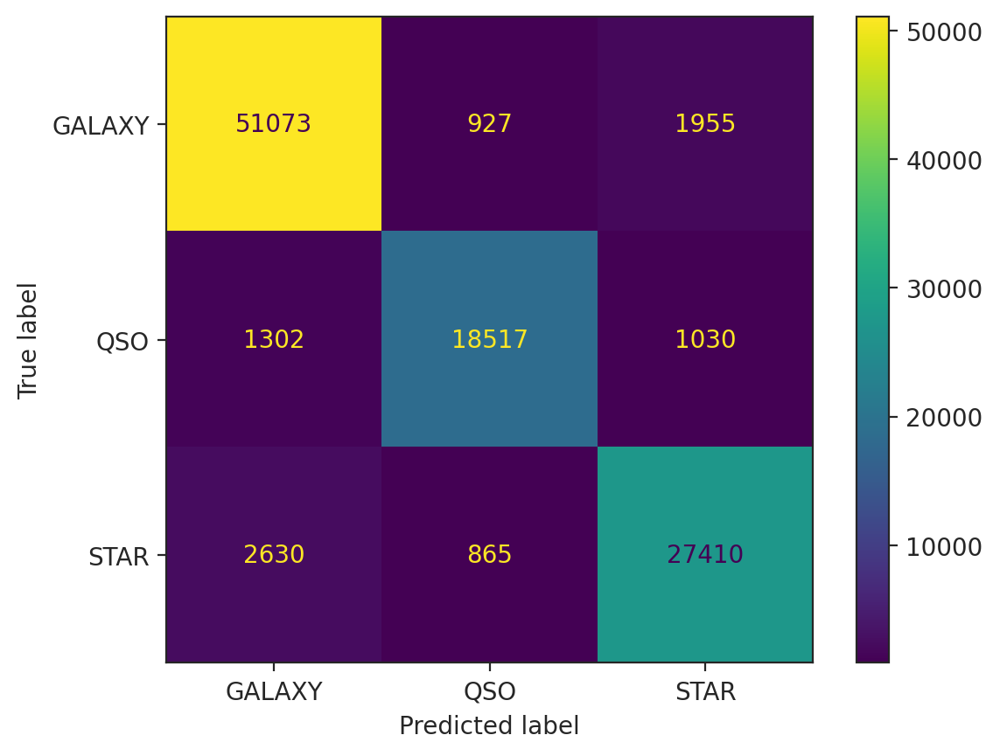

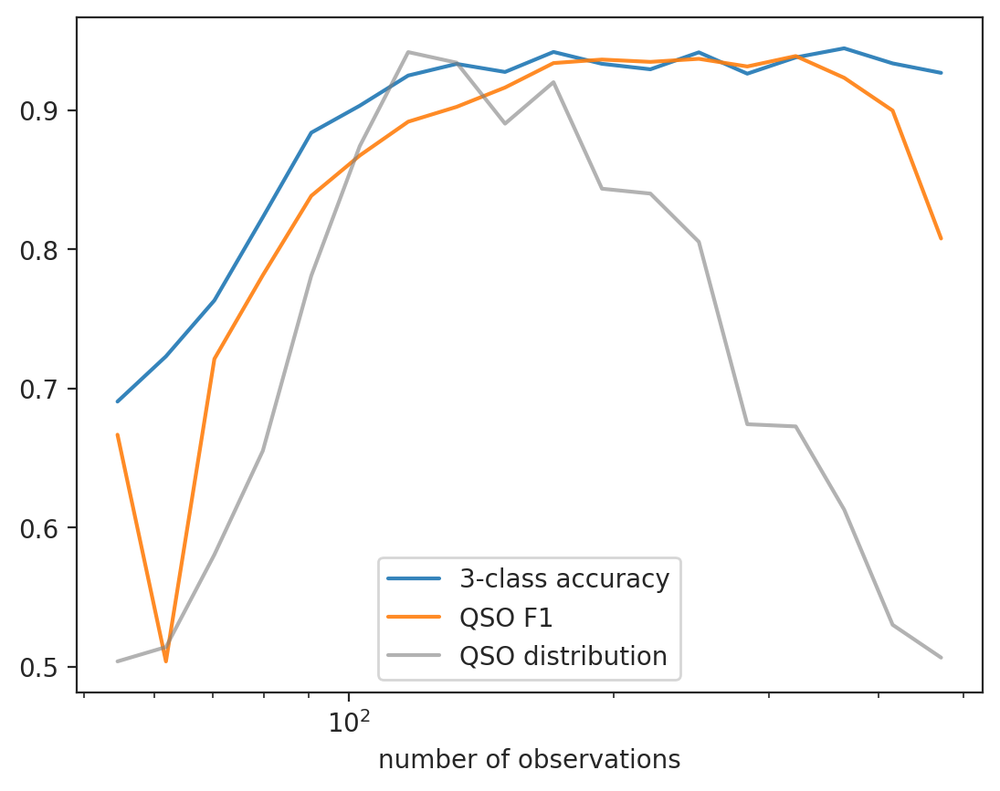

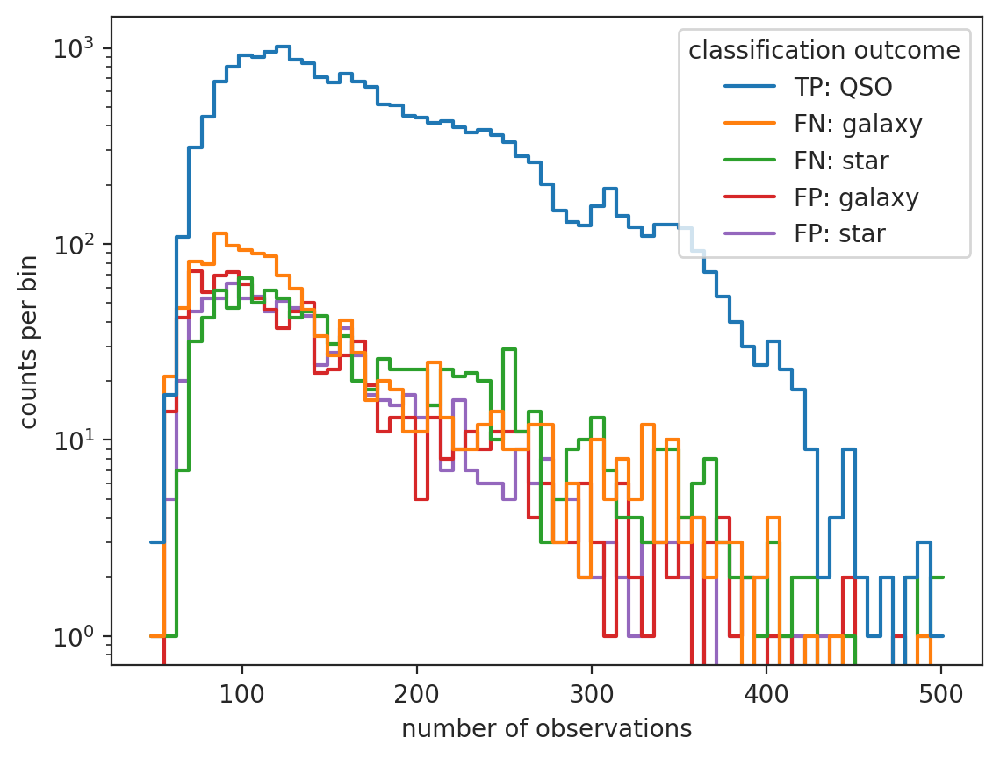

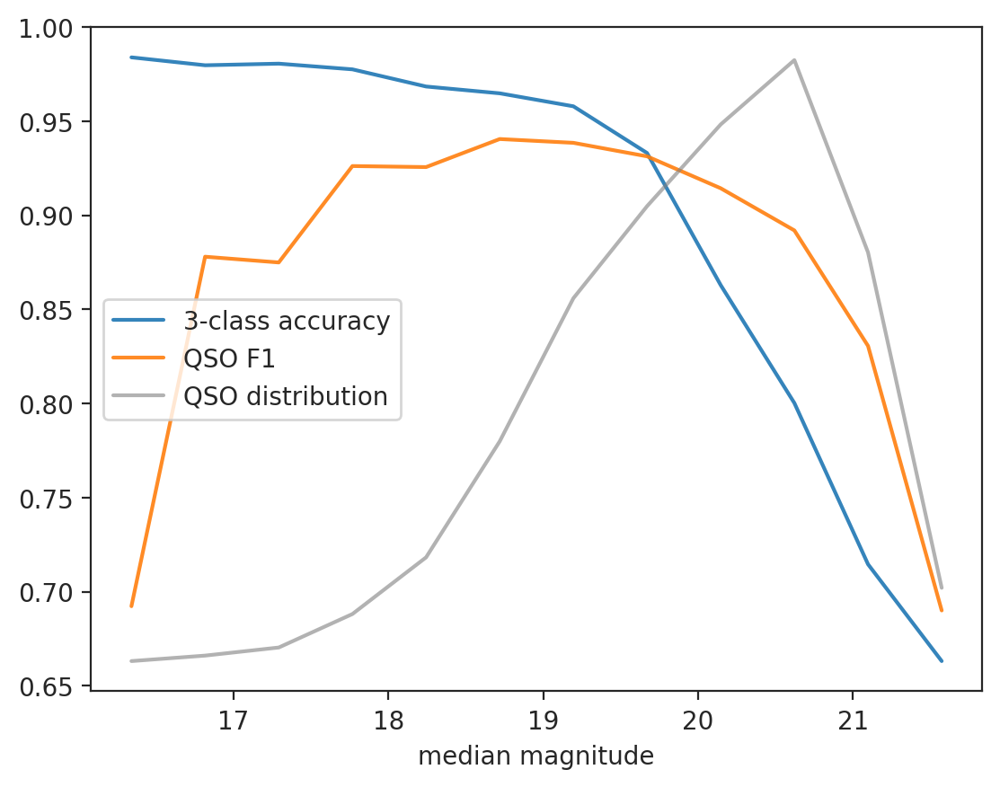

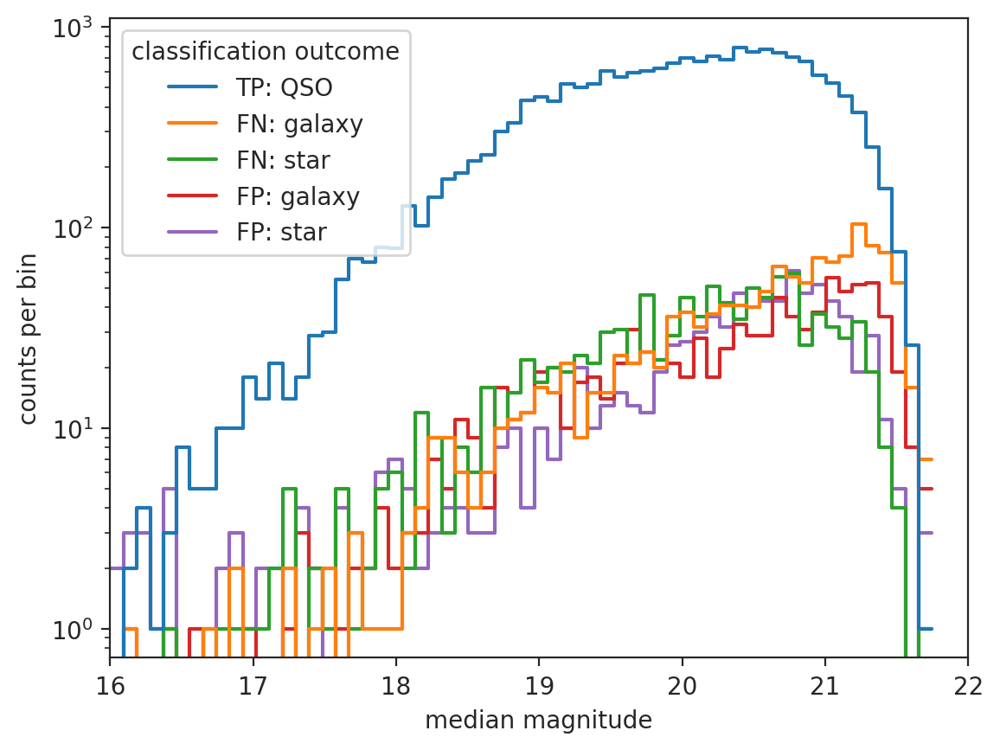

/home/sjnakoneczny/tools/anaconda3/envs/py39-lofar-dr2/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/sjnakoneczny/tools/anaconda3/envs/py39-lofar-dr2/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


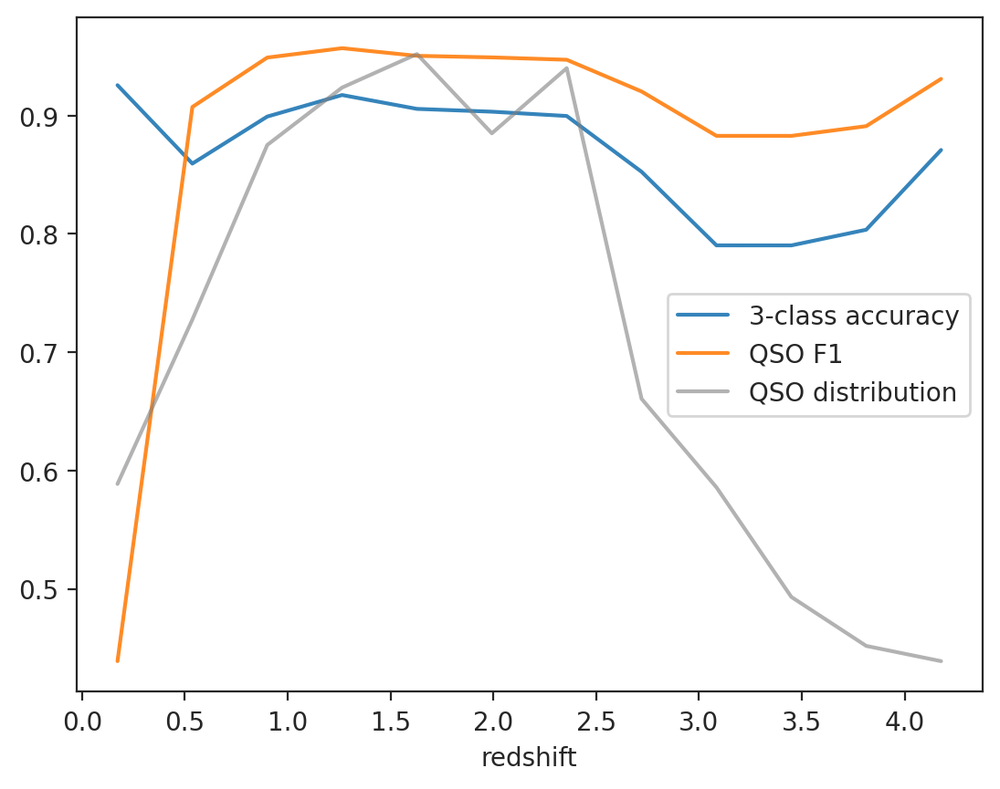

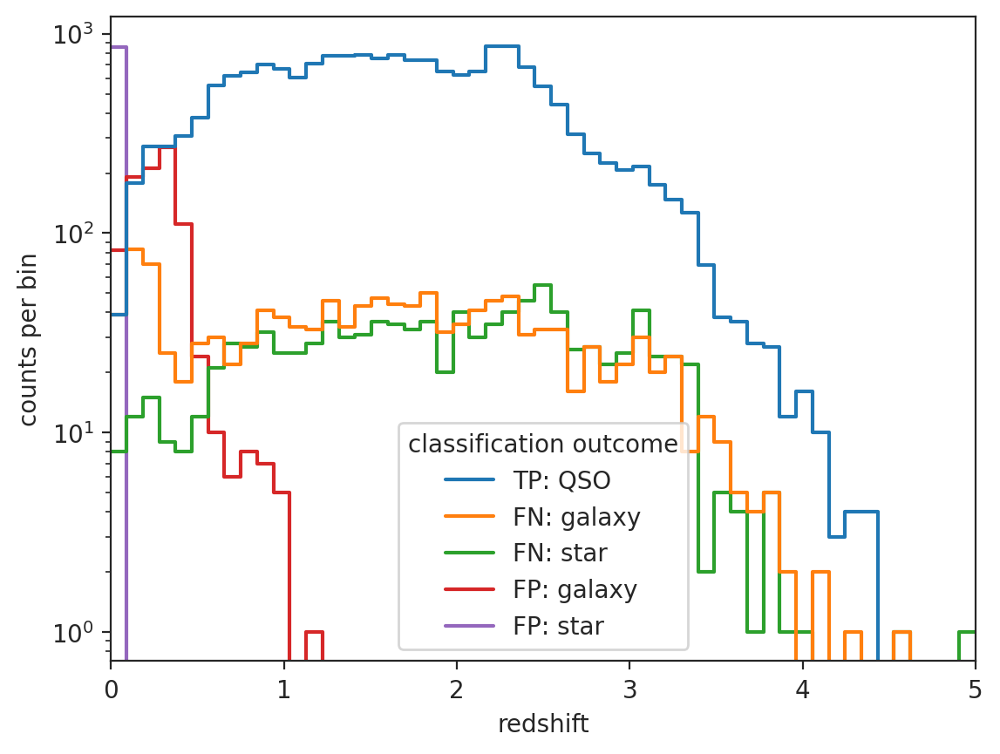

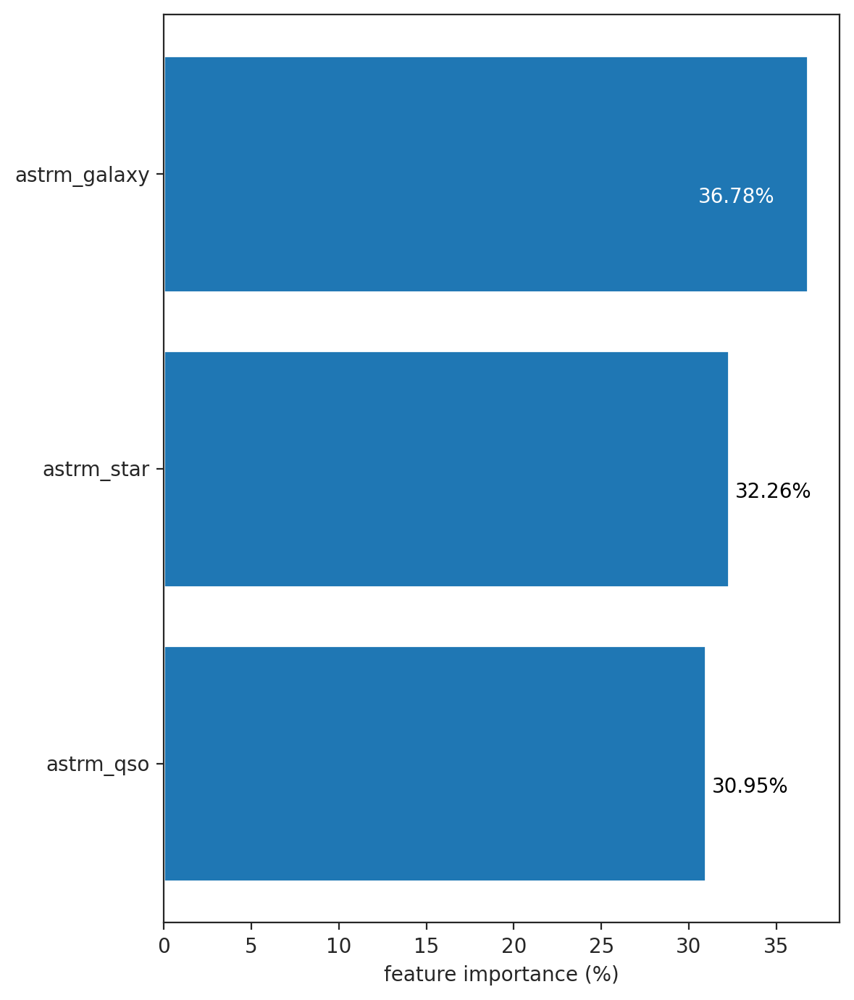

--------------------
features: PS
              precision    recall  f1-score   support

      GALAXY     0.9318    0.9358    0.9338     53955
         QSO     0.8240    0.8305    0.8273     20849
        STAR     0.9269    0.9149    0.9208     30905

    accuracy                         0.9089    105709
   macro avg     0.8942    0.8937    0.8940    105709
weighted avg     0.9091    0.9089    0.9090    105709



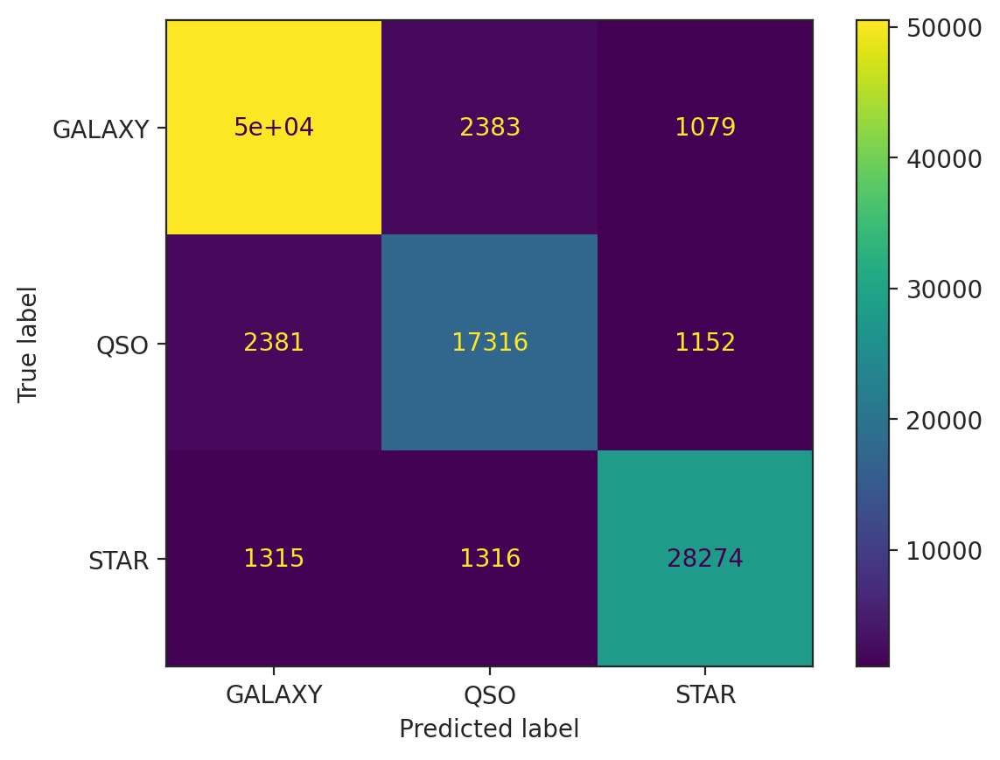

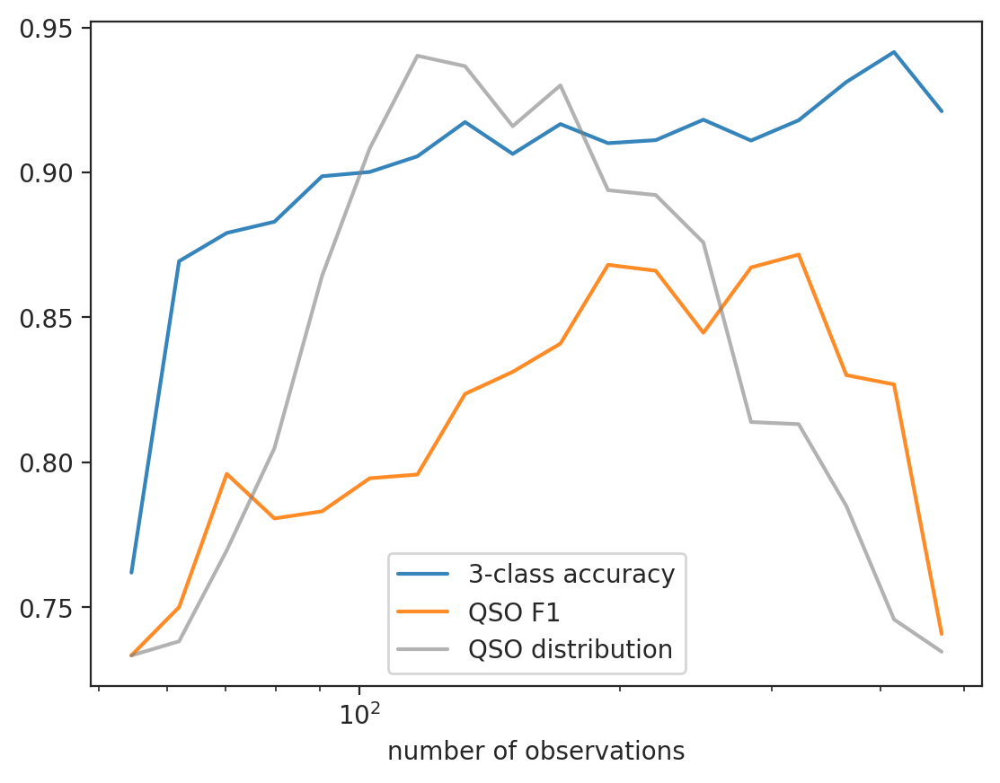

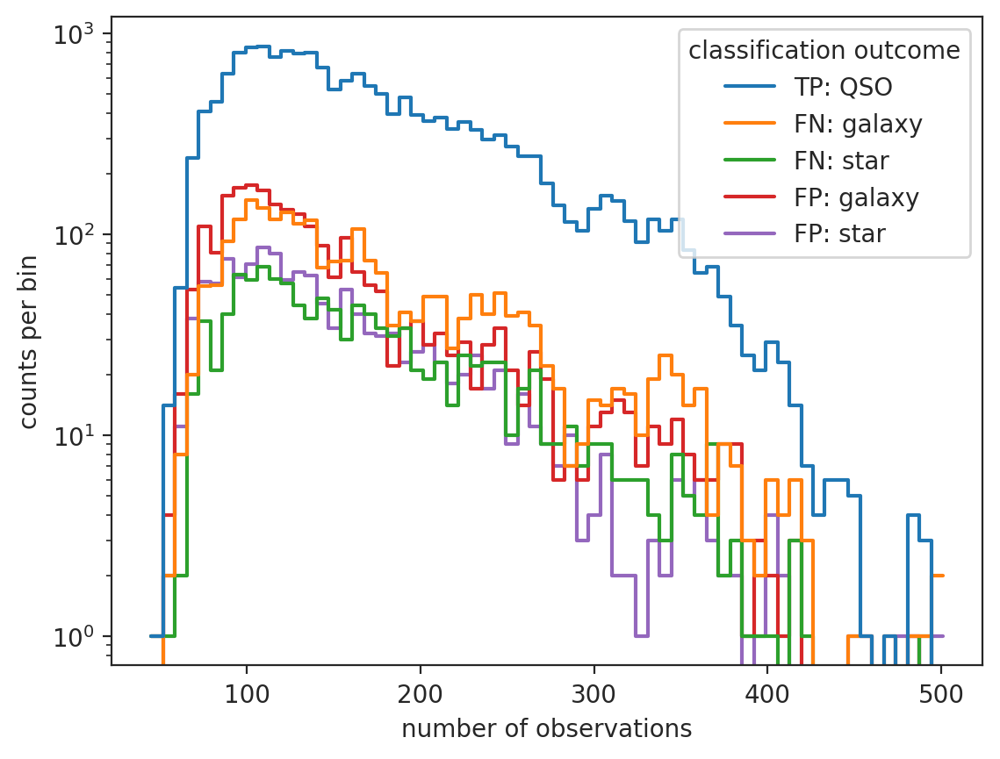

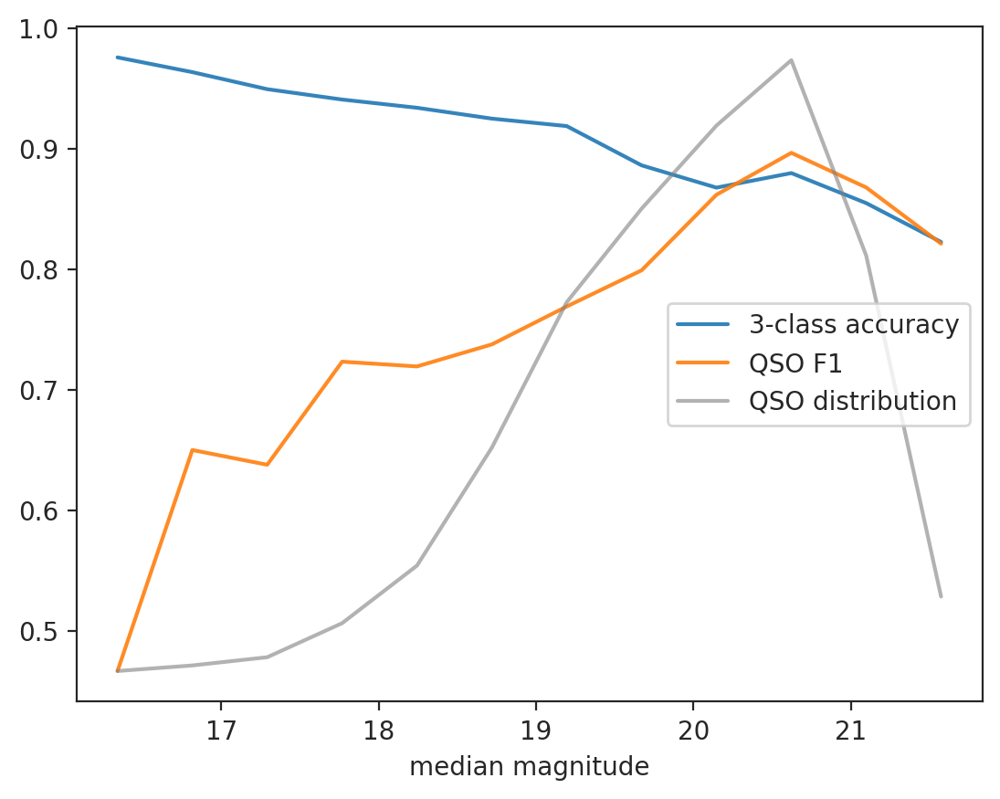

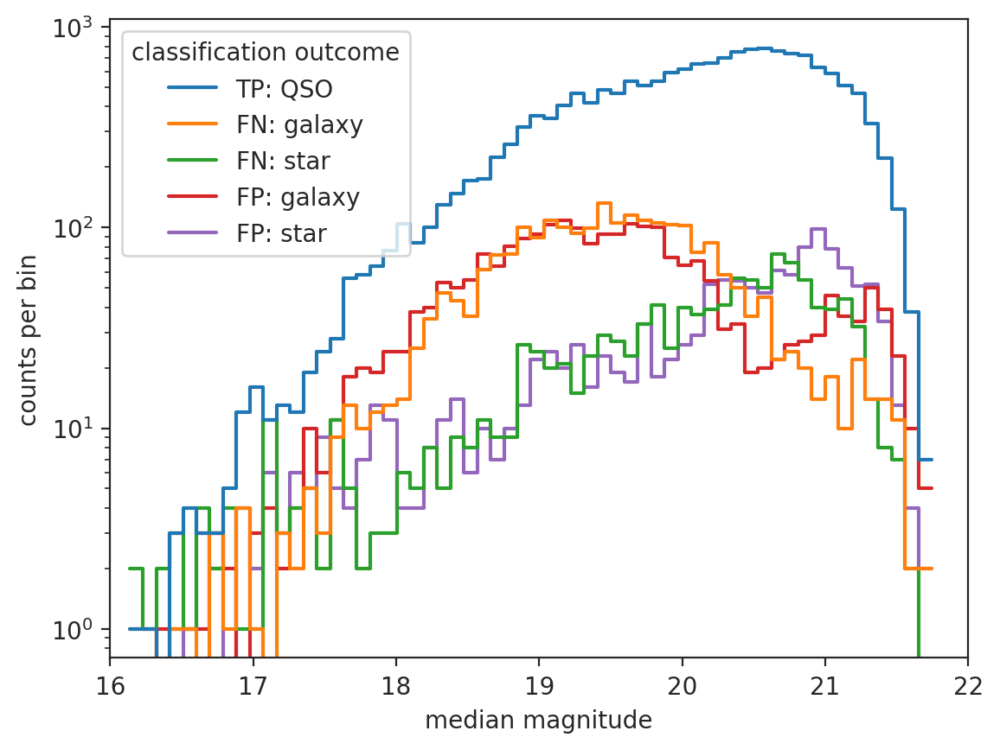

/home/sjnakoneczny/tools/anaconda3/envs/py39-lofar-dr2/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/sjnakoneczny/tools/anaconda3/envs/py39-lofar-dr2/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


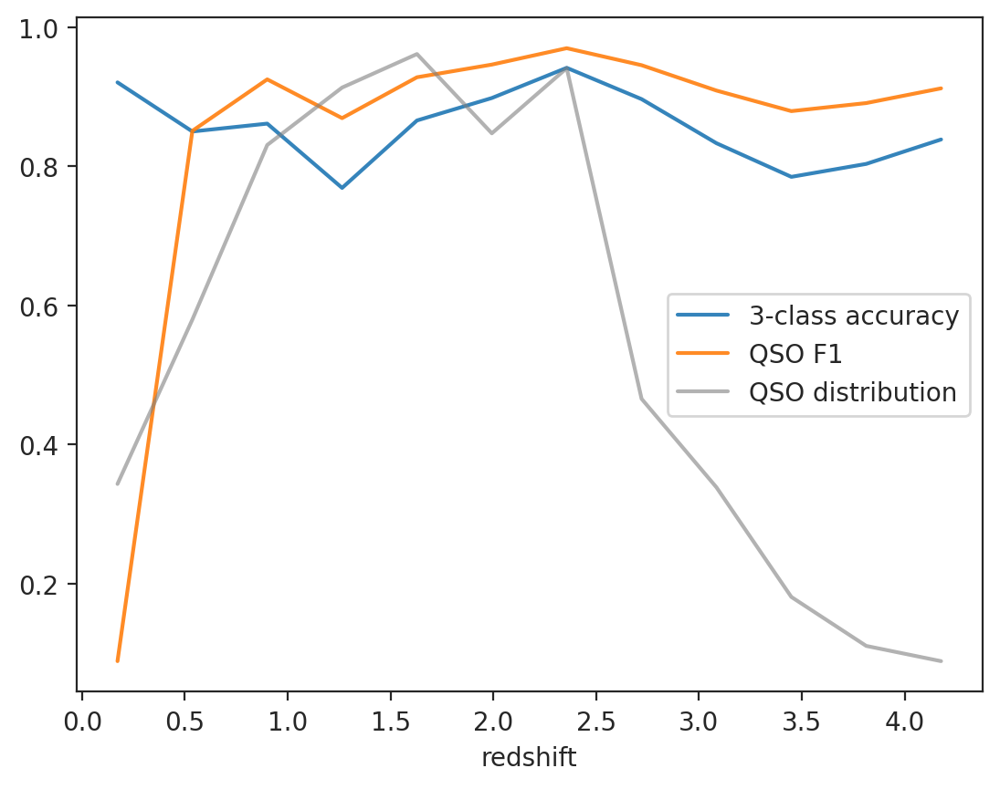

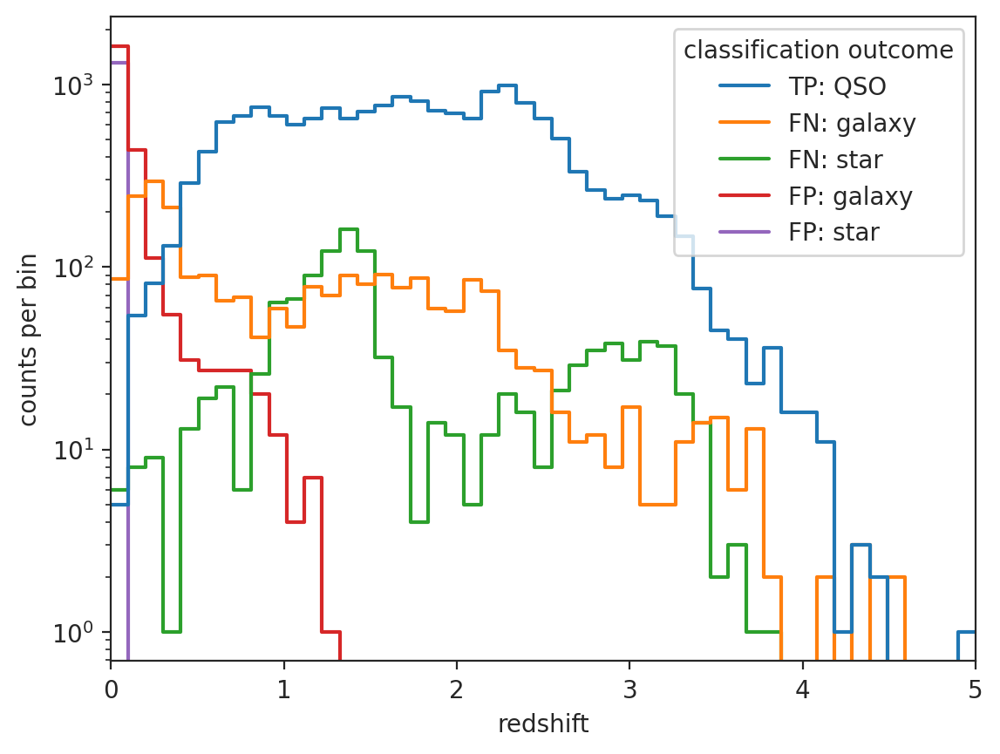

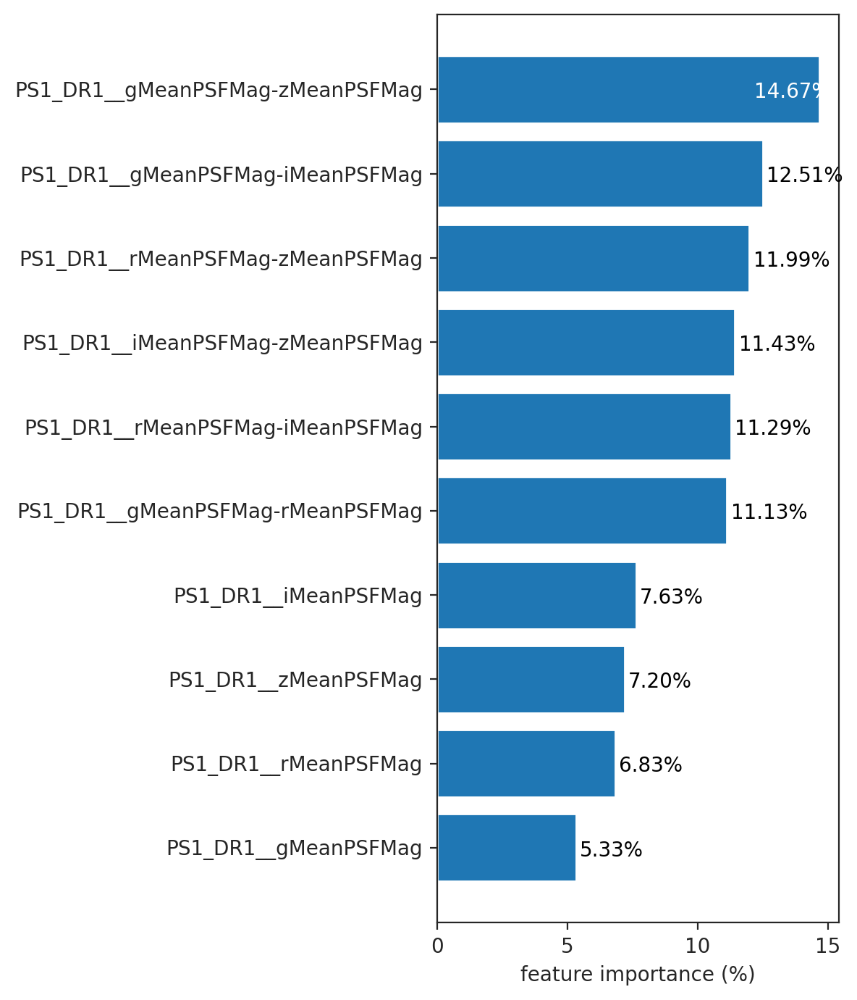

--------------------
features: astrm_clf + PS
              precision    recall  f1-score   support

      GALAXY     0.9732    0.9812    0.9772     53955
         QSO     0.9541    0.9425    0.9483     20849
        STAR     0.9639    0.9581    0.9610     30905

    accuracy                         0.9668    105709
   macro avg     0.9637    0.9606    0.9621    105709
weighted avg     0.9667    0.9668    0.9667    105709



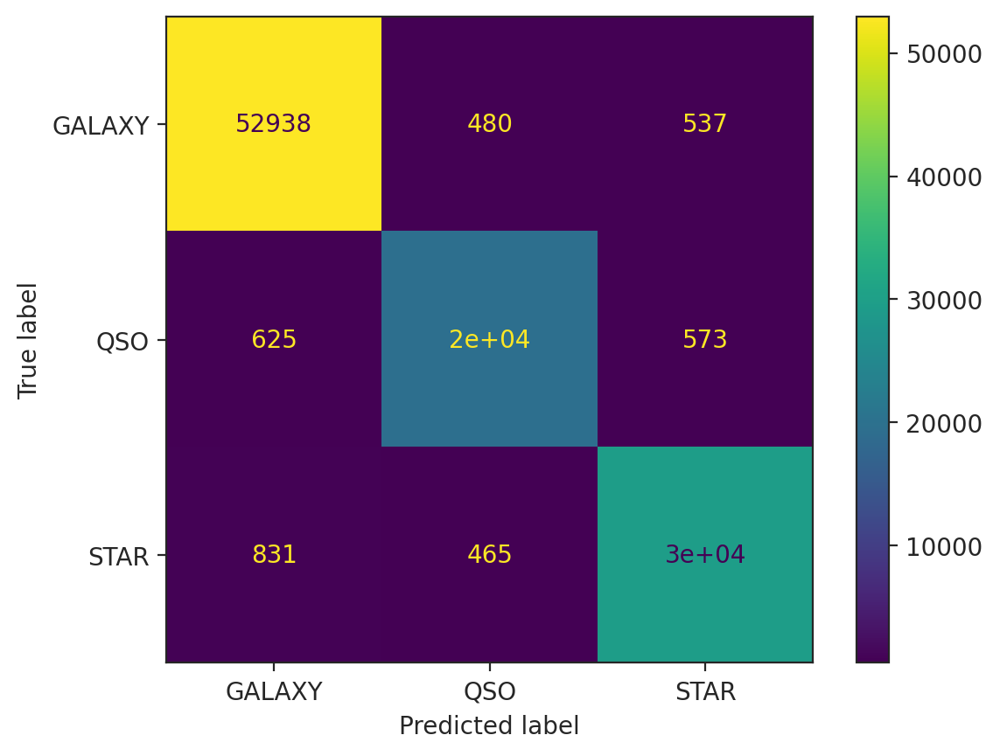

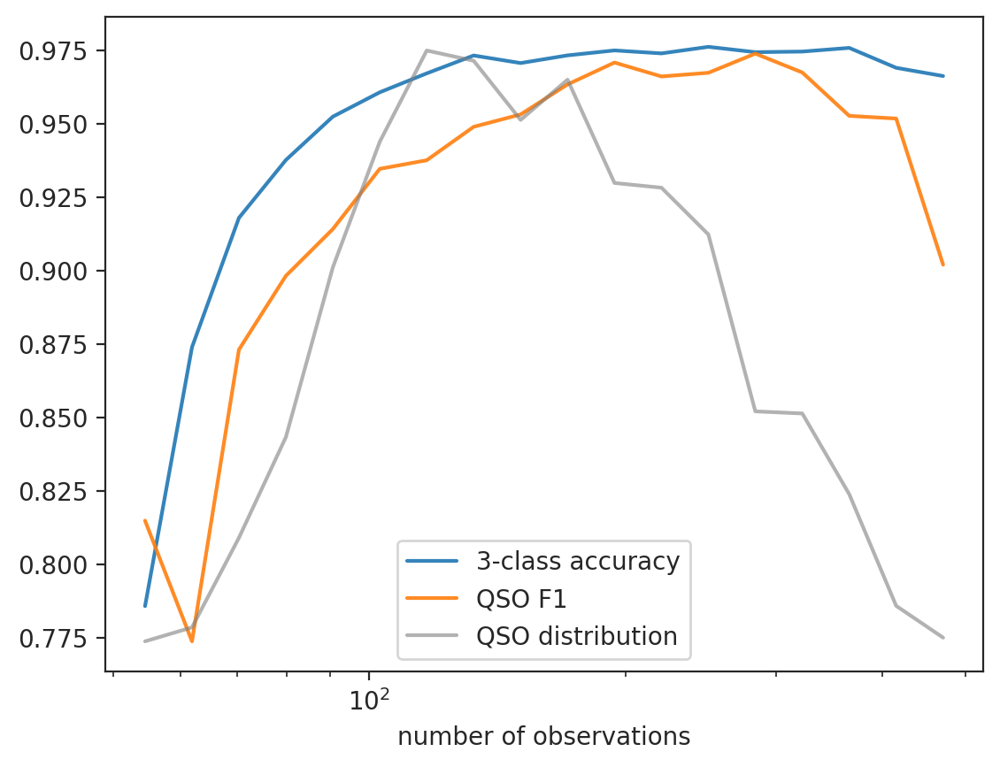

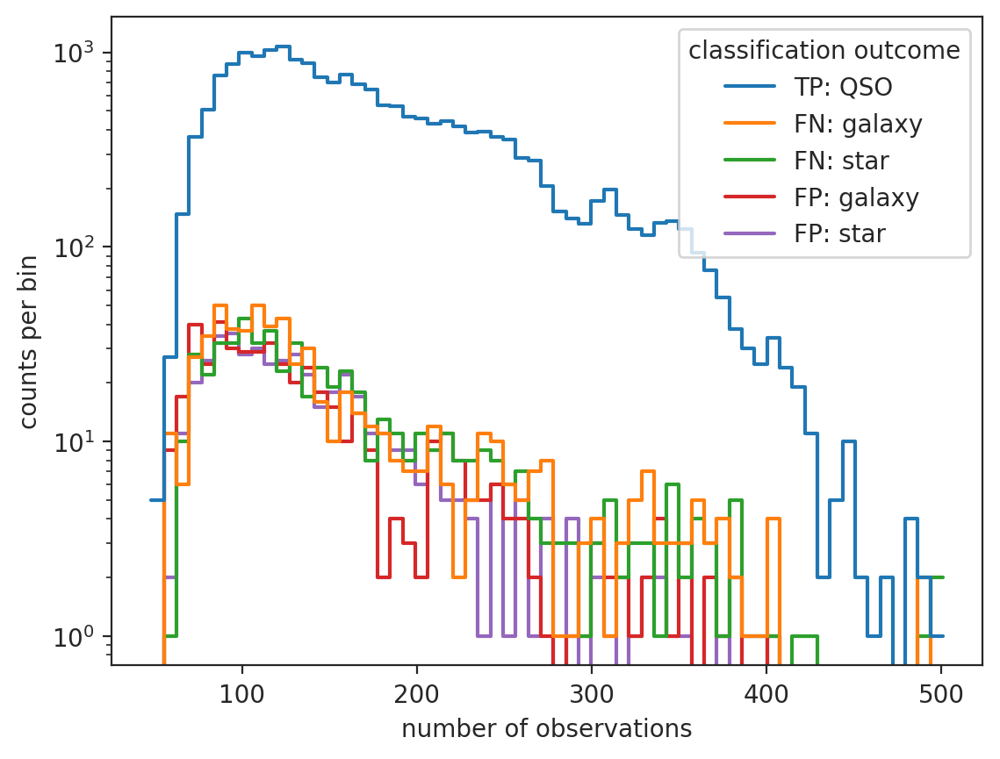

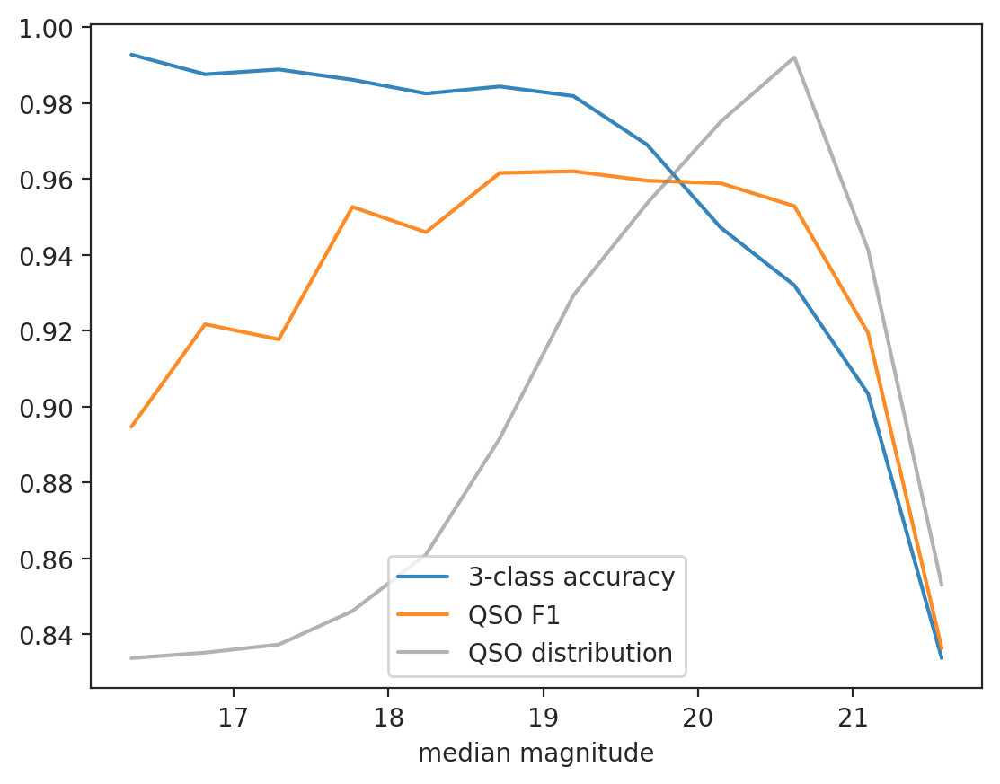

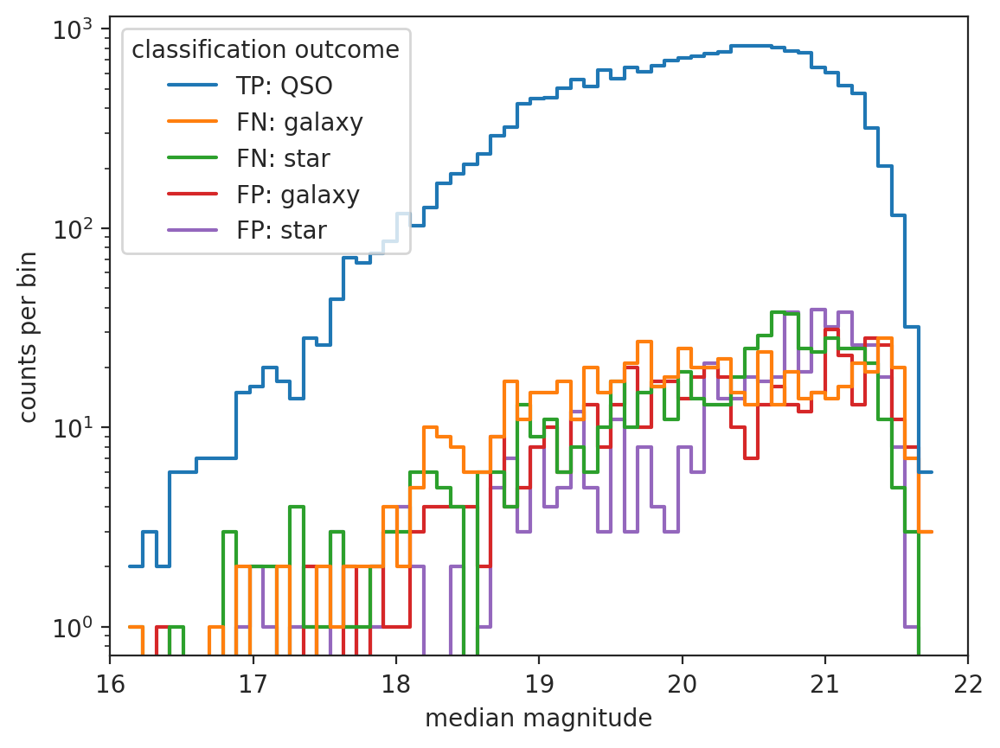

/home/sjnakoneczny/tools/anaconda3/envs/py39-lofar-dr2/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/sjnakoneczny/tools/anaconda3/envs/py39-lofar-dr2/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


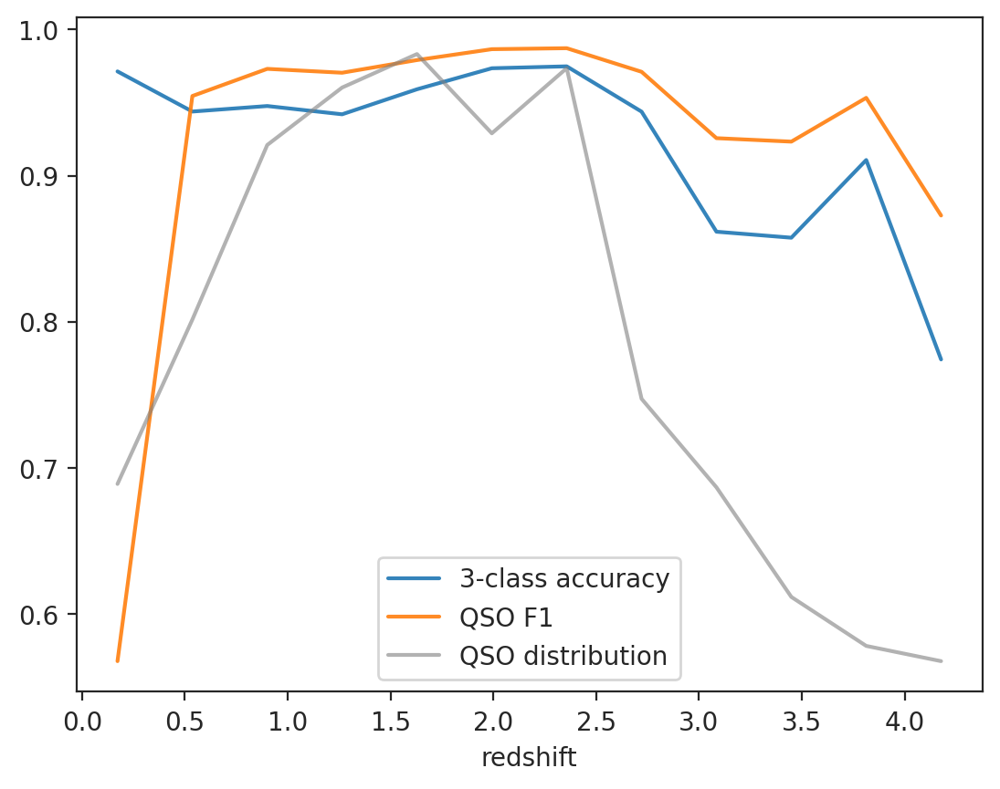

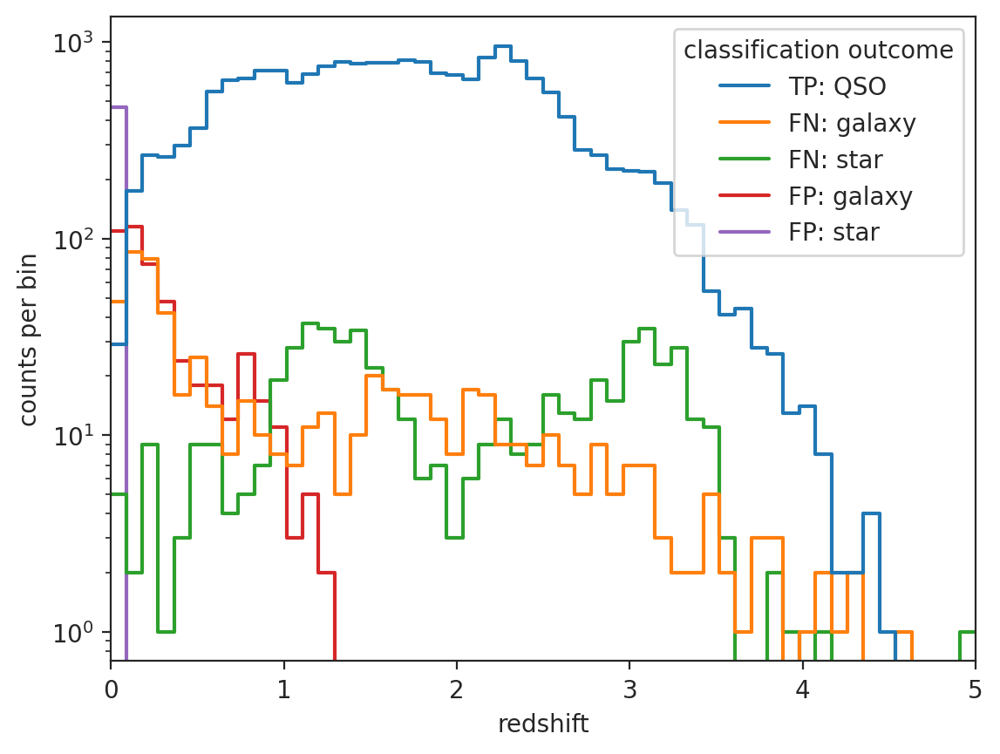

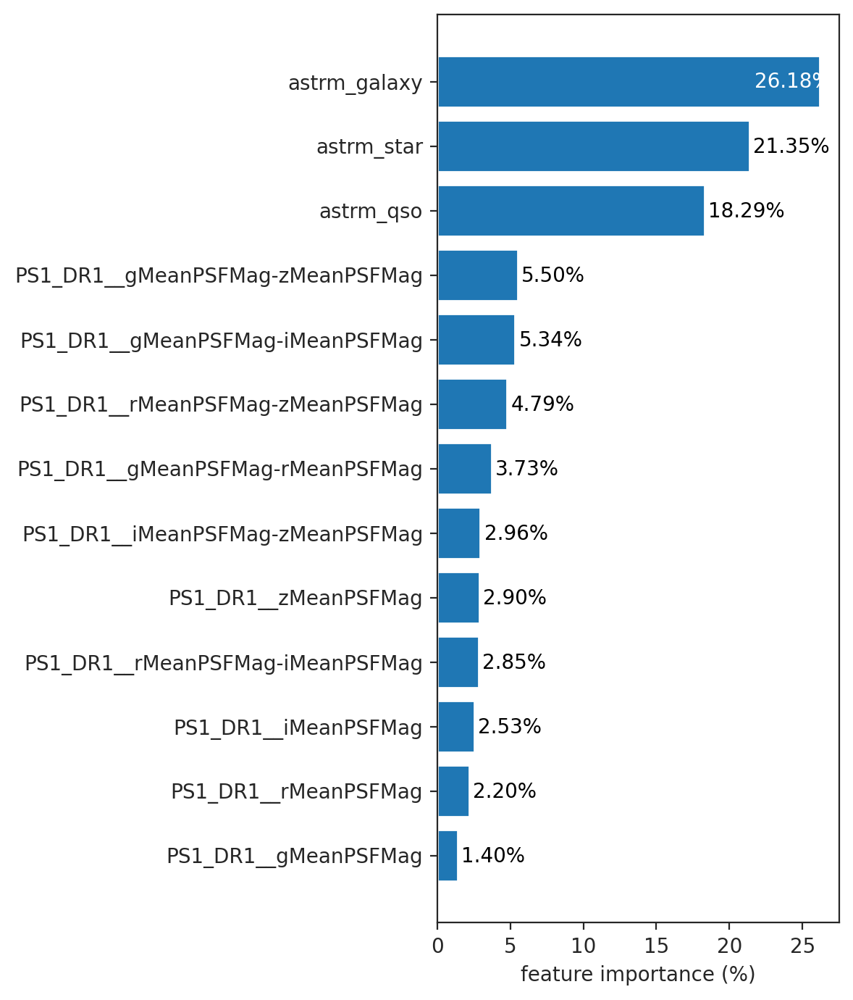

--------------------
features: ZTF + astrm_clf
              precision    recall  f1-score   support

      GALAXY     0.9442    0.9655    0.9547     53955
         QSO     0.9368    0.8980    0.9170     20849
        STAR     0.9266    0.9159    0.9212     30905

    accuracy                         0.9377    105709
   macro avg     0.9359    0.9265    0.9310    105709
weighted avg     0.9376    0.9377    0.9375    105709



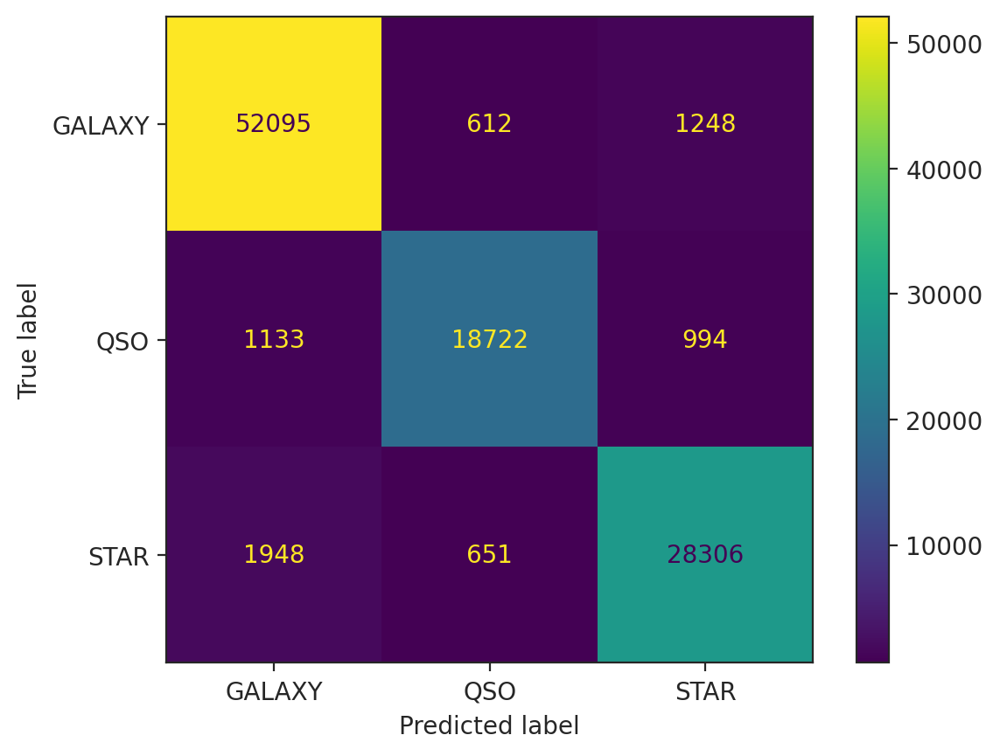

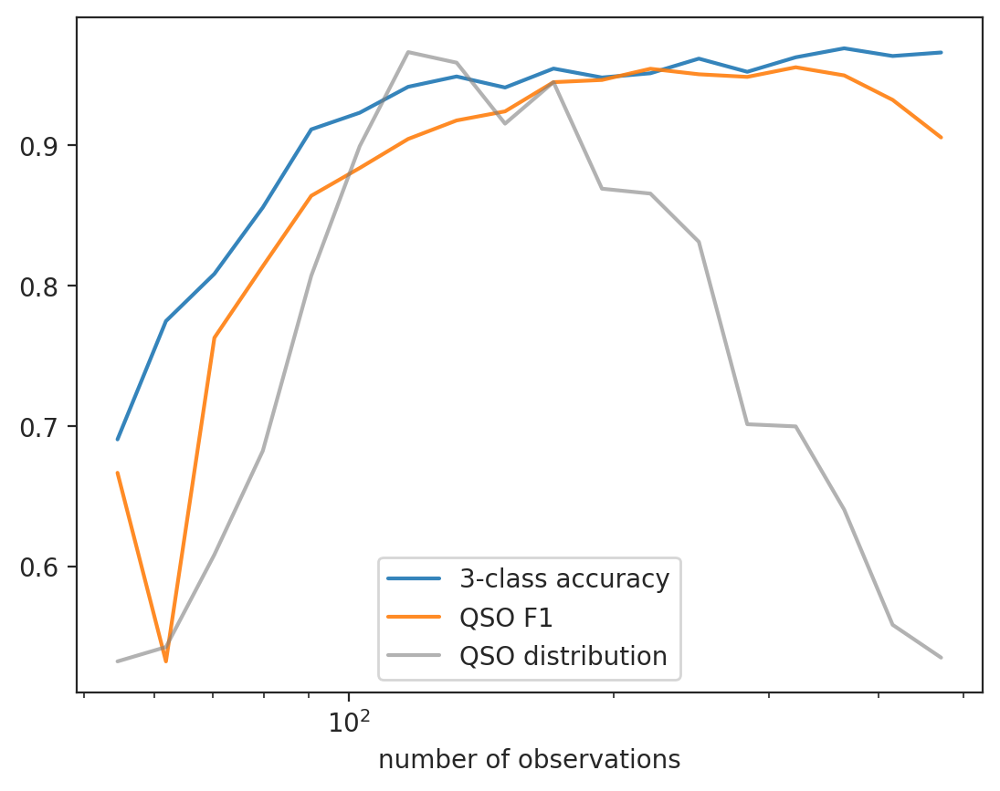

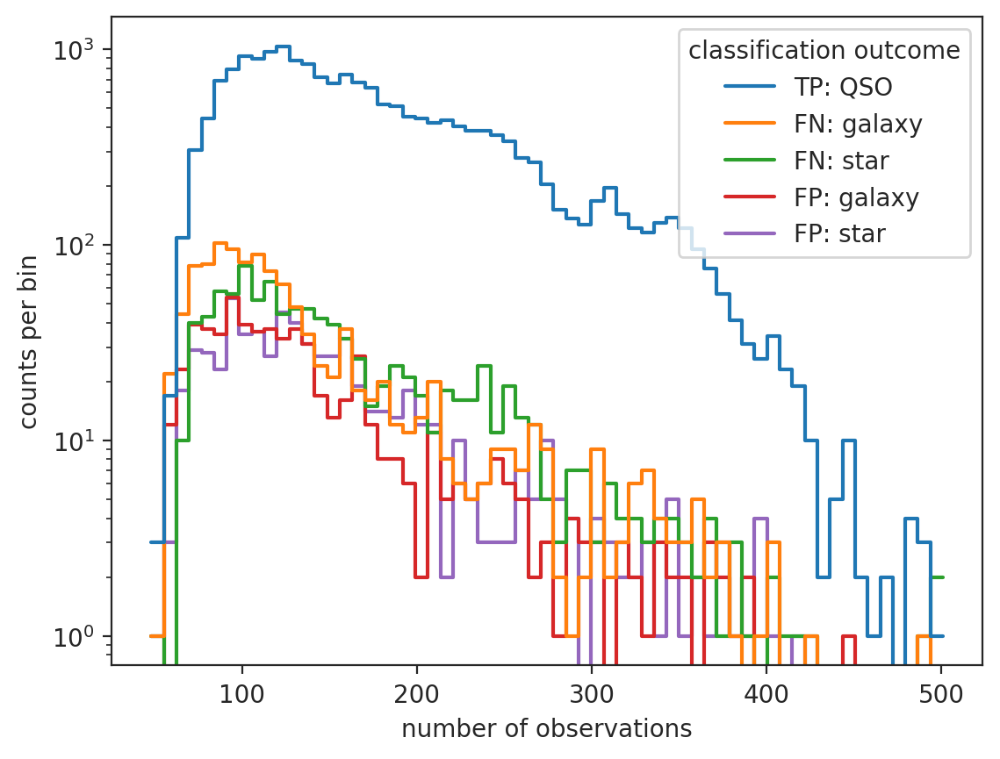

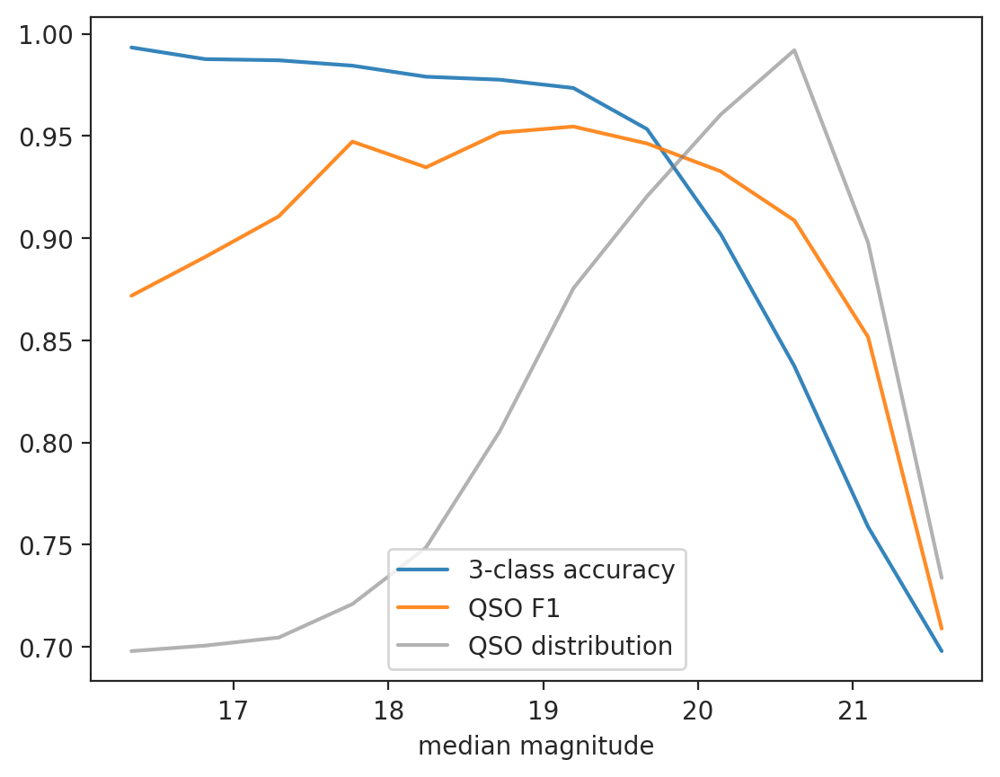

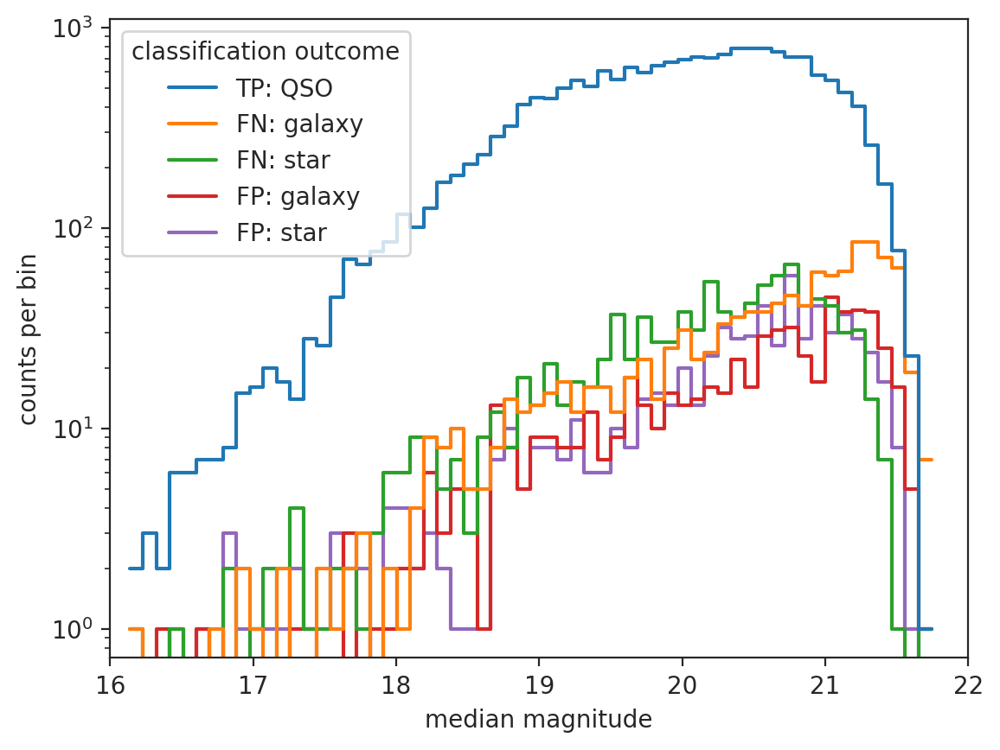

/home/sjnakoneczny/tools/anaconda3/envs/py39-lofar-dr2/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/sjnakoneczny/tools/anaconda3/envs/py39-lofar-dr2/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


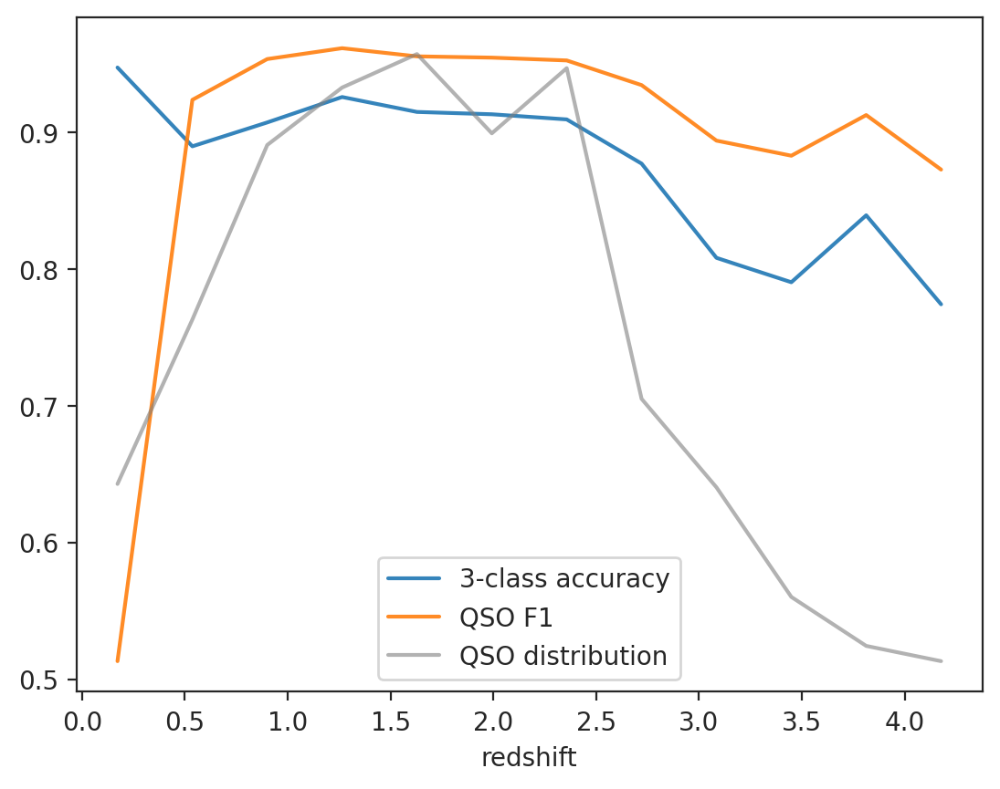

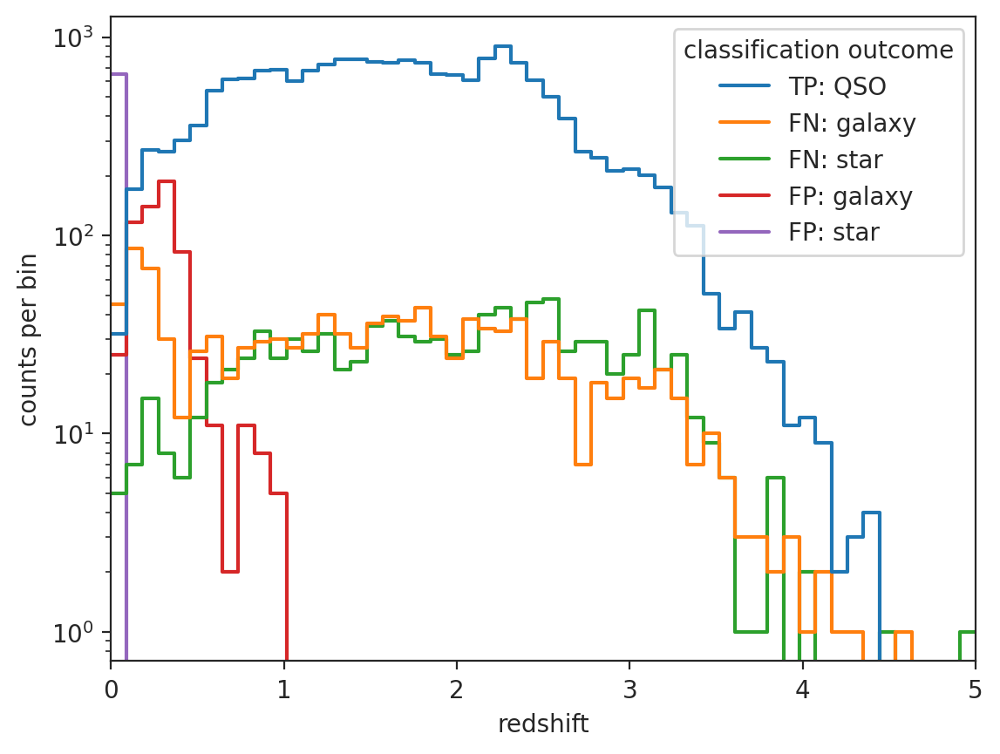

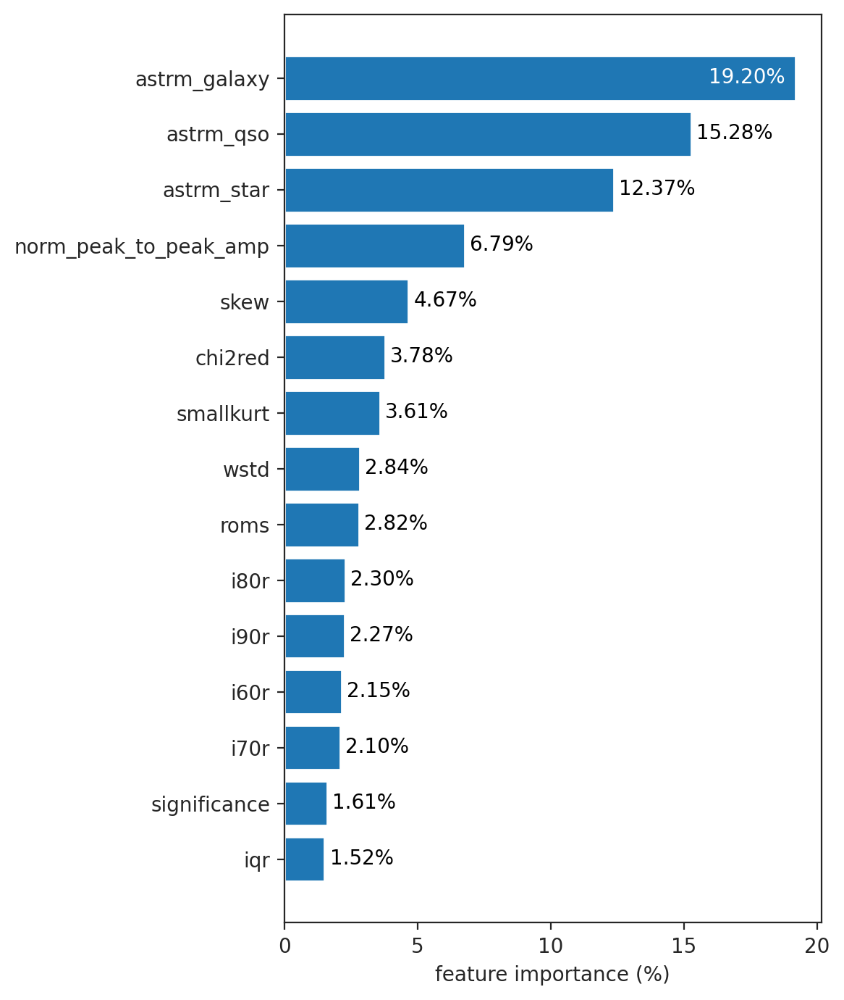

--------------------
features: ZTF + astrm_clf + PS
              precision    recall  f1-score   support

      GALAXY     0.9770    0.9827    0.9799     53955
         QSO     0.9558    0.9465    0.9511     20849
        STAR     0.9630    0.9596    0.9613     30905

    accuracy                         0.9688    105709
   macro avg     0.9653    0.9629    0.9641    105709
weighted avg     0.9687    0.9688    0.9688    105709



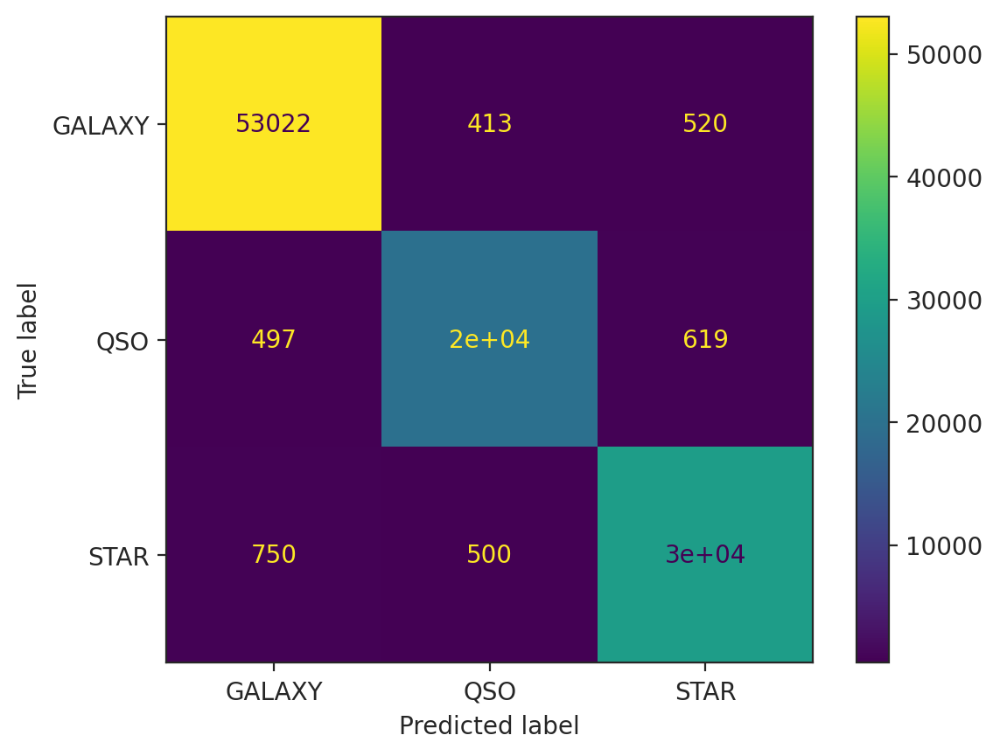

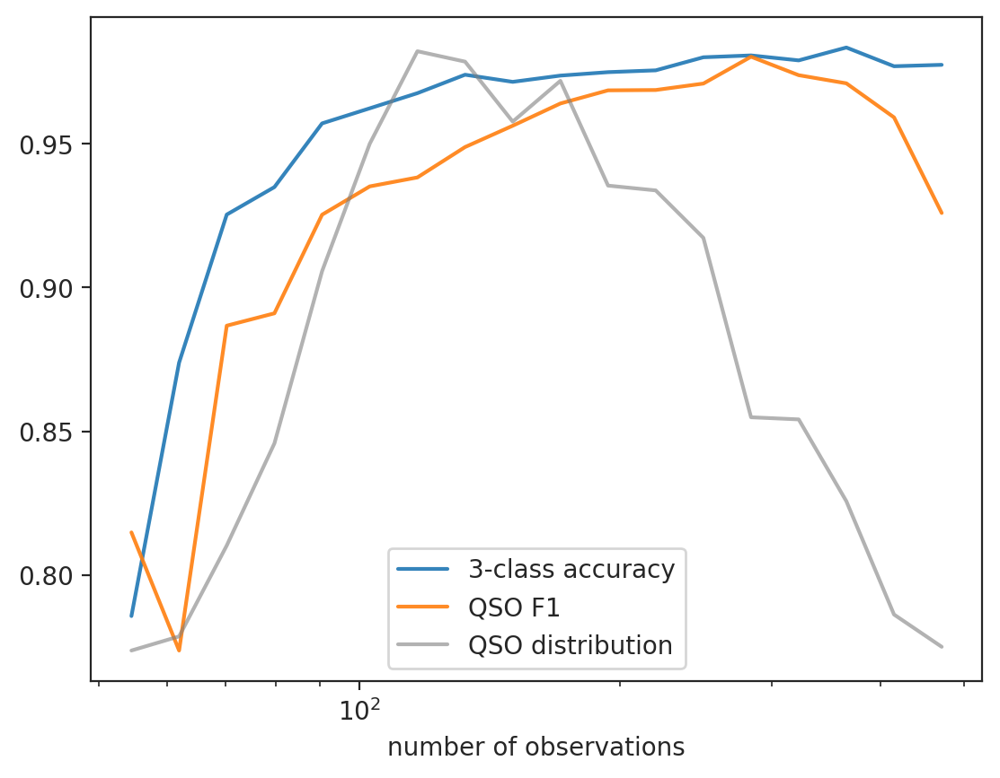

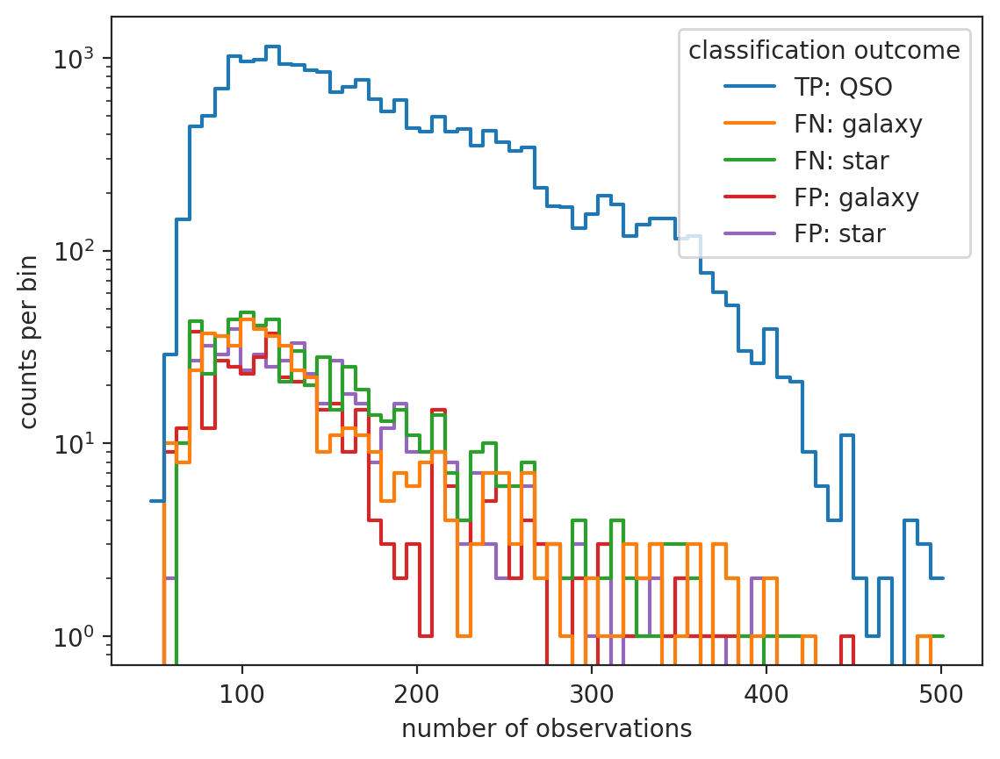

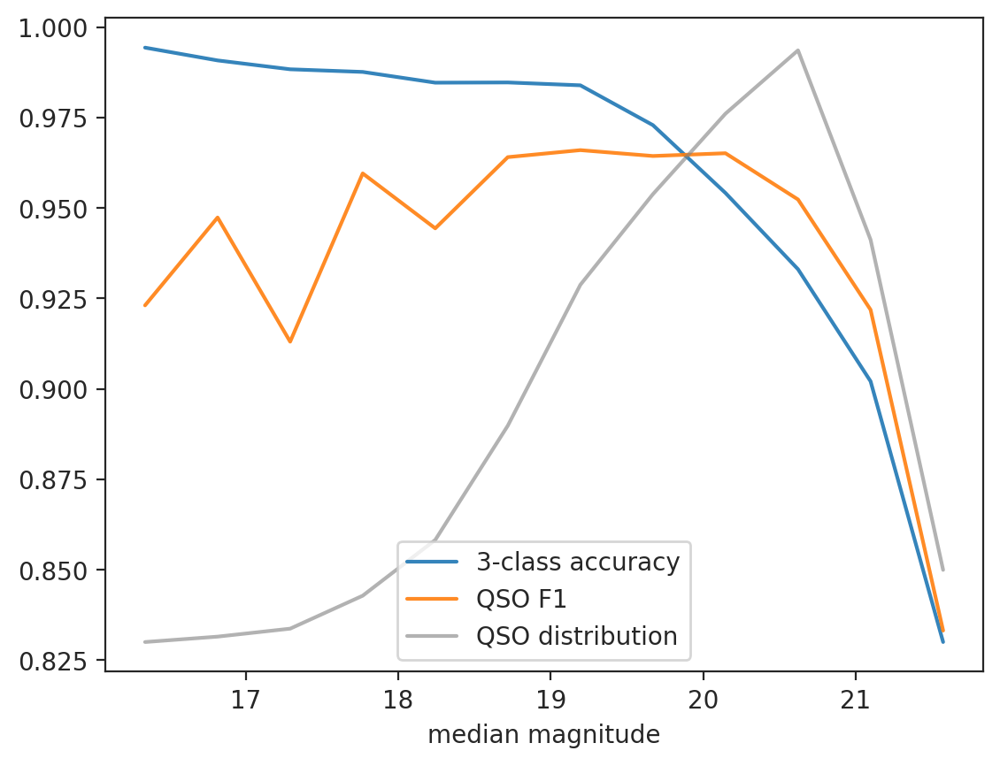

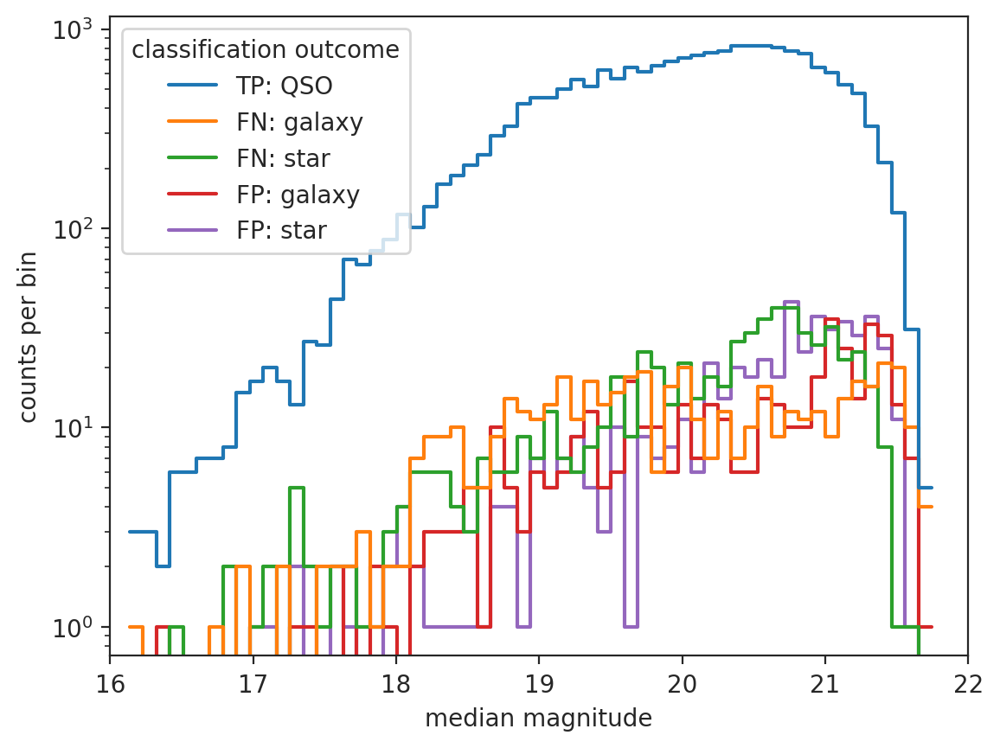

/home/sjnakoneczny/tools/anaconda3/envs/py39-lofar-dr2/lib/python3.9/site-packages/numpy/lib/function_base.py:518: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/sjnakoneczny/tools/anaconda3/envs/py39-lofar-dr2/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


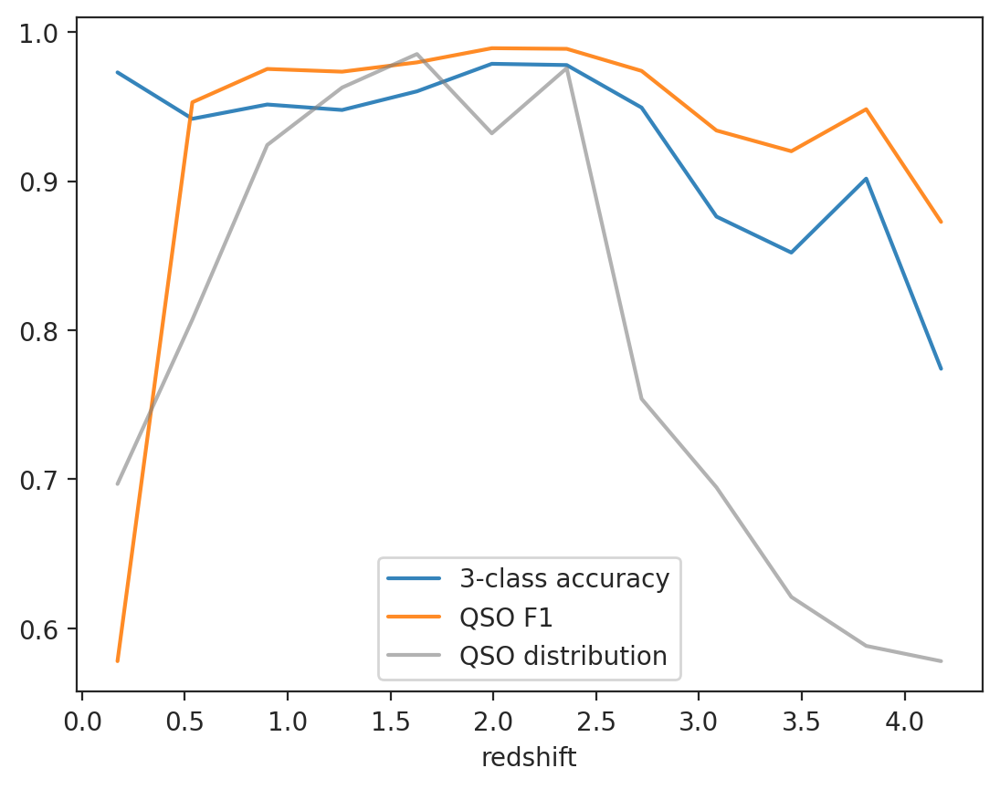

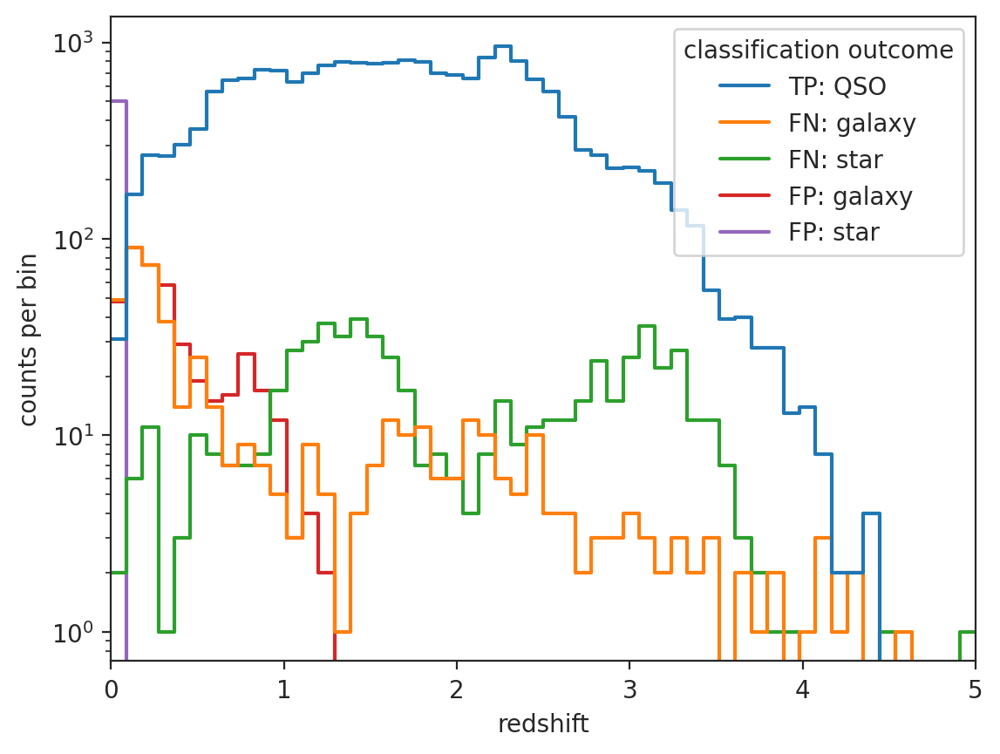

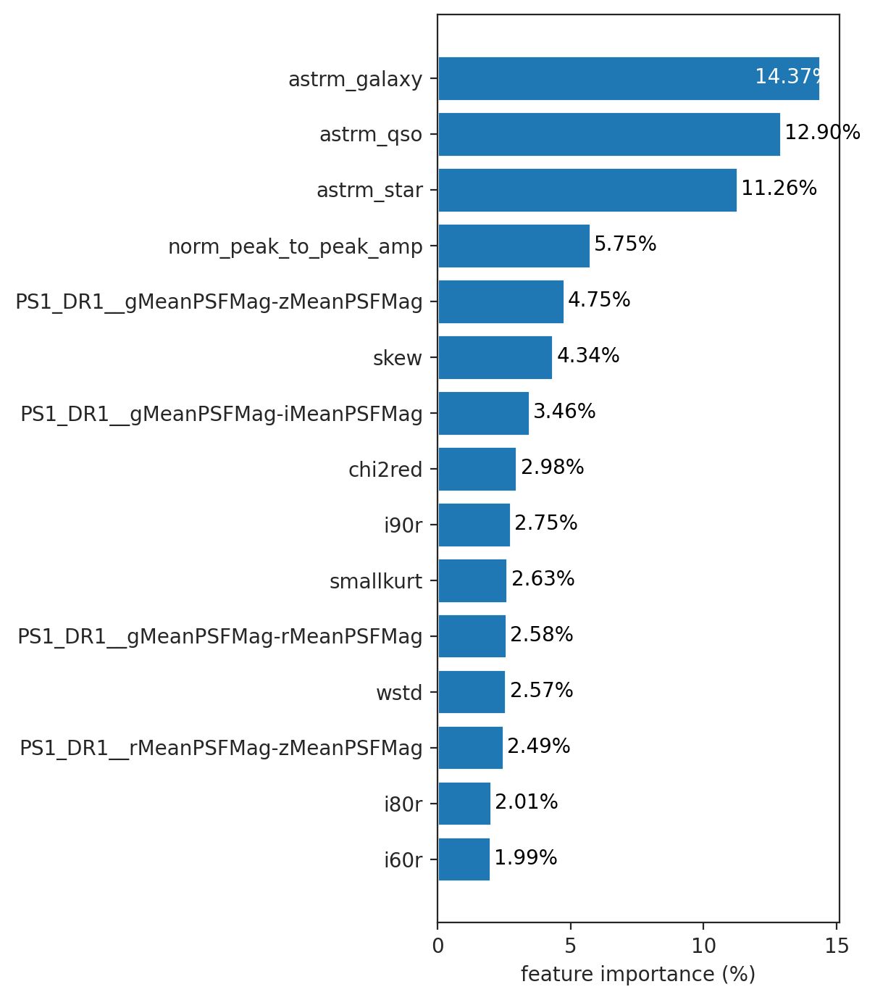

--------------------


In [102]:
data_label = 'ZTF x astrm_clf x PS'
make_reports(results[data_label], classifiers[data_label], feature_sets)

features: ZTF
              precision    recall  f1-score   support

      GALAXY     0.9173    0.9423    0.9296     53955
         QSO     0.8748    0.8205    0.8467     20849
        STAR     0.8943    0.8892    0.8918     30905

    accuracy                         0.9027    105709
   macro avg     0.8955    0.8840    0.8894    105709
weighted avg     0.9022    0.9027    0.9022    105709



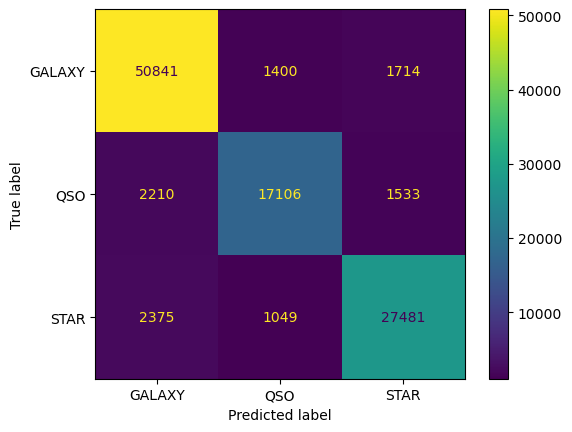

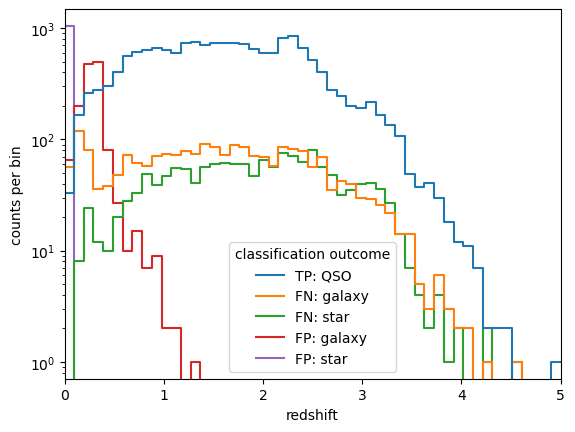

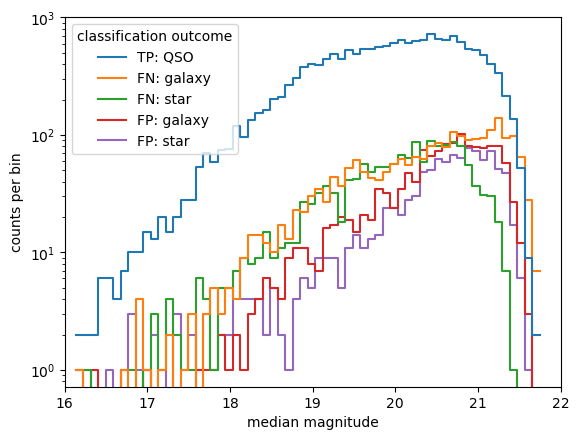

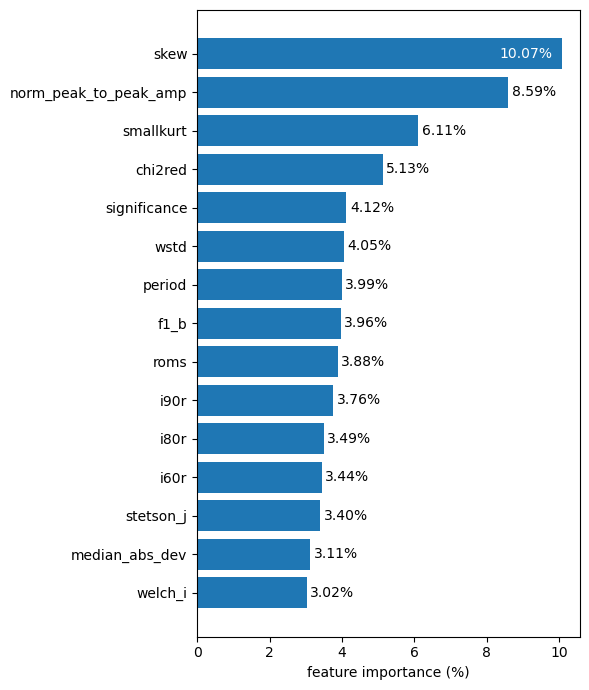

--------------------
features: astromer
              precision    recall  f1-score   support

      GALAXY     0.8078    0.9581    0.8765     53955
         QSO     0.8836    0.7274    0.7980     20849
        STAR     0.9237    0.7339    0.8179     30905

    accuracy                         0.8470    105709
   macro avg     0.8717    0.8065    0.8308    105709
weighted avg     0.8566    0.8470    0.8439    105709



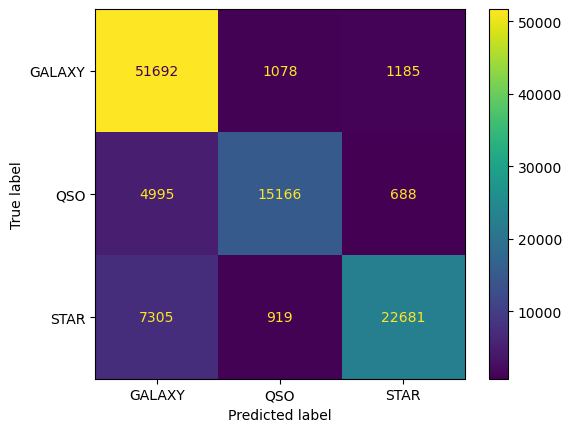

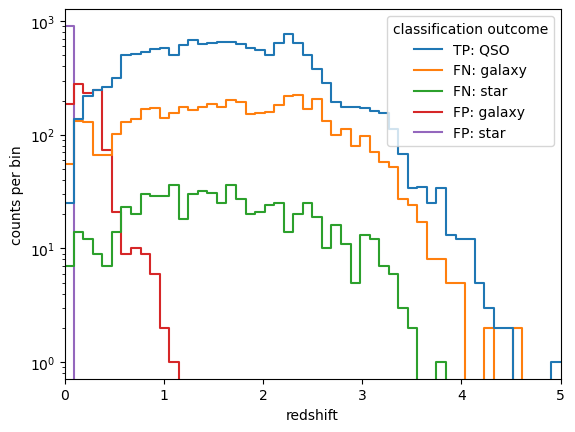

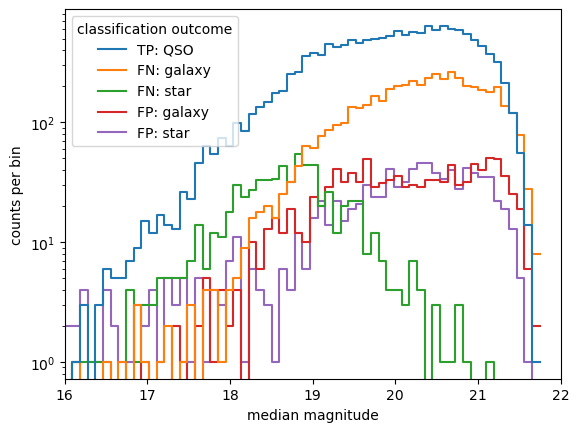

attention: 0, importance: 0.26434463112876255
attention: 1, importance: 0.21799866019168807
attention: 2, importance: 0.27187744393156305
attention: 3, importance: 0.36002483462335516
attention: 4, importance: 0.8921089105798459
attention: 5, importance: 0.16905454629328248
attention: 6, importance: 0.2758520462876553
attention: 7, importance: 0.32065430075874274
attention: 8, importance: 0.32819260114802007
attention: 9, importance: 0.2865355131060939
attention: 10, importance: 0.2917639499147211
attention: 11, importance: 0.4642632599746642
attention: 12, importance: 0.21808898557919482
attention: 13, importance: 0.7724861386320315
attention: 14, importance: 0.3531612667999931
attention: 15, importance: 0.25853212519611446
attention: 16, importance: 0.24719365851234645
attention: 17, importance: 0.3675182762310999
attention: 18, importance: 0.27111738118660134
attention: 19, importance: 0.2958971292624374
attention: 20, importance: 0.25361082051473627
attention: 21, importance: 0.296

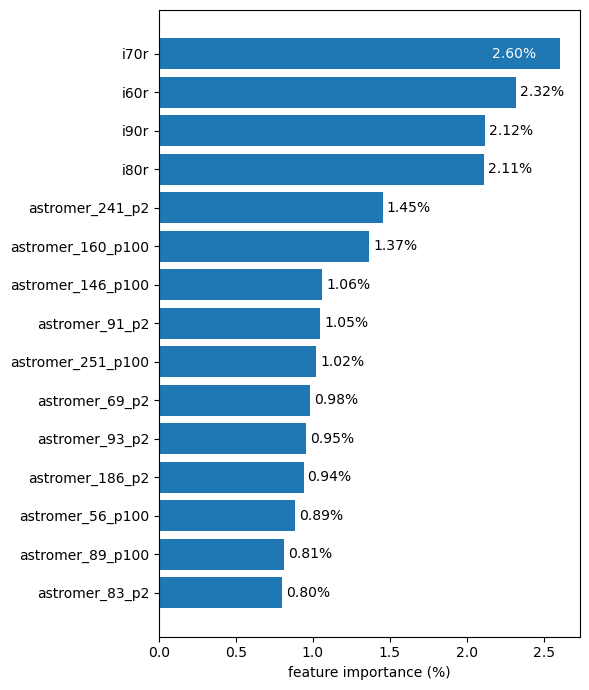

--------------------
features: PS
              precision    recall  f1-score   support

      GALAXY     0.9318    0.9358    0.9338     53955
         QSO     0.8240    0.8305    0.8273     20849
        STAR     0.9269    0.9149    0.9208     30905

    accuracy                         0.9089    105709
   macro avg     0.8942    0.8937    0.8940    105709
weighted avg     0.9091    0.9089    0.9090    105709



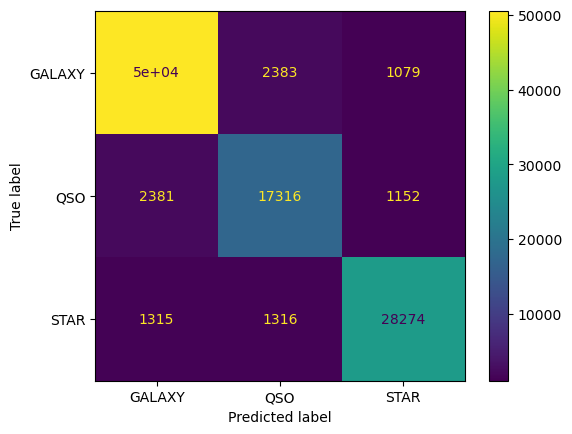

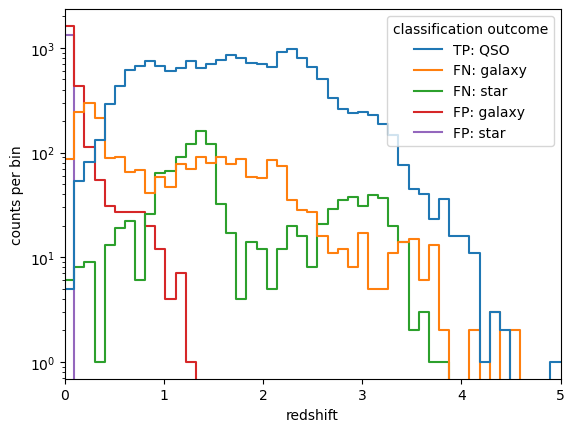

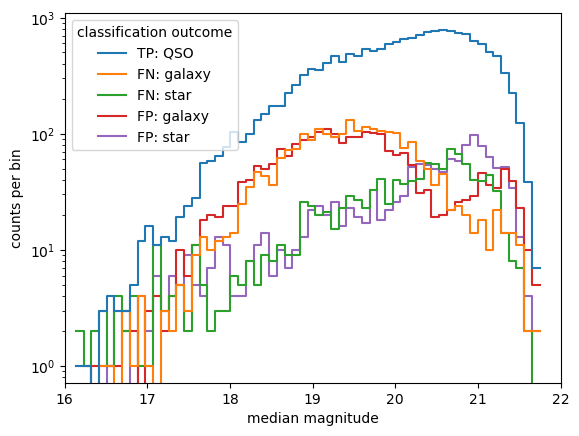

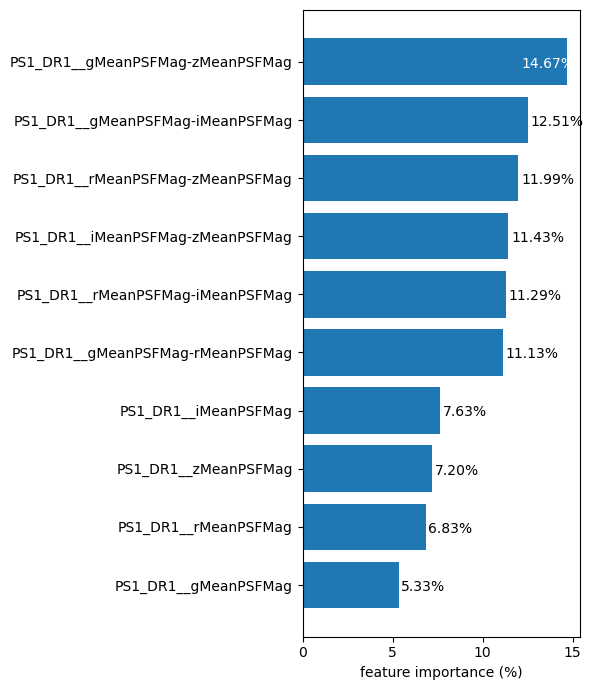

--------------------
features: ZTF + astromer + PS
              precision    recall  f1-score   support

      GALAXY     0.9658    0.9756    0.9707     53955
         QSO     0.9125    0.9280    0.9202     20849
        STAR     0.9519    0.9242    0.9378     30905

    accuracy                         0.9512    105709
   macro avg     0.9434    0.9426    0.9429    105709
weighted avg     0.9512    0.9512    0.9511    105709



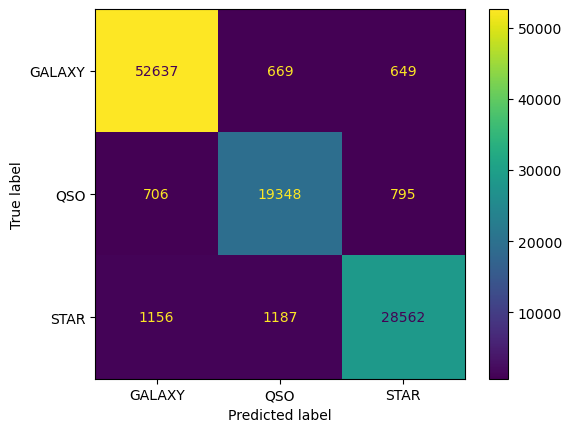

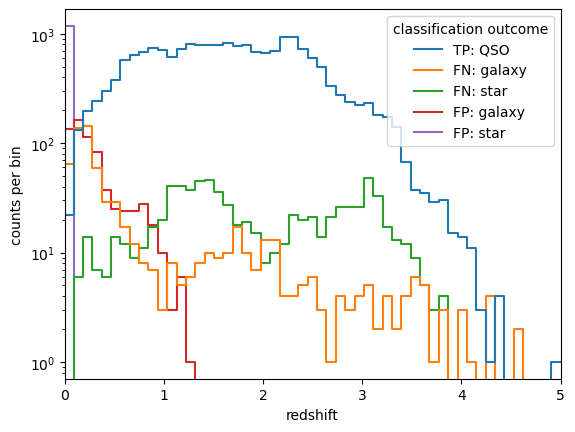

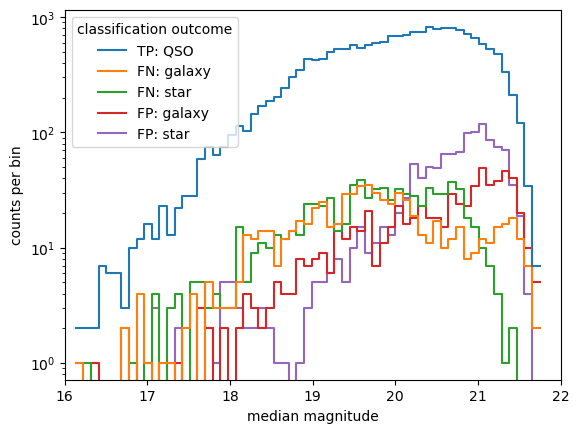

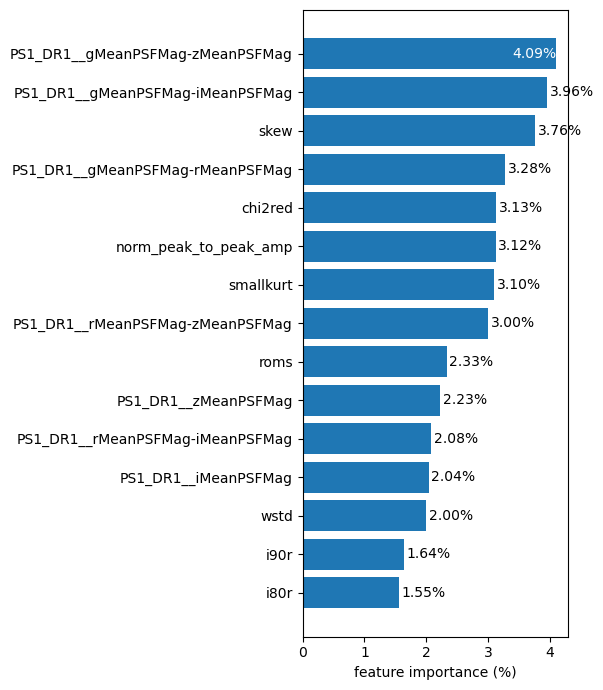

--------------------


In [10]:
# p0, p100 astromer features, plus i...
data_label = 'ZTF x astromer x PS'
make_reports(results[data_label], classifiers[data_label], feature_sets)

features: ZTF
              precision    recall  f1-score   support

      GALAXY     0.9173    0.9423    0.9296     53955
         QSO     0.8748    0.8205    0.8467     20849
        STAR     0.8943    0.8892    0.8918     30905

    accuracy                         0.9027    105709
   macro avg     0.8955    0.8840    0.8894    105709
weighted avg     0.9022    0.9027    0.9022    105709



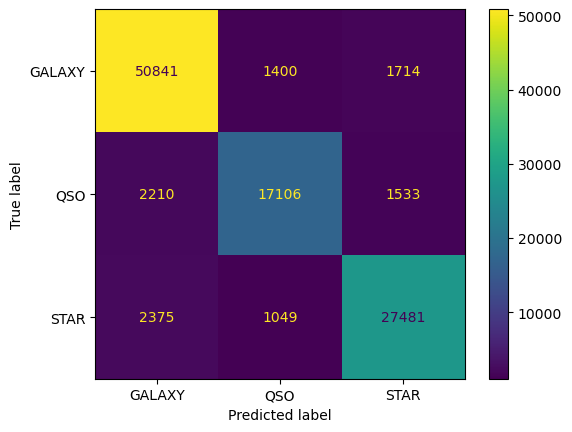

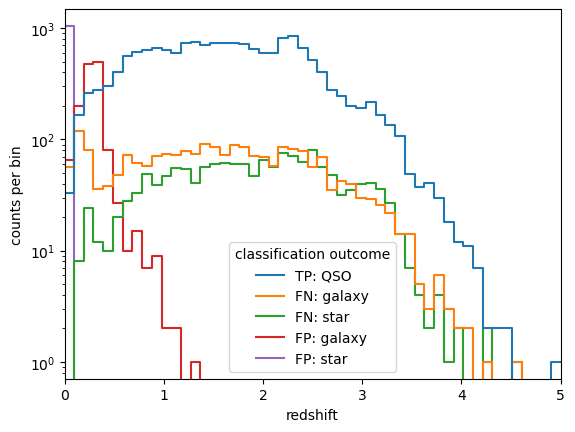

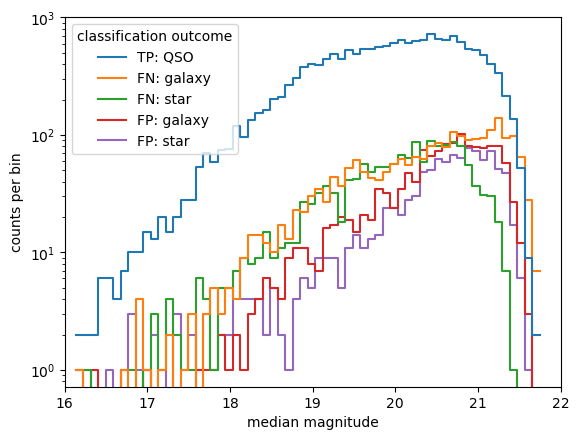

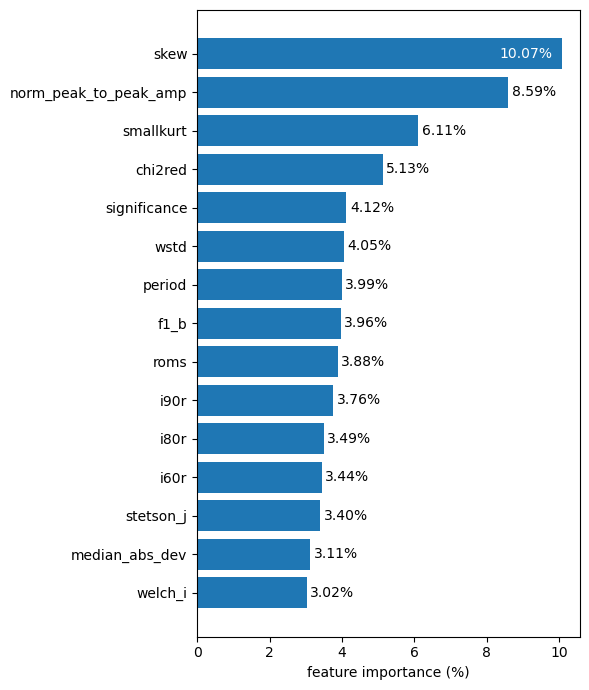

--------------------
features: astromer
              precision    recall  f1-score   support

      GALAXY     0.8059    0.9568    0.8749     53955
         QSO     0.8822    0.7143    0.7894     20849
        STAR     0.9142    0.7326    0.8134     30905

    accuracy                         0.8434    105709
   macro avg     0.8674    0.8012    0.8259    105709
weighted avg     0.8526    0.8434    0.8400    105709



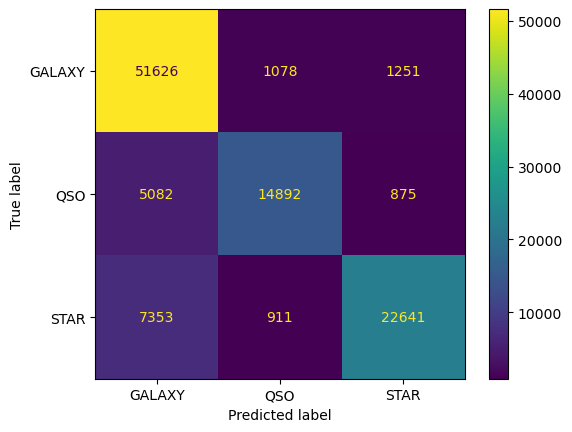

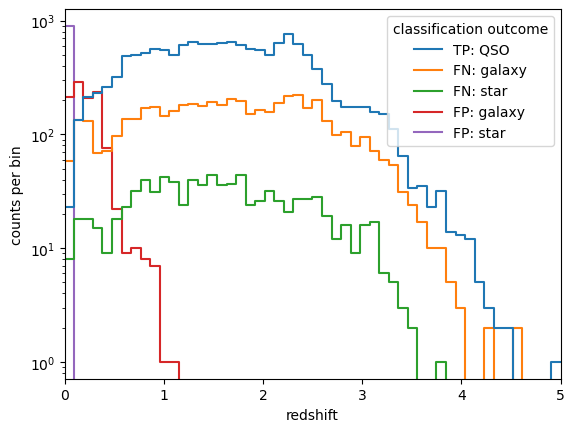

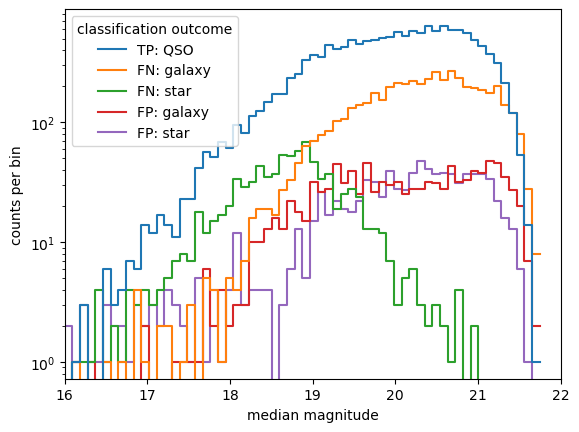

attention: 0, importance: 0.32746258223651026
attention: 1, importance: 0.2425129985912641
attention: 2, importance: 0.29481086067017404
attention: 3, importance: 0.3991928761266416
attention: 4, importance: 0.7670613243957268
attention: 5, importance: 0.17999411211132194
attention: 6, importance: 0.2999924229018883
attention: 7, importance: 0.29230487206276035
attention: 8, importance: 0.3831673276850381
attention: 9, importance: 0.29252253355292734
attention: 10, importance: 0.31486558994664066
attention: 11, importance: 0.5586113719691885
attention: 12, importance: 0.22834357180560882
attention: 13, importance: 0.9611884140755476
attention: 14, importance: 0.41779364665341856
attention: 15, importance: 0.2906516874180978
attention: 16, importance: 0.328486044070233
attention: 17, importance: 0.4725784503599004
attention: 18, importance: 0.3005791285717727
attention: 19, importance: 0.3606185326505139
attention: 20, importance: 0.2715765022340706
attention: 21, importance: 0.31141912

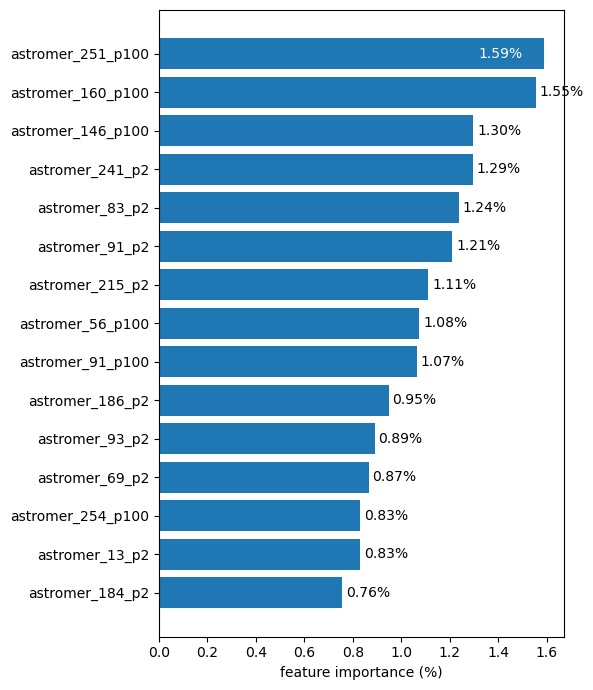

--------------------
features: PS
              precision    recall  f1-score   support

      GALAXY     0.9318    0.9358    0.9338     53955
         QSO     0.8240    0.8305    0.8273     20849
        STAR     0.9269    0.9149    0.9208     30905

    accuracy                         0.9089    105709
   macro avg     0.8942    0.8937    0.8940    105709
weighted avg     0.9091    0.9089    0.9090    105709



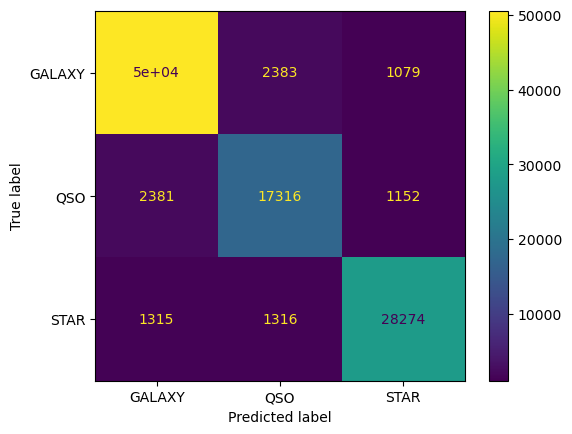

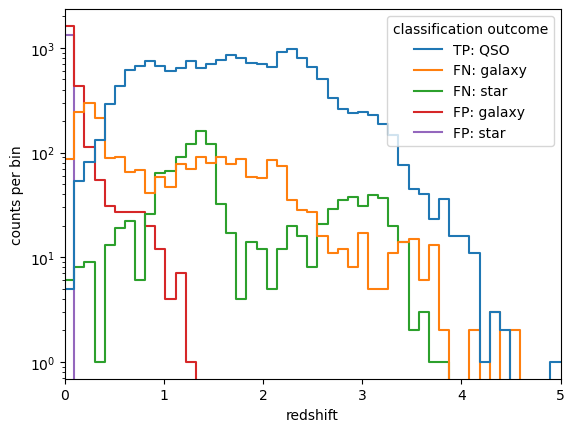

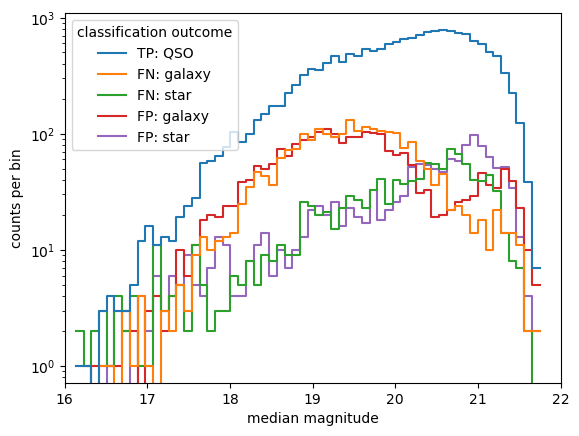

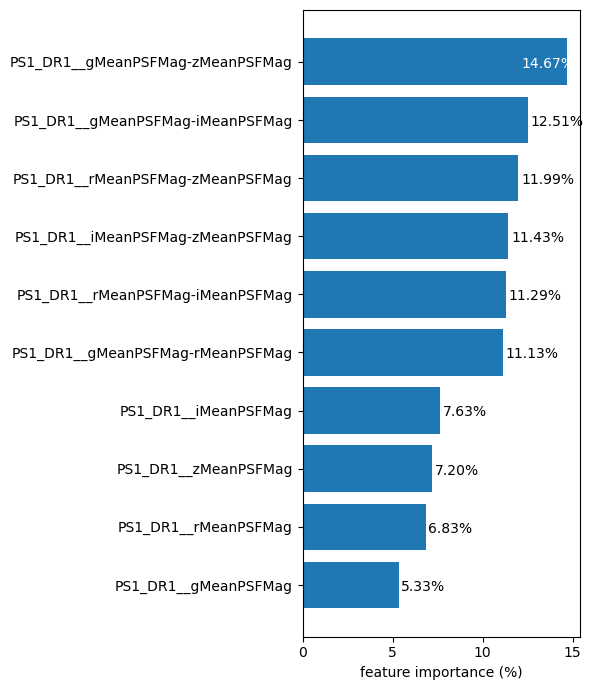

--------------------
features: ZTF + astromer + PS
              precision    recall  f1-score   support

      GALAXY     0.9660    0.9756    0.9708     53955
         QSO     0.9123    0.9272    0.9197     20849
        STAR     0.9509    0.9240    0.9373     30905

    accuracy                         0.9510    105709
   macro avg     0.9431    0.9423    0.9426    105709
weighted avg     0.9510    0.9510    0.9509    105709



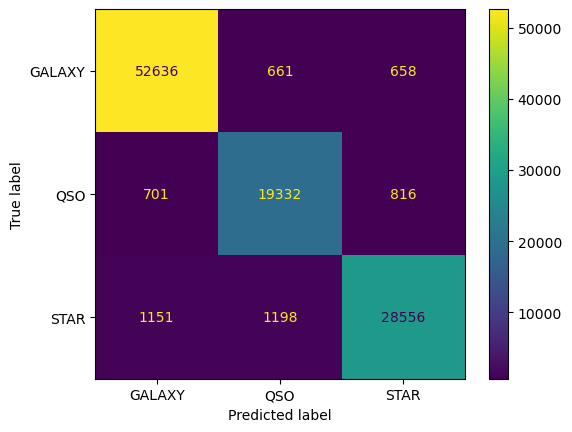

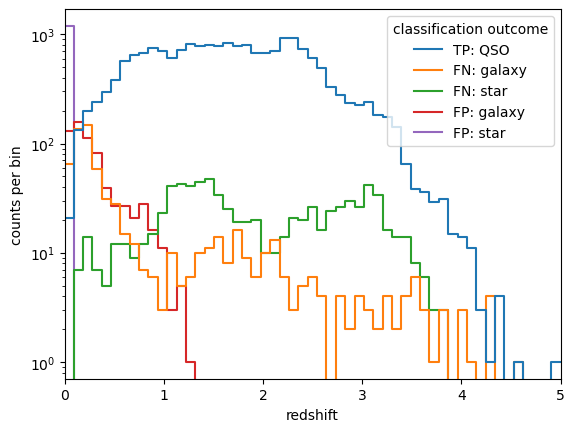

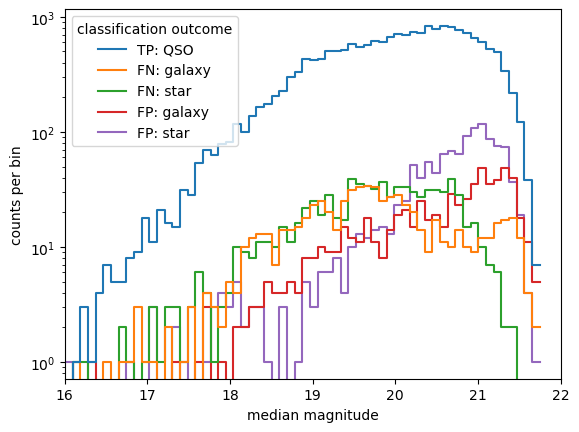

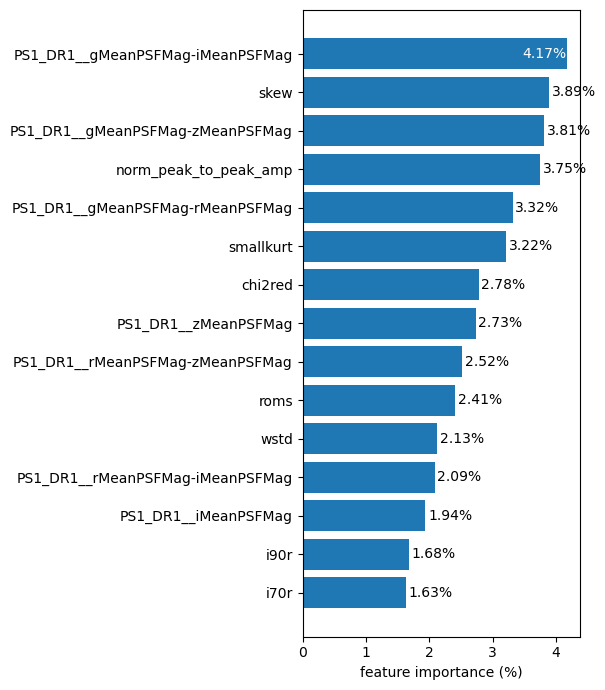

--------------------


In [9]:
# p0, p100 astromer features
data_label = 'ZTF x astromer x PS'
make_reports(results[data_label], classifiers[data_label], feature_sets)

features: ZTF
              precision    recall  f1-score   support

      GALAXY     0.9173    0.9423    0.9296     53955
         QSO     0.8748    0.8205    0.8467     20849
        STAR     0.8943    0.8892    0.8918     30905

    accuracy                         0.9027    105709
   macro avg     0.8955    0.8840    0.8894    105709
weighted avg     0.9022    0.9027    0.9022    105709



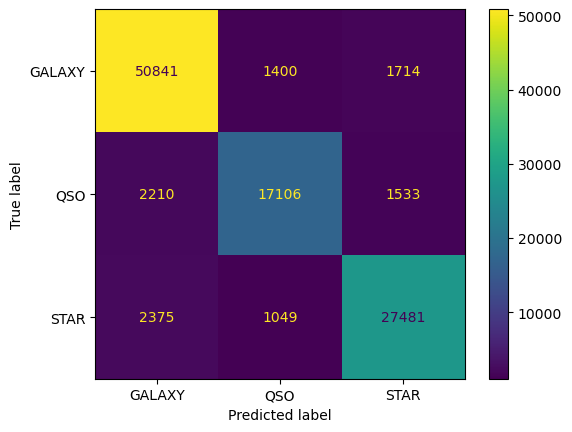

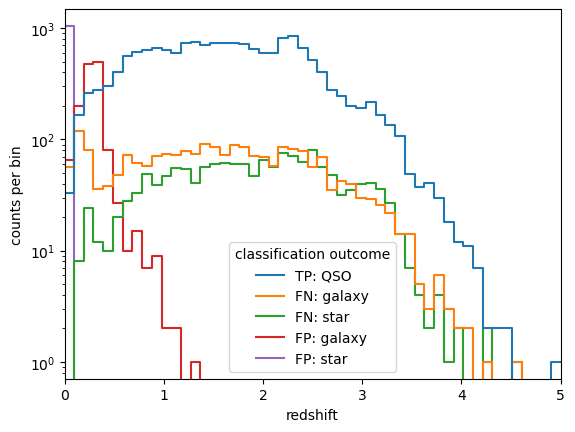

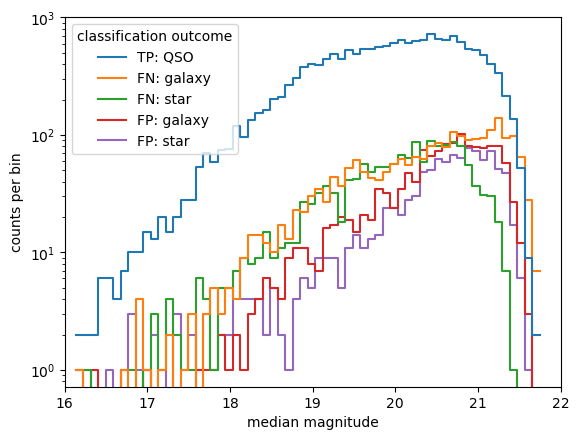

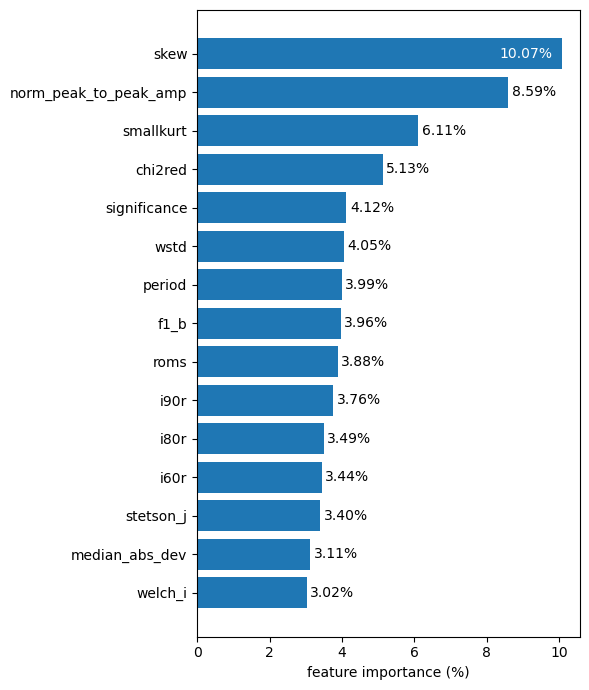

--------------------
features: astromer
              precision    recall  f1-score   support

      GALAXY     0.8191    0.9620    0.8848     53955
         QSO     0.9070    0.7456    0.8184     20849
        STAR     0.9152    0.7464    0.8222     30905

    accuracy                         0.8563    105709
   macro avg     0.8805    0.8180    0.8418    105709
weighted avg     0.8646    0.8563    0.8534    105709



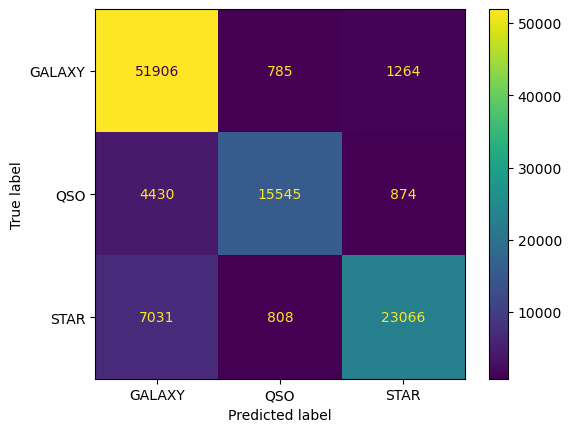

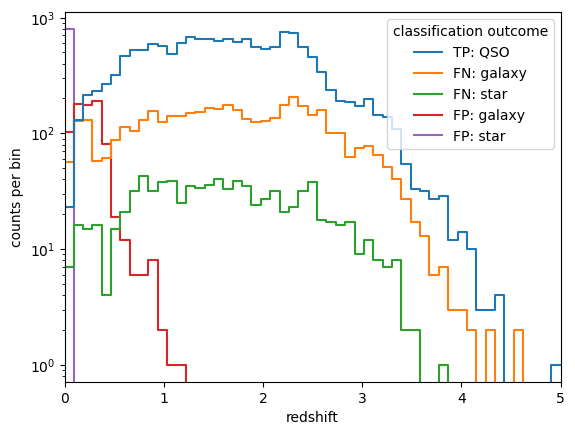

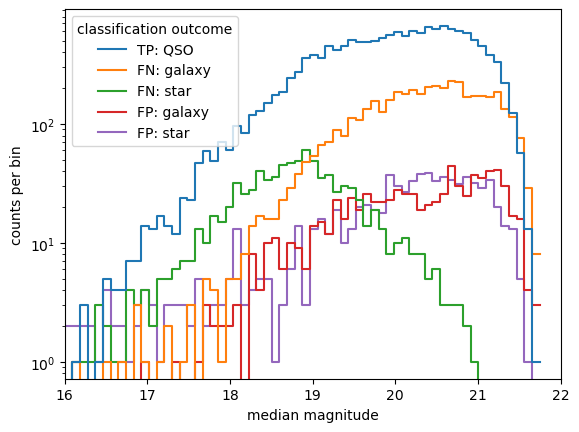

attention: 0, importance: 0.28886600859918826
attention: 1, importance: 0.2301478616737664
attention: 2, importance: 0.3291479511940136
attention: 3, importance: 0.3878322891585032
attention: 4, importance: 1.131319179458169
attention: 5, importance: 0.20535613288865212
attention: 6, importance: 0.5515481132933787
attention: 7, importance: 0.2201906994771059
attention: 8, importance: 0.33918769979429064
attention: 9, importance: 0.236291859055687
attention: 10, importance: 0.3806390012087875
attention: 11, importance: 0.5194138233484066
attention: 12, importance: 0.23876372020937361
attention: 13, importance: 1.3726798162129346
attention: 14, importance: 0.6276137345112687
attention: 15, importance: 0.3581895320936272
attention: 16, importance: 0.2766265851048066
attention: 17, importance: 0.3977685386809497
attention: 18, importance: 0.29051640334372747
attention: 19, importance: 0.3702164210237964
attention: 20, importance: 0.25146755214721705
attention: 21, importance: 0.25341904012

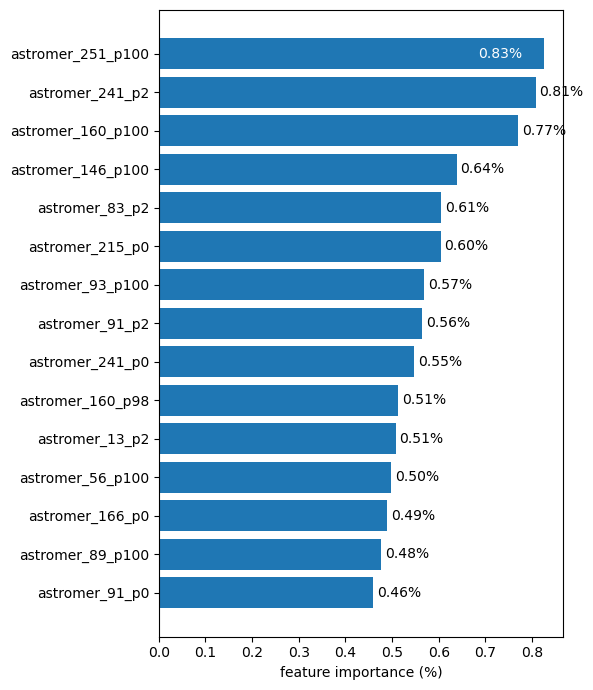

--------------------
features: PS
              precision    recall  f1-score   support

      GALAXY     0.9318    0.9358    0.9338     53955
         QSO     0.8240    0.8305    0.8273     20849
        STAR     0.9269    0.9149    0.9208     30905

    accuracy                         0.9089    105709
   macro avg     0.8942    0.8937    0.8940    105709
weighted avg     0.9091    0.9089    0.9090    105709



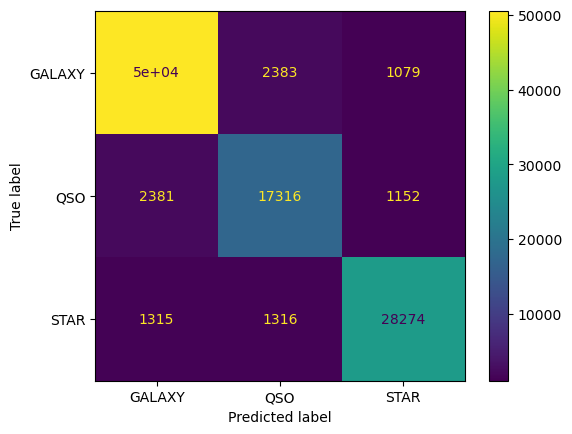

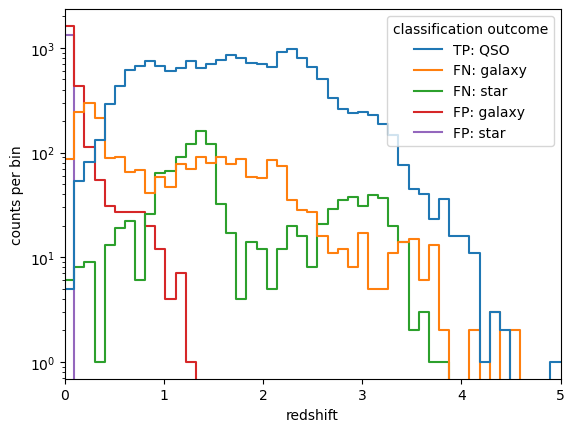

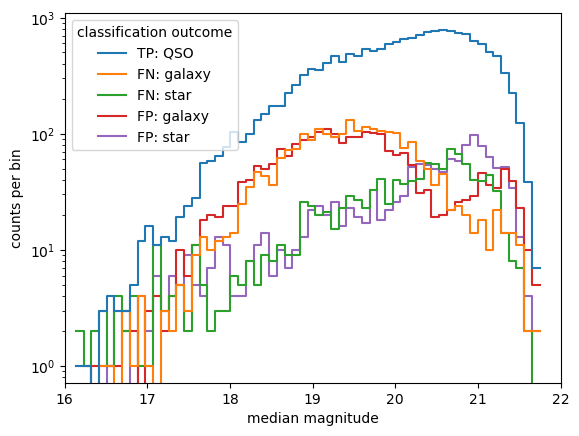

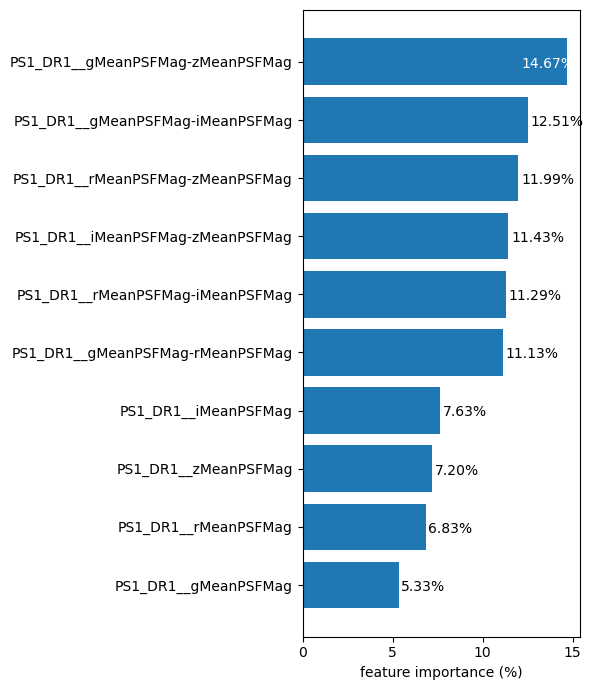

--------------------
features: ZTF + astromer + PS
              precision    recall  f1-score   support

      GALAXY     0.9624    0.9751    0.9687     53955
         QSO     0.9084    0.9192    0.9137     20849
        STAR     0.9425    0.9131    0.9276     30905

    accuracy                         0.9460    105709
   macro avg     0.9378    0.9358    0.9367    105709
weighted avg     0.9459    0.9460    0.9459    105709



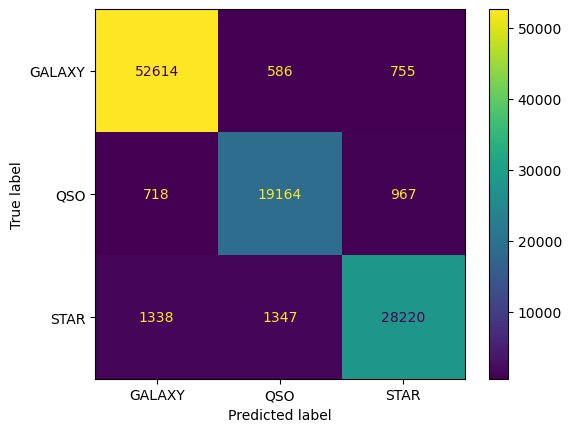

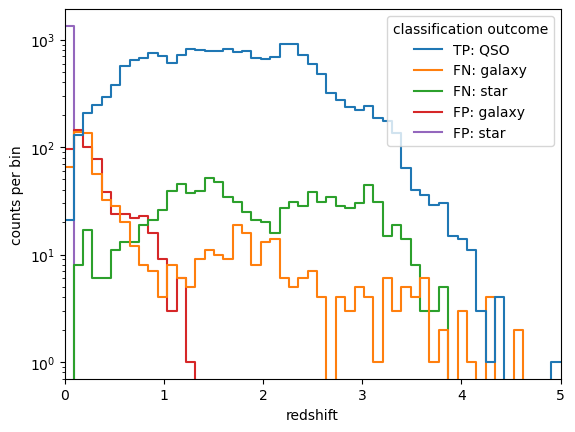

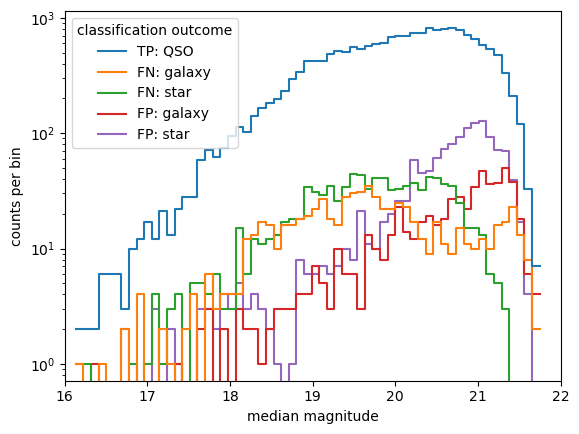

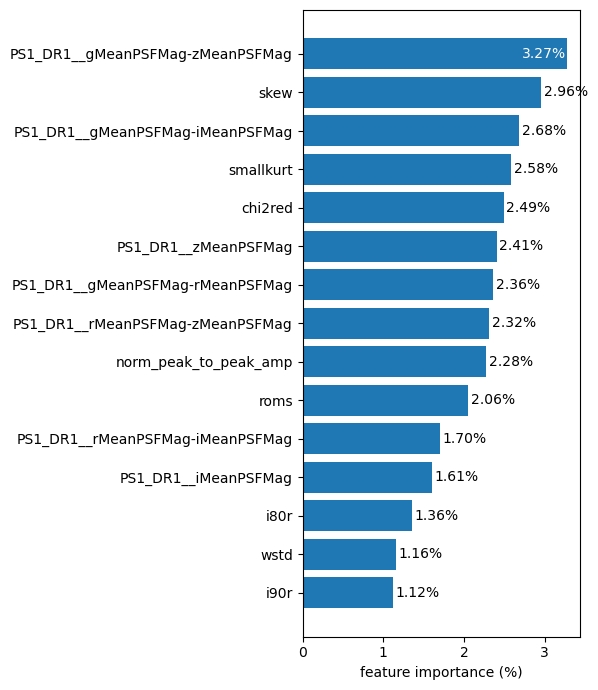

--------------------


In [22]:
# All astromer features
data_label = 'ZTF x astromer x PS'
make_reports(results[data_label], classifiers[data_label], feature_sets)

## ZTF x PS x WISE

features: ZTF
              precision    recall  f1-score   support

      GALAXY     0.9248    0.9576    0.9409     51575
         QSO     0.8799    0.8383    0.8586     19080
        STAR     0.9365    0.8975    0.9166     22237

    accuracy                         0.9187     92892
   macro avg     0.9137    0.8978    0.9053     92892
weighted avg     0.9184    0.9187    0.9182     92892



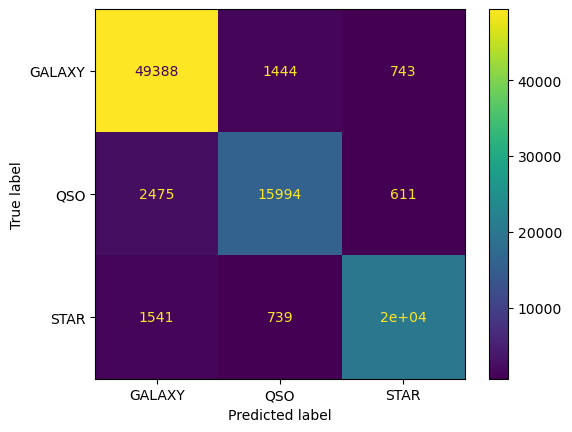

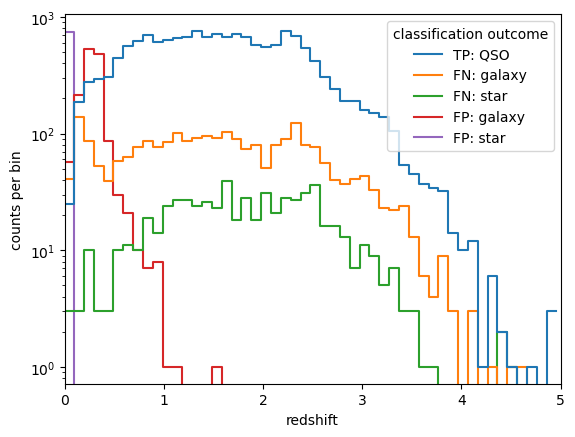

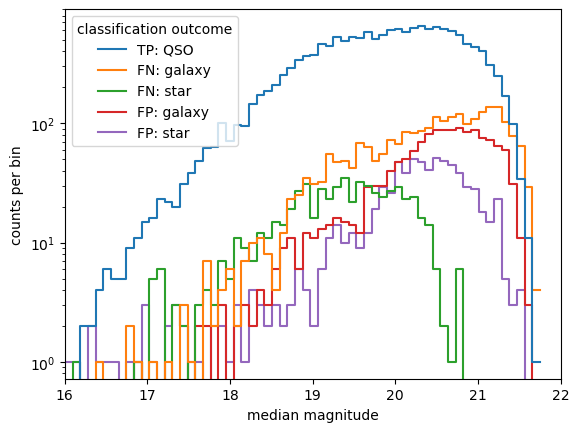

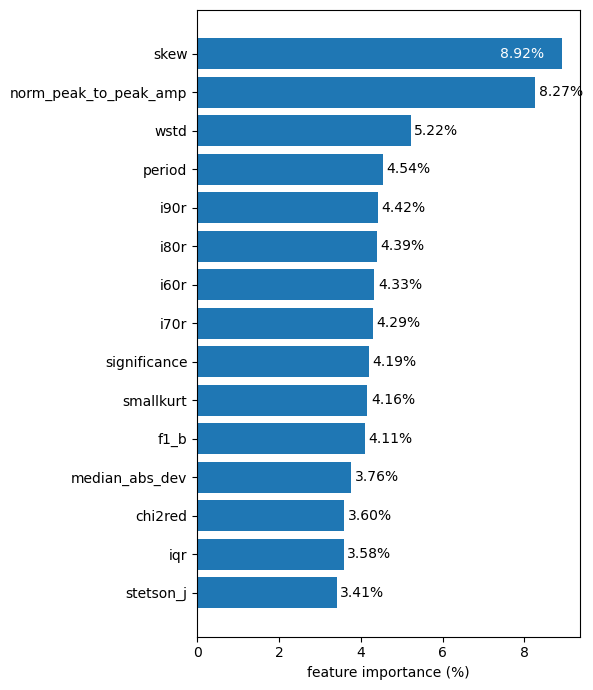

--------------------
features: PS
              precision    recall  f1-score   support

      GALAXY     0.9332    0.9431    0.9381     51575
         QSO     0.8629    0.8614    0.8621     19080
        STAR     0.9503    0.9284    0.9392     22237

    accuracy                         0.9228     92892
   macro avg     0.9155    0.9110    0.9132     92892
weighted avg     0.9229    0.9228    0.9228     92892



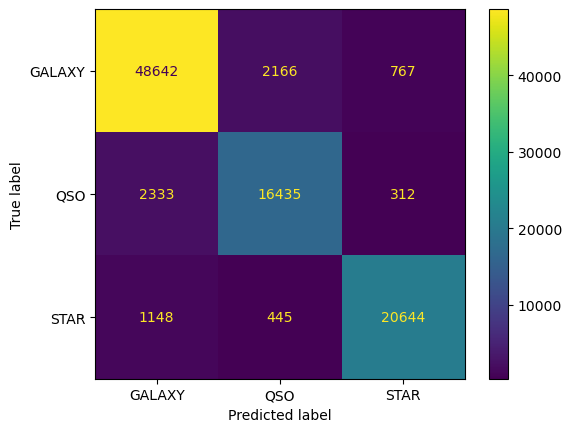

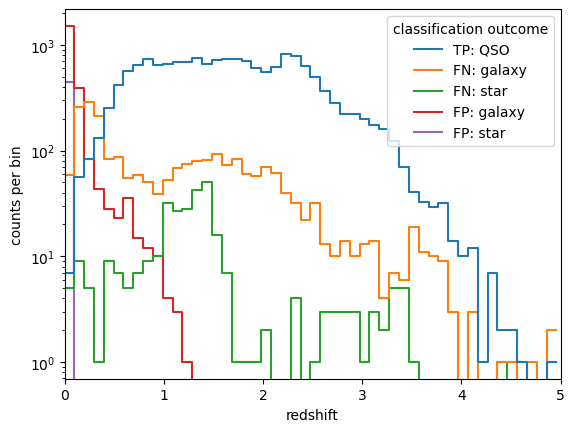

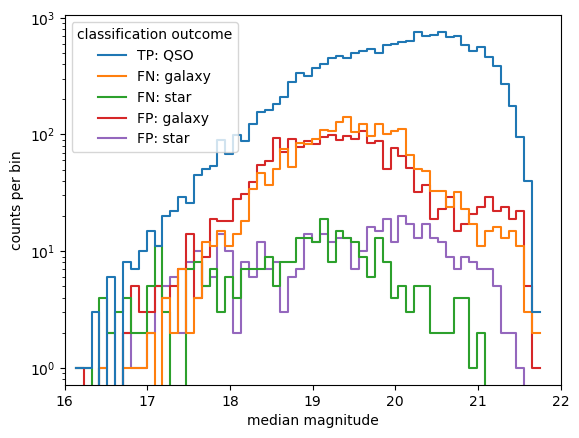

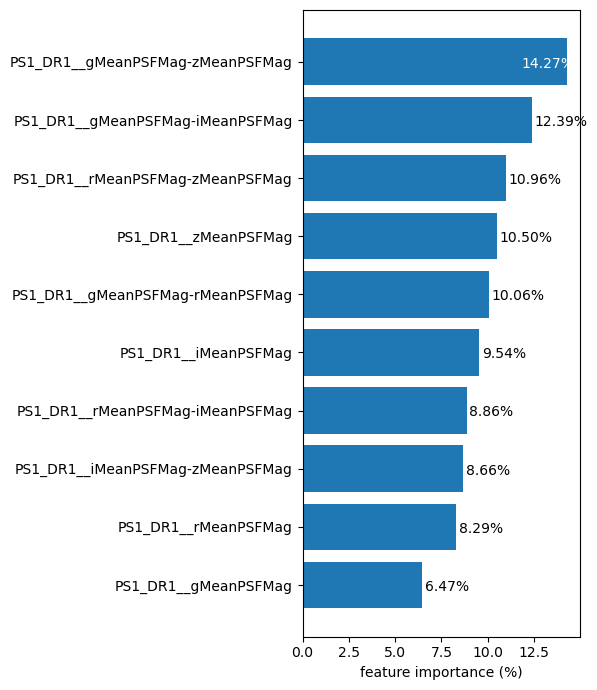

--------------------
features: WISE
              precision    recall  f1-score   support

      GALAXY     0.9466    0.9453    0.9459     51575
         QSO     0.9566    0.9512    0.9539     19080
        STAR     0.8685    0.8754    0.8719     22237

    accuracy                         0.9298     92892
   macro avg     0.9239    0.9240    0.9239     92892
weighted avg     0.9299    0.9298    0.9298     92892



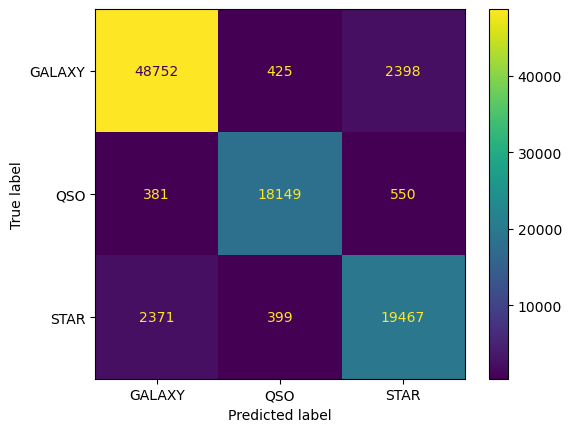

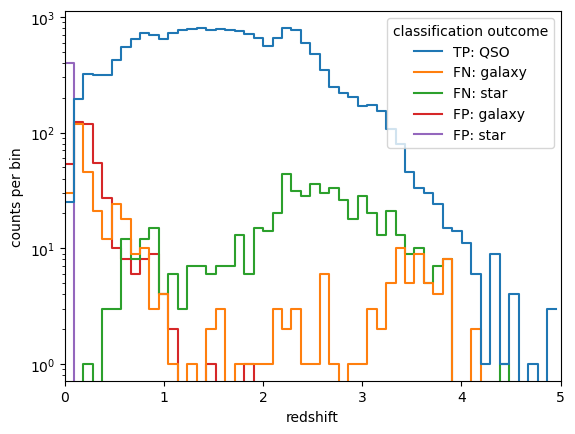

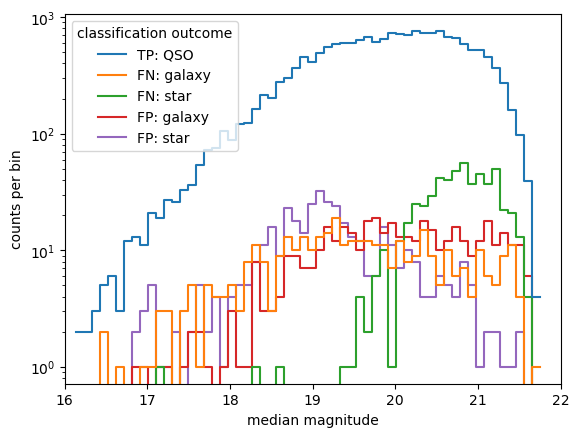

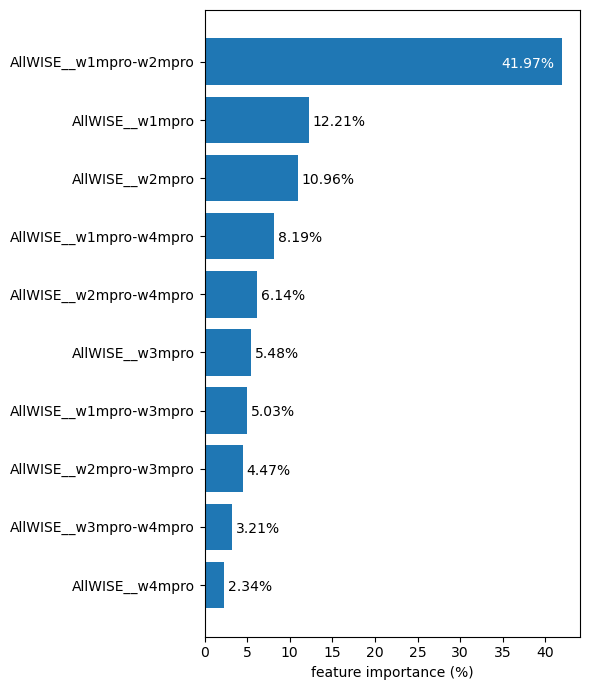

--------------------
features: ZTF + PS + WISE
              precision    recall  f1-score   support

      GALAXY     0.9894    0.9921    0.9908     51575
         QSO     0.9788    0.9811    0.9799     19080
        STAR     0.9946    0.9863    0.9904     22237

    accuracy                         0.9885     92892
   macro avg     0.9876    0.9865    0.9871     92892
weighted avg     0.9885    0.9885    0.9885     92892



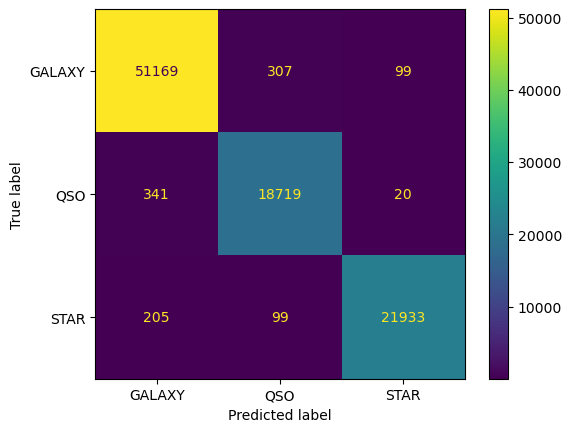

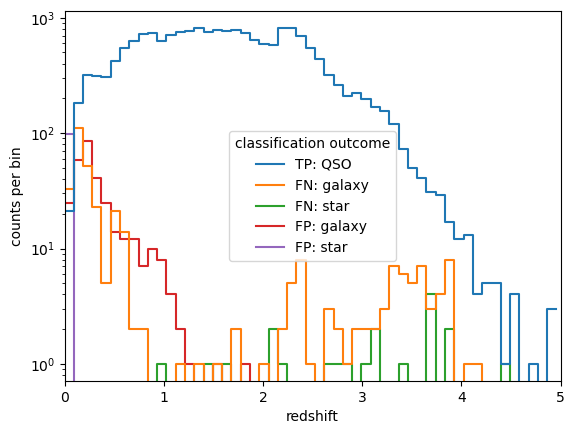

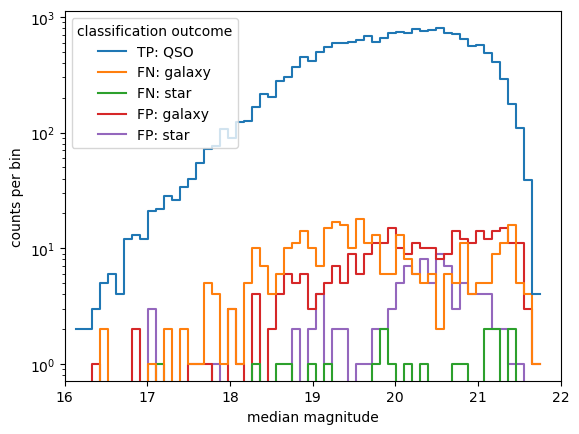

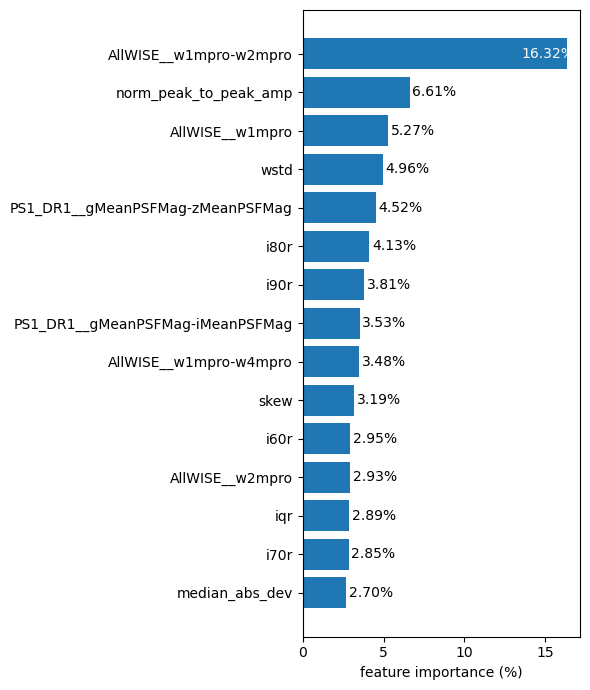

--------------------


In [42]:
data_label = 'ZTF x PS x WISE'
make_reports(results[data_label], classifiers[data_label], feature_sets)

features: ZTF
              precision    recall  f1-score   support

      GALAXY     0.9370    0.9674    0.9520     71772
         QSO     0.8782    0.8430    0.8603     20986
        STAR     0.9537    0.8939    0.9228     23709

    accuracy                         0.9300    116467
   macro avg     0.9230    0.9014    0.9117    116467
weighted avg     0.9298    0.9300    0.9295    116467



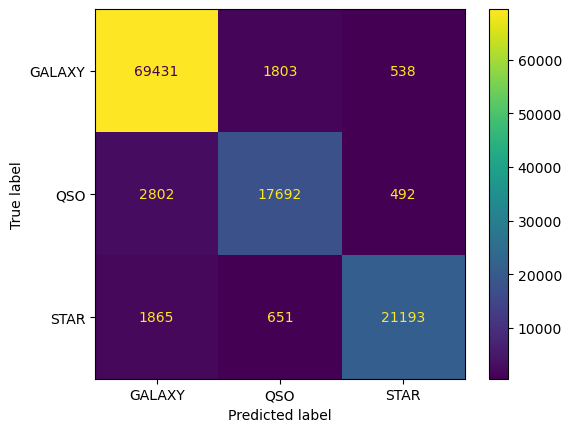

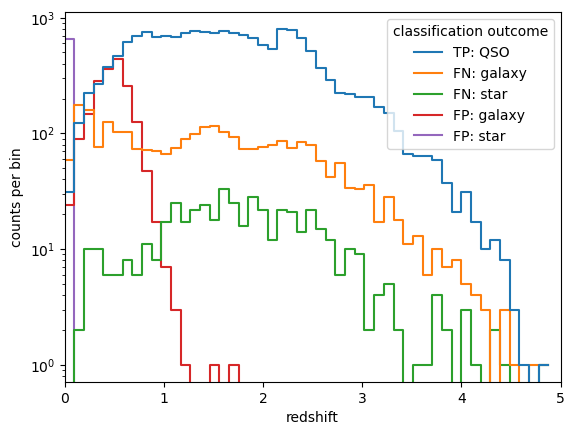

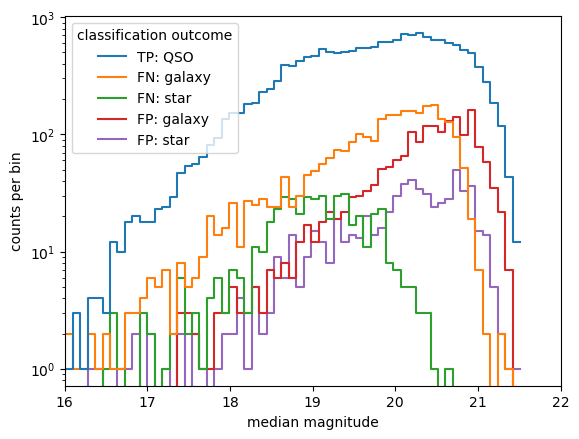

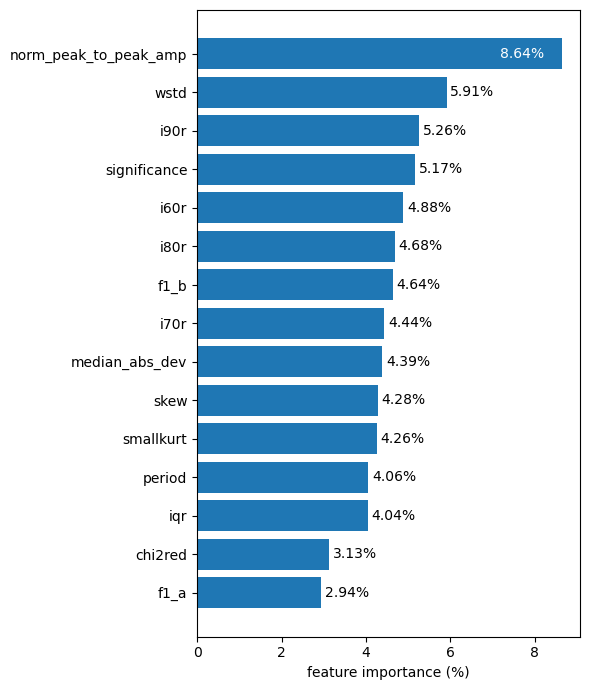

--------------------
features: PS
              precision    recall  f1-score   support

      GALAXY     0.9377    0.9516    0.9446     71772
         QSO     0.8555    0.8455    0.8505     20986
        STAR     0.9465    0.9139    0.9299     23709

    accuracy                         0.9248    116467
   macro avg     0.9132    0.9036    0.9083    116467
weighted avg     0.9247    0.9248    0.9246    116467



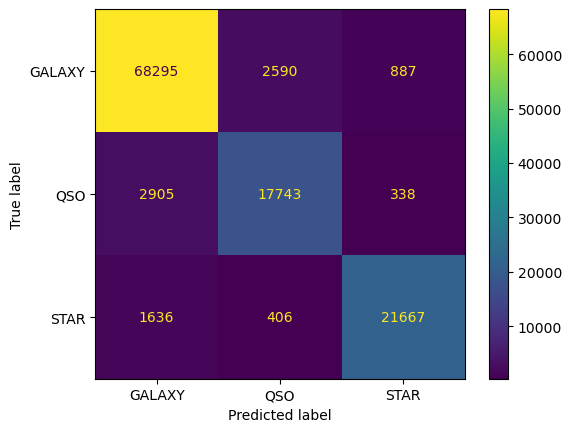

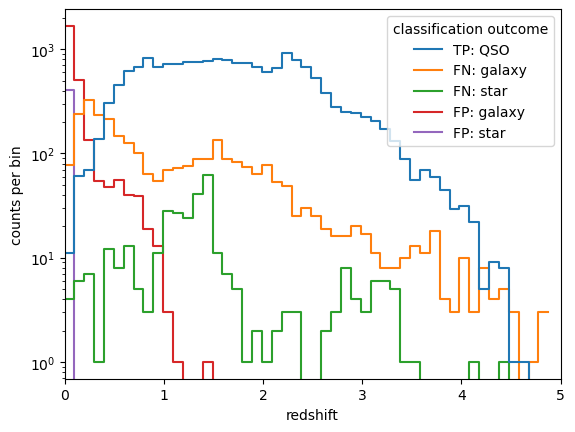

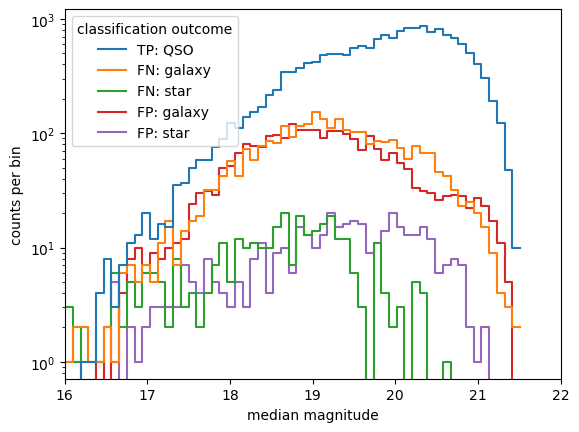

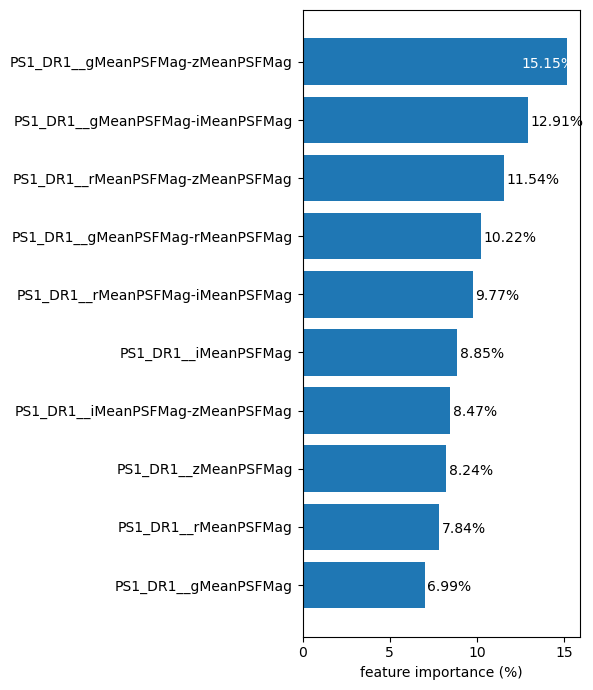

--------------------
features: WISE
              precision    recall  f1-score   support

      GALAXY     0.9336    0.9447    0.9391     71772
         QSO     0.9431    0.9357    0.9394     20986
        STAR     0.8269    0.8029    0.8147     23709

    accuracy                         0.9142    116467
   macro avg     0.9012    0.8944    0.8977    116467
weighted avg     0.9136    0.9142    0.9138    116467



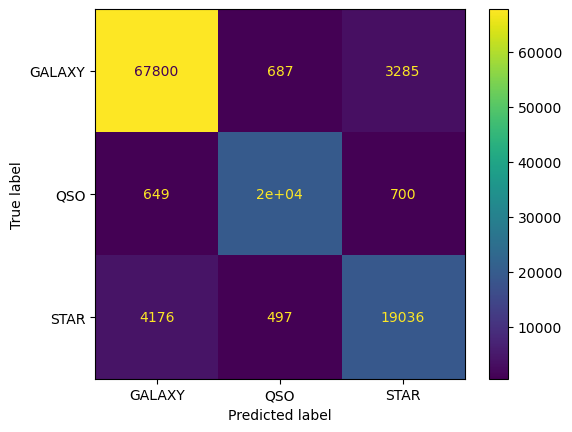

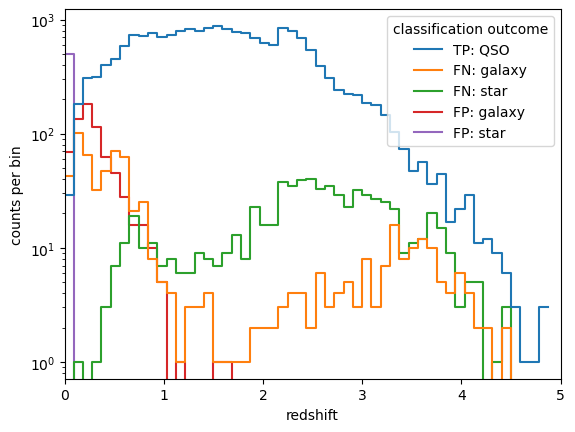

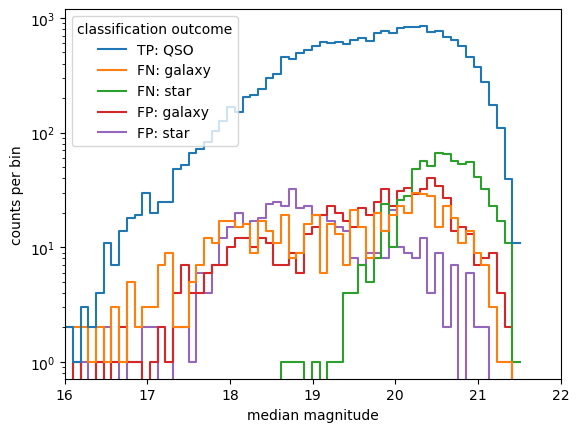

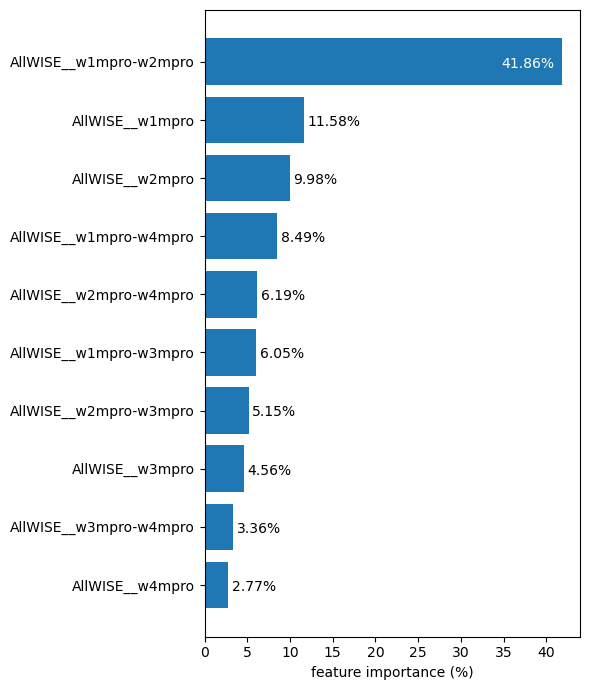

--------------------
features: ZTF + PS + WISE
              precision    recall  f1-score   support

      GALAXY     0.9881    0.9923    0.9902     71772
         QSO     0.9742    0.9739    0.9740     20986
        STAR     0.9938    0.9811    0.9874     23709

    accuracy                         0.9867    116467
   macro avg     0.9853    0.9824    0.9839    116467
weighted avg     0.9867    0.9867    0.9867    116467



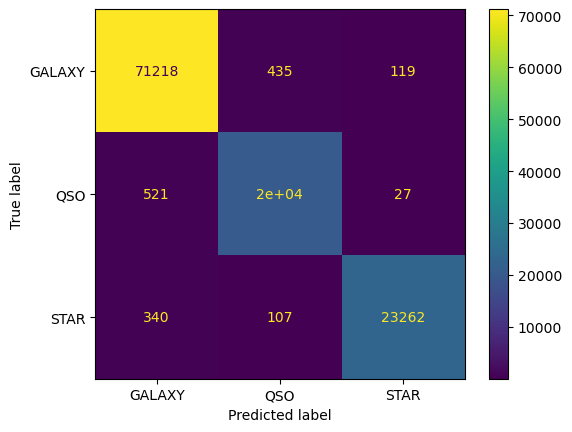

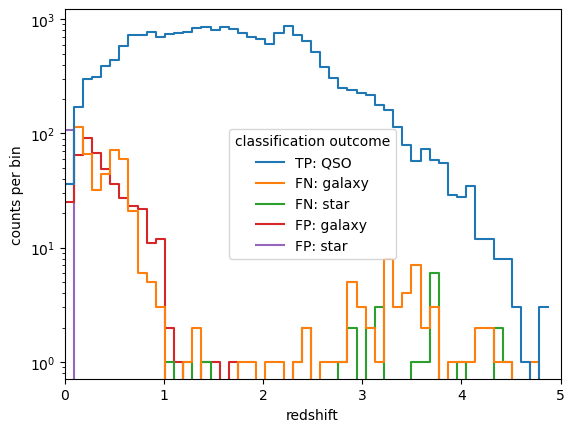

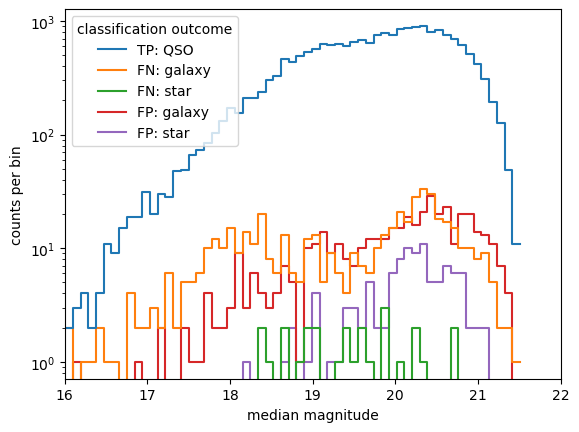

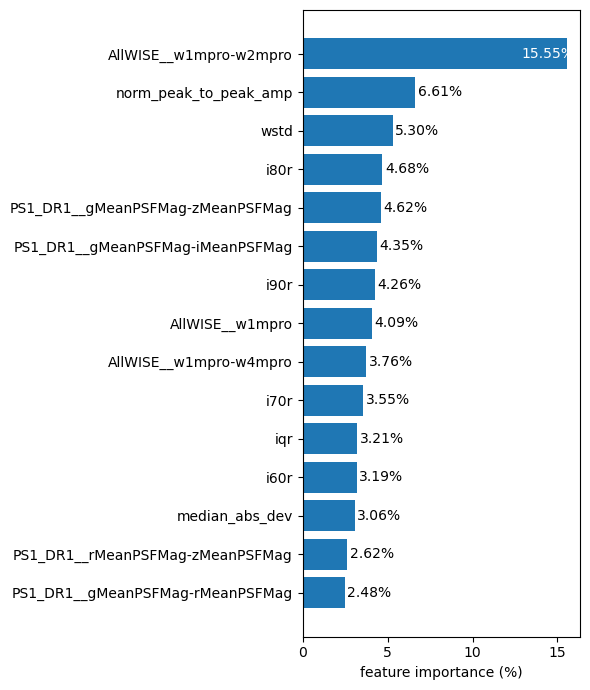

--------------------


In [15]:
# r band
data_label = 'ZTF x PS x WISE'
make_reports(results[data_label], classifiers[data_label], feature_sets)

## ZTF x PS x GAIA x WISE

features: ZTF
              precision    recall  f1-score   support

      GALAXY     0.8737    0.7997    0.8351      3141
         QSO     0.9113    0.9453    0.9280     16888
        STAR     0.9459    0.9302    0.9380     21947

    accuracy                         0.9266     41976
   macro avg     0.9103    0.8918    0.9004     41976
weighted avg     0.9266    0.9266    0.9263     41976



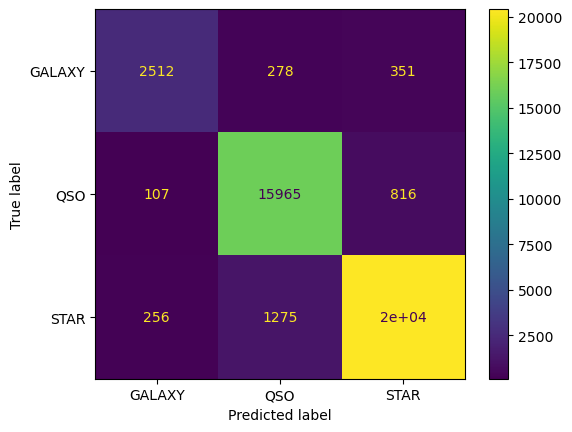

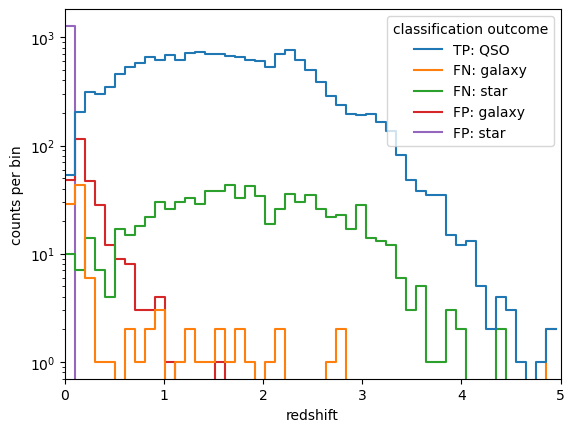

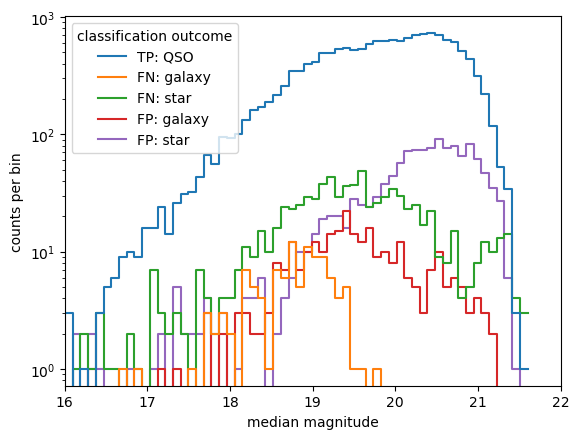

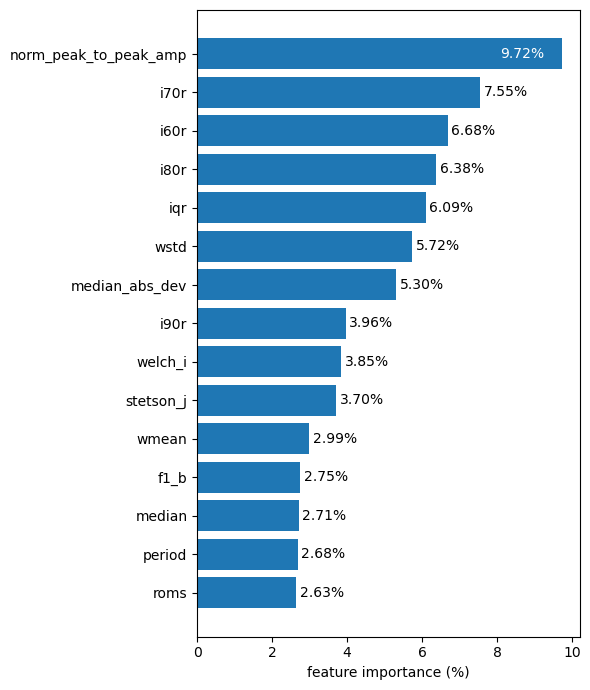

--------------------
features: PS
              precision    recall  f1-score   support

      GALAXY     0.8329    0.7822    0.8068      3141
         QSO     0.9468    0.9608    0.9537     16888
        STAR     0.9682    0.9656    0.9669     21947

    accuracy                         0.9499     41976
   macro avg     0.9159    0.9029    0.9091     41976
weighted avg     0.9494    0.9499    0.9496     41976



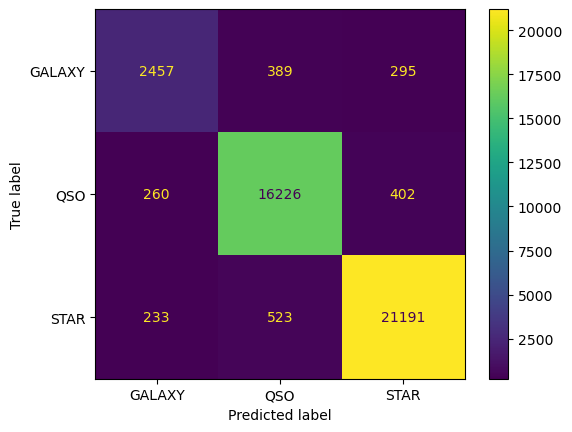

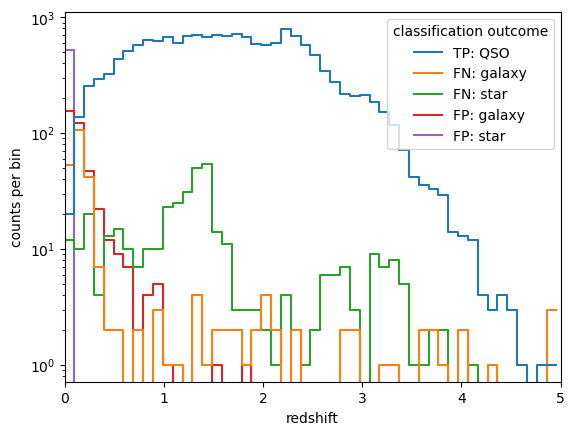

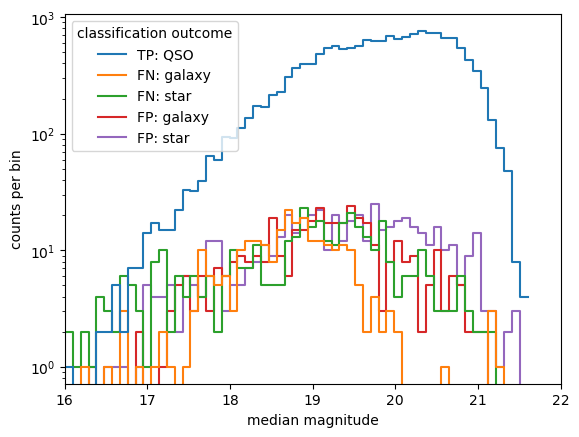

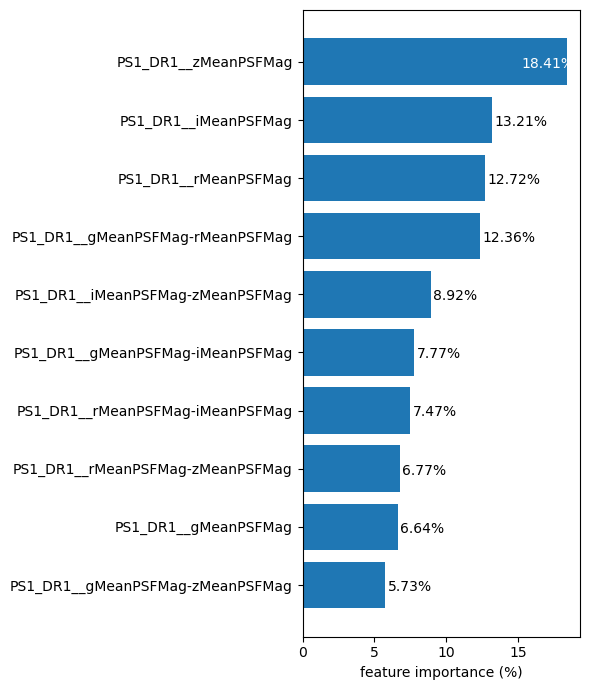

--------------------
features: WISE
              precision    recall  f1-score   support

      GALAXY     0.7654    0.6960    0.7290      3141
         QSO     0.9734    0.9669    0.9701     16888
        STAR     0.9433    0.9604    0.9518     21947

    accuracy                         0.9432     41976
   macro avg     0.8940    0.8744    0.8836     41976
weighted avg     0.9421    0.9432    0.9425     41976



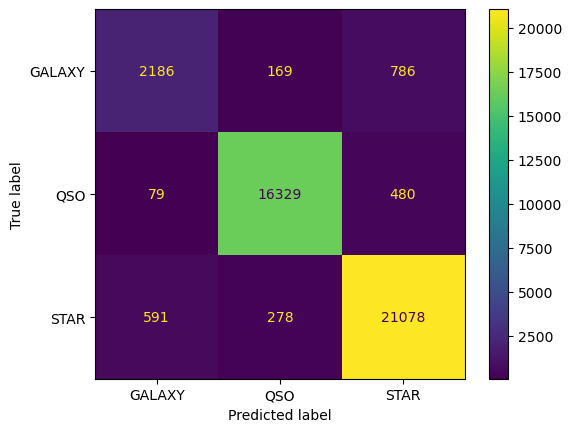

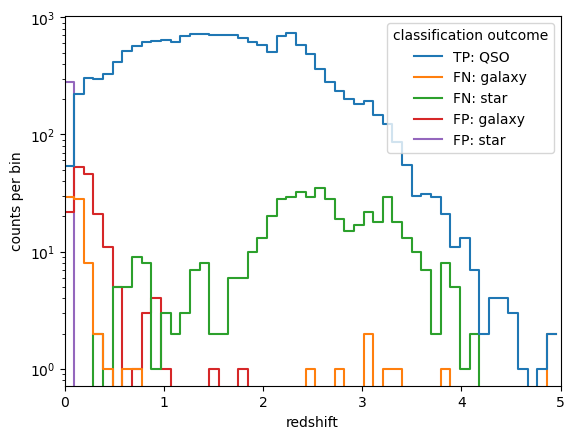

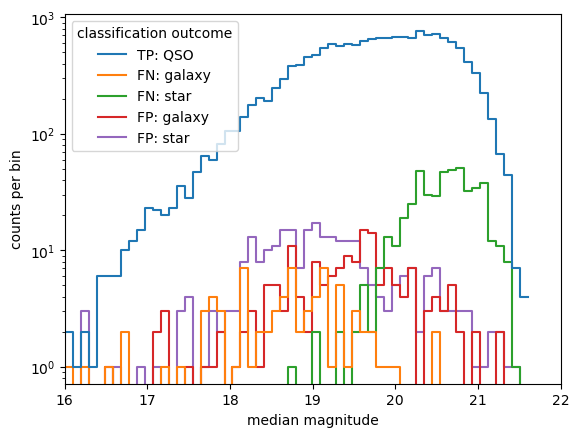

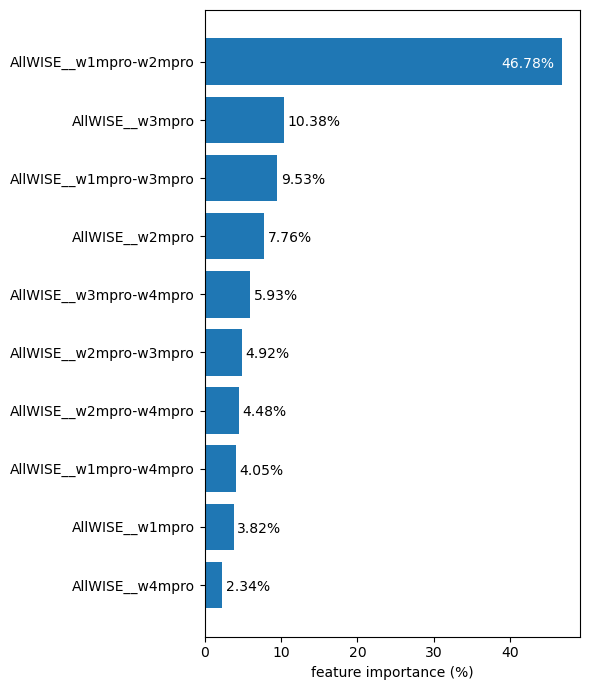

--------------------
features: GAIA
              precision    recall  f1-score   support

      GALAXY     0.9278    0.9331    0.9305      3141
         QSO     0.9836    0.9845    0.9840     16888
        STAR     0.9956    0.9941    0.9948     21947

    accuracy                         0.9857     41976
   macro avg     0.9690    0.9706    0.9698     41976
weighted avg     0.9857    0.9857    0.9857     41976



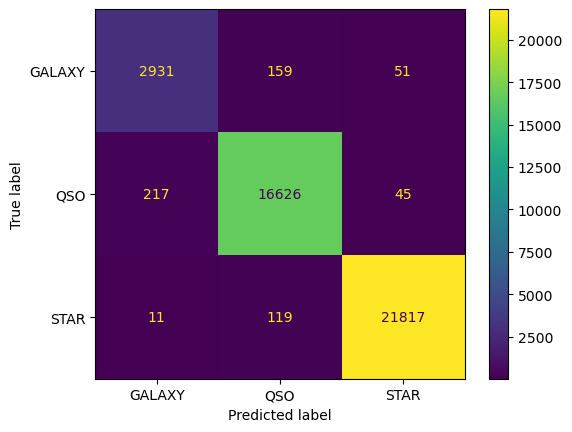

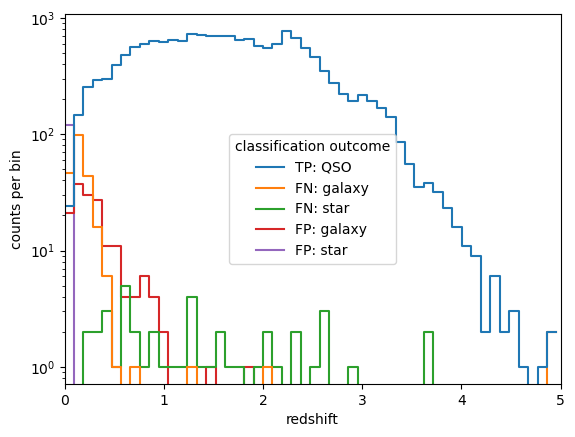

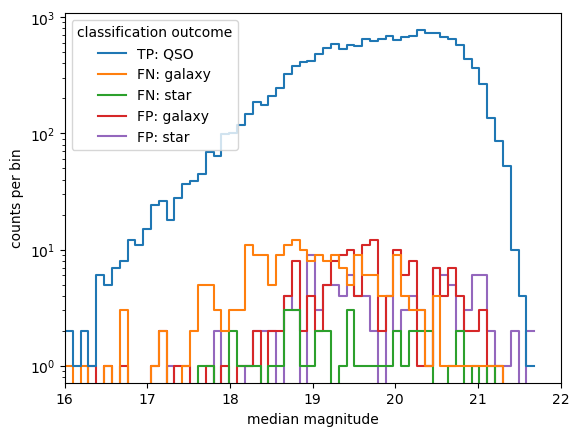

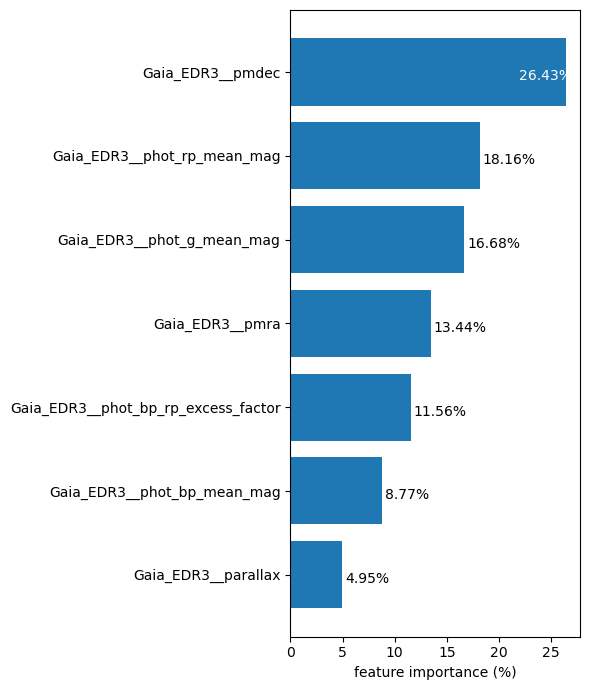

--------------------
features: ZTF + PS + WISE + GAIA
              precision    recall  f1-score   support

      GALAXY     0.9707    0.9478    0.9591      3141
         QSO     0.9911    0.9941    0.9926     16888
        STAR     0.9969    0.9979    0.9974     21947

    accuracy                         0.9926     41976
   macro avg     0.9862    0.9799    0.9830     41976
weighted avg     0.9926    0.9926    0.9926     41976



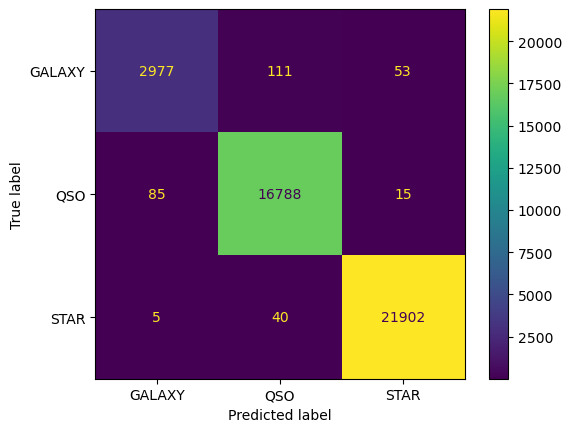

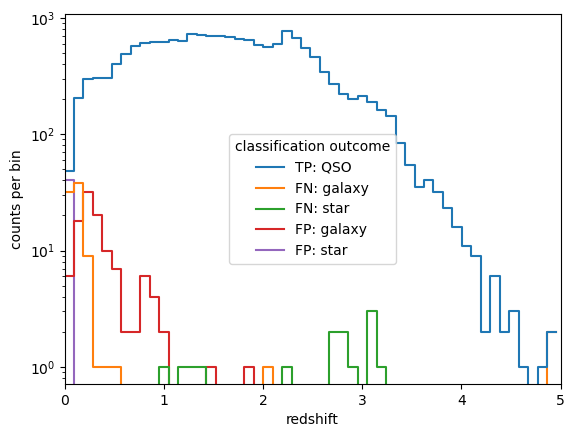

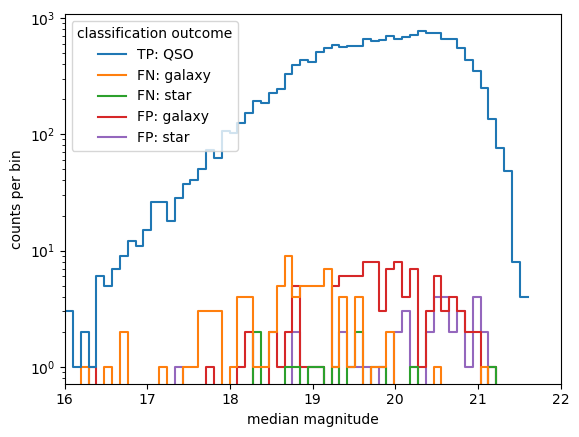

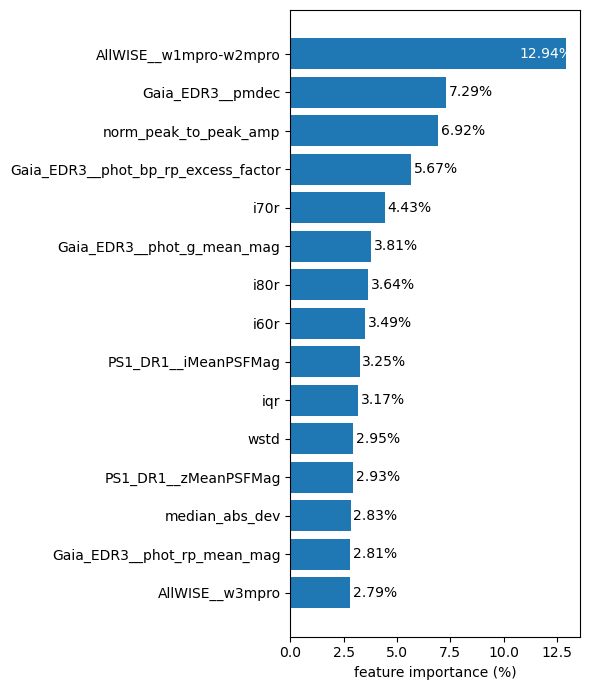

--------------------


In [44]:
data_label = 'ZTF x PS x WISE x GAIA'
make_reports(results[data_label], classifiers[data_label], feature_sets)

# t-SNE

## Save data subsets

In [4]:
filter = 'g'

In [5]:
# Read lightcurves to get their lengths
with open(os.path.join(DATA_PATH, 'ZTF_x_SDSS/ztf_20210401_x_specObj-dr18__singles_filter_{}__features_lc_reduced'.format(filter)), 'rb') as file:
    ztf_x_sdss_filter = pickle.load(file)

In [6]:
# Read ZTF x SDSS subset with available features
with open(os.path.join(DATA_PATH, 'ZTF_x_SDSS/ztf_20210401_x_specObj-dr18__singles_filter_{}__features'.format(filter)), 'rb') as file:
    ztf_x_sdss_features = pickle.load(file)

In [7]:
# Read SDSS x ZTF subset with available features
file_path = 'ZTF_x_SDSS/specObj-dr18_x_ztf_20210401__singles_filter_{}__features'
with open(os.path.join(DATA_PATH, file_path.format(filter)), 'rb') as file:
    sdss_x_ztf_features = pickle.load(file)

In [8]:
# Add reduced lighcurve length to the main dataframe
ztf_x_sdss_features['n_obs'] = [len(lc_dict['mjd']) for lc_dict in ztf_x_sdss_filter]

In [17]:
# Read ZTF x SDSS astromer features
file_path = 'ZTF_x_SDSS/ztf_20210401_x_specObj-dr18__singles_filter_{}__features_astromer_retrained_QSO.npy'.format(filter)
ztf_x_sdss_astromer = np.load(os.path.join(DATA_PATH, file_path))

# Add it to the main dataframe
columns = FEATURE_SETS['astromer_all']
ztf_x_sdss_features = pd.concat(
    [ztf_x_sdss_features, pd.DataFrame(ztf_x_sdss_astromer, columns=columns)], axis=1
)

In [18]:
# Get PS and WISE colors
ztf_x_sdss_features, feature_sets = add_colors(ztf_x_sdss_features)

In [19]:
# Merge ZTF and SDSS data
ztf_x_sdss_features = pd.concat([ztf_x_sdss_features, sdss_x_ztf_features], axis=1)

In [20]:
# Save a subset for embeddings
file_path = 'outputs/t-sne/filter_{}_10k__astromer-QSO'.format(filter)
with open(os.path.join(PROJECT_PATH, file_path), 'wb') as file:
    pickle.dump(ztf_x_sdss_features.sample(10000, random_state=34658), file)

In [21]:
# Save a QSO only subset for embeddings
file_path = 'outputs/t-sne/filter_{}_10k_qso__astromer-QSO'.format(filter)
with open(os.path.join(PROJECT_PATH, file_path), 'wb') as file:
    data_qso = ztf_x_sdss_features.loc[ztf_x_sdss_features['CLASS'] == 'QSO']
    pickle.dump(data_qso.sample(10000, random_state=34658), file)

## Make embeddings

In [26]:
# Data: all, QSO only
data_dict = {}
filter = 'g'

# Load a subset for embeddings
# file_path = 'outputs/t-sne/filter_{}_10k__astromer-QSO'
# with open(os.path.join(PROJECT_PATH, file_path.format(filter)), 'rb') as file:
#     data_dict['all'] = pickle.load(file)

# Load a QSO only subset for embeddings
file_path = 'outputs/t-sne/filter_{}_10k_qso__astromer-QSO'
with open(os.path.join(PROJECT_PATH, file_path.format(filter)), 'rb') as file:
    data_dict['QSO'] = pickle.load(file)

In [36]:
feature_sets = [
    # ['ZTF'],
    # ['astromer'],
    # ['PS'],
    # ['WISE'],
    # ['ZTF', 'astromer', 'PS'],
    # ['ZTF', 'astromer', 'PS', 'WISE'],
    # ['astromer_all'],
    # ['astromer_min-max'],
    ['astromer_top_clf']
]

for data_label, data in tqdm(data_dict.items()):
    for feature_labels in tqdm(feature_sets):
        print('Processing data: {}, features: {}'.format(data_label, feature_labels))

        # Take all features together to make a subset
        features = np.concatenate([FEATURE_SETS[label] for label in feature_labels])

        # Generate indices of common rows for all experiments
        reduced_data = data.dropna(subset=features)

        # Get embedding
        embedding = get_embedding(reduced_data[features], n_iter=5000)
        for i in [0, 1]:
            data.loc[reduced_data.index, 't-sne_{}_{}'.format(i, '_'.join(feature_labels))] = embedding[:, i]

    # Save embedding
    tmp = '10k_qso' if data_label == 'QSO' else '10k'
    file_name = 'outputs/t-sne/filter_{}_{}__astromer-QSO'.format(filter, tmp)
    file_path = os.path.join(PROJECT_PATH, file_name)
    with open(file_path, 'wb') as file:
        pickle.dump(data, file)
    print('Saved to: {}'.format(file_path))

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

Processing data: QSO, features: ['astromer_top_clf']
Saved to: /home/sjnakoneczny/workspace/ztf-agn/outputs/t-sne/filter_g_10k_qso__astromer-QSO


## Results

In [21]:
# Load all results
filter = 'g'

data_dict = {}

# Load a subset for embeddings
# file_path = 'outputs/t-sne/filter_{}_10k'
# with open(os.path.join(PROJECT_PATH, file_path.format(filter)), 'rb') as file:
#     data_dict['all'] = pickle.load(file)

# Load a QSO only subset for embeddings
file_path = 'outputs/t-sne/filter_{}_10k_qso__astromer-QSO'
with open(os.path.join(PROJECT_PATH, file_path.format(filter)), 'rb') as file:
    data_dict['QSO'] = pickle.load(file)

### ZTF

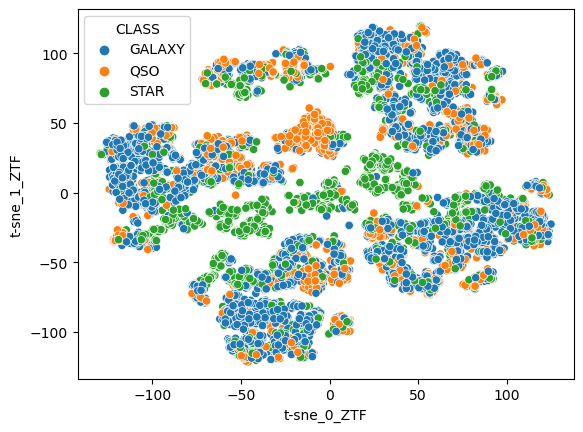

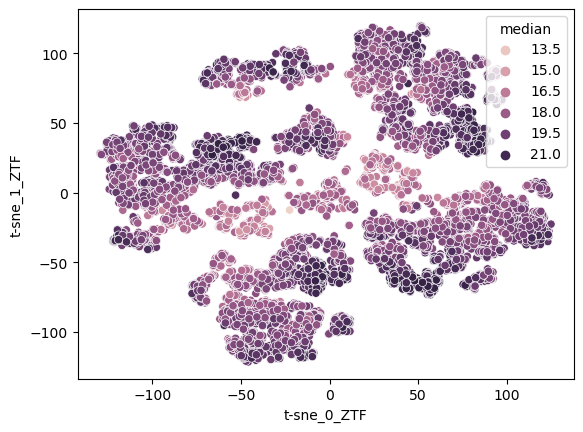

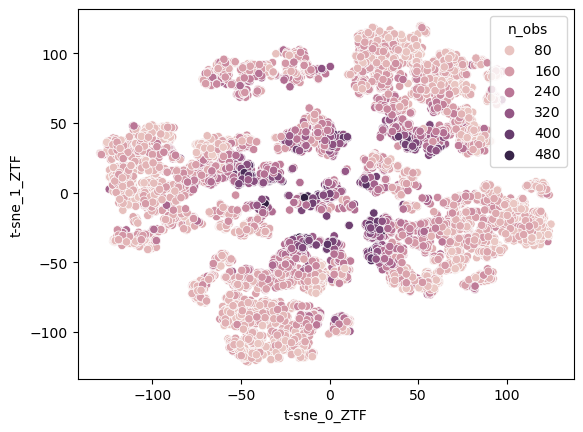

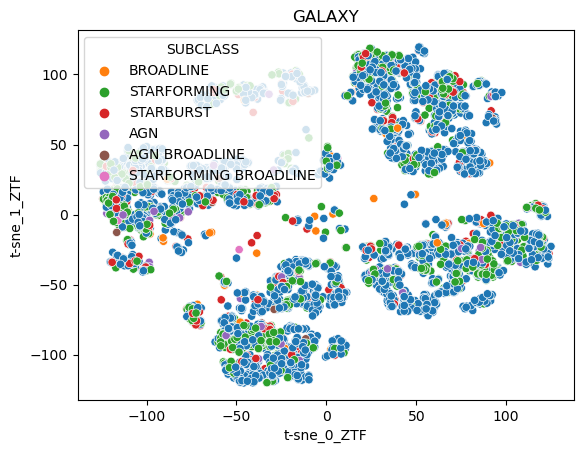

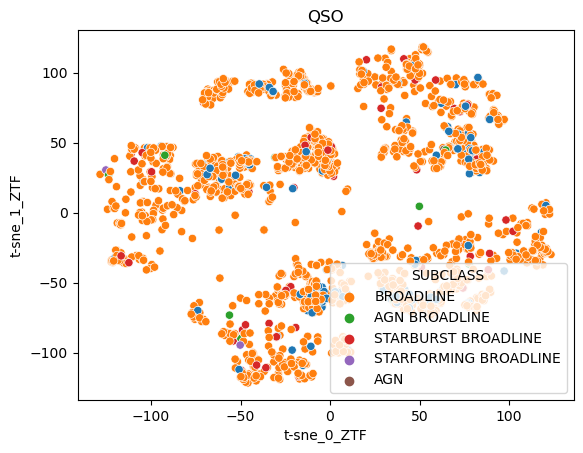

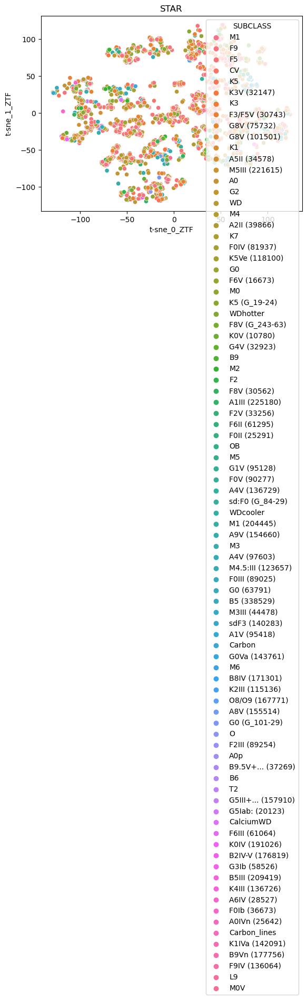

In [34]:
plot_embedding(data_dict['all'], ['ZTF'])

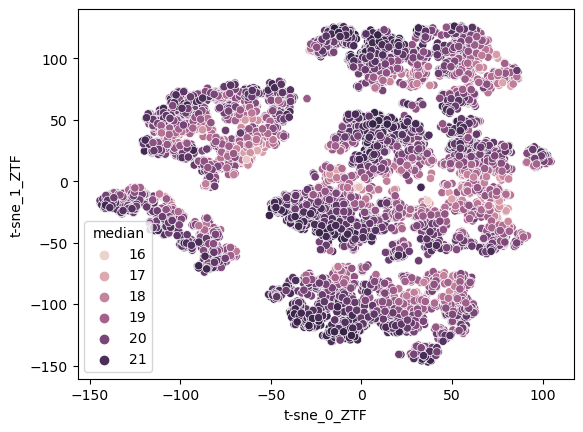

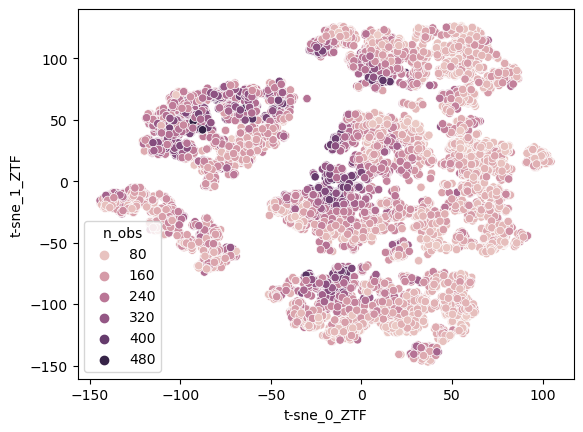

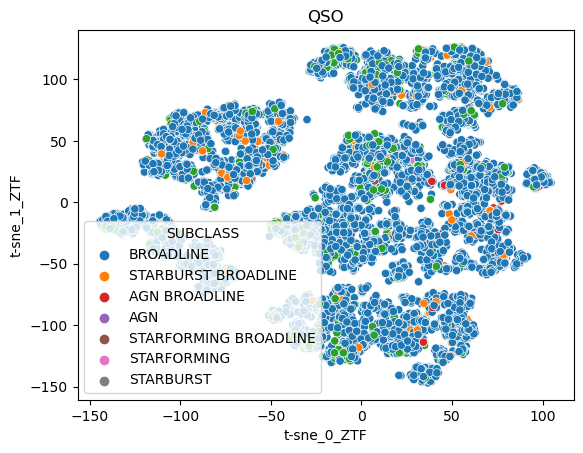

In [35]:
plot_embedding(data_dict['QSO'], ['ZTF'])

### astromer

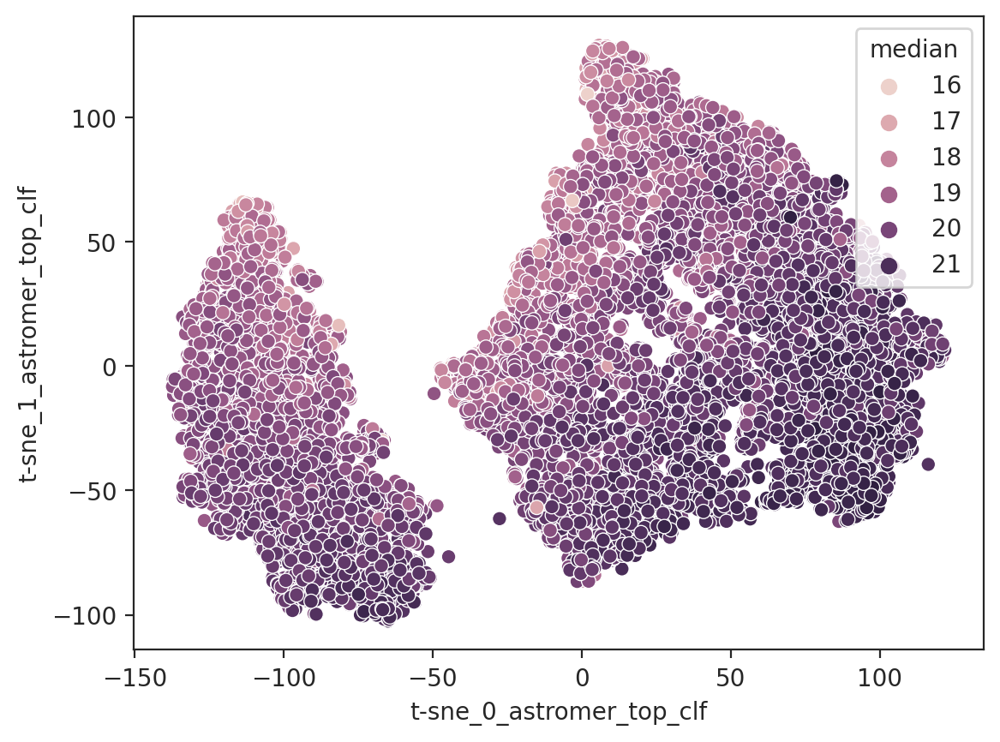

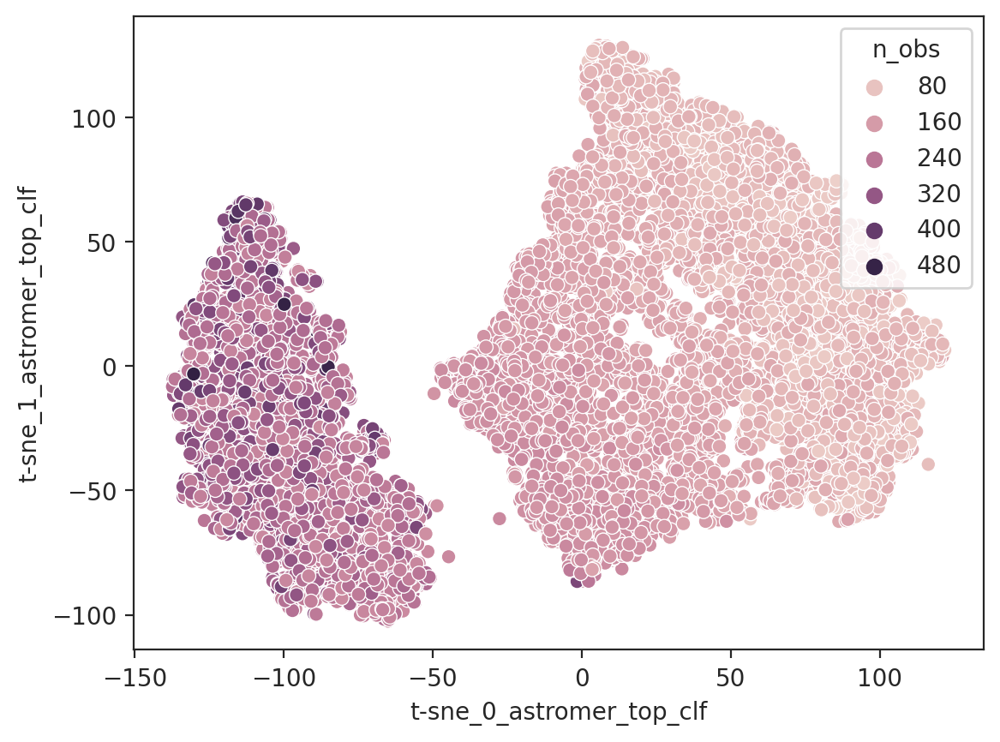

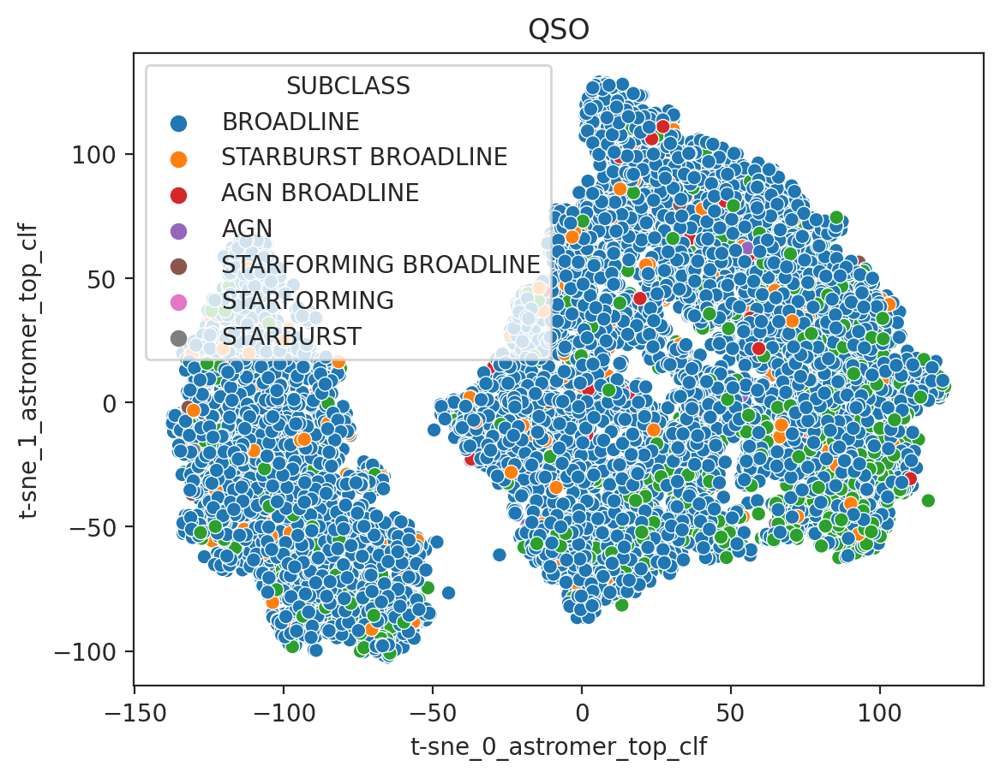

In [37]:
# Retrained on QSO only, top CLF from not retraining on QSO only
plot_embedding(data_dict['QSO'], ['astromer_top_clf'])

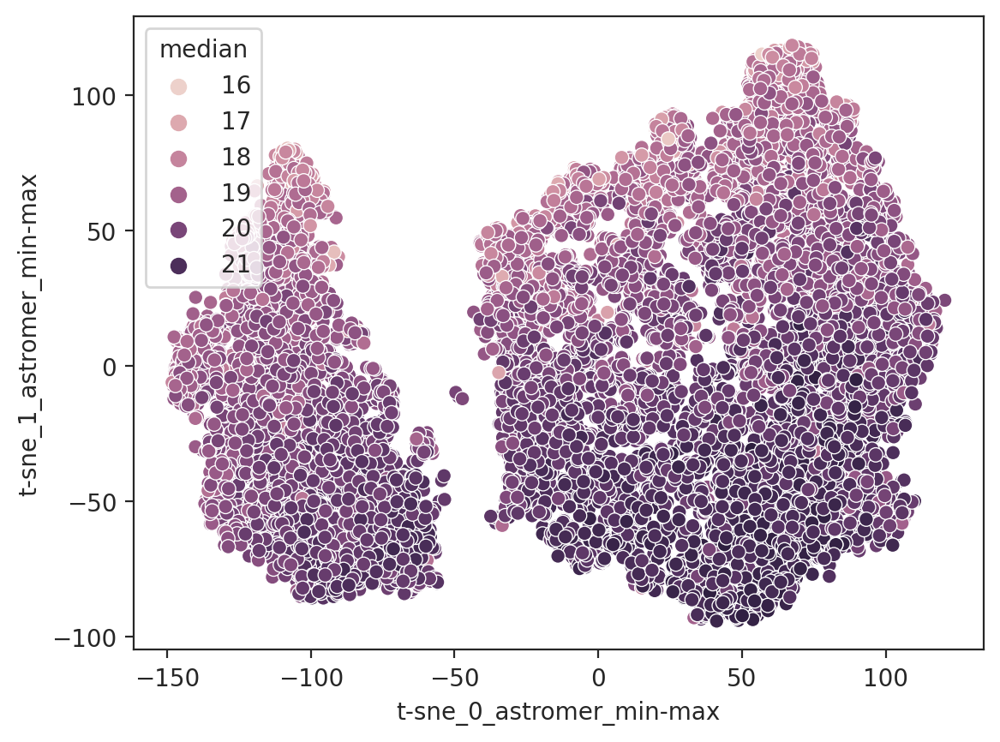

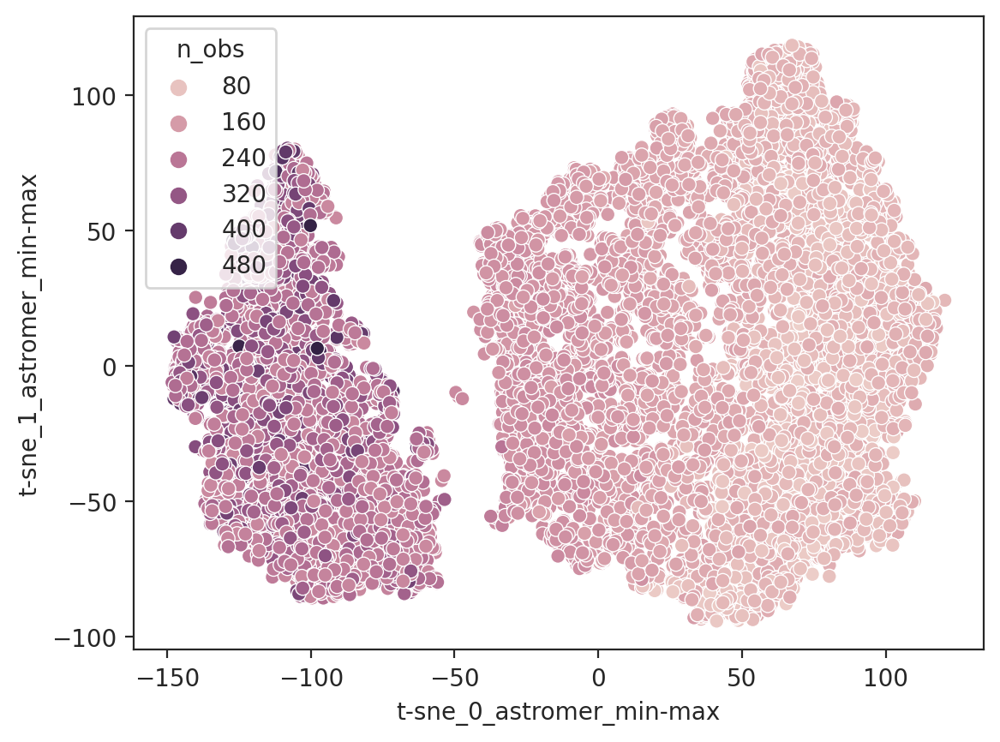

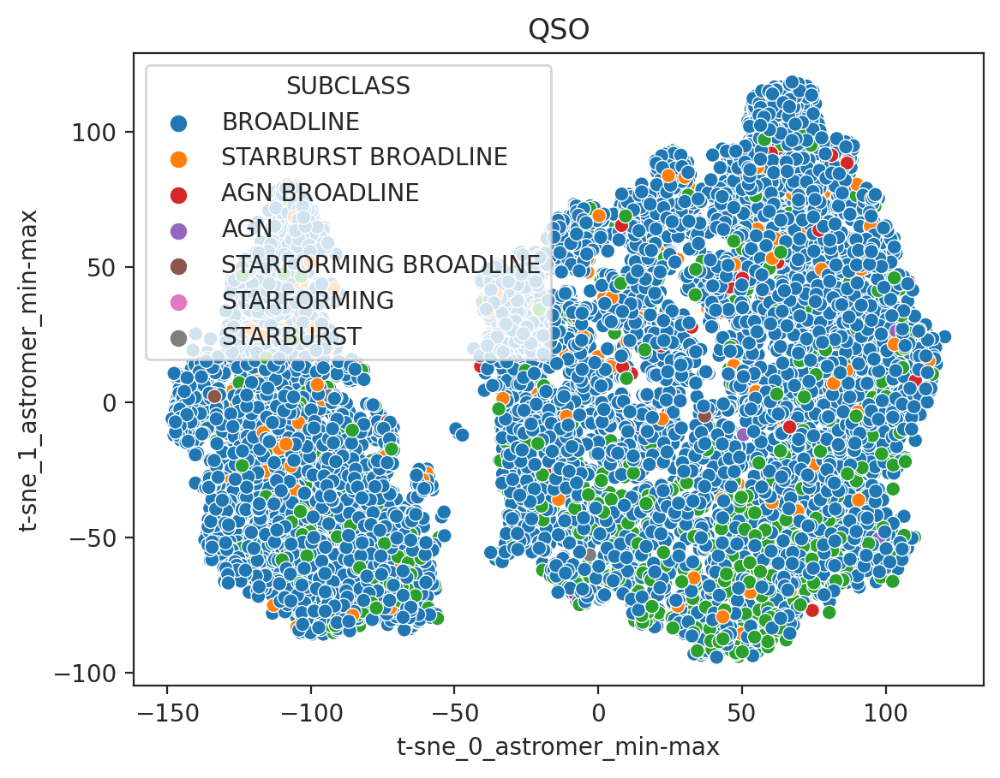

In [35]:
# Retrained on QSO only, high and low percentiles on attention
plot_embedding(data_dict['QSO'], ['astromer_min-max'])

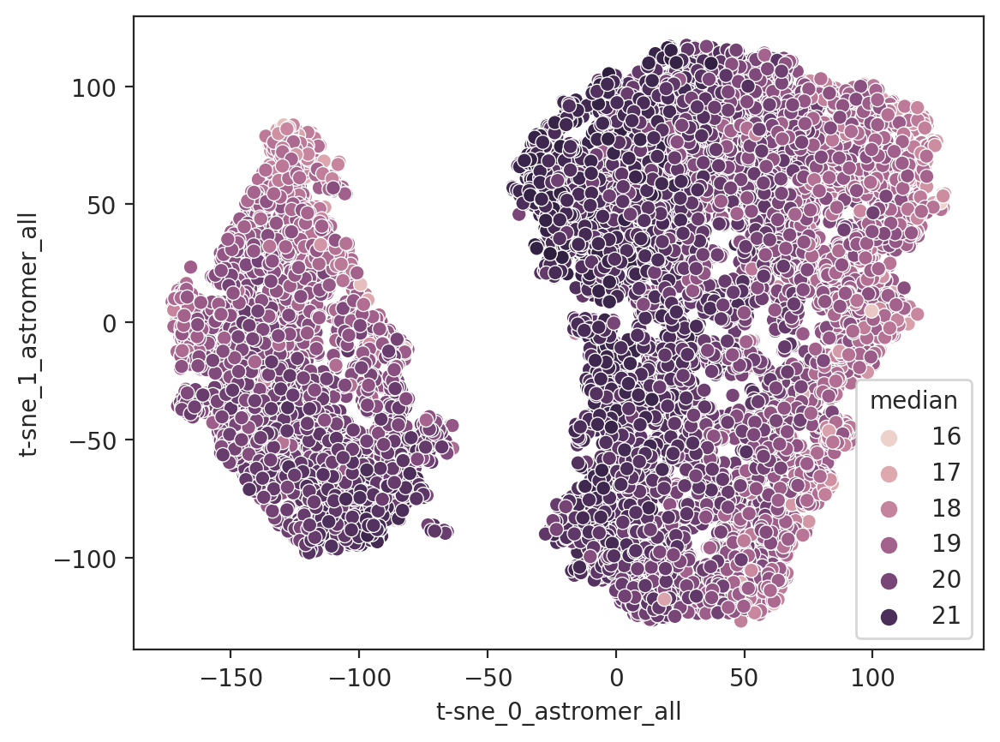

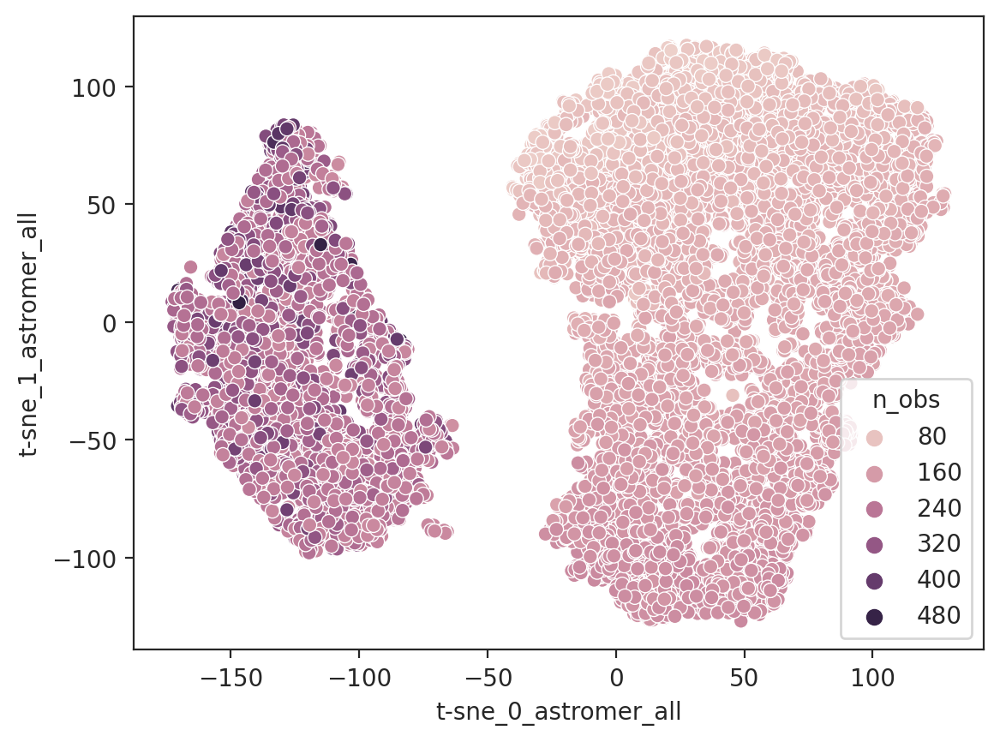

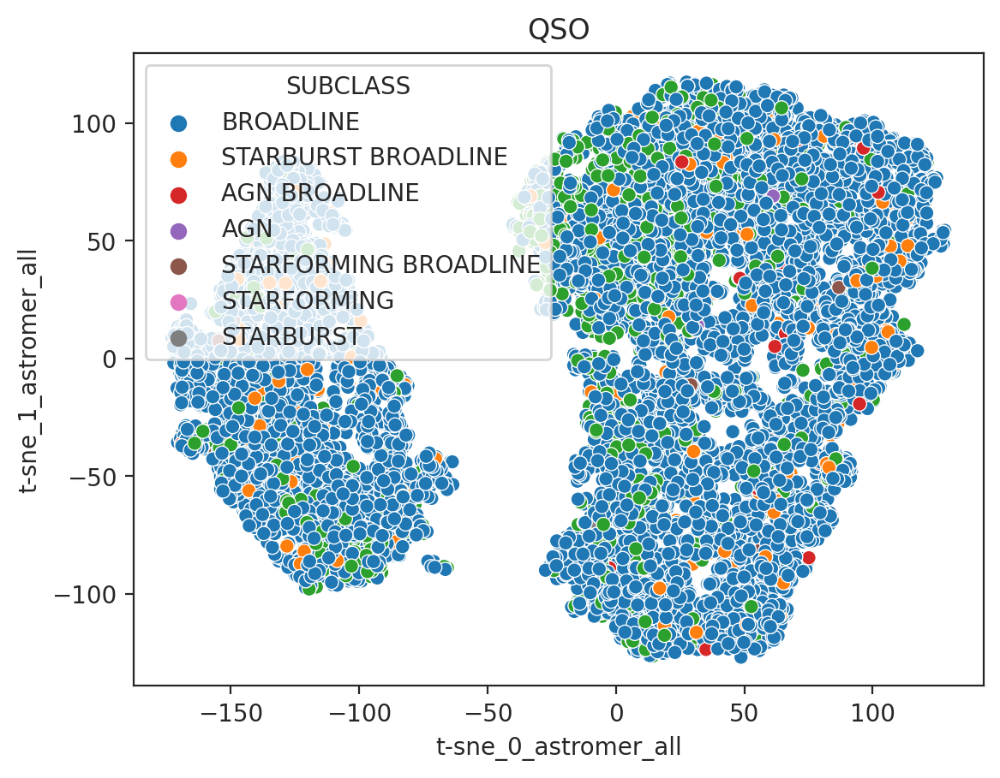

In [31]:
# Retrained on QSO only, all astromer features
plot_embedding(data_dict['QSO'], ['astromer_all'])

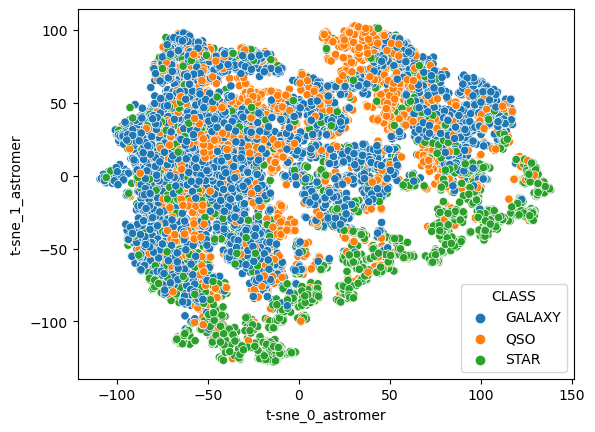

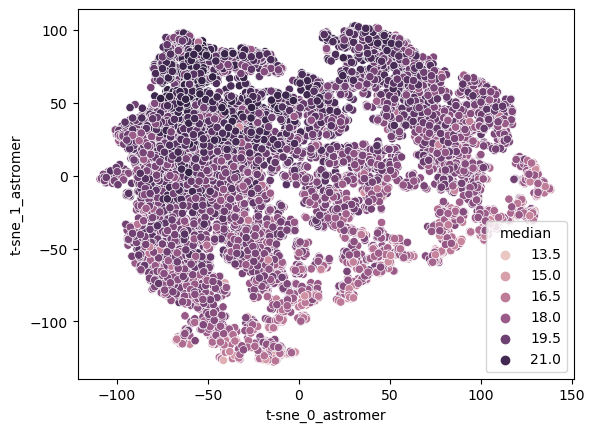

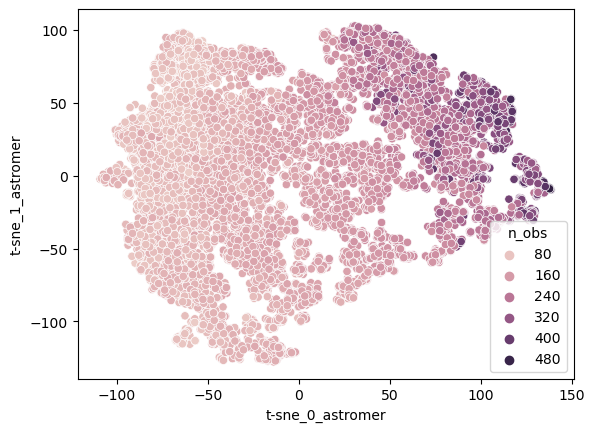

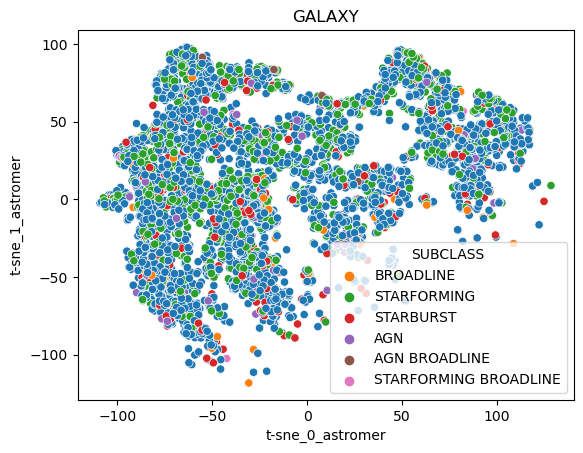

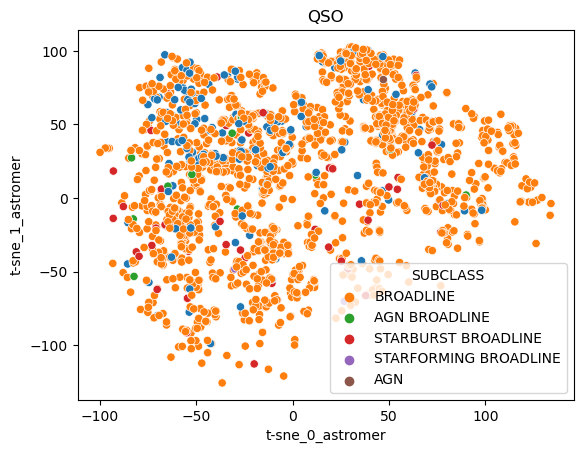

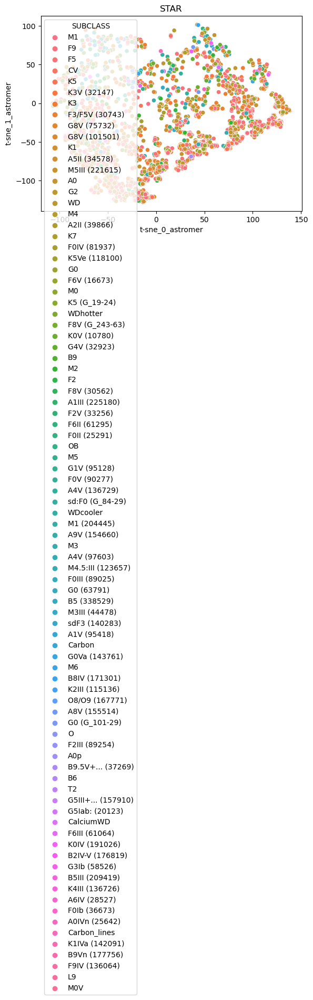

In [46]:
plot_embedding(data_dict['all'], ['astromer'])

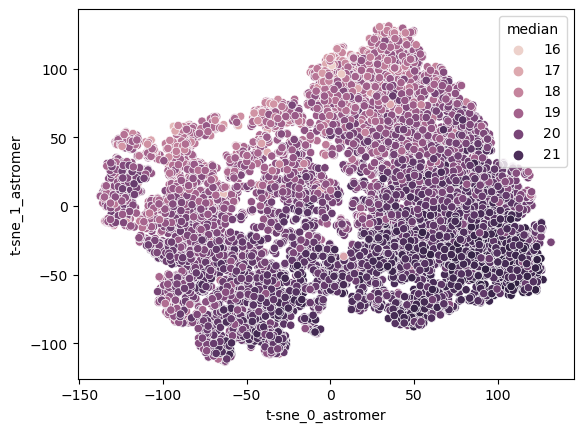

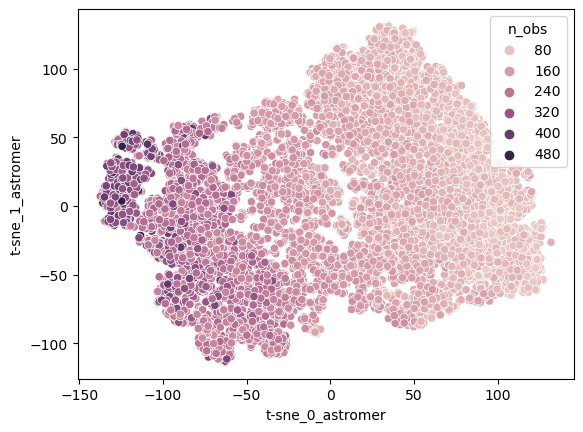

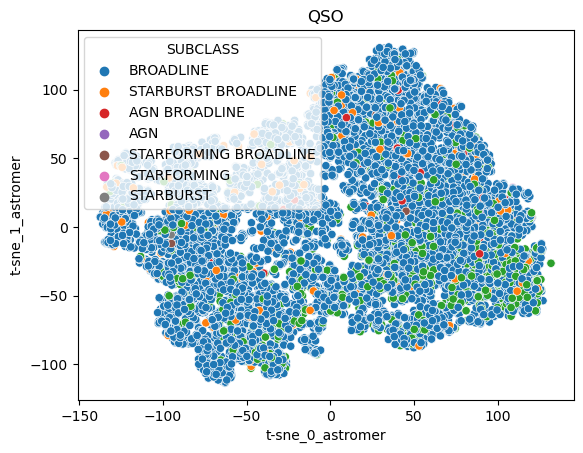

In [47]:
plot_embedding(data_dict['QSO'], ['astromer'])

### PS

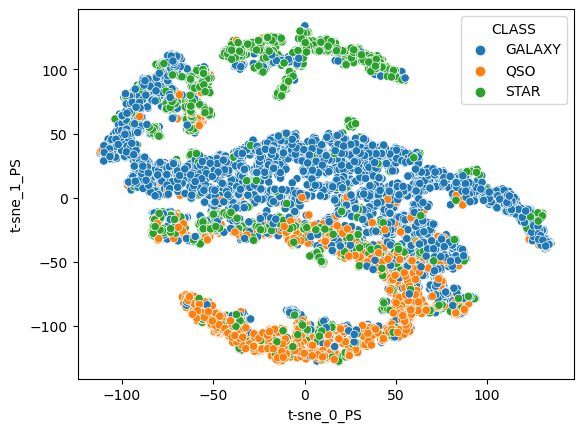

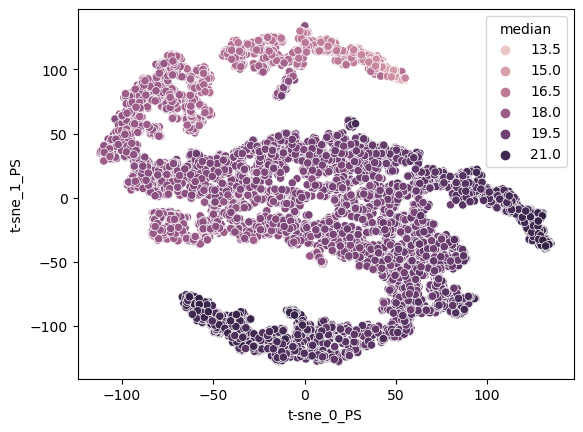

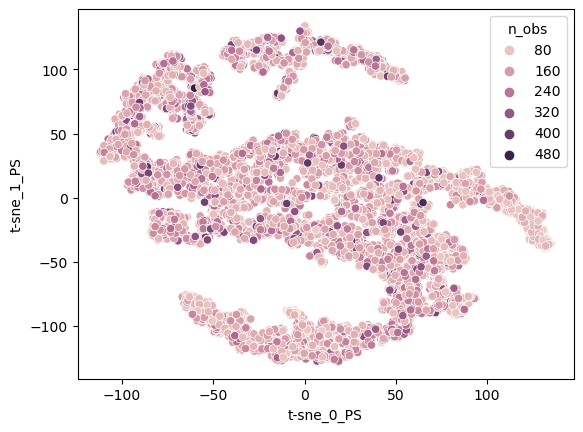

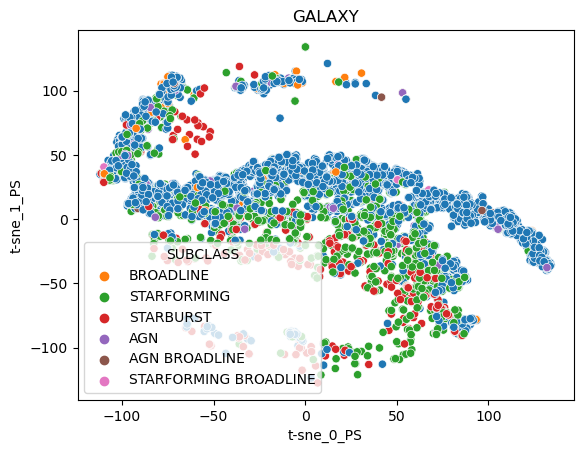

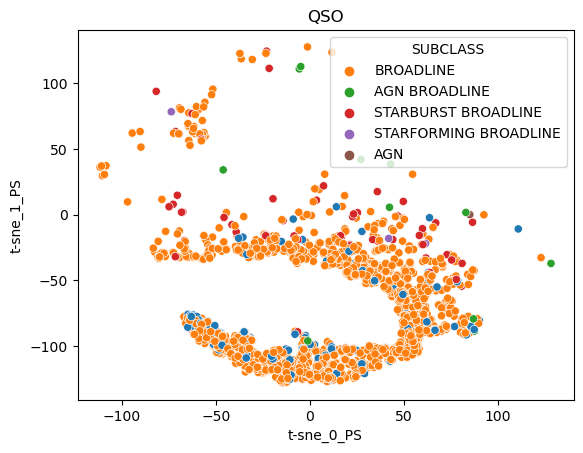

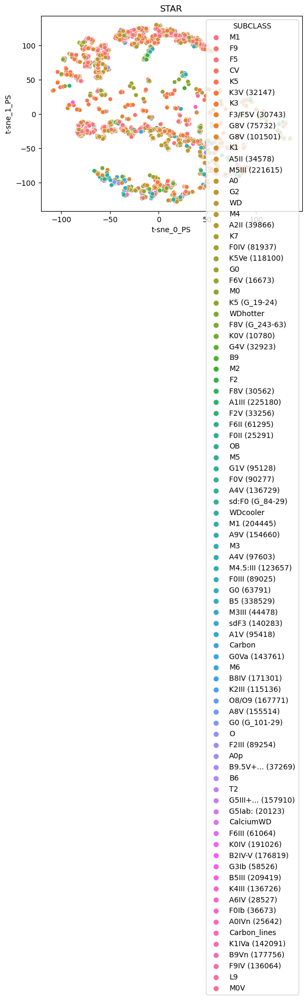

In [48]:
plot_embedding(data_dict['all'], ['PS'])

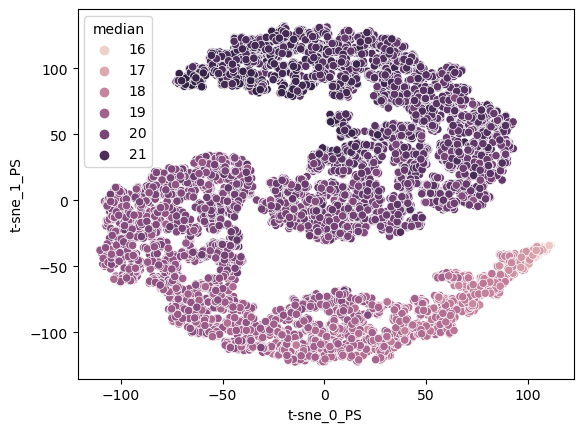

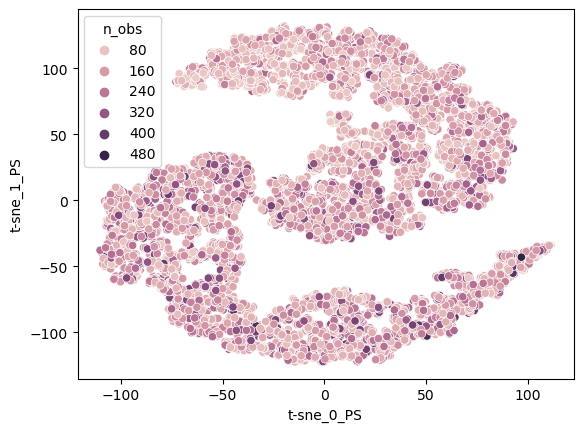

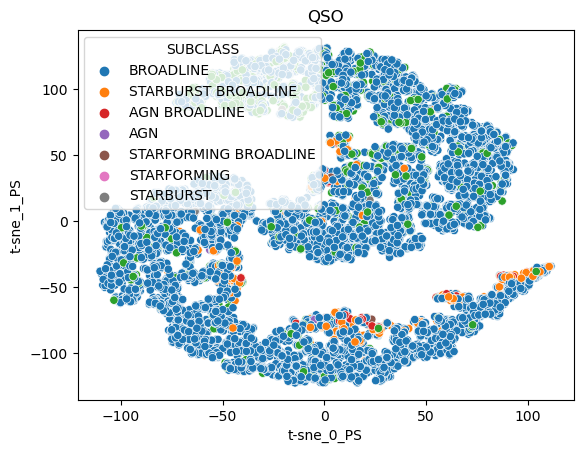

In [49]:
plot_embedding(data_dict['QSO'], ['PS'])

### WISE

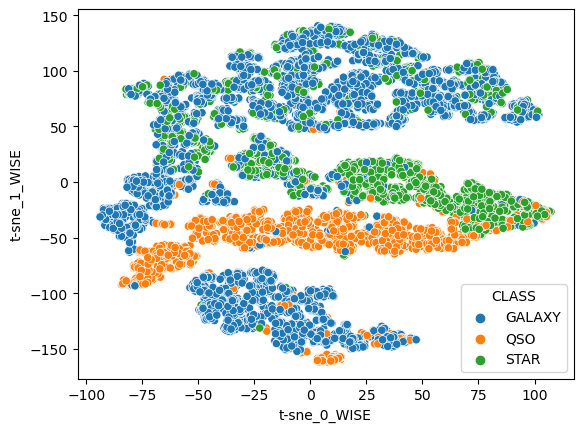

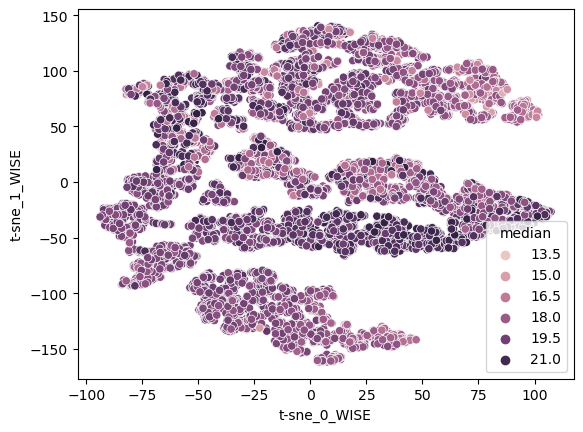

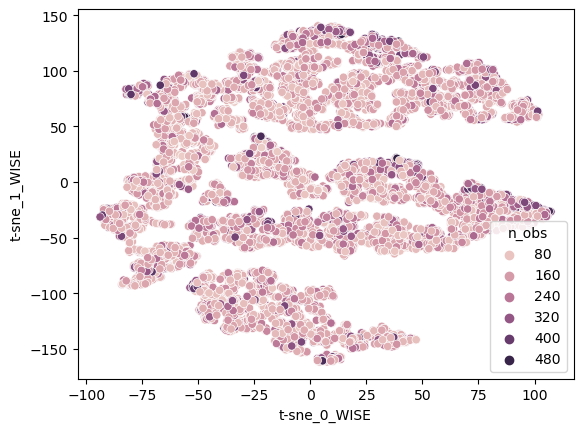

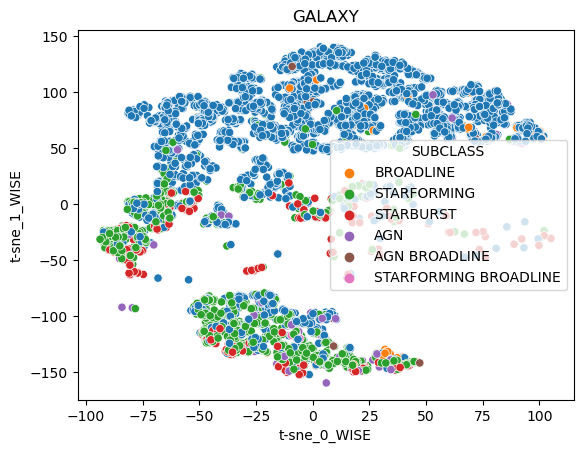

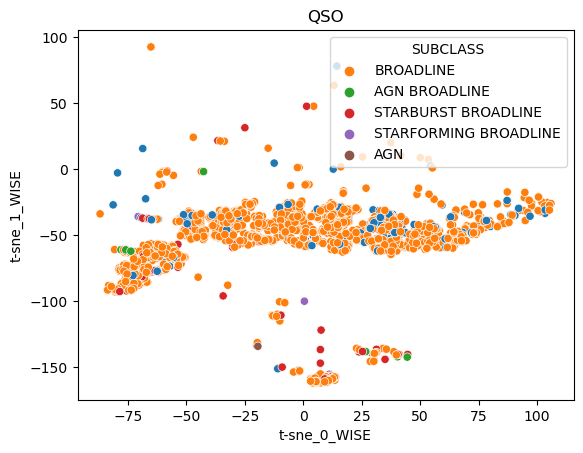

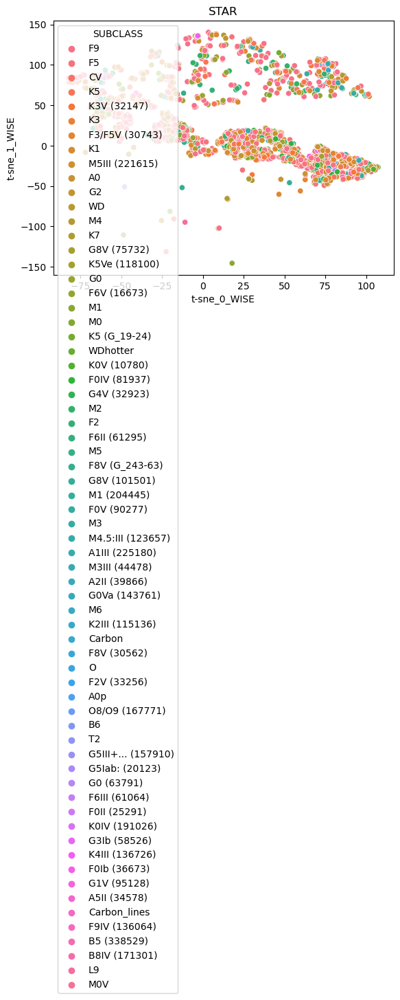

In [50]:
plot_embedding(data_dict['all'], ['WISE'])

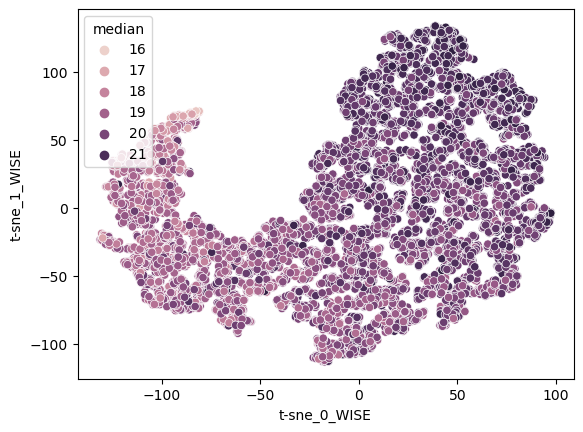

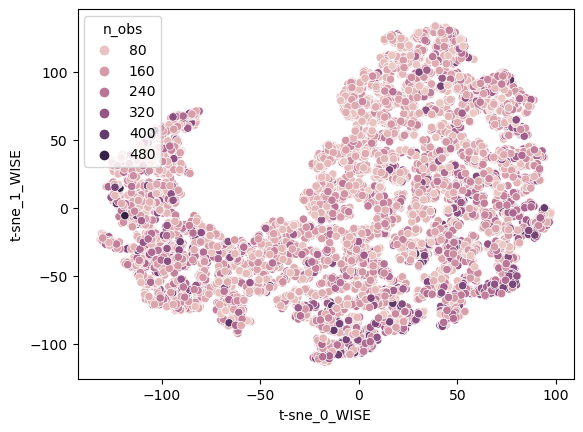

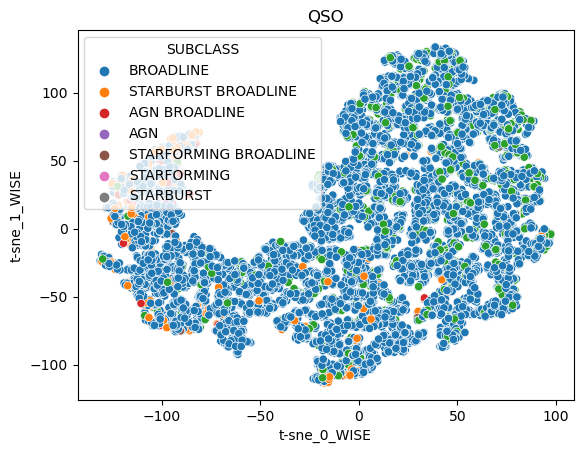

In [51]:
plot_embedding(data_dict['QSO'], ['WISE'])

### ZTF + astromer + PS

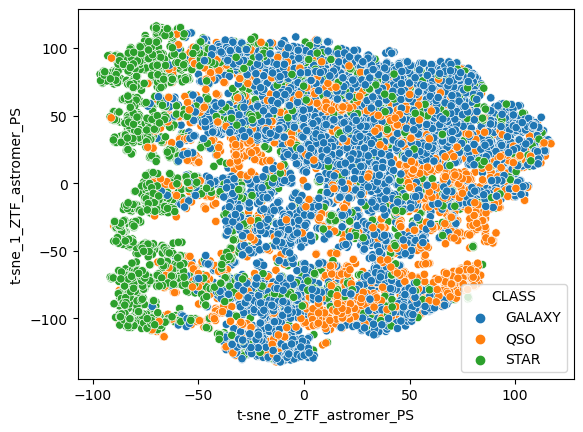

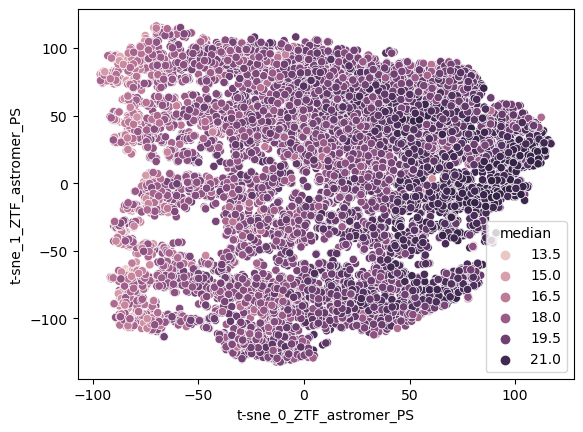

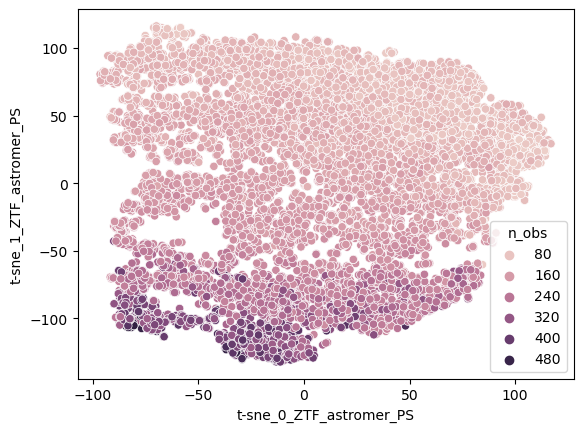

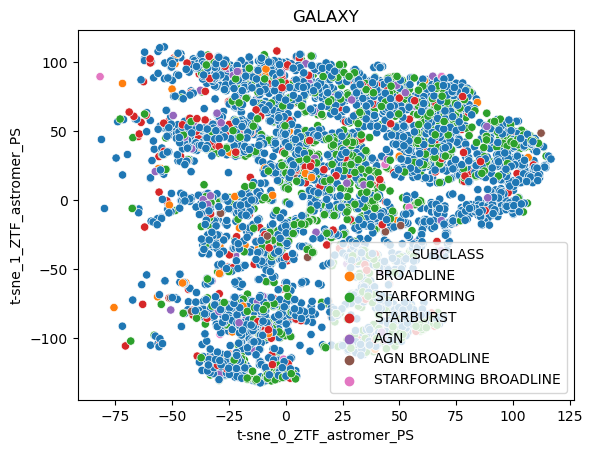

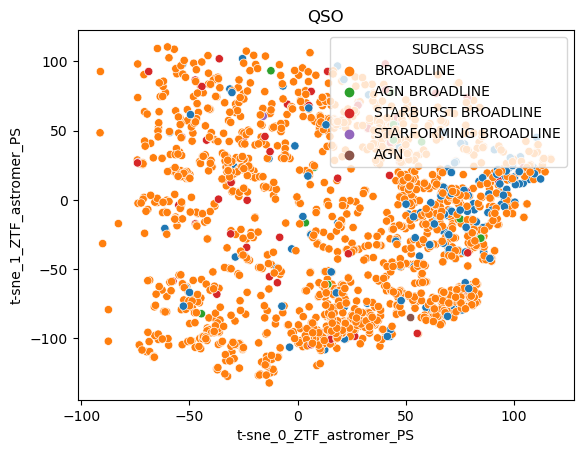

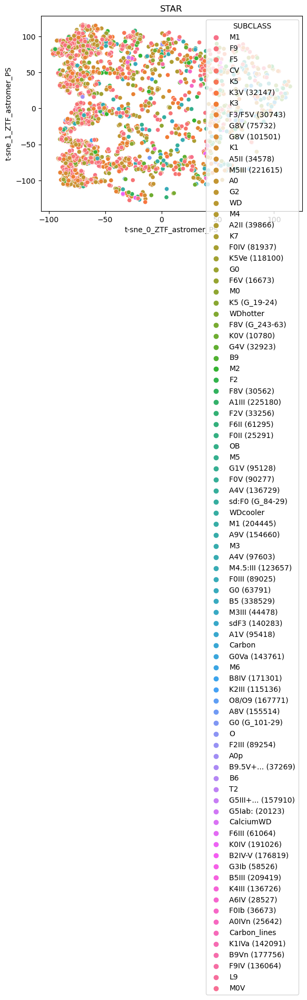

In [52]:
plot_embedding(data_dict['all'], ['ZTF', 'astromer', 'PS'])

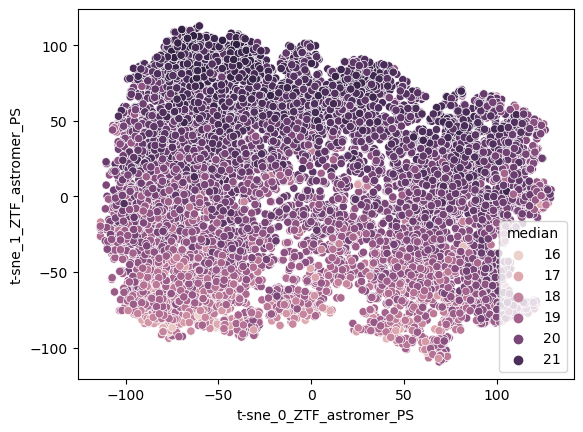

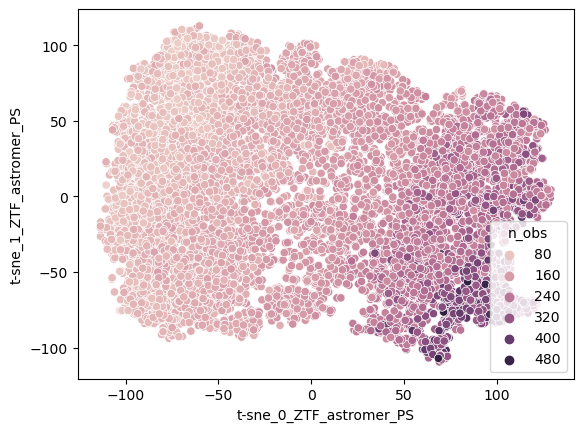

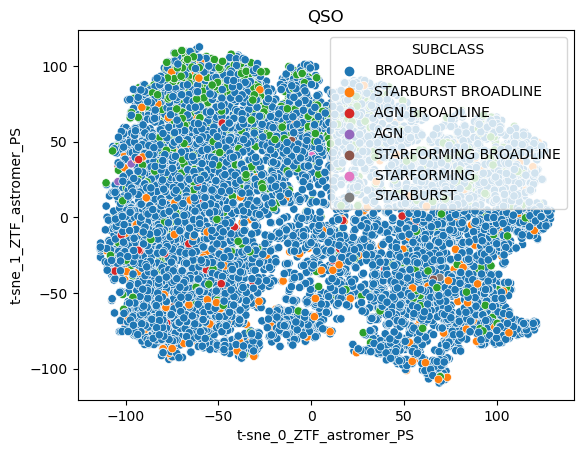

In [53]:
plot_embedding(data['QSO'], ['ZTF', 'astromer', 'PS'])

### ZTF + astromer + PS + WISE

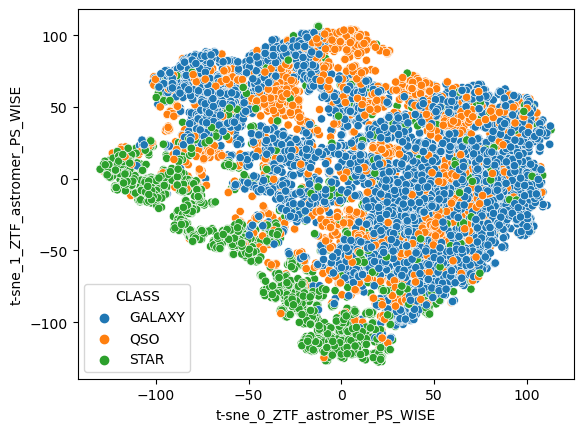

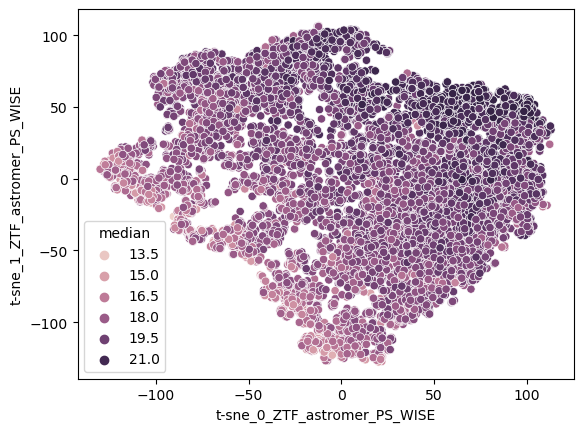

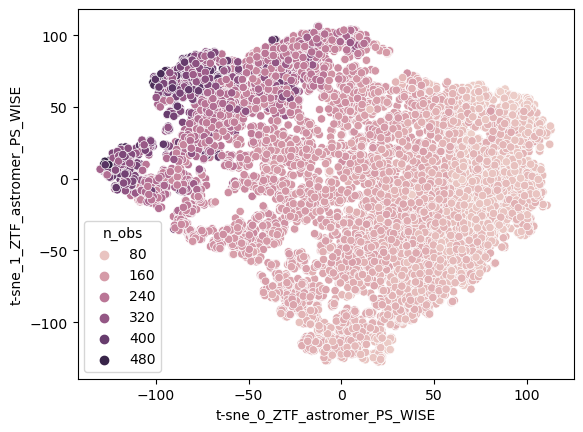

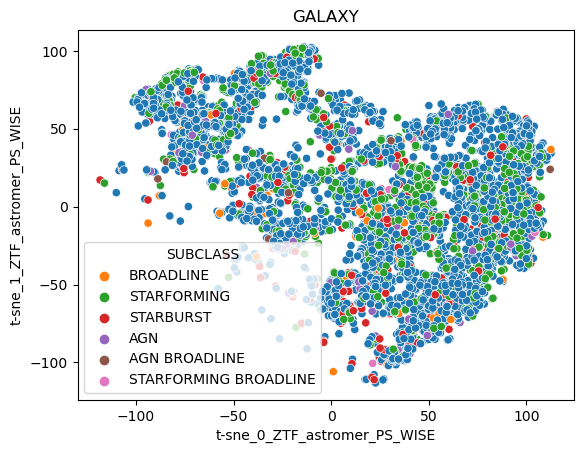

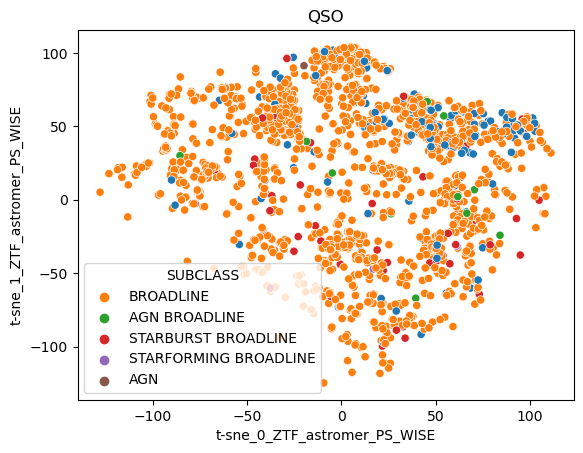

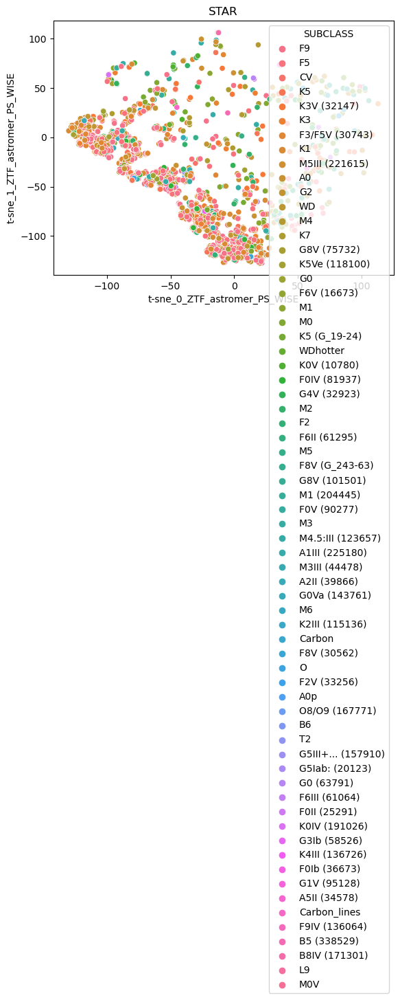

In [54]:
plot_embedding(data['all'], ['ZTF', 'astromer', 'PS', 'WISE'])

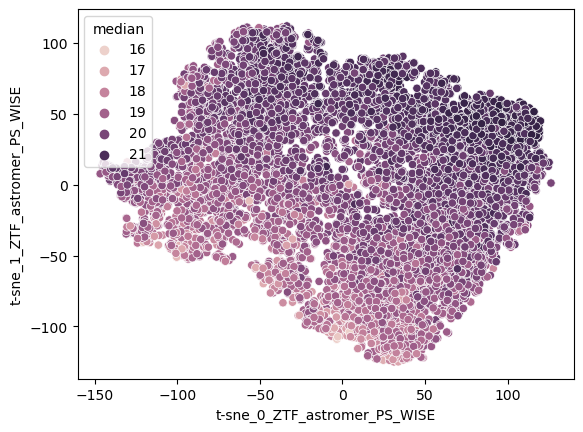

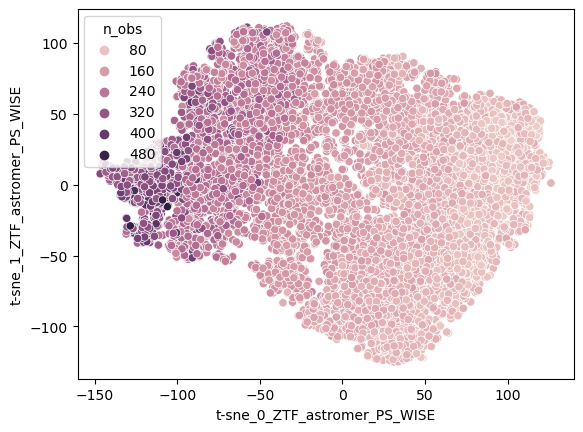

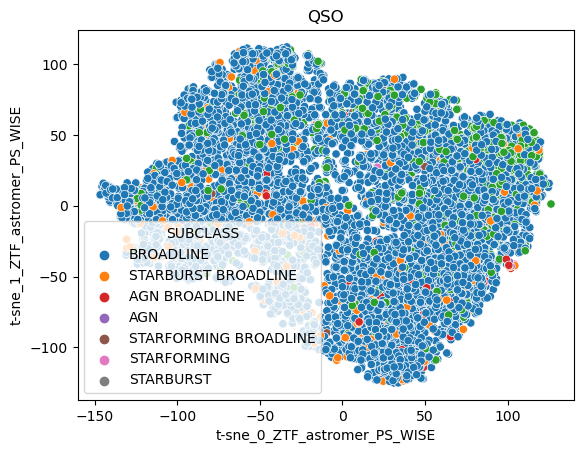

In [55]:
plot_embedding(data['QSO'], ['ZTF', 'astromer', 'PS', 'WISE'])